<a href="https://colab.research.google.com/github/SLKS99/-Physics-driven-discovery-and-optimization-of-hybrid-perovskite-films/blob/main/Toy_models_sGP_GP_Bandgap.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# GP and sGP for the exploration of bandgap vs concentration

August 2023

*   GP and sGP developed by [Maxim Ziatdinov](https://scholar.google.com/citations?user=YnSdOoUAAAAJ&hl=en) in [AtomAi](https://atomai.readthedocs.io/en/latest/)

*   Models of bandgap vs. concentration created by [Yongtao Liu](https://youngtaoliu.wixsite.com/yongtaoliu) and analysis performed by [Yongtao Liu](https://youngtaoliu.wixsite.com/yongtaoliu) and [Sheryl L. Sanchez](https://scholar.google.com/citations?hl=en&user=zFRKT-MAAAAJ)




In [ ]:
!pip install git+https://github.com/ziatdinovmax/gpax

  Cloning https://github.com/ziatdinovmax/gpax to /tmp/pip-req-build-vaxqoaex
  Running command git clone --filter=blob:none --quiet https://github.com/ziatdinovmax/gpax /tmp/pip-req-build-vaxqoaex
  Resolved https://github.com/ziatdinovmax/gpax to commit 05b788315dc62a0a60e457a5b55eb5c6815e2c81
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 304.6/304.6 kB 6.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 360.3/360.3 kB 16.3 MB/s eta 0:00:00
  Created wheel for gpax: filename=gpax-0.0.8-py3-none-any.whl size=49198 sha256=52f27289549c2da73f1e74a596a56b54847a11623bad5222e2187d3770295644
  Stored in directory: /tmp/pip-ephem-wheel-cache-fd2n_wiw/wheels/12/19/96/a1ec8793653811a72b43335d47d18b6b9c4a428469d38f338f
Successfully built gpax


In [ ]:
!pip install atomai

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 147.4/147.4 kB 3.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 37.9/37.9 MB 15.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 193.1/193.1 kB 14.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 266.1/266.1 kB 21.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 173.0/173.0 kB 16.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 865.8/865.8 kB 28.9 MB/s eta 0:00:00
  Created wheel for matplotlib: filename=matplotlib-3.3.4-cp310-cp310-linux_x86_64.whl size=11772893 sha256=bfa78519723692f61f5602f9eacd05908b8868877450c42052580b7fdd305199
  Stored in directory: /root/.cache/pip/wheels/38/c6/49/eaba6d234887d98d9c85185e2a90bd7bb77934e85eefaf317e
  Created wheel for mendeleev: filename=mendeleev-0.6.1-py2.py3-none-any.whl size=174961 sha256=fd3532ede0f2d919740982446271ff933ff2a1791aa8587416d6ba48

In [ ]:
#Import Modules
import os
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import matplotlib.cm as cm

import gpax
import jax.random as jra
import jax.numpy as jnp
gpax.utils.enable_x64()
import seaborn as sns
import atomai as aoi
from sklearn.metrics import mean_squared_error

In [ ]:
plt.rcParams["font.size"] = "20"
plt.rcParams["axes.labelweight"] = "bold"
plt.rcParams["font.weight"] = "bold"
plt.rcParams['axes.titleweight']='bold'

## Models: Bandgap vs. Composition

Assume that we mix AB and AC, where AB has a band of 1.2eV and AC has a bandgap of 2 eV. The mixed material is AB$_x$C$_1$$_-$$_x$. We create five models to represent the bandgap change of AB$_x$C$_1$$_-$$_x$ as a function of x.


*   The first is a linear model, where the relationship between bandgap and x is linear: E$_a$$_b$$_c$ = E$_a$$_b$\*x + E$_a$$_c$\*(1-x)
*   The second is a bowing model, we consider bandgap bowing effect here: E$_a$$_b$$_c$ = E$_a$$_b$\*x + E$_a$$_c$\*(1-x) + k\*x*(1-x), where k is the bowing coefficient.
*   In the third model, we consider the alloy formation condition. We assume that when the ratio of AC is smaller than 20%, there is no alloy formed; in this case, the bandgap is dominated by AB, so we assume that the bandgap of AB$_x$C$_1$$_-$$_x$ in this range is constant and equal to the bandgap of AB. The model is: E$_a$$_b$$_c$ = E$_a$$_b$, x > 80%; E$_a$$_b$$_c$ = E$_a$$_b$\*x + E$_a$$_c$\*(1-x), x < 80%
*   In the forth model, we also consider the alloy formation condition when x is extremely small. We assume that there is no alloy formed when x < 20% or x > 80 %. So the model is: E$_a$$_b$$_c$ = E$_a$$_b$, x >= 80%; E$_a$$_b$$_c$ = E$_a$$_c$, x <= 20%; E$_a$$_b$$_c$ = E$_a$$_b$\*x + E$_a$$_c$\*(1-x), 20% < x < 80%
*   The fifth model is similar to the third one, we  consider the alloy formation condition. We assume that there is no alloy formed when x > 80 % and the bandgap follows the bowing law when model formed. So the model is: E$_a$$_b$$_c$ = E$_a$$_b$, x >= 80%; E$_a$$_b$$_c$ = E$_a$$_b$\*x + E$_a$$_c$\*(1-x) + k\*x*(1-x), 20% < x < 80%


In [ ]:
np.random.seed(0)

NUM_INIT_POINTS = 200 #200 # number of observation points
NOISE_LEVEL = 0.01  # noise level
x_ = np.linspace(0.0, 1., NUM_INIT_POINTS)   #composition

# the first model is a linear model
f1 = lambda x: 1.2*x + 2*(1-x)
y1 = f1(x_) + np.random.normal(0., NOISE_LEVEL, NUM_INIT_POINTS)

# the second model is a bowing model
b = 2  #bowing factor is 2
f2 = lambda x: 1.2*x + 2*(1-x) - b*(1-x)*x
y2 = f2(x_) + np.random.normal(0., NOISE_LEVEL, NUM_INIT_POINTS)

# the third model has no alloy formation at a certain composition
def f3 (x: jnp.ndarray, c = 0.8) -> np.ndarray:
    return np.piecewise(x, [x < c, x >= c],
                        [lambda x: 1.2*x + 2*(1-x), lambda x: 1.2])
y3 = f3(x_) + np.random.normal(0., NOISE_LEVEL, NUM_INIT_POINTS)

# the fourth model has no alloy formation at two certain compositions
def f4 (x: jnp.ndarray, c1 = 0.2, c2 = 0.80) -> np.ndarray:
    return np.piecewise(x, [x <= c1, x > c1, x >= c2],
                        [lambda x: 2, lambda x: (1.2*x + 2*(1-x)), lambda x: 1.2])
y4 = f4(x_) + np.random.normal(0., NOISE_LEVEL, NUM_INIT_POINTS)

# the fifth model has no alloy formation at a certain composition,
# when alloy formed, it follows the bowing model
def f5 (x: jnp.ndarray, c = 0.8) -> np.ndarray:
    return np.piecewise(x, [x < c, x >= c],
                        [lambda x: 1.2*x + 2*(1-x) - b*(1-x)*x, lambda x: 1.2])
y5 = f5(x_) + np.random.normal(0., NOISE_LEVEL, NUM_INIT_POINTS)

Text(0, 0.5, 'Bandgap (eV)')

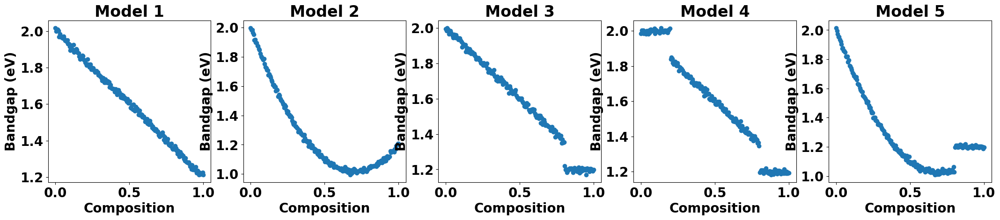

In [ ]:
f, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1, 5, figsize= (26, 4.5))
ax1.set_title("Model 1")
ax1.scatter(x_, y1)
ax1.set_xlabel("Composition")
ax1.set_ylabel("Bandgap (eV)")

ax2.set_title("Model 2")
ax2.scatter(x_, y2)
ax2.set_xlabel("Composition")
ax2.set_ylabel("Bandgap (eV)")

ax3.set_title("Model 3")
ax3.scatter(x_, y3)
ax3.set_xlabel("Composition")
ax3.set_ylabel("Bandgap (eV)")

ax4.set_title("Model 4")
ax4.scatter(x_, y4)
ax4.set_xlabel("Composition")
ax4.set_ylabel("Bandgap (eV)")

ax5.set_title("Model 5")
ax5.scatter(x_, y5)
ax5.set_xlabel("Composition")
ax5.set_ylabel("Bandgap (eV)")

Before proceeding to training a GP model, we are going to define a custom prior on GP kernel parameters. This step is optional (if not specified, GPax will use default non-informative LogNormal(0, 1) priors), but can be helpful for better convergence:

In [ ]:
import numpyro
import numpyro.distributions as dist

def kernel_prior():
    k_length = numpyro.sample("k_length", dist.Gamma(0.5, 1))  # prior on kernel lengthscale
    k_scale = numpyro.sample("k_scale", dist.LogNormal(0, 2))  # prior on kernel output scale
    return {"k_length": k_length, "k_scale": k_scale}

In [ ]:
# Define custom noise prior
noise_prior = lambda: numpyro.sample("noise", numpyro.distributions.HalfNormal(0.01))

In [ ]:
def init_training_data_exp(X, Y, y_all, num_seed_points=2, rng_seed=42, list_of_indices=None):
    np.random.seed(rng_seed)
    indices = jnp.arange(len(X))
    idx = list_of_indices
    if idx is not None:
        idx = np.array(idx)
    else:
        idx = np.random.randint(0, len(X), num_seed_points)
    idx = np.unique(idx)
    X_train, y_train = X[idx], Y
    indices_train = indices[idx]
    X_test = jnp.delete(X, idx)
    y_test = jnp.delete(y_all, idx)
    indices_test = jnp.delete(indices, idx)
    return X_train, y_train, X_test, y_test, indices_train, indices_test


def update_datapoints_exp(next_point_idx, X_train, y_train, X_test, y_new):
    X_train, y_train = X_train, y_train
    X_test = X_test
    X_train = jnp.append(X_train, X_test[next_point_idx][None], 0)
    X_test = jnp.delete(X_test, next_point_idx, 0)
    y_train = jnp.append(y_train, y_new)
    return X_train, y_train, X_test

In [ ]:
from typing import Dict

# Linear function
def linear(x, params):
    """Linear mean function"""
    return params["a"] * x + params["b"]

# Priors over the linear function
def linear_prior():
    """Priors over linear coefficients"""
    a = numpyro.sample("a", numpyro.distributions.LogNormal(0, 1))
    b = numpyro.sample("b", numpyro.distributions.Normal(0, 2))
    return {"a": a, "b": b}

# Piecewise linear function
def piecewise(x: jnp.ndarray, params: Dict[str, float]) -> jnp.ndarray:
    """Piecewise linear function"""
    return jnp.piecewise(
        x, [x < params["t"], x >= params["t"]],
        [lambda x: params["a1"] * x + params["b1"],
         lambda x: params["a2"] * x + params["b2"]])

# Priors over the picewise function
def piecewise_prior():
    """Priors over coefficients"""
    a1 = numpyro.sample("a1", numpyro.distributions.LogNormal(0, 1))
    b1 = numpyro.sample("b1", numpyro.distributions.Normal(0, 2))
    a2 = numpyro.sample("a2", numpyro.distributions.LogNormal(0, 1))
    b2 = numpyro.sample("b2", numpyro.distributions.Normal(0, 2))
    t = numpyro.sample("t", numpyro.distributions.Gamma(0.4, 1))
    return {"a1": a1, "b1": b1, "a2": a2, "b2": b2, "t": t}

# Quadratic function
def quadratic(x, params):
    """Quadratic function"""
    return params["a"] * x**2 + params["b"] * x + params["c"]

# Priors over the quadratic function
def quadratic_prior():
    """Priors over coefficients"""
    a = numpyro.sample("a", numpyro.distributions.LogNormal(0, 1))
    b = numpyro.sample("b", numpyro.distributions.Normal(0, 1))
    c = numpyro.sample("c", numpyro.distributions.Normal(0, 1))
    return {"a": a, "b": b, "c": c}

In [ ]:


def step_GP(X_measured, y_measured, X_unmeasured):
    """Single GP step"""
    # Get random number generator keys for training and prediction
    rng_key1, rng_key2 = gpax.utils.get_keys()
    # Initialize GP model
    gp_model = gpax.ExactGP(
        1, kernel='RBF', kernel_prior=kernel_prior, noise_prior=noise_prior)
    # Run HMC to obtain posterior samples for the GP model parameters
    gp_model.fit(rng_key1, X_measured, y_measured, jitter=1e-5)  # increase jitter from the default one (1e-6) for numerical stability
    # Get predictions (we don't need this step for optimization - only for visualization purposes)
    y_pred, y_sampled = gp_model.predict_in_batches(rng_key2, X_test, noiseless=False, jitter=1e-4)
    # Compute acquisition function
    # obj = gpax.acquisition.UCB(
    #     rng_key2, gp_model, X_unmeasured, beta=4,
    #     maximize=False, noiseless=True, jitter=1e-5)
    obj = gpax.acquisition.UE(
        rng_key2, gp_model, X_unmeasured, noiseless=False, jitter=1e-4
    )
    paras = gp_model.get_samples()
    return obj, (y_pred, y_sampled), paras


def step_sGP(X_measured, y_measured, X_unmeasured, mean_fn, mean_fn_prior):
    """Single sGP step"""
    # Get random number generator keys for training and prediction
    rng_key1, rng_key2 = gpax.utils.get_keys()
    # Initialize model
    sgp_model = gpax.ExactGP(
        1, kernel='RBF', kernel_prior=None, mean_fn=mean_fn,
        mean_fn_prior=mean_fn_prior, noise_prior=noise_prior)
    # Run HMC to obtain posterior samples
    sgp_model.fit(rng_key1, X_train, y_train, jitter=1e-4)  # increase jitter from the default one (1e-6) for numerical stability
    # Make a prediction
    y_pred, y_sampled = sgp_model.predict_in_batches(rng_key2, X_test, noiseless=True, jitter=1e-4)
    # Compute acquisition function (to get the next concentration)
    # obj = gpax.acquisition.UCB(
    #     rng_key2, sgp_model, X_unmeasured, beta=4,
    #     maximize=False, noiseless=True)
    obj = gpax.acquisition.UE(
        rng_key2, sgp_model, X_unmeasured, noiseless=False, jitter=1e-4
    )
    paras = sgp_model.get_samples()
    return obj, (y_pred, y_sampled), paras

# We simulate automated exploration with the model data, GP, and sGP


*   To run sGP, specify ```model``` and ```model_prior```.
*   Here, we are save all data in cloud, so please donot forget to download your results afterward.



##GP

#######---Exploration step 0---#######


sample: 100%|██████████| 4000/4000 [00:14<00:00, 277.28it/s, 7 steps of size 2.95e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.63      0.72      0.35      0.00      1.61   1139.24      1.00
   k_scale      4.34      8.49      2.33      0.29      8.25    829.24      1.00
     noise      0.01      0.01      0.01      0.00      0.02   1223.40      1.00

next point:  106
next concentration:
 0.5376884422110553


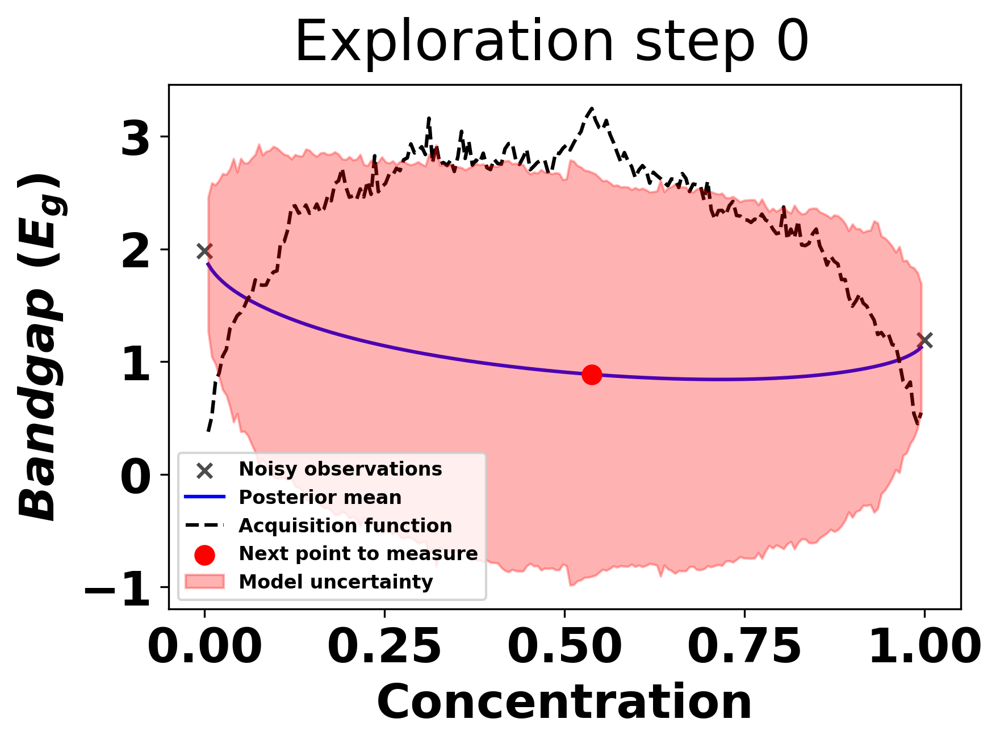

next bandgap: 
 1.5694982944624591
#######---Exploration step 1---#######


sample: 100%|██████████| 4000/4000 [00:05<00:00, 712.68it/s, 15 steps of size 3.27e-01. acc. prob=0.94] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      1.63      0.90      1.51      0.00      2.80   1152.94      1.00
   k_scale      3.28      4.26      1.94      0.35      6.99    643.47      1.00
     noise      0.01      0.01      0.01      0.00      0.02    923.01      1.00

next point:  53
next concentration:
 0.271356783919598


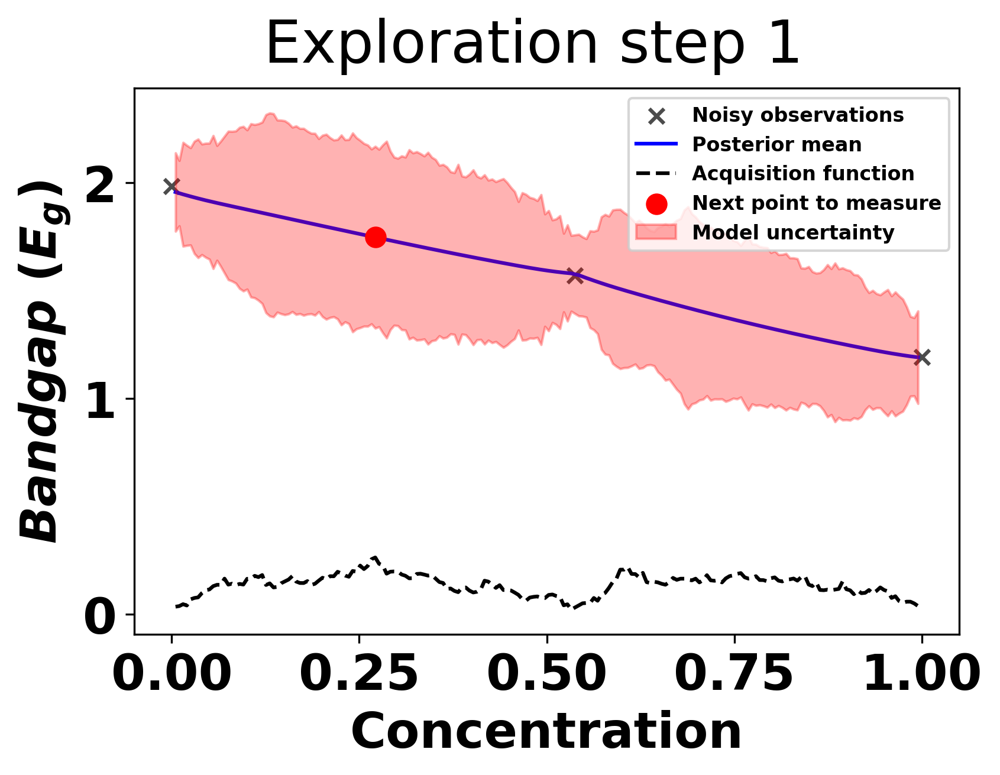

next bandgap: 
 1.7851706594090324
#######---Exploration step 2---#######


sample: 100%|██████████| 4000/4000 [00:06<00:00, 613.08it/s, 7 steps of size 4.35e-01. acc. prob=0.90] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      1.91      0.94      1.73      0.60      3.26   1035.12      1.00
   k_scale      3.22      4.10      2.01      0.33      6.52    947.12      1.00
     noise      0.00      0.00      0.00      0.00      0.01   1375.81      1.00

next point:  159
next concentration:
 0.8140703517587939


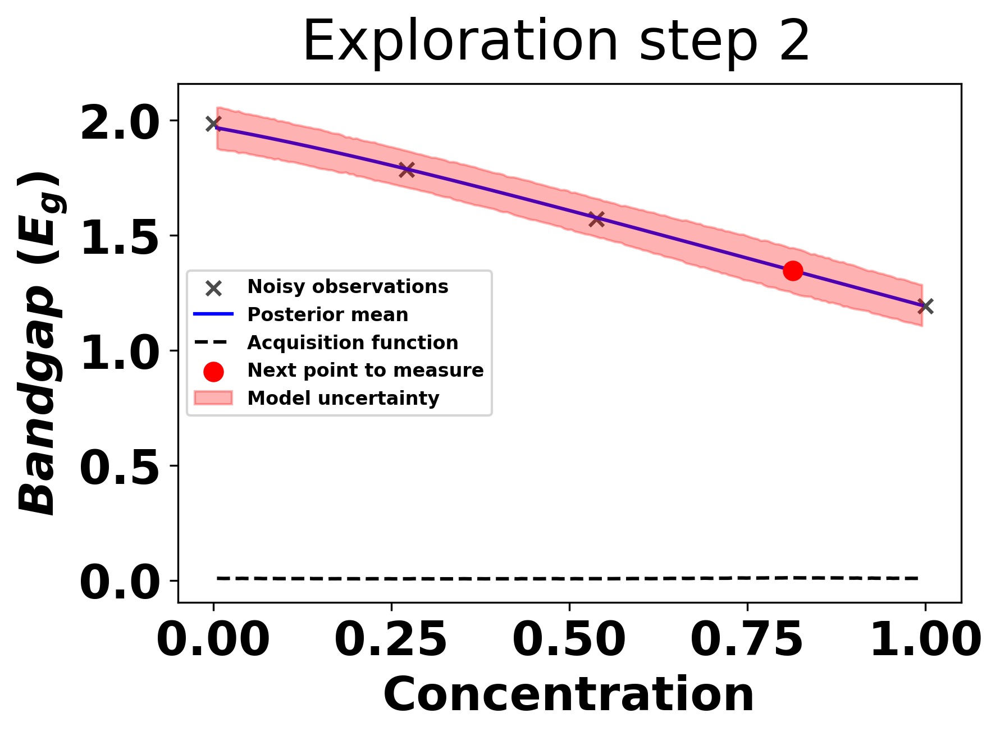

next bandgap: 
 1.207231004937378
#######---Exploration step 3---#######


sample: 100%|██████████| 4000/4000 [00:09<00:00, 415.43it/s, 7 steps of size 6.35e-01. acc. prob=0.92] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      1.62      0.79      1.46      0.42      2.72   1265.33      1.00
   k_scale      3.61      5.63      2.05      0.32      7.17    971.55      1.00
     noise      0.01      0.00      0.01      0.00      0.01   1408.30      1.00

next point:  3
next concentration:
 0.020100502512562814


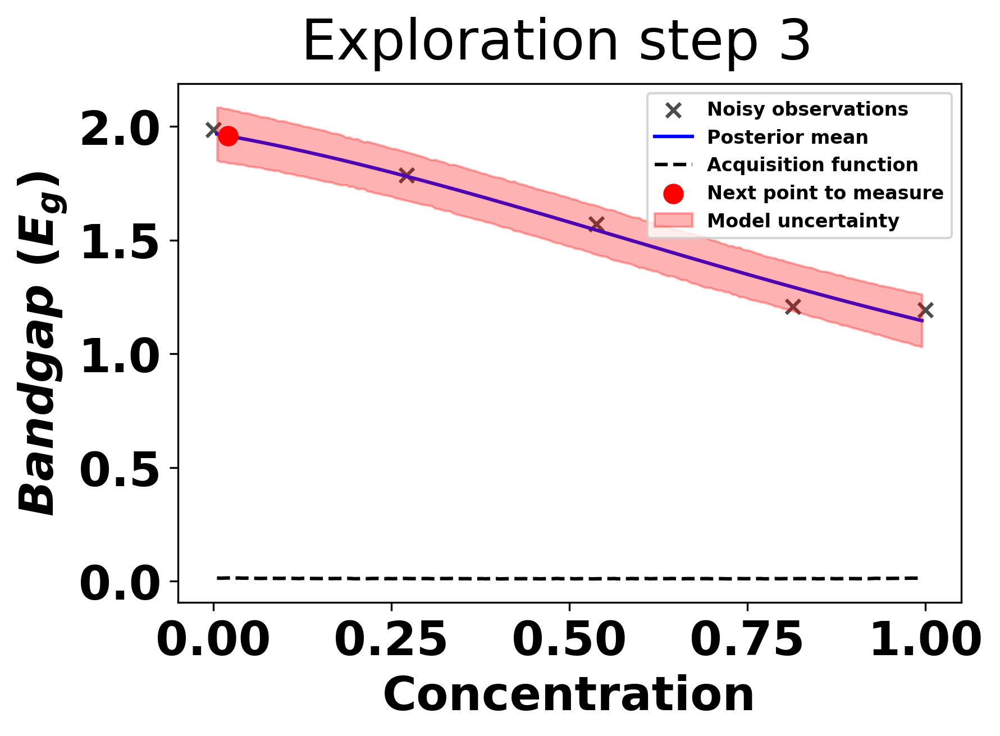

next bandgap: 
 1.9859403708373211
#######---Exploration step 4---#######


sample: 100%|██████████| 4000/4000 [00:06<00:00, 637.13it/s, 7 steps of size 5.76e-01. acc. prob=0.94] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      1.67      0.83      1.50      0.48      2.84   1634.24      1.00
   k_scale      3.70      6.65      2.12      0.30      7.32   1017.34      1.00
     noise      0.01      0.00      0.01      0.00      0.01   1737.66      1.00

next point:  193
next concentration:
 0.9949748743718593


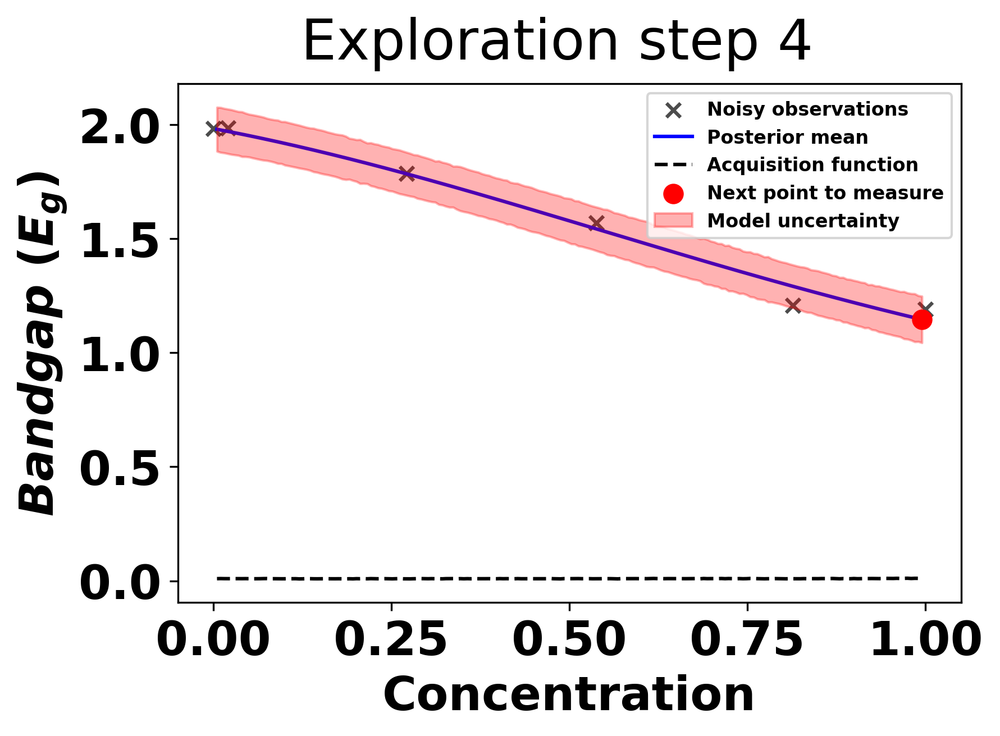

next bandgap: 
 1.1957533669756713
#######---Exploration step 5---#######


sample: 100%|██████████| 4000/4000 [00:06<00:00, 598.61it/s, 7 steps of size 6.19e-01. acc. prob=0.91] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      1.63      0.83      1.45      0.44      2.85   1011.61      1.00
   k_scale      3.77      5.63      2.13      0.27      7.47    897.39      1.00
     noise      0.01      0.00      0.00      0.00      0.01   1520.24      1.00

next point:  140
next concentration:
 0.7236180904522613


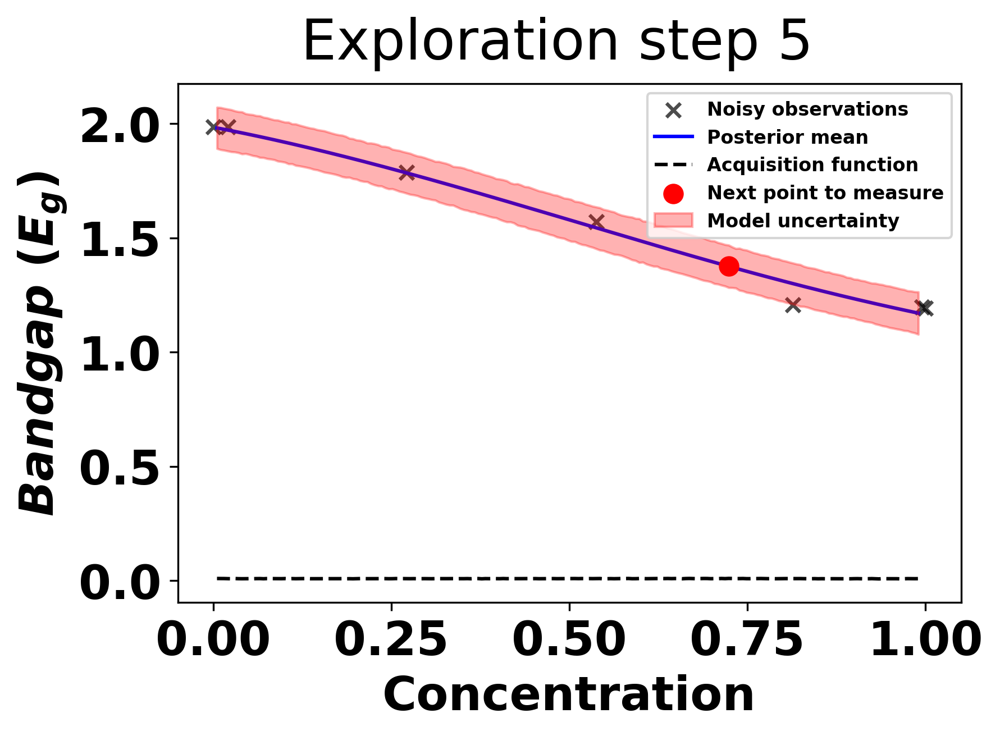

next bandgap: 
 1.4134485056934099
#######---Exploration step 6---#######


sample: 100%|██████████| 4000/4000 [00:07<00:00, 562.09it/s, 7 steps of size 5.72e-01. acc. prob=0.94] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      1.76      0.81      1.60      0.60      2.94   1593.07      1.00
   k_scale      3.54      5.60      2.13      0.40      7.31   1162.93      1.00
     noise      0.01      0.00      0.00      0.00      0.01   1388.64      1.00

next point:  10
next concentration:
 0.06030150753768844


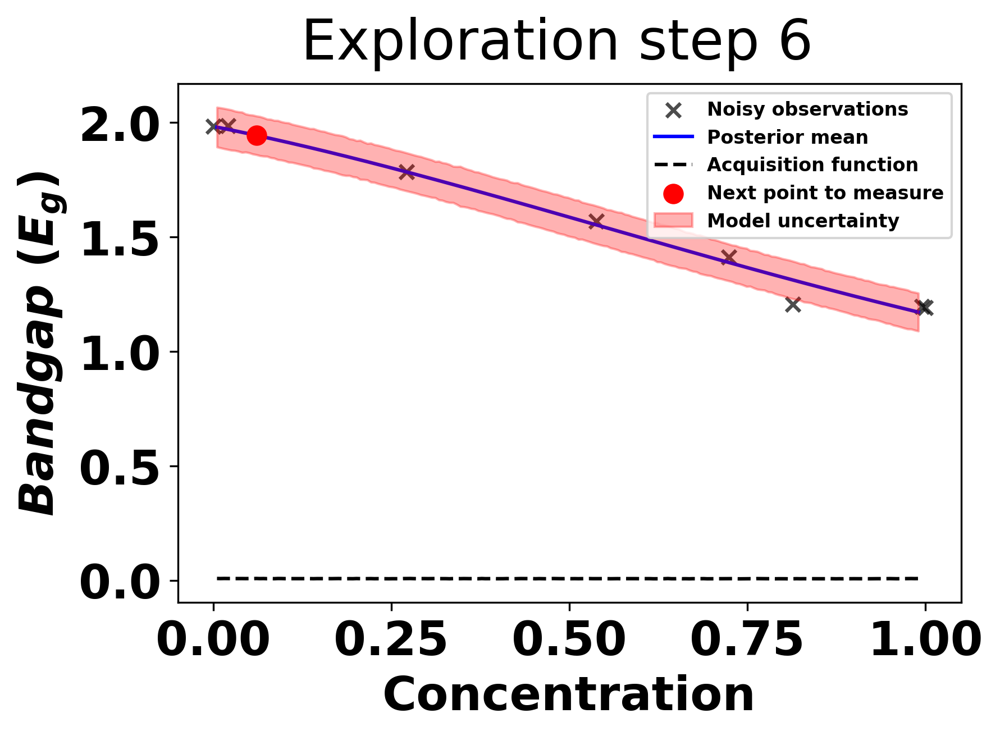

next bandgap: 
 2.0060512008408216
#######---Exploration step 7---#######


sample: 100%|██████████| 4000/4000 [00:05<00:00, 742.87it/s, 7 steps of size 5.31e-01. acc. prob=0.95] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      1.75      0.87      1.56      0.47      2.91   1443.18      1.00
   k_scale      3.84      6.27      2.18      0.37      7.70   1003.33      1.00
     noise      0.00      0.00      0.00      0.00      0.01   1046.76      1.00

next point:  99
next concentration:
 0.5175879396984925


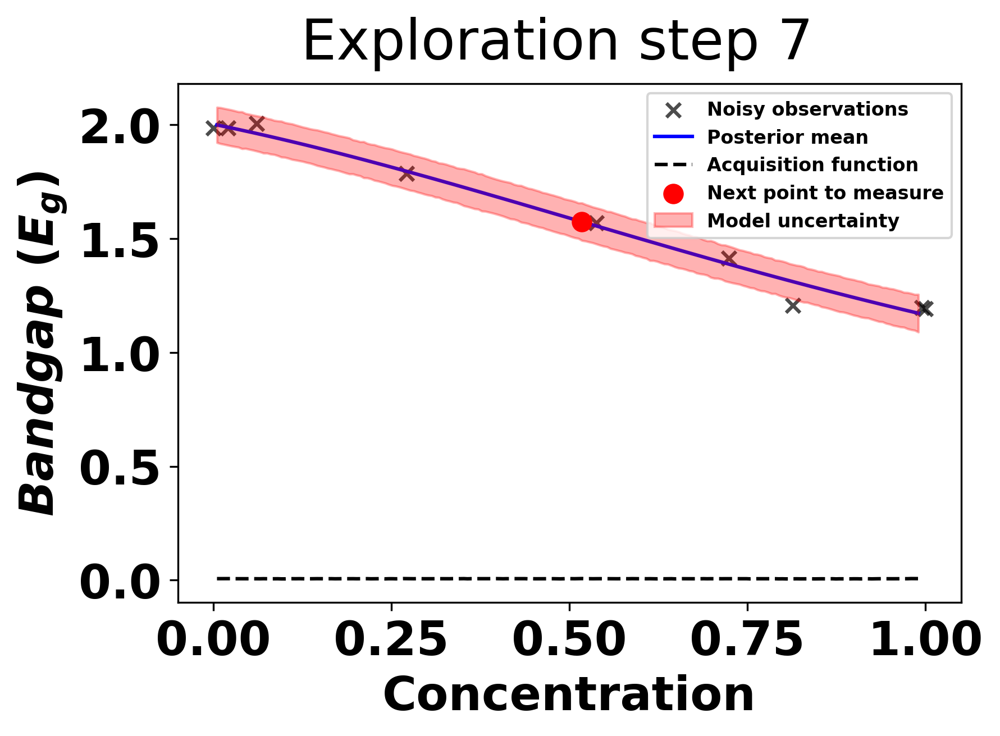

next bandgap: 
 1.5968760319883268
#######---Exploration step 8---#######


sample: 100%|██████████| 4000/4000 [00:06<00:00, 641.92it/s, 7 steps of size 6.45e-01. acc. prob=0.92] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      1.76      0.86      1.56      0.52      2.97   1113.13      1.00
   k_scale      3.88      5.74      2.16      0.31      7.95    828.79      1.00
     noise      0.00      0.00      0.00      0.00      0.01   1242.68      1.00

next point:  184
next concentration:
 0.964824120603015


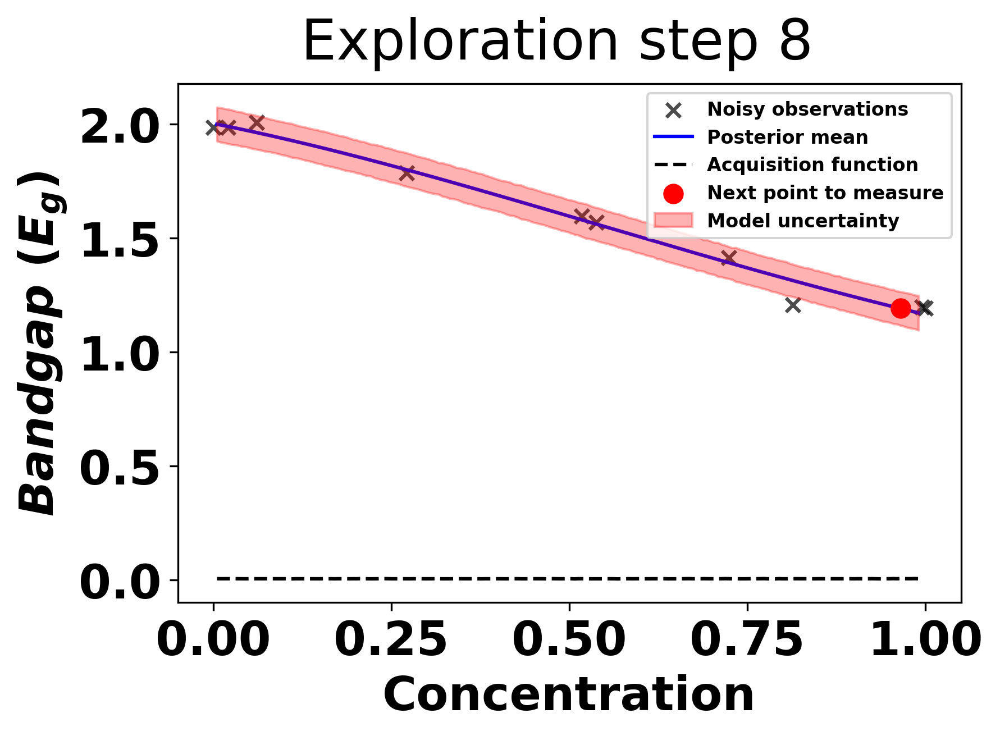

next bandgap: 
 1.1910259907309817
#######---Exploration step 9---#######


sample: 100%|██████████| 4000/4000 [00:06<00:00, 635.06it/s, 7 steps of size 6.59e-01. acc. prob=0.91] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      1.75      0.84      1.57      0.64      3.00    978.99      1.00
   k_scale      3.80      5.82      2.15      0.33      7.77    908.74      1.00
     noise      0.00      0.00      0.00      0.00      0.01   1303.30      1.00

next point:  188
next concentration:
 0.9899497487437187


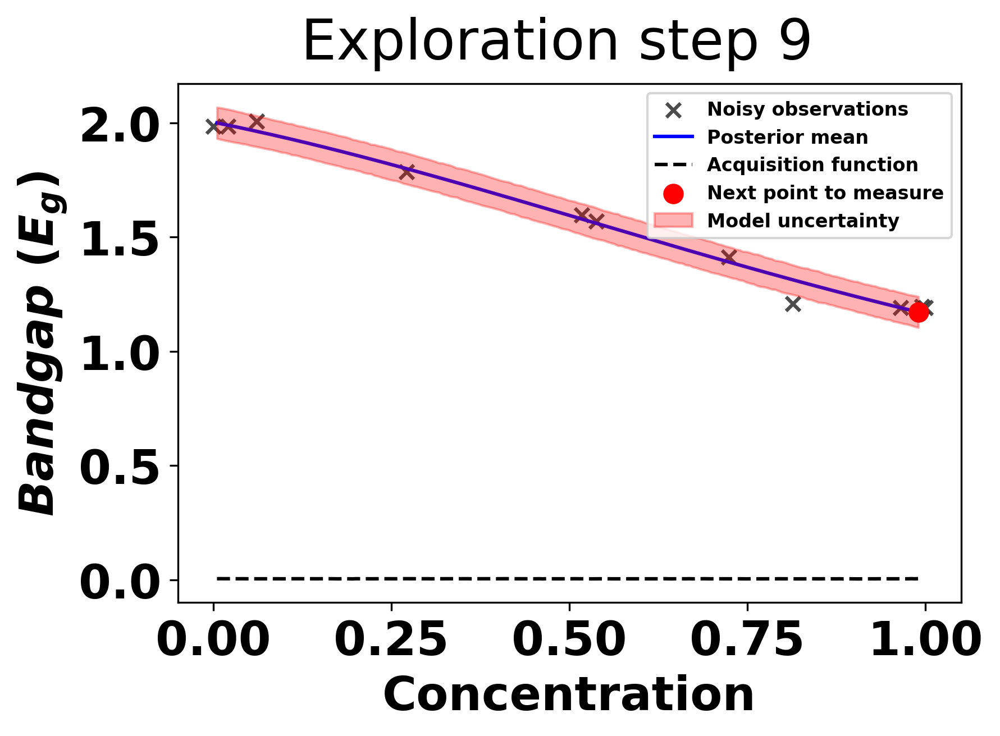

next bandgap: 
 1.18922900930596
#######---Exploration step 10---#######


sample: 100%|██████████| 4000/4000 [00:07<00:00, 540.07it/s, 3 steps of size 6.79e-01. acc. prob=0.89]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      1.75      0.88      1.54      0.55      3.08    876.82      1.00
   k_scale      3.70      4.98      2.14      0.31      7.65    699.89      1.00
     noise      0.00      0.00      0.00      0.00      0.01   1029.80      1.00

next point:  7
next concentration:
 0.04522613065326633


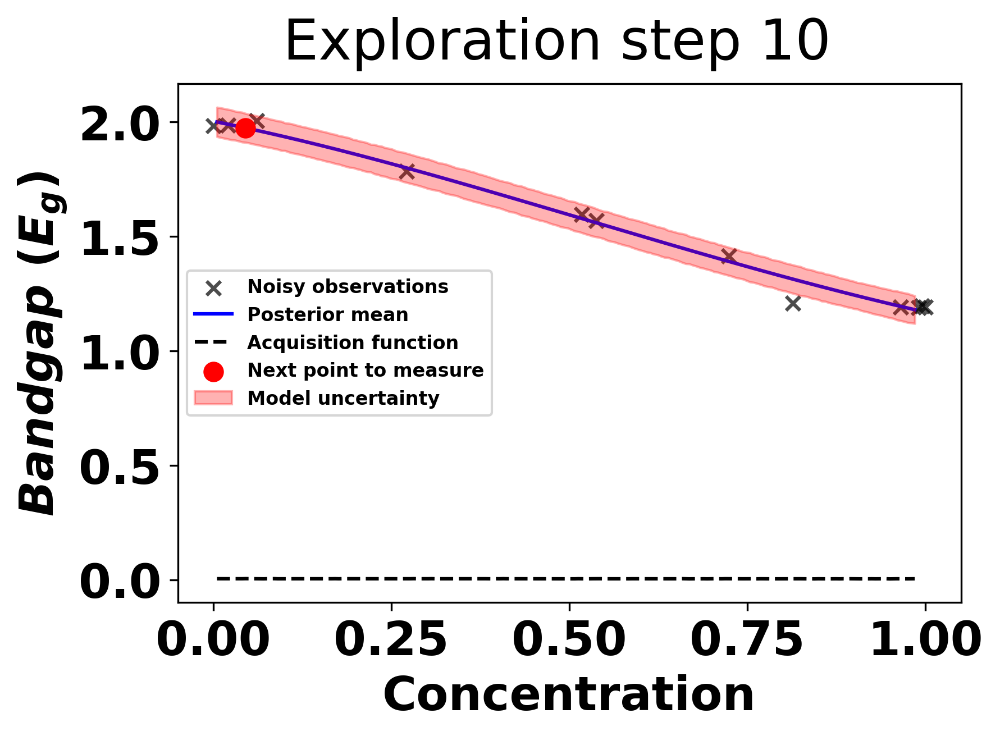

next bandgap: 
 1.9962085243712007
#######---Exploration step 11---#######


sample: 100%|██████████| 4000/4000 [00:06<00:00, 616.08it/s, 7 steps of size 6.06e-01. acc. prob=0.92] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      1.66      0.87      1.45      0.49      2.87   1280.30      1.00
   k_scale      3.80      7.01      2.09      0.27      7.31    979.41      1.00
     noise      0.00      0.00      0.00      0.00      0.00   1094.76      1.00

next point:  38
next concentration:
 0.21105527638190955


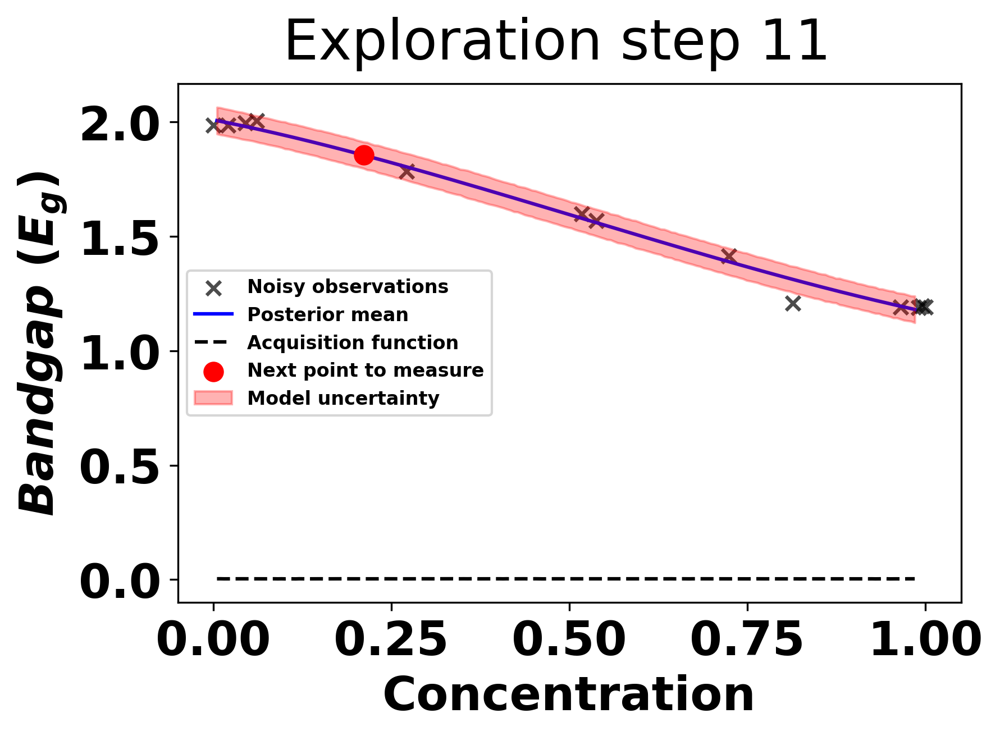

next bandgap: 
 1.8414998777592875
#######---Exploration step 12---#######


sample: 100%|██████████| 4000/4000 [00:06<00:00, 620.09it/s, 7 steps of size 6.42e-01. acc. prob=0.90] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      1.75      0.90      1.54      0.59      3.16    925.62      1.00
   k_scale      3.94      6.26      2.21      0.23      7.63    816.06      1.00
     noise      0.00      0.00      0.00      0.00      0.00   1036.96      1.00

next point:  133
next concentration:
 0.7085427135678392


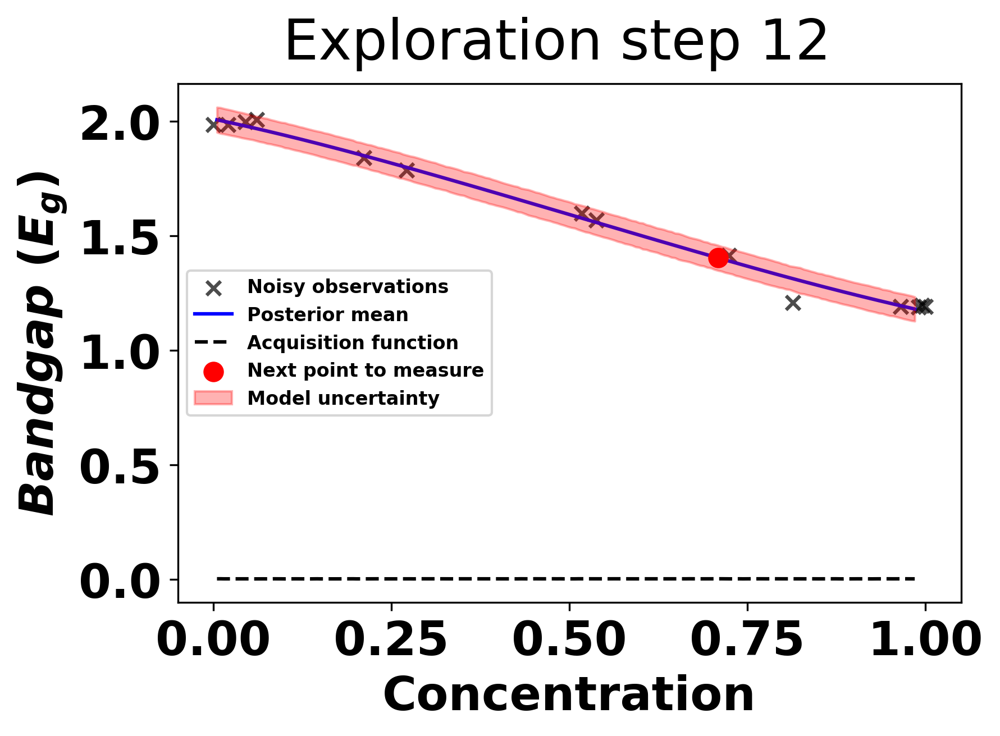

next bandgap: 
 1.4217638661363792
#######---Exploration step 13---#######


sample: 100%|██████████| 4000/4000 [00:06<00:00, 662.73it/s, 7 steps of size 5.92e-01. acc. prob=0.93] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      1.78      0.85      1.58      0.63      3.04   1293.88      1.00
   k_scale      3.70      5.94      2.19      0.34      7.17   1159.79      1.00
     noise      0.00      0.00      0.00      0.00      0.00   1250.65      1.00

next point:  2
next concentration:
 0.01507537688442211


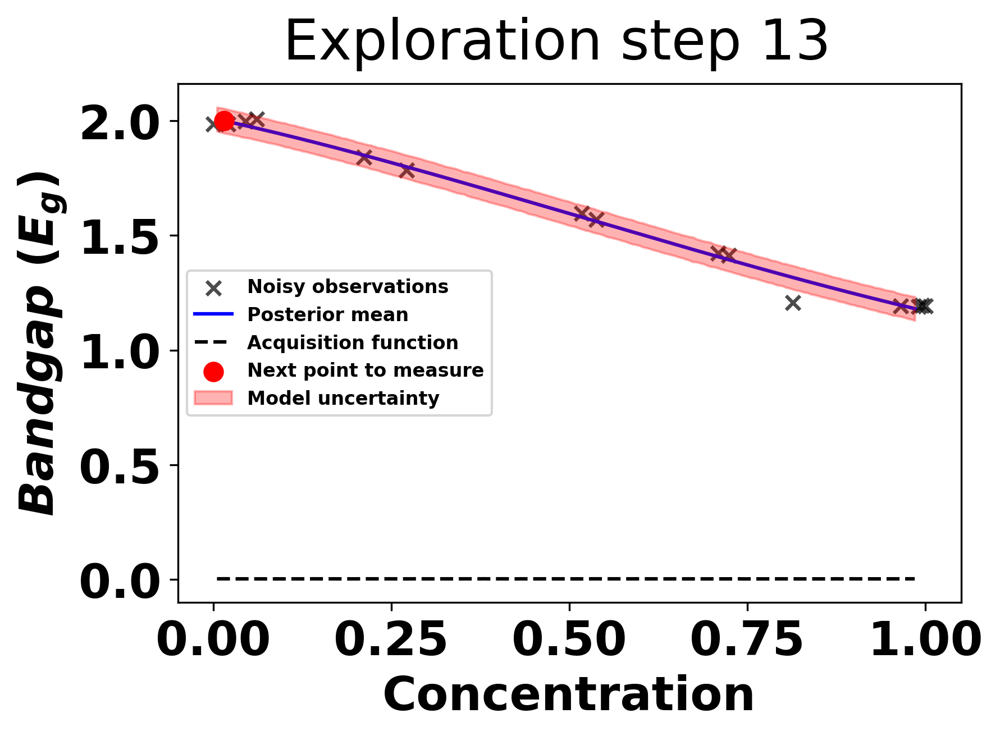

next bandgap: 
 2.0023810314783232
#######---Exploration step 14---#######


sample: 100%|██████████| 4000/4000 [00:07<00:00, 533.28it/s, 7 steps of size 6.36e-01. acc. prob=0.91] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      1.80      0.89      1.57      0.63      3.15    914.71      1.00
   k_scale      4.00      6.74      2.20      0.28      7.77   1010.24      1.00
     noise      0.00      0.00      0.00      0.00      0.00   1157.96      1.00

next point:  120
next concentration:
 0.6482412060301508


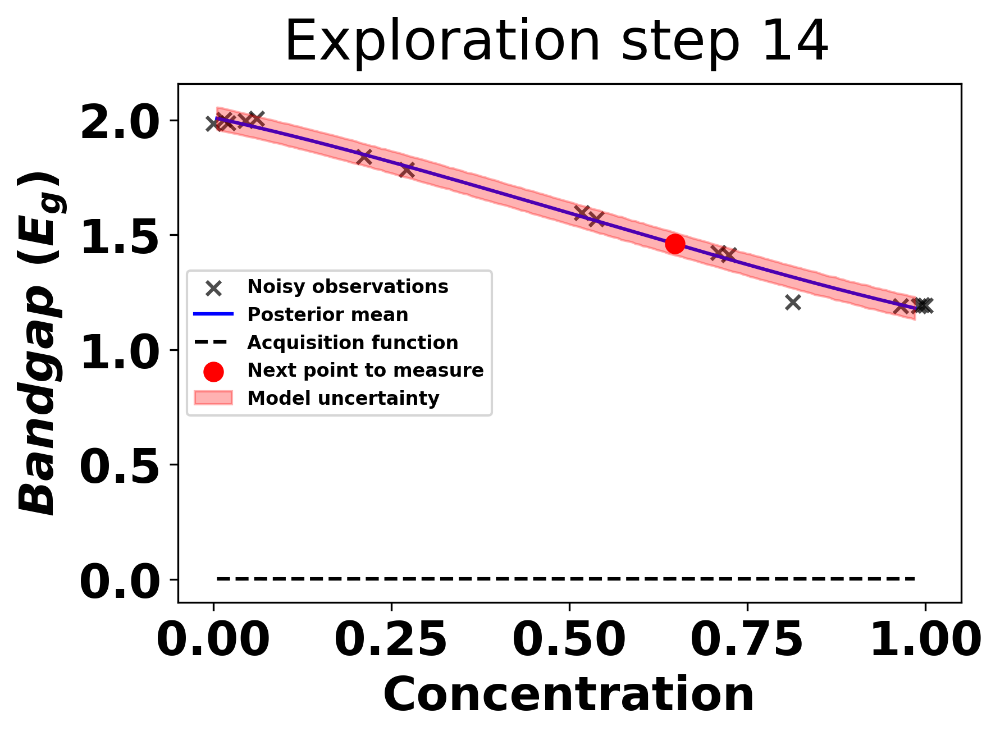

next bandgap: 
 1.4872796289698778
#######---Exploration step 15---#######


sample: 100%|██████████| 4000/4000 [00:06<00:00, 591.02it/s, 7 steps of size 5.73e-01. acc. prob=0.92] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      1.86      0.87      1.66      0.71      3.18   1342.35      1.00
   k_scale      3.72      5.87      2.19      0.32      7.20    854.28      1.00
     noise      0.00      0.00      0.00      0.00      0.00   1239.41      1.01

next point:  78
next concentration:
 0.4271356783919598


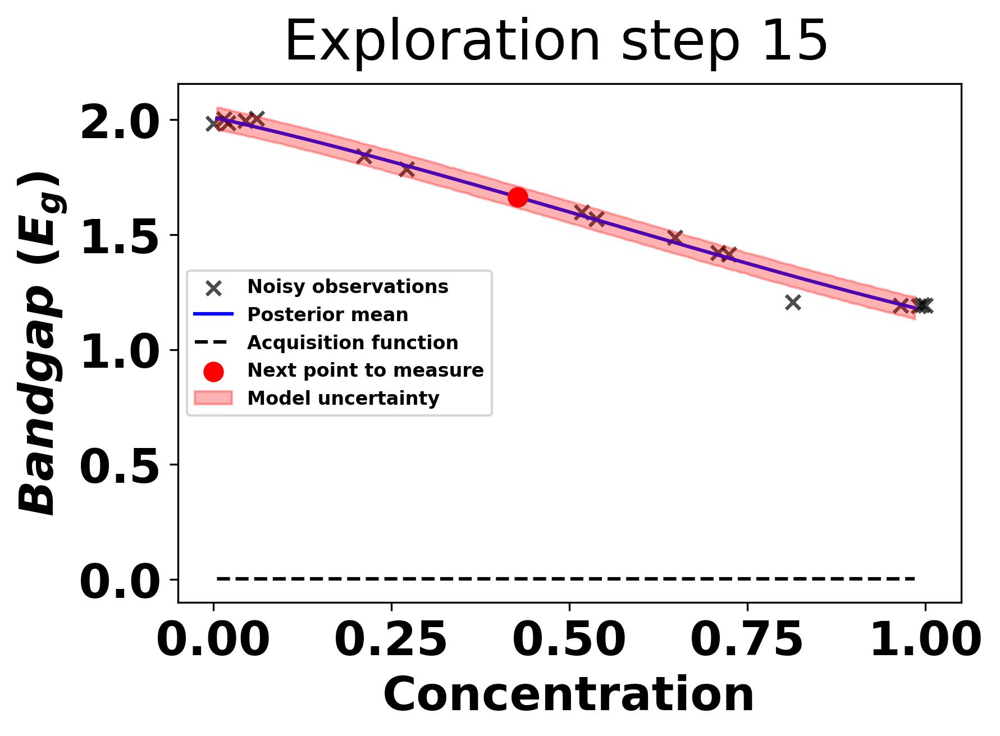

next bandgap: 
 1.6299459122336852
#######---Exploration step 16---#######


sample: 100%|██████████| 4000/4000 [00:06<00:00, 613.84it/s, 7 steps of size 3.67e-01. acc. prob=0.93] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      1.89      0.91      1.72      0.74      3.55    542.91      1.00
   k_scale      3.45      4.21      2.12      0.29      7.33    596.38      1.00
     noise      0.00      0.00      0.00      0.00      0.00   1036.39      1.00

next point:  154
next concentration:
 0.8442211055276382


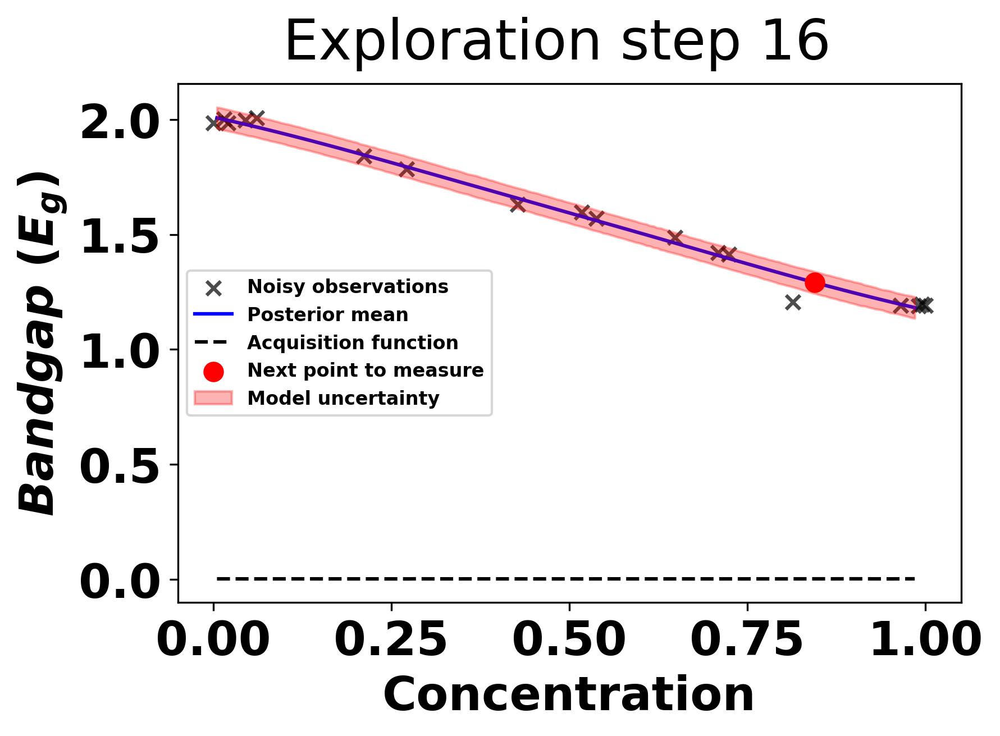

next bandgap: 
 1.2184959124667962
#######---Exploration step 17---#######


sample: 100%|██████████| 4000/4000 [00:07<00:00, 529.12it/s, 7 steps of size 3.18e-01. acc. prob=0.75] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      1.44      1.00      1.32      0.23      2.76     92.52      1.05
   k_scale      3.34      4.64      1.99      0.43      7.01    482.04      1.01
     noise      0.00      0.00      0.00      0.00      0.00     84.36      1.04

next point:  159
next concentration:
 0.8743718592964824


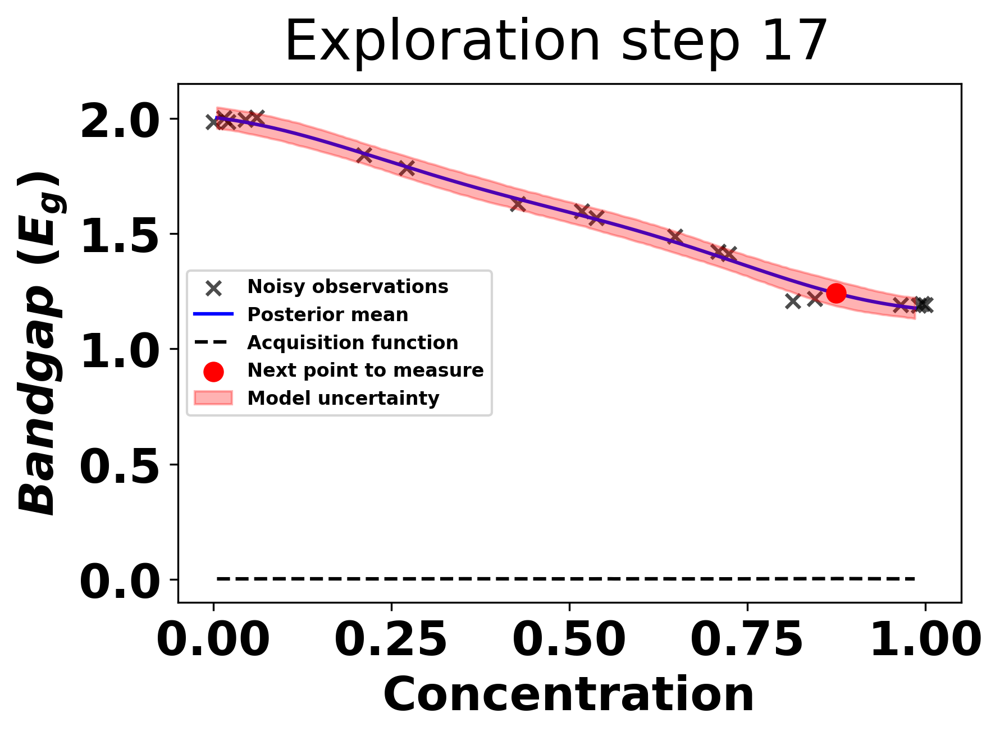

next bandgap: 
 1.1963494478345373
#######---Exploration step 18---#######


sample: 100%|██████████| 4000/4000 [00:08<00:00, 469.04it/s, 15 steps of size 1.51e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.93      0.88      0.41      0.23      2.14     20.27      1.00
   k_scale      3.14      3.87      1.93      0.35      6.35    346.50      1.00
     noise      0.00      0.00      0.00      0.00      0.00     24.21      1.01

next point:  160
next concentration:
 0.8844221105527639


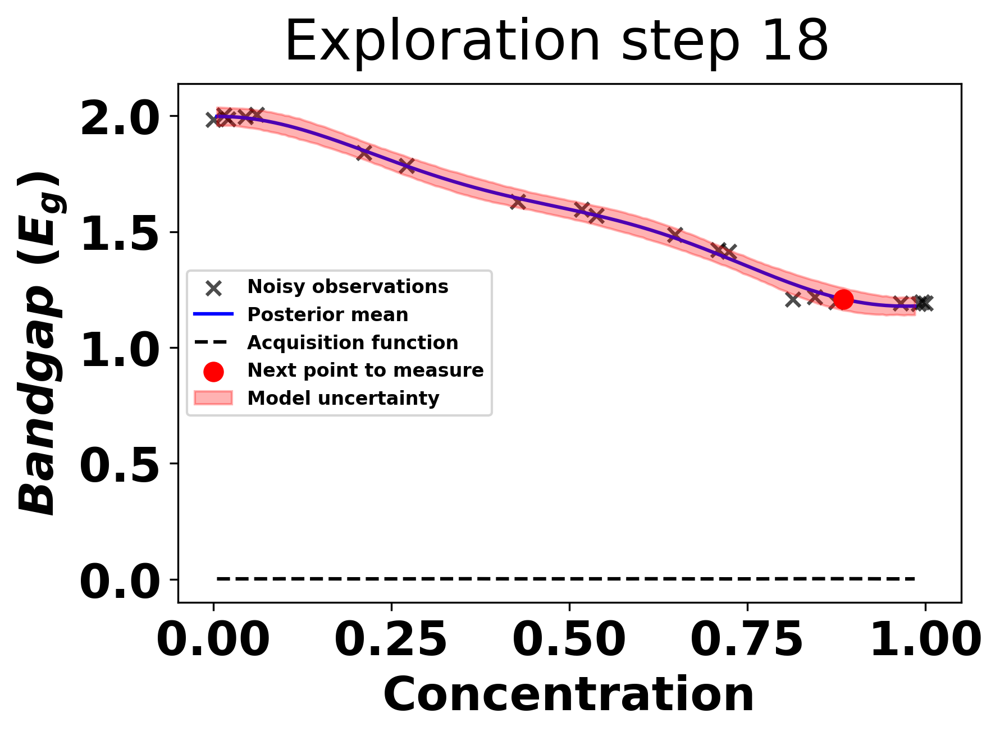

next bandgap: 
 1.1994141344886613
#######---Exploration step 19---#######


sample: 100%|██████████| 4000/4000 [00:08<00:00, 463.86it/s, 3 steps of size 2.20e-01. acc. prob=0.96] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.56      0.58      0.37      0.22      1.19     60.61      1.03
   k_scale      2.58      3.15      1.74      0.33      4.90    446.74      1.00
     noise      0.00      0.00      0.00      0.00      0.00     68.71      1.02

next point:  18
next concentration:
 0.11557788944723618


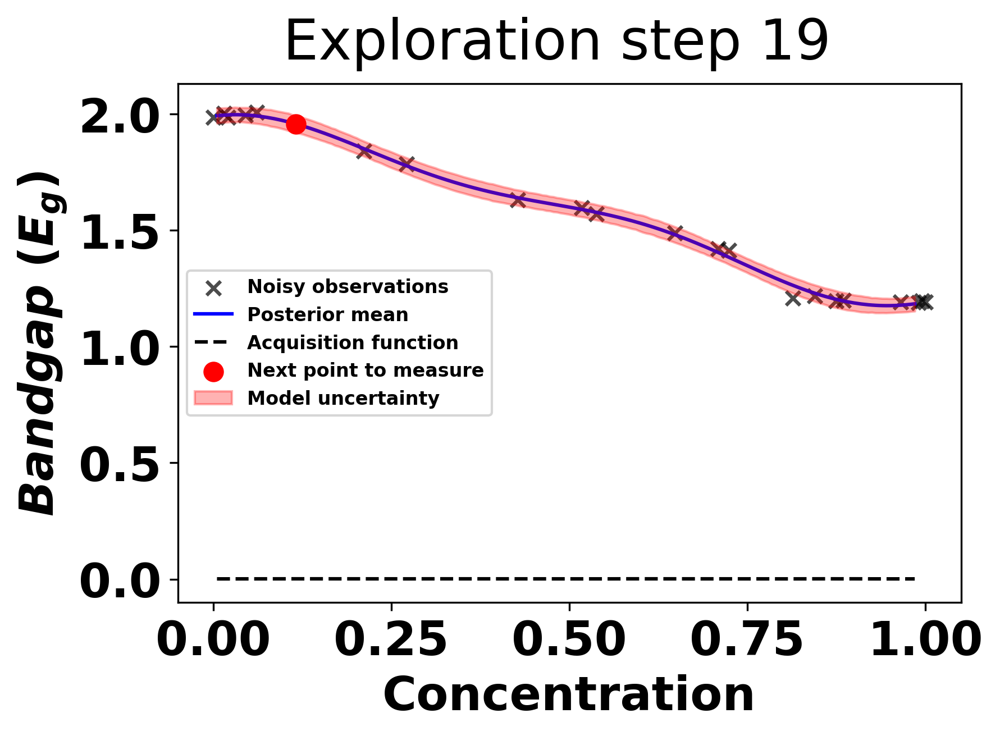

next bandgap: 
 1.9969775026954493
#######---Exploration step 20---#######


sample: 100%|██████████| 4000/4000 [00:07<00:00, 543.41it/s, 7 steps of size 5.40e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.42      0.33      0.35      0.26      0.45     24.32      1.05
   k_scale      2.40      2.44      1.73      0.45      4.47    663.85      1.00
     noise      0.00      0.00      0.00      0.00      0.00     25.87      1.04

next point:  58
next concentration:
 0.3316582914572864


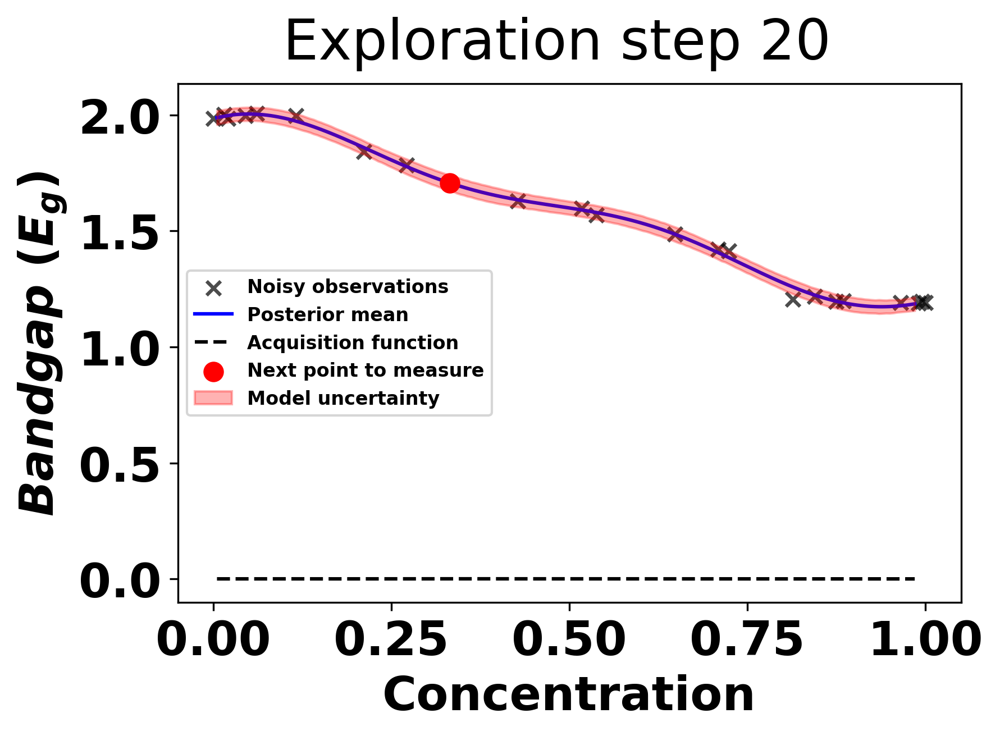

next bandgap: 
 1.7344391357839564
#######---Exploration step 21---#######


sample: 100%|██████████| 4000/4000 [00:08<00:00, 482.23it/s, 7 steps of size 2.74e-01. acc. prob=0.94]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.46      0.42      0.36      0.25      0.47     49.77      1.00
   k_scale      2.50      2.97      1.76      0.41      4.58    674.18      1.00
     noise      0.00      0.00      0.00      0.00      0.00     49.49      1.00

next point:  20
next concentration:
 0.1306532663316583


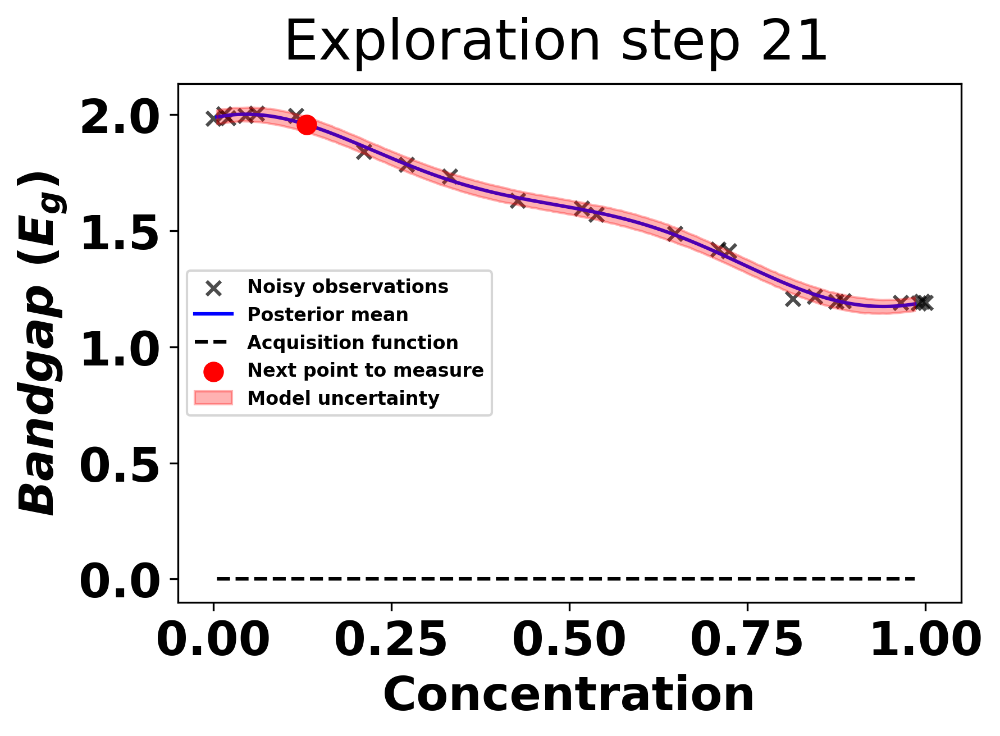

next bandgap: 
 2.001833391992576
#######---Exploration step 22---#######


sample: 100%|██████████| 4000/4000 [00:07<00:00, 501.96it/s, 7 steps of size 6.00e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.47      0.41      0.36      0.21      0.56     14.99      1.09
   k_scale      2.69      3.35      1.73      0.40      5.30    676.06      1.00
     noise      0.00      0.00      0.00      0.00      0.00     14.56      1.08

next point:  58
next concentration:
 0.3417085427135678


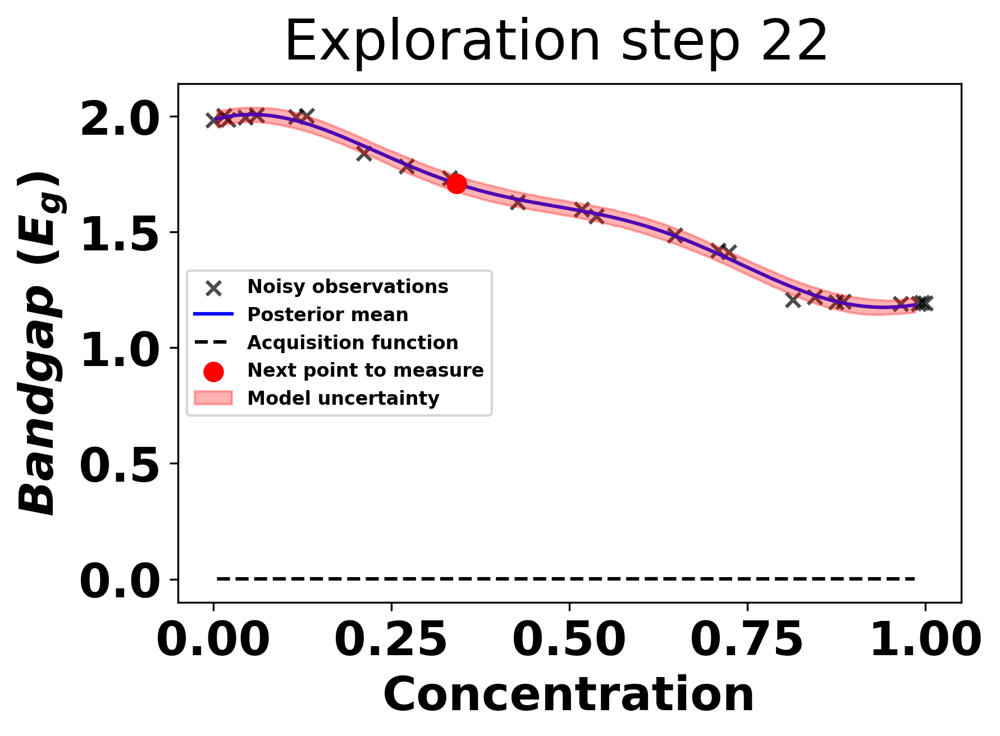

next bandgap: 
 1.7065910086741567
#######---Exploration step 23---#######


sample: 100%|██████████| 4000/4000 [00:07<00:00, 525.02it/s, 7 steps of size 5.48e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.35      0.05      0.35      0.28      0.42   1325.44      1.00
   k_scale      2.42      2.38      1.74      0.35      4.52    818.98      1.00
     noise      0.00      0.00      0.00      0.00      0.00   1450.28      1.00

next point:  85
next concentration:
 0.48743718592964824


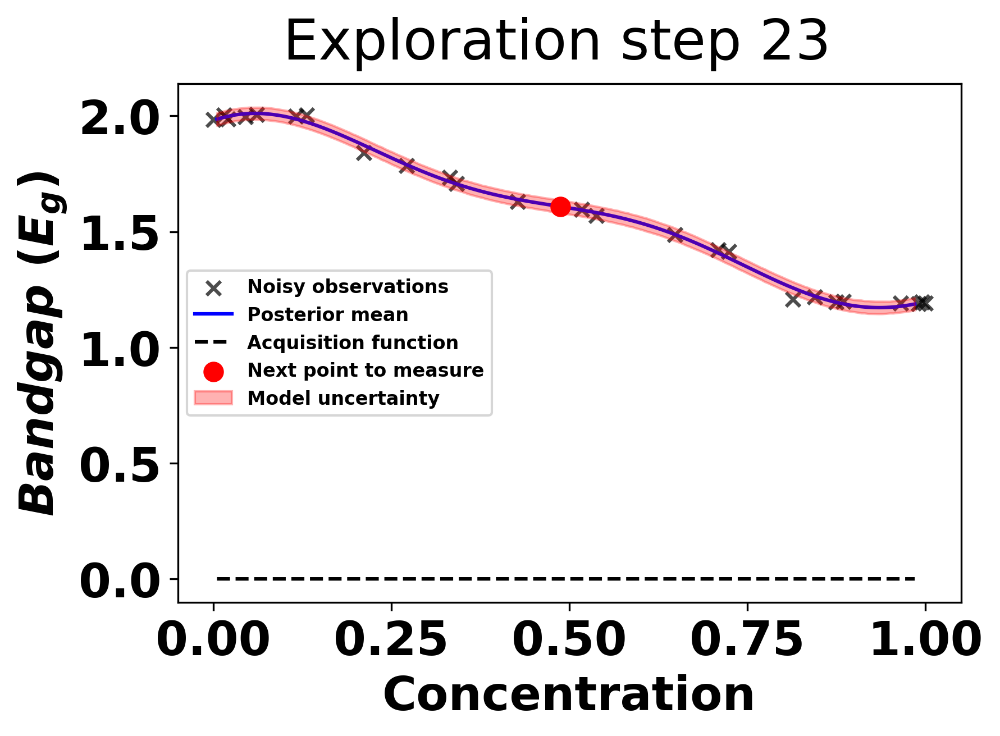

next bandgap: 
 1.6021038880455662
#######---Exploration step 24---#######


sample: 100%|██████████| 4000/4000 [00:10<00:00, 377.01it/s, 15 steps of size 5.04e-01. acc. prob=0.94]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.35      0.05      0.35      0.29      0.44   1310.97      1.00
   k_scale      2.32      2.30      1.65      0.44      4.40    937.62      1.00
     noise      0.00      0.00      0.00      0.00      0.00   1196.19      1.00

next point:  95
next concentration:
 0.5527638190954774


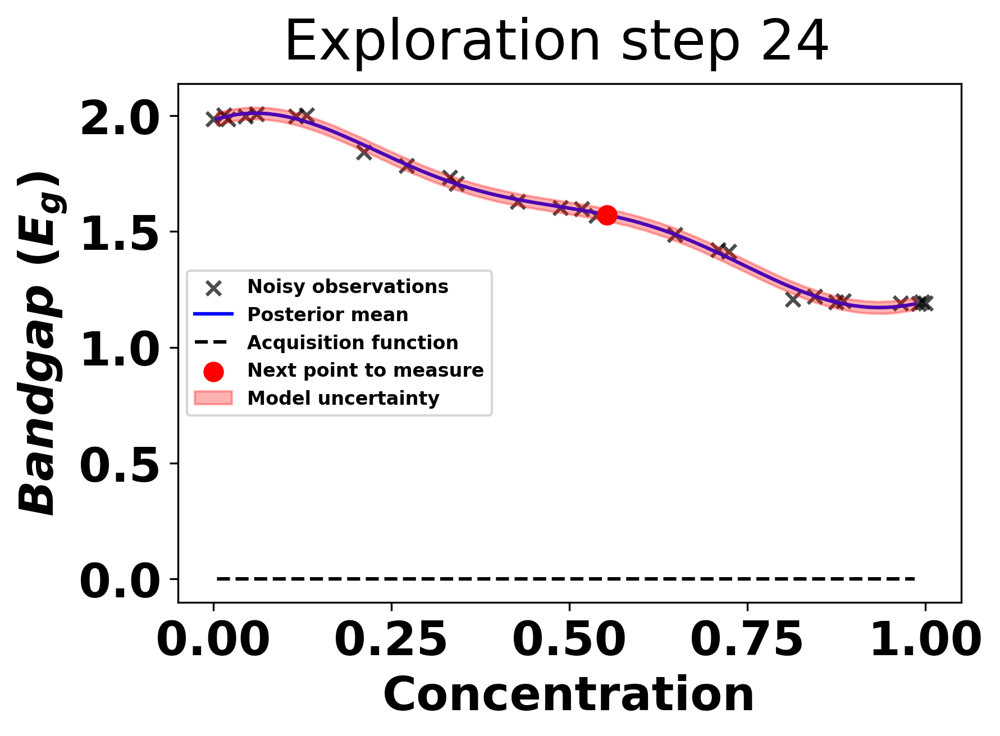

next bandgap: 
 1.5507397311985436
#######---Exploration step 25---#######


sample: 100%|██████████| 4000/4000 [00:08<00:00, 481.98it/s, 7 steps of size 5.48e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.36      0.05      0.36      0.28      0.43   1070.65      1.00
   k_scale      2.52      2.81      1.73      0.43      4.94   1019.87      1.00
     noise      0.00      0.00      0.00      0.00      0.00   1008.17      1.00

next point:  113
next concentration:
 0.6532663316582915


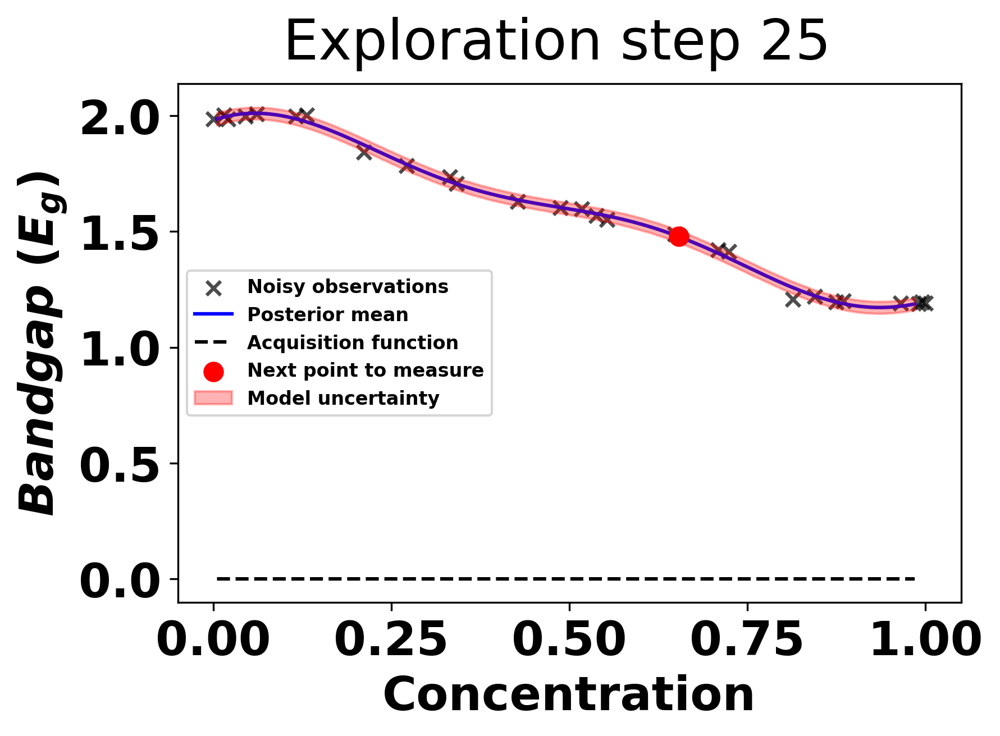

next bandgap: 
 1.4723333515007226
#######---Exploration step 26---#######


sample: 100%|██████████| 4000/4000 [00:08<00:00, 447.98it/s, 7 steps of size 5.51e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.36      0.05      0.36      0.28      0.44   1089.31      1.00
   k_scale      2.59      2.66      1.76      0.49      5.33    800.36      1.00
     noise      0.00      0.00      0.00      0.00      0.00   1323.23      1.00

next point:  37
next concentration:
 0.22613065326633167


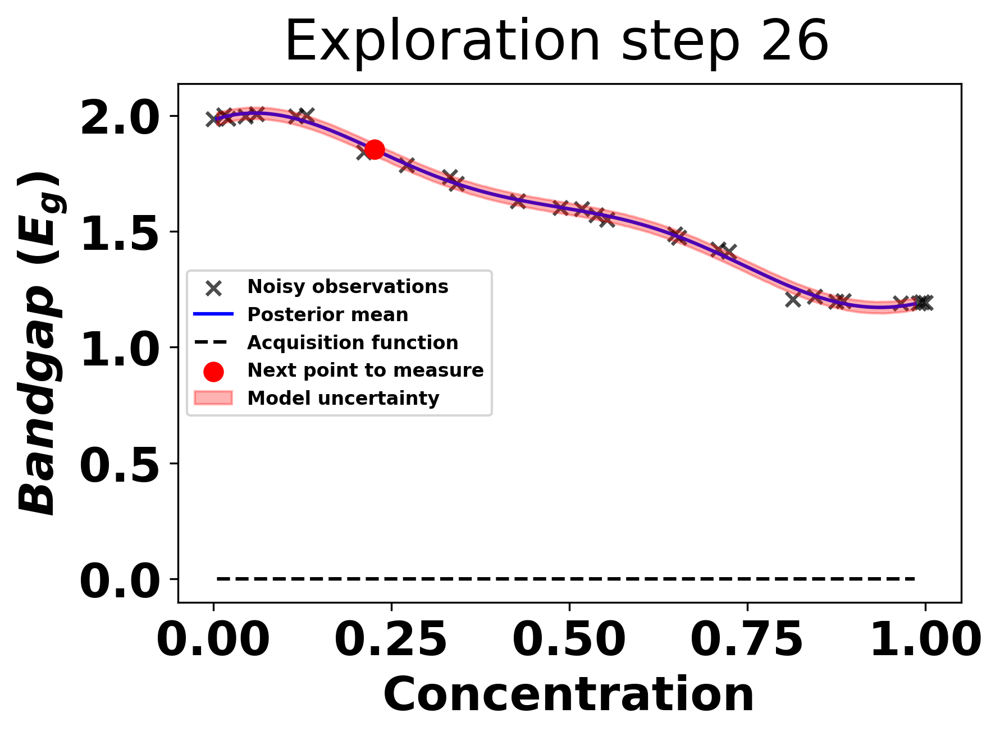

next bandgap: 
 1.8160458410083906
#######---Exploration step 27---#######


sample: 100%|██████████| 4000/4000 [00:08<00:00, 449.72it/s, 15 steps of size 5.29e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.36      0.05      0.36      0.29      0.44   1079.24      1.00
   k_scale      2.61      2.93      1.77      0.37      4.97    695.03      1.00
     noise      0.00      0.00      0.00      0.00      0.00   1328.25      1.00

next point:  0
next concentration:
 0.005025125628140704


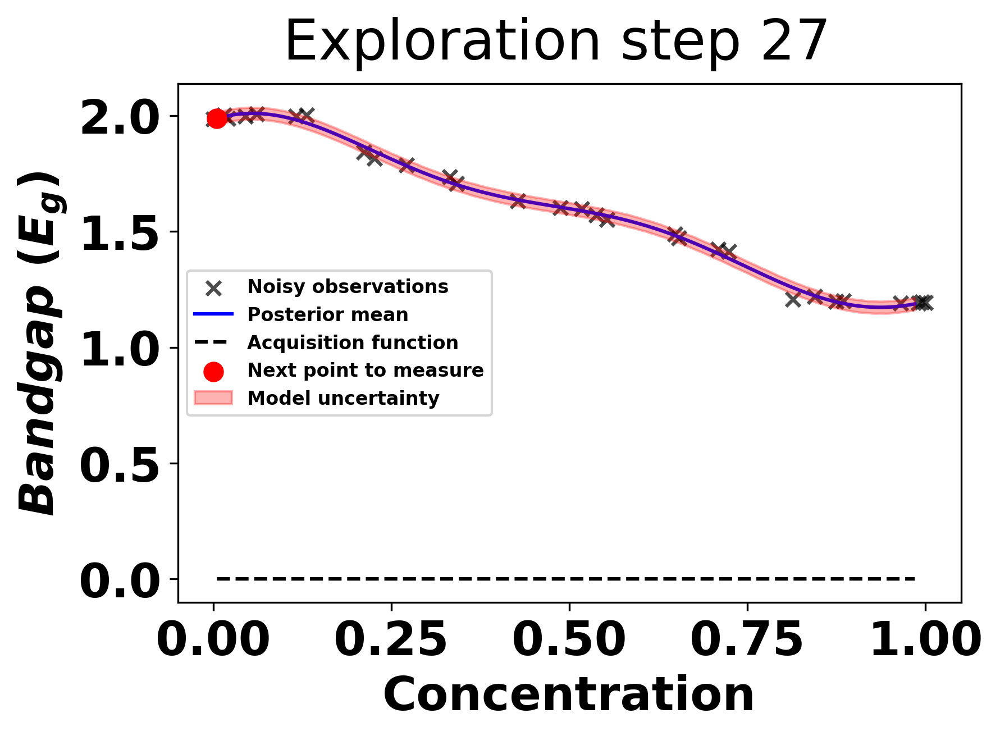

next bandgap: 
 2.004173188210318
#######---Exploration step 28---#######


sample: 100%|██████████| 4000/4000 [00:09<00:00, 416.52it/s, 15 steps of size 4.99e-01. acc. prob=0.94]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.36      0.05      0.36      0.29      0.44   1073.31      1.00
   k_scale      2.54      2.64      1.80      0.39      4.64    766.32      1.00
     noise      0.00      0.00      0.00      0.00      0.00   1244.17      1.00

next point:  67
next concentration:
 0.4020100502512563


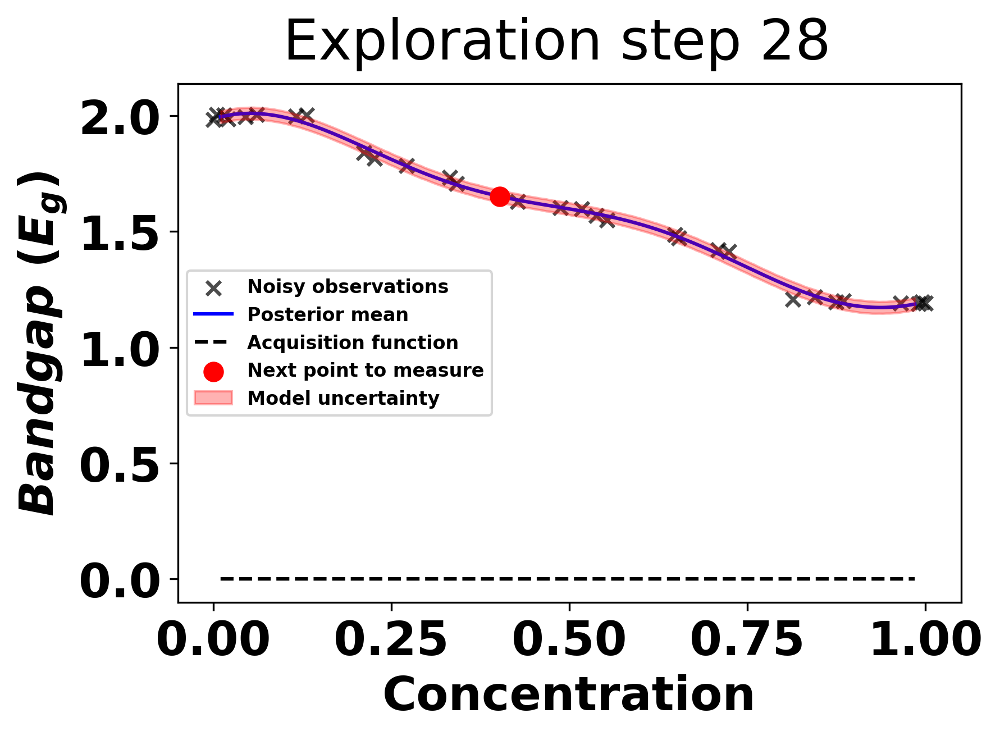

next bandgap: 
 1.6724779331209139
#######---Exploration step 29---#######


sample: 100%|██████████| 4000/4000 [00:09<00:00, 430.19it/s, 15 steps of size 4.59e-01. acc. prob=0.95]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.37      0.05      0.37      0.30      0.45   1017.50      1.00
   k_scale      2.46      2.33      1.77      0.46      4.72    839.42      1.00
     noise      0.00      0.00      0.00      0.00      0.00   1406.52      1.00

next point:  16
next concentration:
 0.11055276381909548


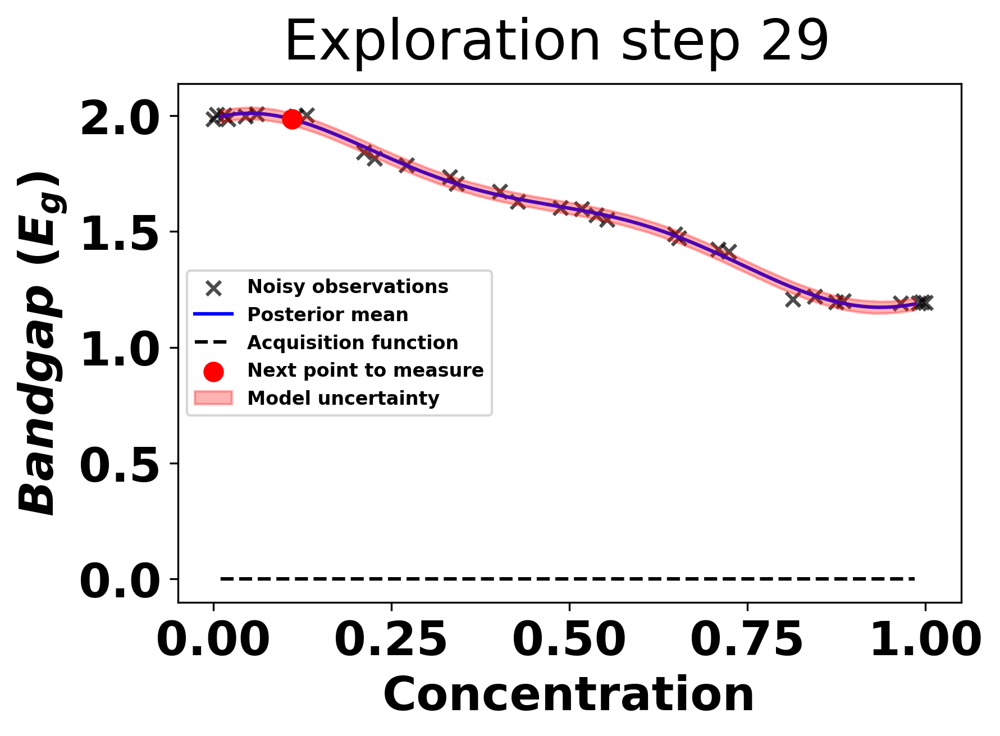

next bandgap: 
 1.9977574106574836


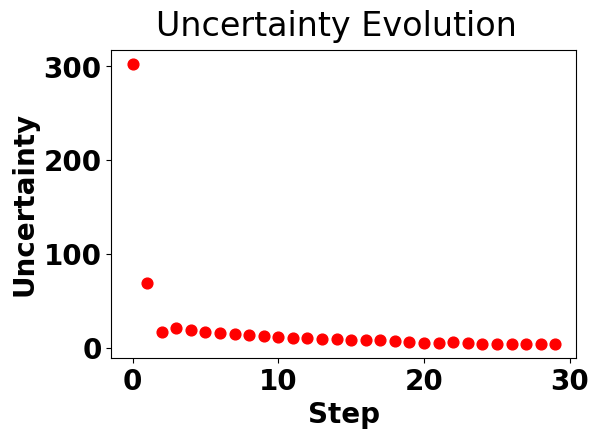

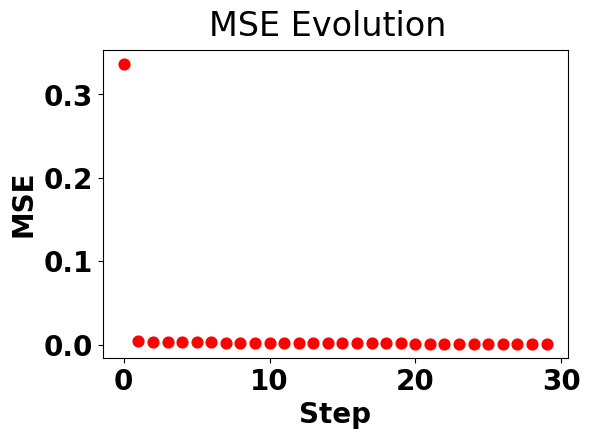

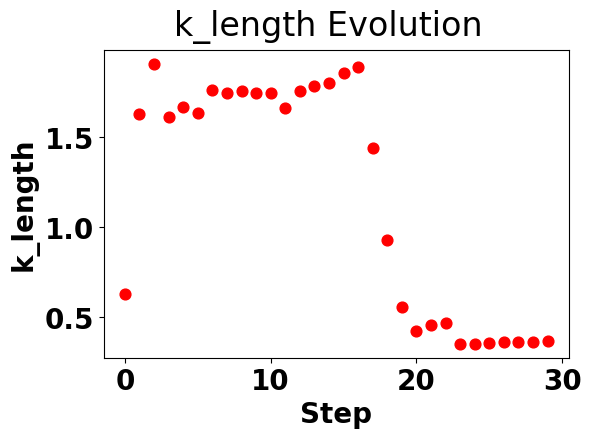

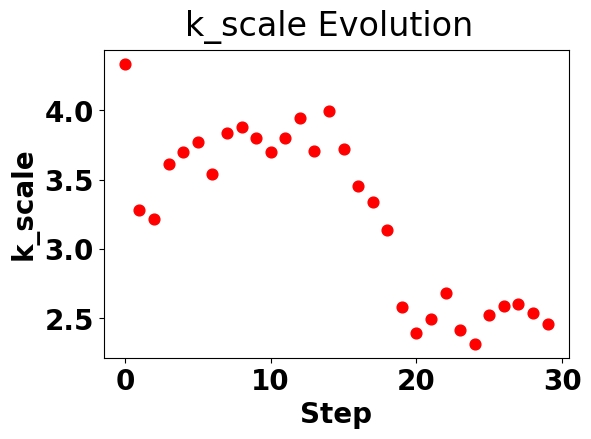

In [ ]:
##############---create dir, list, etc to save each step information---###############
# create a dir to save plots of each step, then these images will be used to make movie at the end
savedir = "/content/video_image_GP/"
if os.path.exists(savedir) == False:
  os.mkdir(savedir)

# create lists to save uncertainty, mse, k_length, and k_scale at each step
all_uncertainty_GP_mod4 = []
all_mse_GP_mod4 = []
all_k_length = []
all_k_scale = []

model = None
model_prior = None

##############---prepare data---###########
# prepare training data
X = jnp.linspace(0.0, 1, NUM_INIT_POINTS)
idx = jnp.asarray([0, NUM_INIT_POINTS-1])#set seed points to two extreme conditions
indx = idx.tolist()

# select model here
y_all = y4[:, None]                               # Select the toy model
Y = jnp.asarray([y_all[0][0], y_all[199][0]])

# initialize training data
(X_train, y_train, X_test, y_test,
 indices_train, indices_test) = init_training_data_exp(X, Y, y_all, list_of_indices = indx)

exploration_steps = 30

##########------start exploration----###########
for s in range (exploration_steps):
  print("#######---Exploration step {}---#######".format(s))
  # Compute acquisition function
  if model is None or model_prior is None: # Select GP or sGP
    acq, (y_pred, y_sampled), paras_ = step_GP(X_train, y_train, X_test)
  else:
    acq, (y_pred, y_sampled), paras_ = step_sGP(X_train, y_train, X_test, model, model_prior)
  # Get the next point to evaluate
  next_point = acq.argmax()
  # next concentration
  X_next = X_test[next_point]
  print("next point: ", next_point)
  print("next concentration:\n", X_next)

  # Plot
  f, ax1 = plt.subplots(figsize = (6, 4), dpi=300)
  f.suptitle("Exploration step {}".format(s))
  ax1.set_xlabel("Concentration")
  ax1.set_ylabel("$Bandgap$ ($E_g$)")
  ax1.scatter(X_train, y_train, marker='x', c='k', zorder=1, label="Noisy observations", alpha=0.7)
  ax1.plot(X_test, y_pred, lw=1.5, zorder=1, c='b', label='Posterior mean')
  ax1.plot(X_test, acq, lw=1.5, zorder=1, c='black', linestyle = "--", label='Acquisition function')
  ax1.scatter(X_test[next_point], y_pred[next_point], s=60, c='r', label='Next point to measure')
  ax1.fill_between(X_test.squeeze(), y_pred - y_sampled.std(axis=(0,1)), y_pred + y_sampled.std(axis=(0,1)),
                color='r', alpha=0.3, label="Model uncertainty")
  ax1.legend(loc = 'best',fontsize=8)
  ax1.y_lim=(0.5,2)
  plt.show()
  f.savefig(os.path.join(savedir, '{}.png'.format(s)))   # save this plot to savedir

  # add the uncertainty of this step to the list
  this_uncertainty = y_sampled.std(axis=(0,1)).sum()
  all_uncertainty_GP_mod4.append(this_uncertainty)
  # add the mse of this step to the list
  this_mse = mean_squared_error(y_test,y_pred)
  all_mse_GP_mod4.append(this_mse)
  # add the k_length of this step to the list
  this_k_length = paras_['k_length'].mean()
  all_k_length.append(this_k_length)
  # add the k_scale of this step to the list
  this_k_scale = paras_['k_scale'].mean()
  all_k_scale.append(this_k_scale)

  # next 'measurement'
  y_new = jnp.asarray(y_test[next_point])  # get next bandgap
  y_test = jnp.delete(y_test, next_point)  # update bandgap data set
  print("next bandgap: \n", y_new)
  # update training data
  X_train, y_train, X_test = update_datapoints_exp(next_point, X_train, y_train, X_test, y_new)


###############---sumarize the the information from each step---############
# create movie from saved images
aoi.utils.animation_from_png(png_dir=savedir, moviename="evolution_movie_data2_GP",
                             savedir= "/content/",
                             duration = 1, remove_dir=False)


# plot the evoltution of uncerstainty
f1, ax = plt.subplots(figsize = (6, 4), dpi=100)
f1.suptitle("Uncertainty Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("Uncertainty")
ax.scatter(np.arange(exploration_steps), all_uncertainty_GP_mod4, s = 60, c='r')

# plot the evolution of MSE
f2, ax = plt.subplots(figsize = (6, 4), dpi=100)
f2.suptitle("MSE Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("MSE")
ax.scatter(np.arange(exploration_steps), all_mse_GP_mod4, s = 60, c='r')

# plot the evolution of k_length
f3, ax = plt.subplots(figsize = (6, 4), dpi=100)
f3.suptitle("k_length Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("k_length")
ax.scatter(np.arange(exploration_steps), all_k_length, s = 60, c='r')

# plot the evolution of k_scale
f4, ax = plt.subplots(figsize = (6, 4), dpi=100)
f4.suptitle("k_scale Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("k_scale")
ax.scatter(np.arange(exploration_steps), all_k_scale, s = 60, c='r')


##sGP

#######---Exploration step 0---#######


sample: 100%|██████████| 4000/4000 [00:07<00:00, 568.98it/s, 7 steps of size 3.86e-01. acc. prob=0.92] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.66      0.54      0.50      0.05      1.34   1398.43      1.00
          b      0.94      1.02      1.08     -0.79      2.52   1022.34      1.00
k_length[0]      0.79      0.63      0.63      0.07      1.60   1322.17      1.00
    k_scale      2.02      2.25      1.35      0.11      4.24    920.67      1.00
      noise      0.01      0.01      0.01      0.00      0.02   1712.75      1.00

next point:  108
next concentration:
 0.5477386934673367


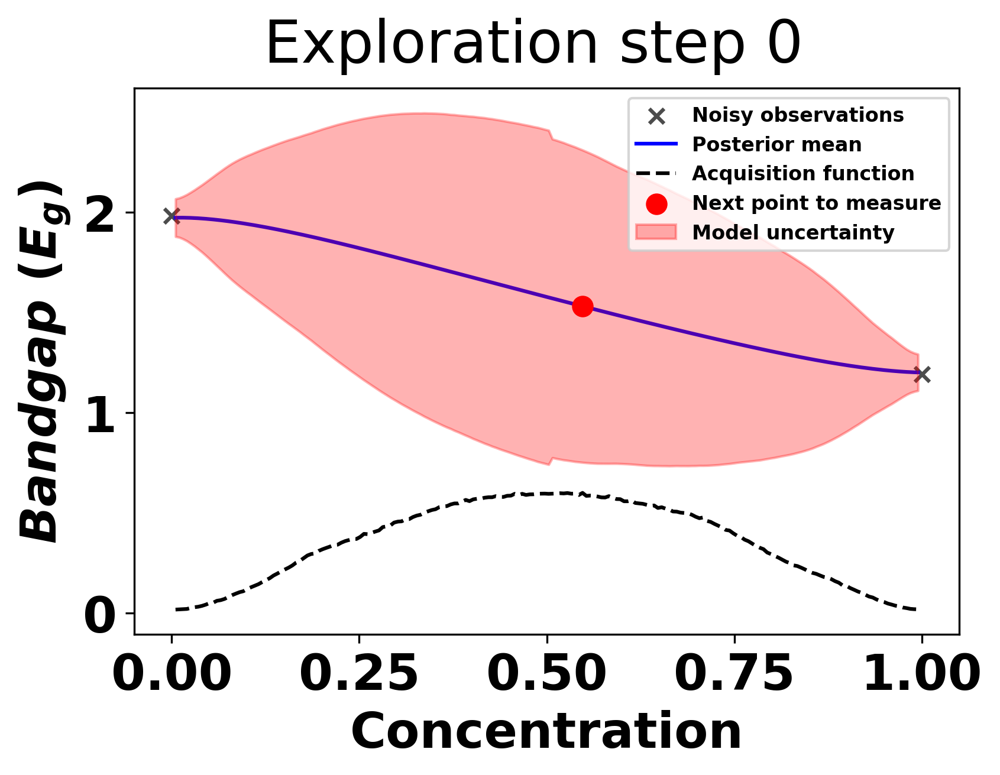

next bandgap: 
 1.5639240153534495
#######---Exploration step 1---#######


sample: 100%|██████████| 4000/4000 [00:07<00:00, 567.33it/s, 7 steps of size 3.90e-01. acc. prob=0.91] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.54      0.43      0.43      0.04      1.04   1331.06      1.00
          b      1.00      0.98      1.12     -0.68      2.51   1089.78      1.00
k_length[0]      1.20      0.75      1.04      0.15      2.25   1276.66      1.00
    k_scale      1.90      1.99      1.30      0.09      4.09   1203.06      1.00
      noise      0.01      0.01      0.01      0.00      0.02   1637.84      1.00

next point:  42
next concentration:
 0.21608040201005024


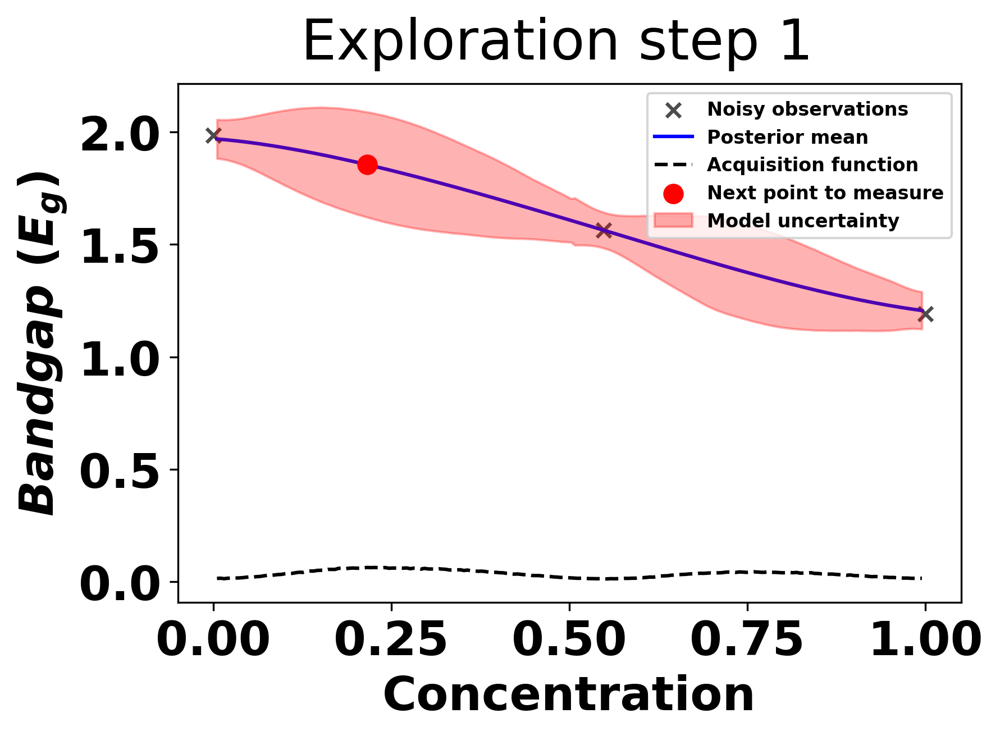

next bandgap: 
 1.8171735519882493
#######---Exploration step 2---#######


sample: 100%|██████████| 4000/4000 [00:05<00:00, 686.43it/s, 7 steps of size 3.99e-01. acc. prob=0.90] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.48      0.35      0.39      0.05      0.95   1458.94      1.00
          b      0.99      1.01      1.10     -0.52      2.80   1034.79      1.00
k_length[0]      1.51      0.84      1.32      0.36      2.66    971.69      1.00
    k_scale      2.12      2.09      1.46      0.18      4.49    838.32      1.00
      noise      0.01      0.01      0.00      0.00      0.01   1955.40      1.00

next point:  157
next concentration:
 0.8040201005025126


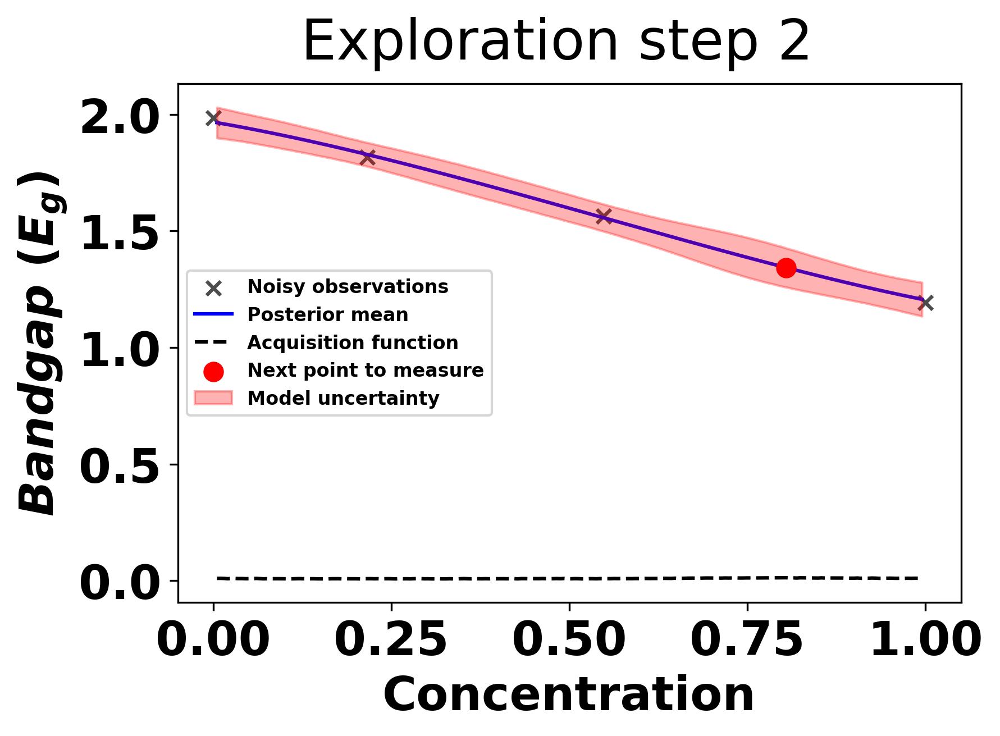

next bandgap: 
 1.1954869696289747
#######---Exploration step 3---#######


sample: 100%|██████████| 4000/4000 [00:06<00:00, 640.98it/s, 7 steps of size 3.97e-01. acc. prob=0.94] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.54      0.40      0.43      0.05      1.05   1495.00      1.00
          b      1.10      0.98      1.20     -0.53      2.75   1220.01      1.00
k_length[0]      1.18      0.68      1.01      0.28      2.07   1004.07      1.00
    k_scale      1.83      1.81      1.23      0.12      4.02    869.04      1.00
      noise      0.01      0.01      0.01      0.00      0.02   2026.85      1.00

next point:  191
next concentration:
 0.9798994974874372


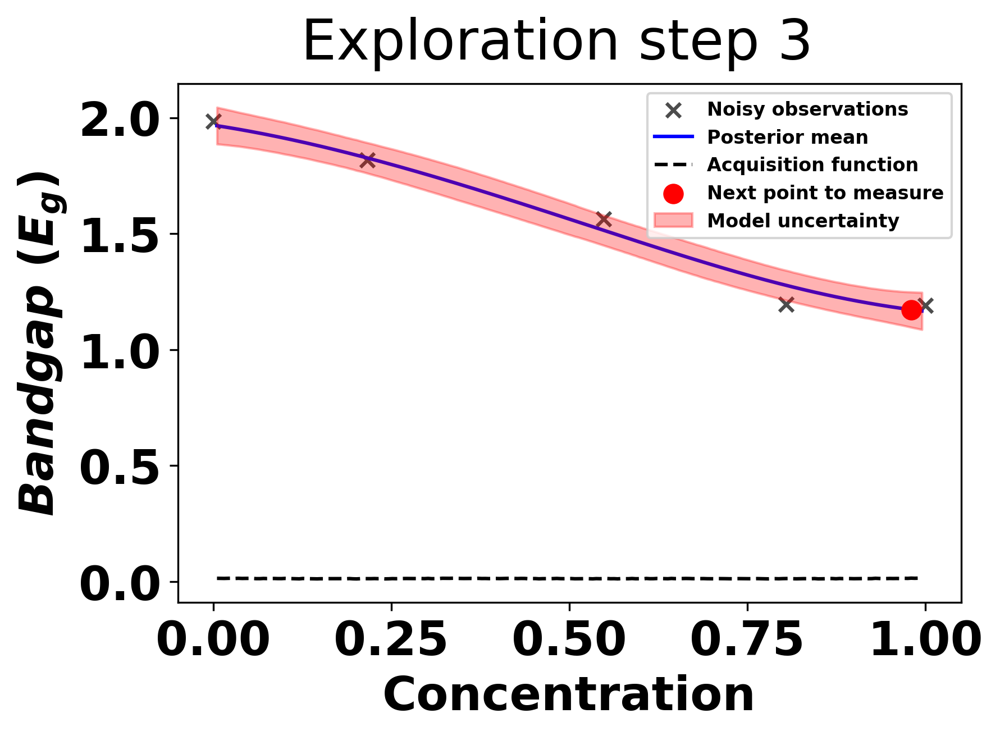

next bandgap: 
 1.1910105784353446
#######---Exploration step 4---#######


sample: 100%|██████████| 4000/4000 [00:07<00:00, 562.45it/s, 7 steps of size 3.98e-01. acc. prob=0.94] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.55      0.41      0.44      0.06      1.08   1485.75      1.00
          b      1.07      1.00      1.17     -0.68      2.57   1275.07      1.00
k_length[0]      1.18      0.67      1.03      0.29      2.10    997.44      1.00
    k_scale      1.83      1.84      1.25      0.09      3.92    995.42      1.00
      noise      0.01      0.00      0.01      0.00      0.01   1590.94      1.00

next point:  91
next concentration:
 0.46733668341708545


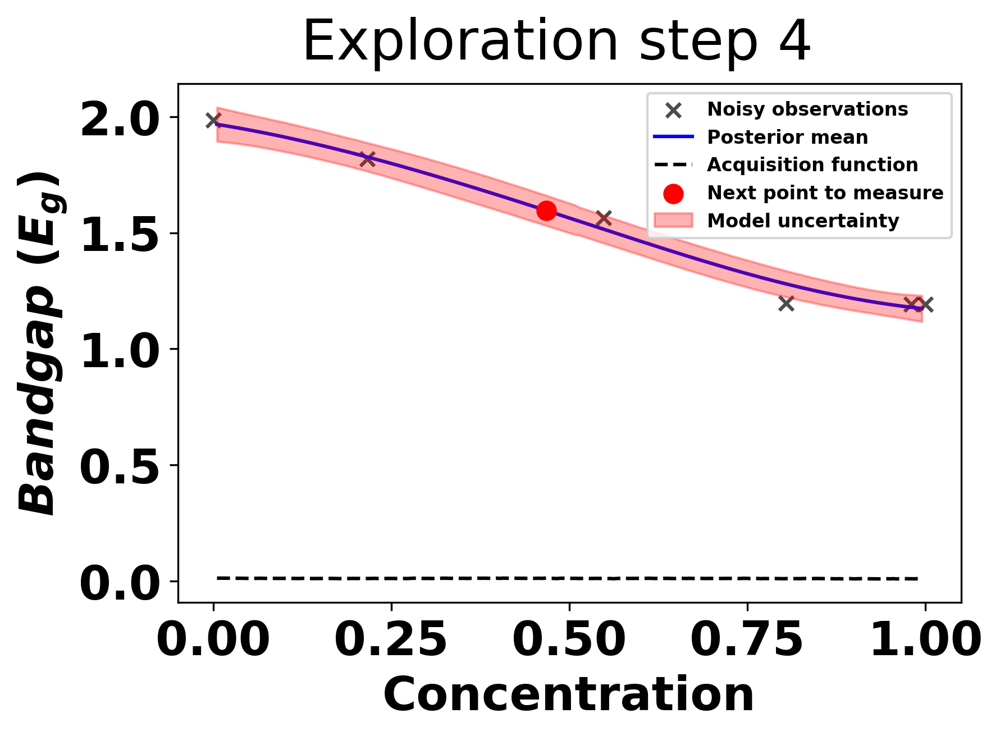

next bandgap: 
 1.6083539837189944
#######---Exploration step 5---#######


sample: 100%|██████████| 4000/4000 [00:07<00:00, 531.82it/s, 15 steps of size 3.45e-01. acc. prob=0.96] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.55      0.43      0.44      0.06      1.16   1703.56      1.00
          b      1.12      0.99      1.21     -0.42      2.79   1100.10      1.00
k_length[0]      1.20      0.71      1.01      0.30      2.12    913.94      1.00
    k_scale      1.82      1.86      1.24      0.16      3.91    850.72      1.00
      noise      0.01      0.00      0.00      0.00      0.01   1746.97      1.00

next point:  0
next concentration:
 0.005025125628140704


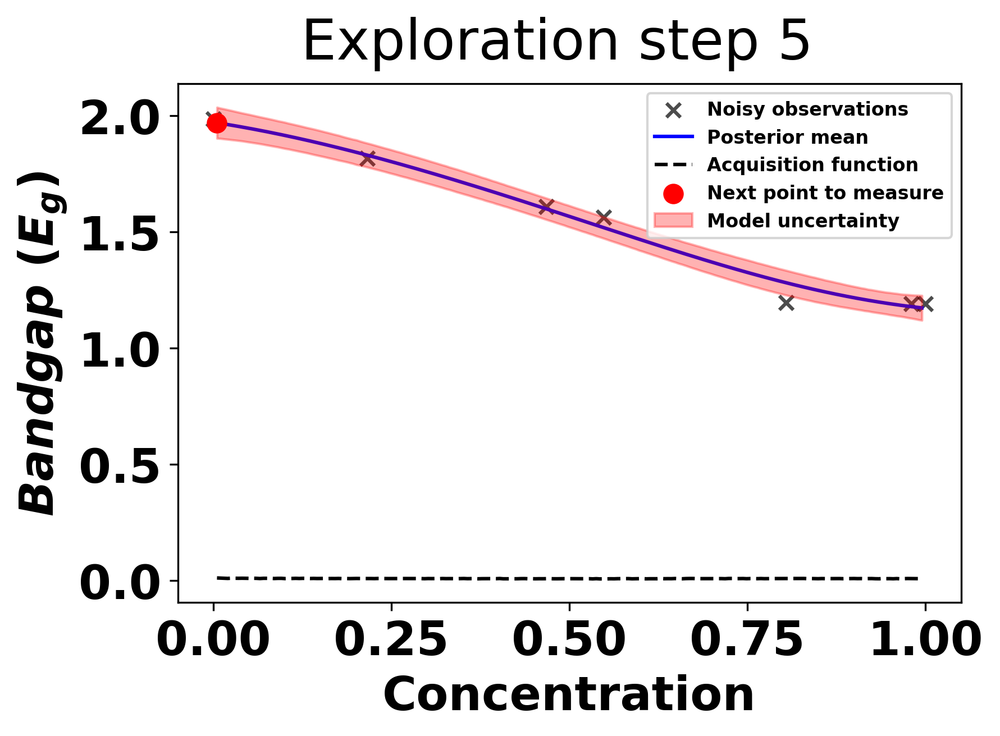

next bandgap: 
 2.004173188210318
#######---Exploration step 6---#######


sample: 100%|██████████| 4000/4000 [00:06<00:00, 638.87it/s, 7 steps of size 4.74e-01. acc. prob=0.89] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.55      0.43      0.43      0.04      1.13   1697.98      1.00
          b      1.13      0.97      1.23     -0.70      2.50   1313.24      1.00
k_length[0]      1.21      0.68      1.02      0.32      2.19    970.67      1.00
    k_scale      1.88      1.98      1.29      0.13      3.96   1132.63      1.00
      noise      0.00      0.00      0.00      0.00      0.01   2064.84      1.00

next point:  123
next concentration:
 0.6432160804020101


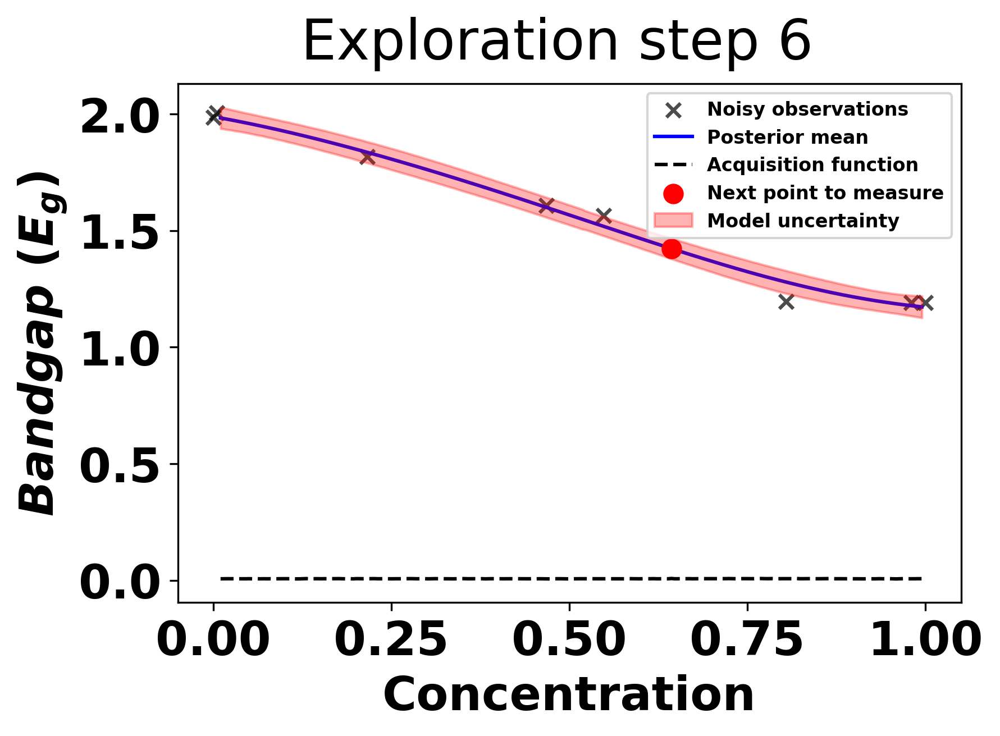

next bandgap: 
 1.4935538760994824
#######---Exploration step 7---#######


sample: 100%|██████████| 4000/4000 [00:07<00:00, 554.31it/s, 7 steps of size 4.19e-01. acc. prob=0.92]  



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.51      0.39      0.41      0.05      1.05   1678.61      1.00
          b      1.07      0.99      1.16     -0.56      2.70   1362.21      1.00
k_length[0]      1.34      0.74      1.17      0.25      2.33   1162.97      1.00
    k_scale      1.99      2.11      1.37      0.14      4.22   1141.89      1.00
      noise      0.00      0.00      0.00      0.00      0.01   1592.36      1.00

next point:  188
next concentration:
 0.9849246231155779


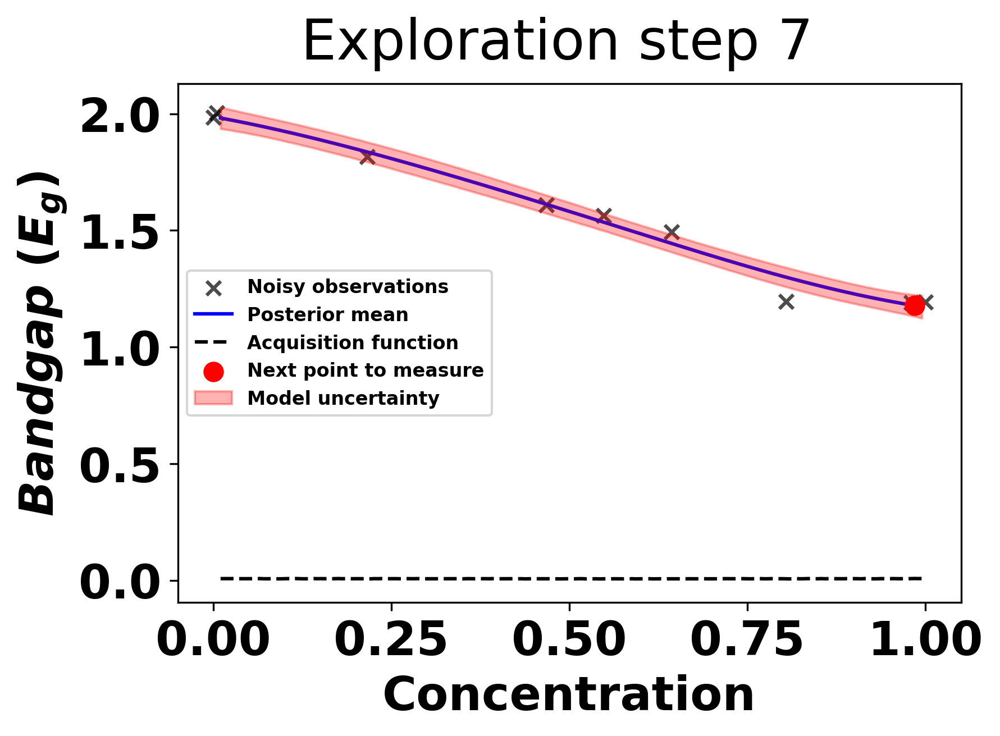

next bandgap: 
 1.2007458640654356
#######---Exploration step 8---#######


sample: 100%|██████████| 4000/4000 [00:07<00:00, 514.72it/s, 7 steps of size 3.84e-01. acc. prob=0.93] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.51      0.39      0.42      0.05      1.02   1400.32      1.00
          b      1.08      0.99      1.18     -0.34      2.89    889.40      1.00
k_length[0]      1.34      0.75      1.14      0.25      2.33    897.60      1.01
    k_scale      1.95      2.10      1.31      0.12      4.39    888.93      1.00
      noise      0.00      0.00      0.00      0.00      0.01   1467.91      1.00

next point:  147
next concentration:
 0.7688442211055276


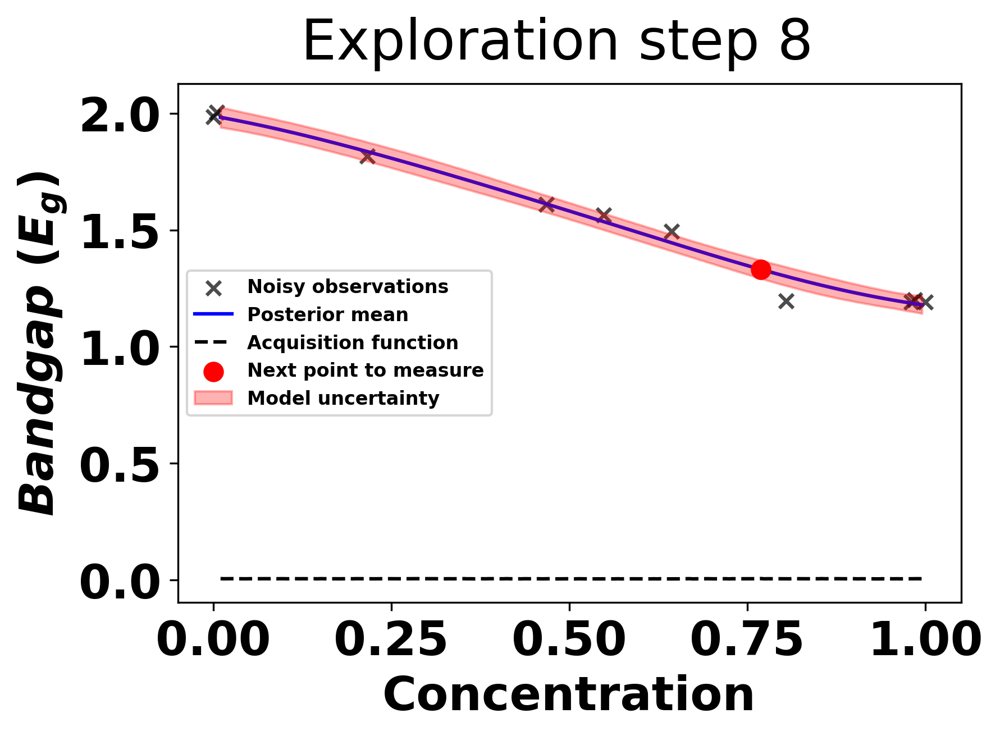

next bandgap: 
 1.4018864388438594
#######---Exploration step 9---#######


sample: 100%|██████████| 4000/4000 [00:06<00:00, 605.64it/s, 7 steps of size 4.11e-01. acc. prob=0.94] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.48      0.35      0.39      0.05      0.96   1721.39      1.00
          b      1.05      1.02      1.14     -0.63      2.67   1373.28      1.00
k_length[0]      1.49      0.77      1.30      0.42      2.54   1093.16      1.00
    k_scale      2.09      2.01      1.41      0.16      4.51    997.07      1.00
      noise      0.00      0.00      0.00      0.00      0.01   1440.43      1.00

next point:  1
next concentration:
 0.01507537688442211


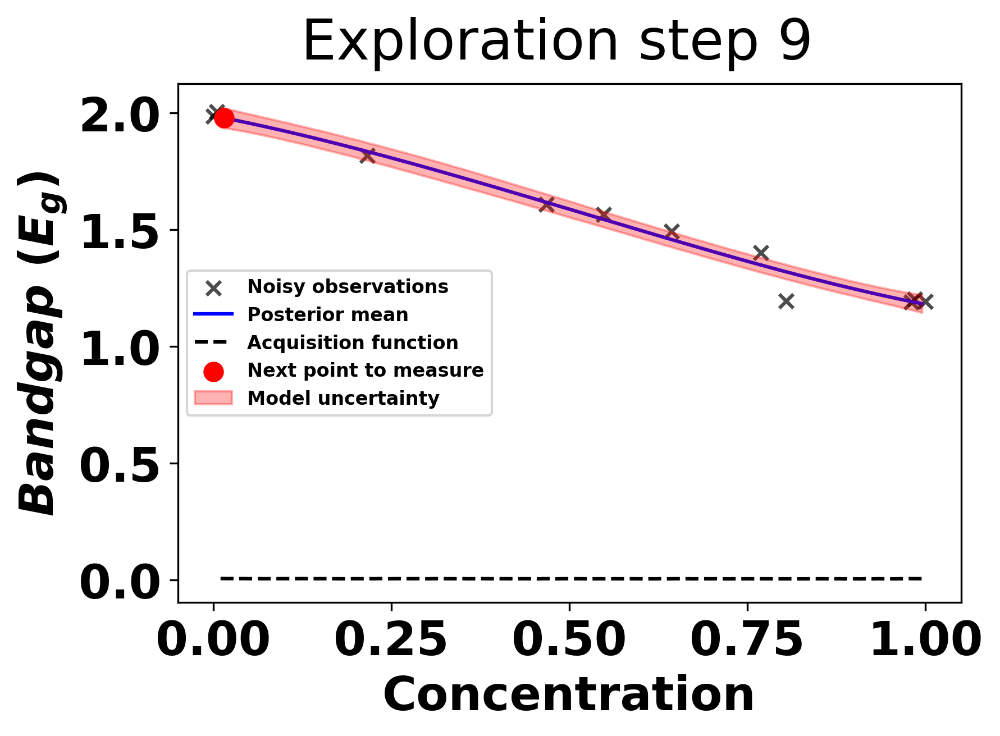

next bandgap: 
 2.0023810314783232
#######---Exploration step 10---#######


sample: 100%|██████████| 4000/4000 [00:08<00:00, 484.82it/s, 15 steps of size 3.40e-01. acc. prob=0.96] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.49      0.36      0.39      0.04      0.95   1345.47      1.00
          b      1.07      1.02      1.16     -0.70      2.61   1160.73      1.00
k_length[0]      1.54      0.81      1.34      0.43      2.67    885.95      1.00
    k_scale      2.19      2.25      1.51      0.16      4.59   1014.42      1.00
      noise      0.00      0.00      0.00      0.00      0.01   1168.80      1.00

next point:  72
next concentration:
 0.38190954773869346


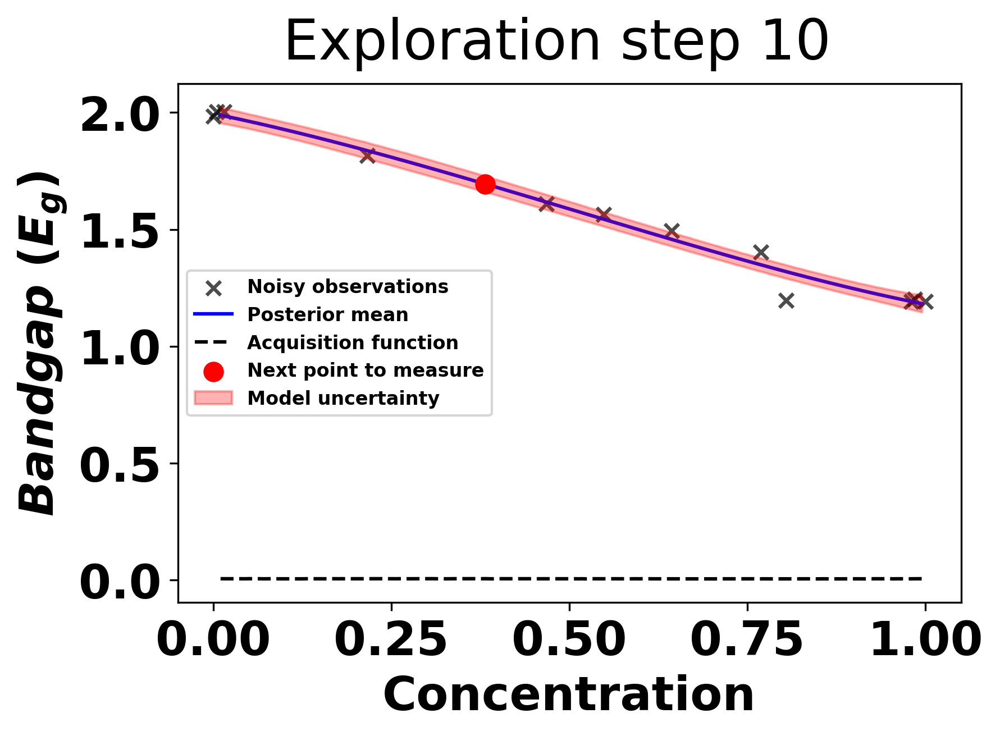

next bandgap: 
 1.6850825460822674
#######---Exploration step 11---#######


sample: 100%|██████████| 4000/4000 [00:07<00:00, 561.86it/s, 7 steps of size 4.17e-01. acc. prob=0.93] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.47      0.35      0.38      0.04      0.94   1576.75      1.00
          b      1.06      1.02      1.15     -0.73      2.63   1569.71      1.00
k_length[0]      1.55      0.81      1.35      0.40      2.61   1125.47      1.00
    k_scale      2.15      2.23      1.47      0.15      4.60   1130.62      1.00
      noise      0.00      0.00      0.00      0.00      0.01   1423.29      1.00

next point:  186
next concentration:
 0.9949748743718593


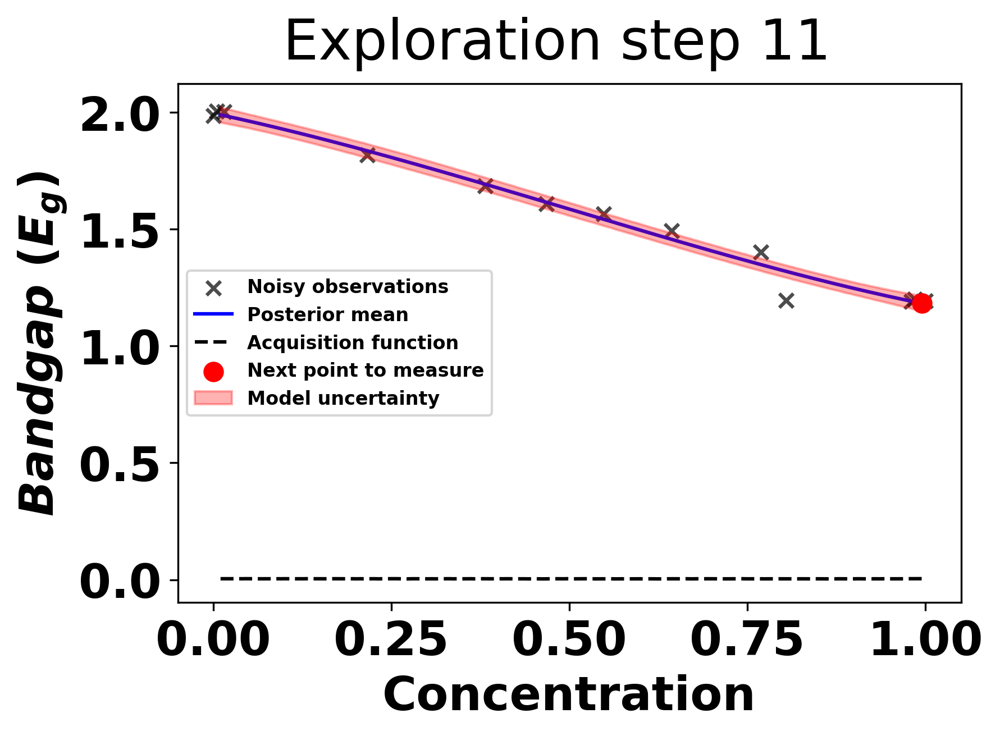

next bandgap: 
 1.1957533669756713
#######---Exploration step 12---#######


sample: 100%|██████████| 4000/4000 [00:08<00:00, 470.07it/s, 7 steps of size 3.96e-01. acc. prob=0.95]  



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.48      0.36      0.39      0.04      0.95   1476.00      1.00
          b      1.09      0.99      1.18     -0.51      2.69   1494.70      1.00
k_length[0]      1.50      0.77      1.31      0.40      2.49   1038.26      1.00
    k_scale      2.04      2.07      1.39      0.19      4.42   1079.88      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1374.27      1.00

next point:  14
next concentration:
 0.08542713567839195


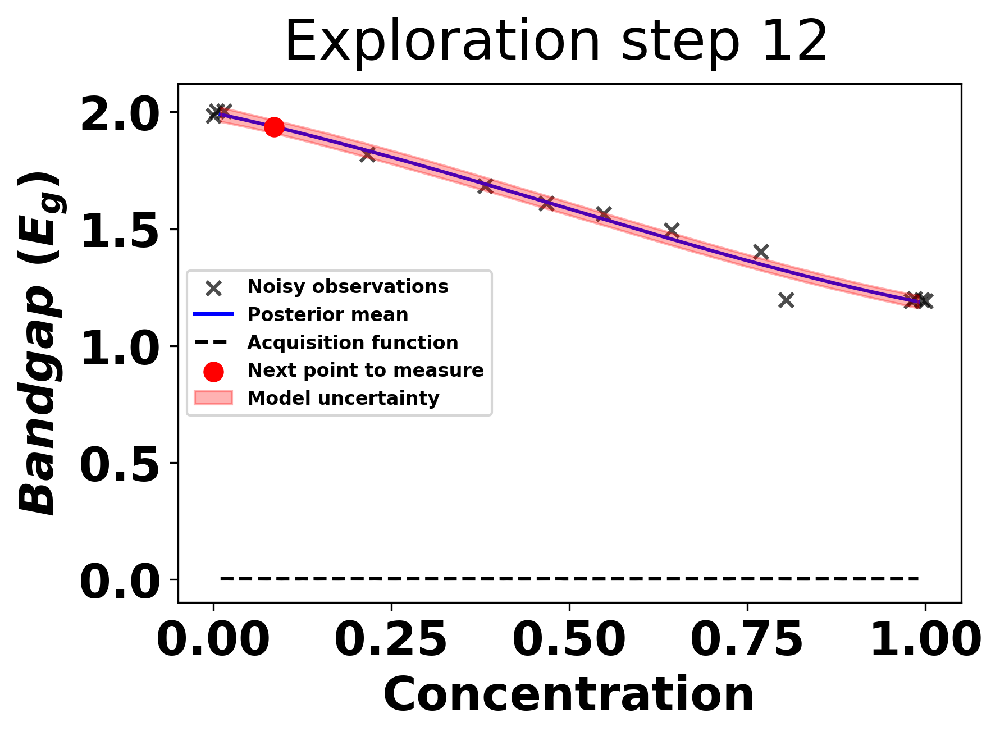

next bandgap: 
 2.0032962298212773
#######---Exploration step 13---#######


sample: 100%|██████████| 4000/4000 [00:07<00:00, 527.38it/s, 7 steps of size 4.61e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.48      0.36      0.39      0.05      0.96   1822.31      1.00
          b      1.11      0.97      1.17     -0.46      2.72   1724.15      1.00
k_length[0]      1.48      0.77      1.29      0.49      2.64   1160.58      1.00
    k_scale      2.11      2.19      1.43      0.15      4.55   1097.31      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1201.04      1.00

next point:  54
next concentration:
 0.2964824120603015


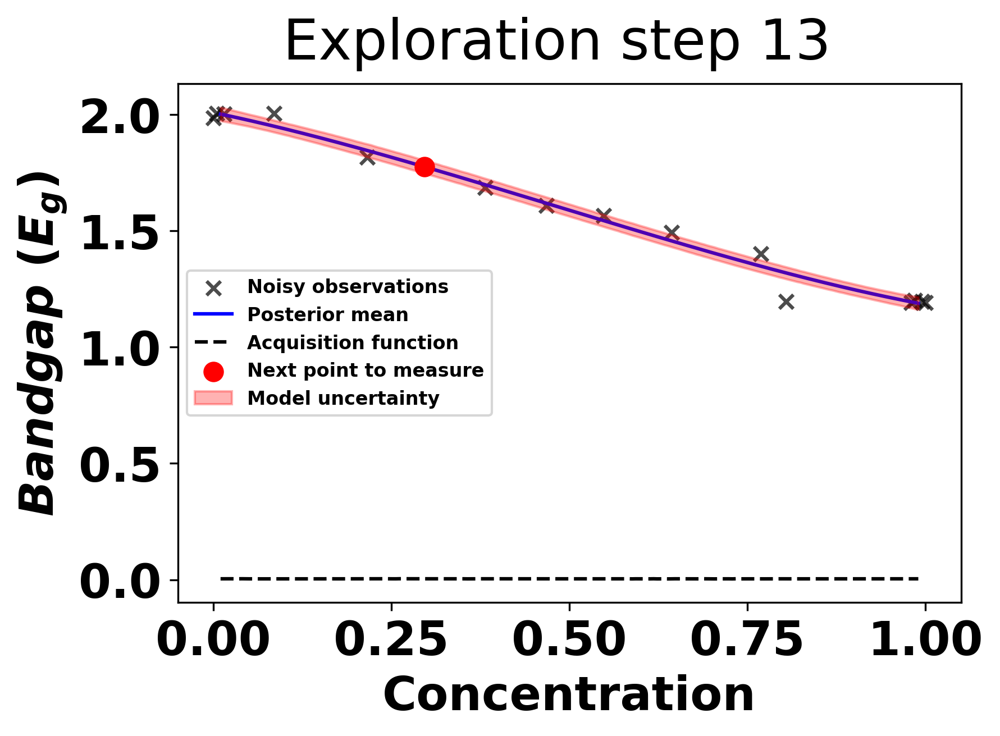

next bandgap: 
 1.7533579123961958
#######---Exploration step 14---#######


sample: 100%|██████████| 4000/4000 [00:08<00:00, 494.32it/s, 7 steps of size 4.25e-01. acc. prob=0.93] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.47      0.35      0.38      0.04      0.94   1620.28      1.00
          b      1.10      1.03      1.20     -0.67      2.67   1418.18      1.00
k_length[0]      1.53      0.77      1.34      0.50      2.68   1141.23      1.00
    k_scale      2.15      2.26      1.49      0.15      4.49   1087.84      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1717.01      1.00

next point:  119
next concentration:
 0.6482412060301508


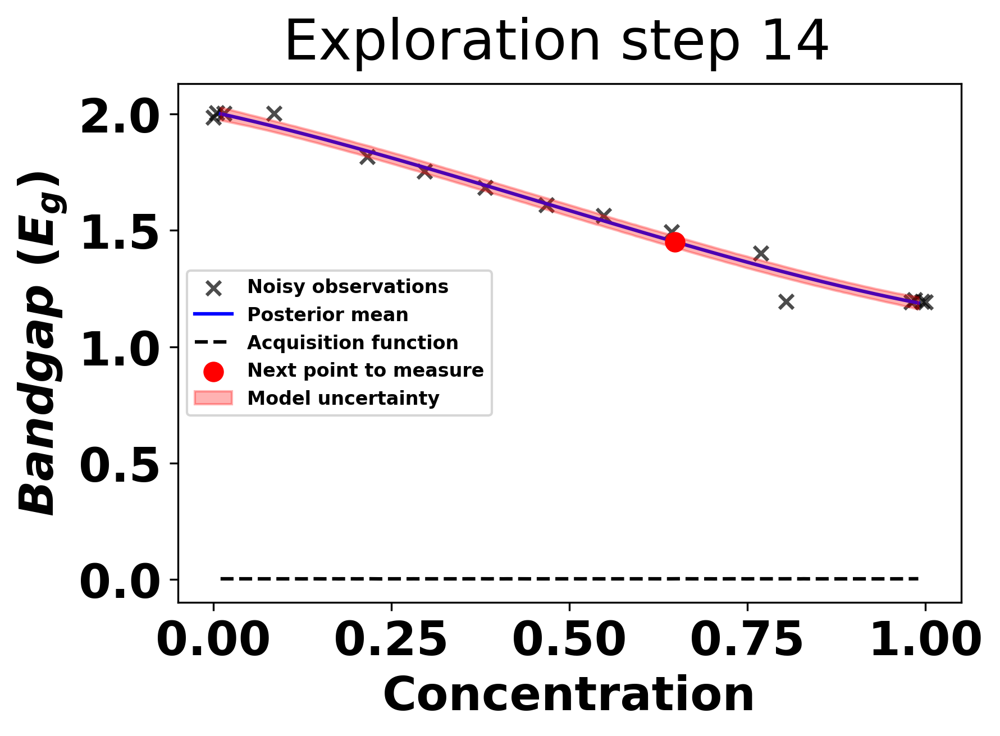

next bandgap: 
 1.4872796289698778
#######---Exploration step 15---#######


sample: 100%|██████████| 4000/4000 [00:09<00:00, 431.50it/s, 7 steps of size 4.37e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.46      0.34      0.37      0.05      0.93   1631.72      1.00
          b      1.08      1.01      1.17     -0.67      2.65   1568.38      1.00
k_length[0]      1.57      0.78      1.38      0.50      2.78   1171.29      1.00
    k_scale      2.17      2.21      1.55      0.12      4.46   1170.12      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1808.15      1.00

next point:  4
next concentration:
 0.035175879396984924


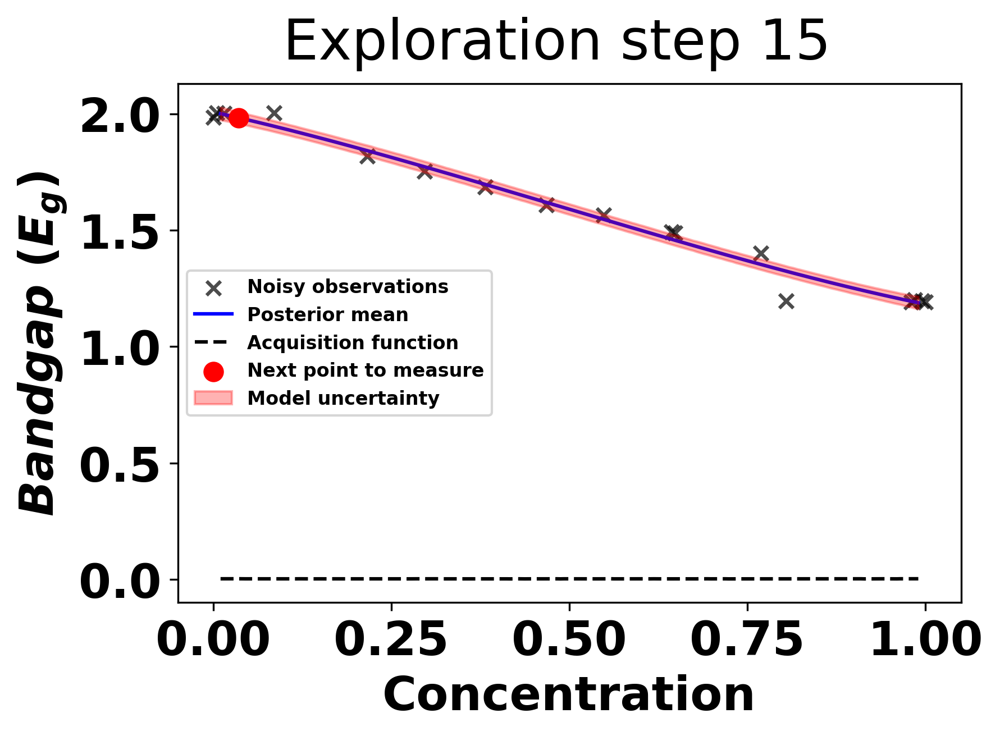

next bandgap: 
 1.9833930018813073
#######---Exploration step 16---#######


sample: 100%|██████████| 4000/4000 [00:07<00:00, 503.19it/s, 7 steps of size 3.89e-01. acc. prob=0.94] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.47      0.34      0.38      0.04      0.91   1401.95      1.00
          b      1.10      1.01      1.19     -0.57      2.74   1224.73      1.00
k_length[0]      1.58      0.81      1.38      0.34      2.64    901.34      1.00
    k_scale      2.17      2.10      1.50      0.15      4.65    802.41      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1401.40      1.00

next point:  181
next concentration:
 0.9899497487437187


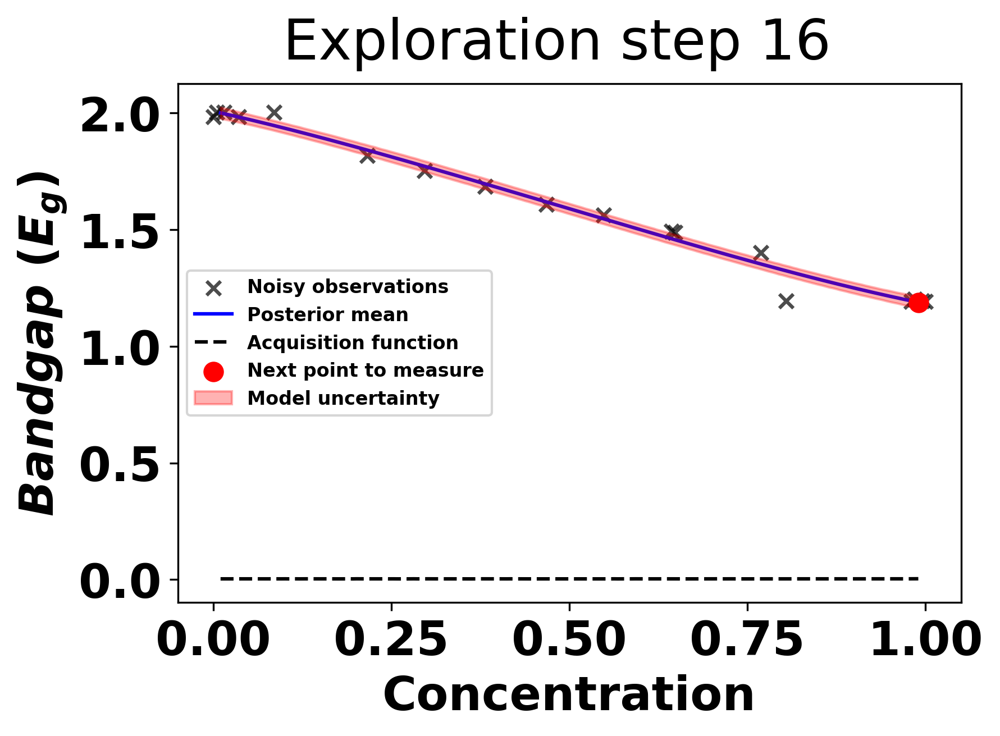

next bandgap: 
 1.18922900930596
#######---Exploration step 17---#######


sample: 100%|██████████| 4000/4000 [00:07<00:00, 504.95it/s, 7 steps of size 4.23e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.46      0.34      0.37      0.05      0.91   1685.08      1.00
          b      1.09      1.02      1.17     -0.49      2.81   1442.13      1.00
k_length[0]      1.58      0.80      1.40      0.34      2.66   1130.02      1.00
    k_scale      2.18      2.35      1.52      0.11      4.53   1172.92      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1771.06      1.00

next point:  166
next concentration:
 0.9045226130653267


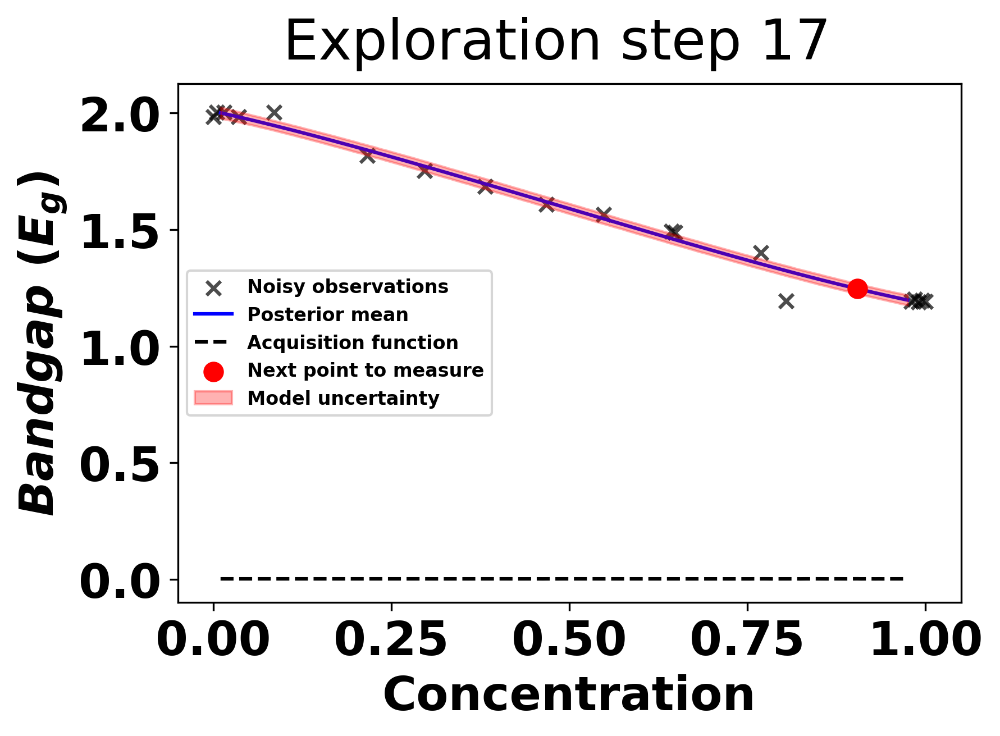

next bandgap: 
 1.2148935596207449
#######---Exploration step 18---#######


sample: 100%|██████████| 4000/4000 [00:09<00:00, 443.34it/s, 15 steps of size 3.67e-01. acc. prob=0.95]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.48      0.36      0.38      0.04      0.93   1348.02      1.00
          b      1.08      1.03      1.18     -0.59      2.74    789.90      1.00
k_length[0]      1.54      0.80      1.37      0.33      2.60    959.63      1.00
    k_scale      2.16      2.14      1.47      0.14      4.79    711.60      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1527.68      1.00

next point:  23
next concentration:
 0.1407035175879397


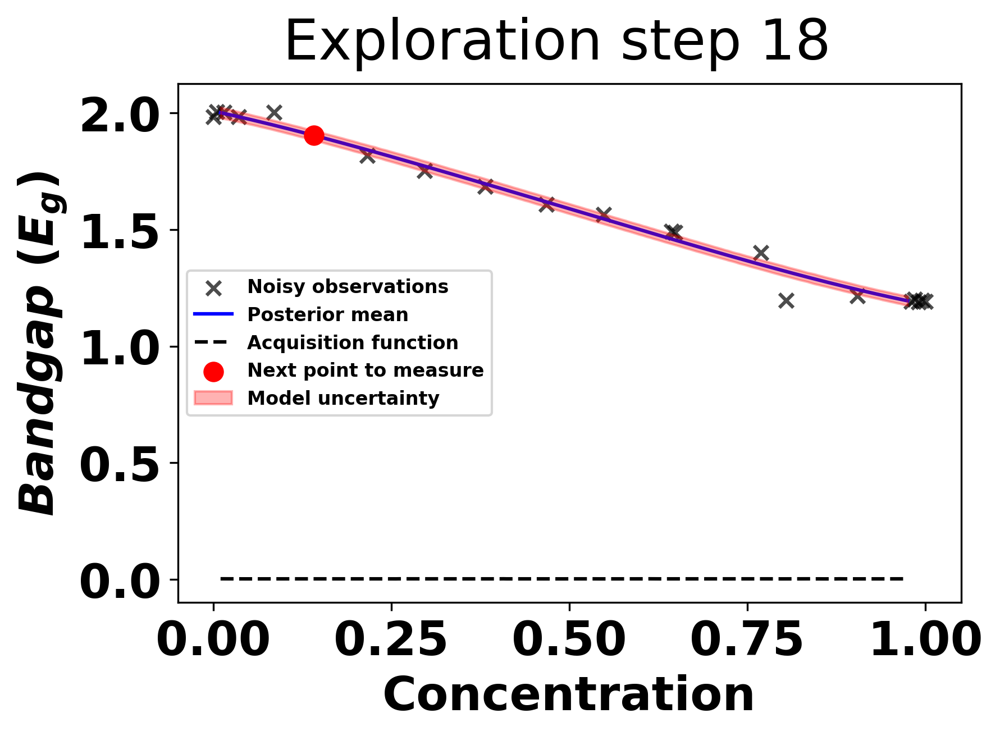

next bandgap: 
 1.9994386697955124
#######---Exploration step 19---#######


sample: 100%|██████████| 4000/4000 [00:09<00:00, 406.43it/s, 7 steps of size 3.86e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.50      0.37      0.39      0.06      1.01   1552.79      1.00
          b      1.10      0.97      1.18     -0.51      2.69   1281.29      1.00
k_length[0]      1.39      0.71      1.22      0.30      2.34   1007.17      1.00
    k_scale      1.94      1.93      1.36      0.15      4.14   1081.97      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1361.92      1.00

next point:  168
next concentration:
 0.9246231155778895


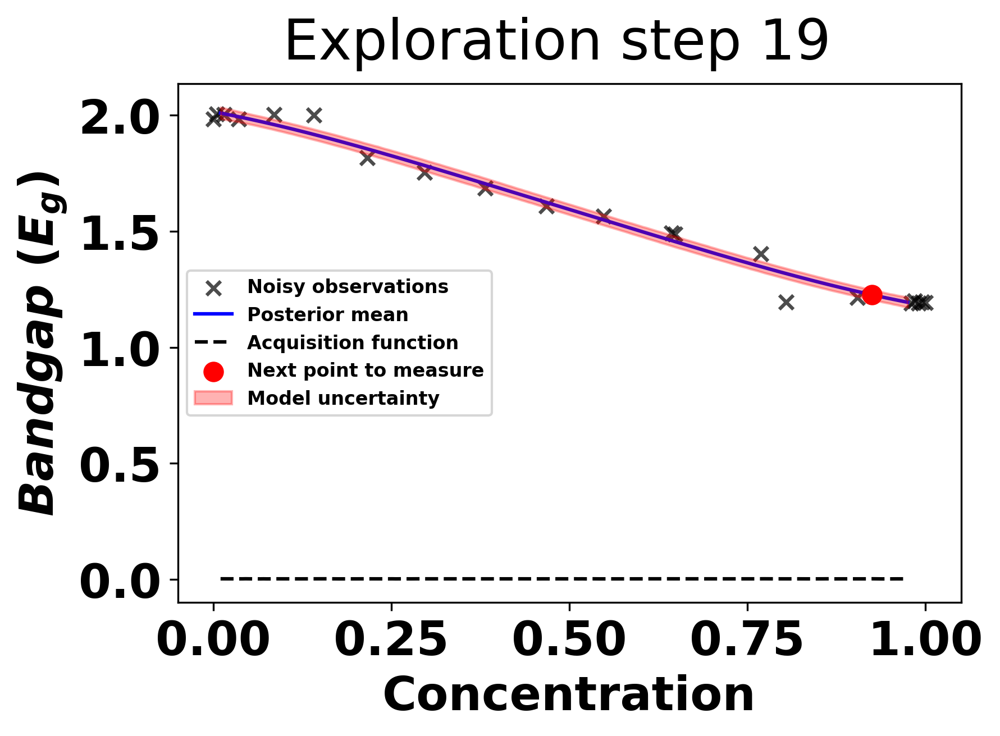

next bandgap: 
 1.2047689836892221
#######---Exploration step 20---#######


sample: 100%|██████████| 4000/4000 [00:09<00:00, 415.41it/s, 7 steps of size 3.97e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.51      0.38      0.41      0.05      1.02   1496.96      1.00
          b      1.08      0.94      1.17     -0.36      2.72   1179.17      1.00
k_length[0]      1.35      0.70      1.19      0.27      2.27   1098.77      1.00
    k_scale      1.89      1.94      1.33      0.15      3.90   1050.89      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1311.57      1.00

next point:  58
next concentration:
 0.3316582914572864


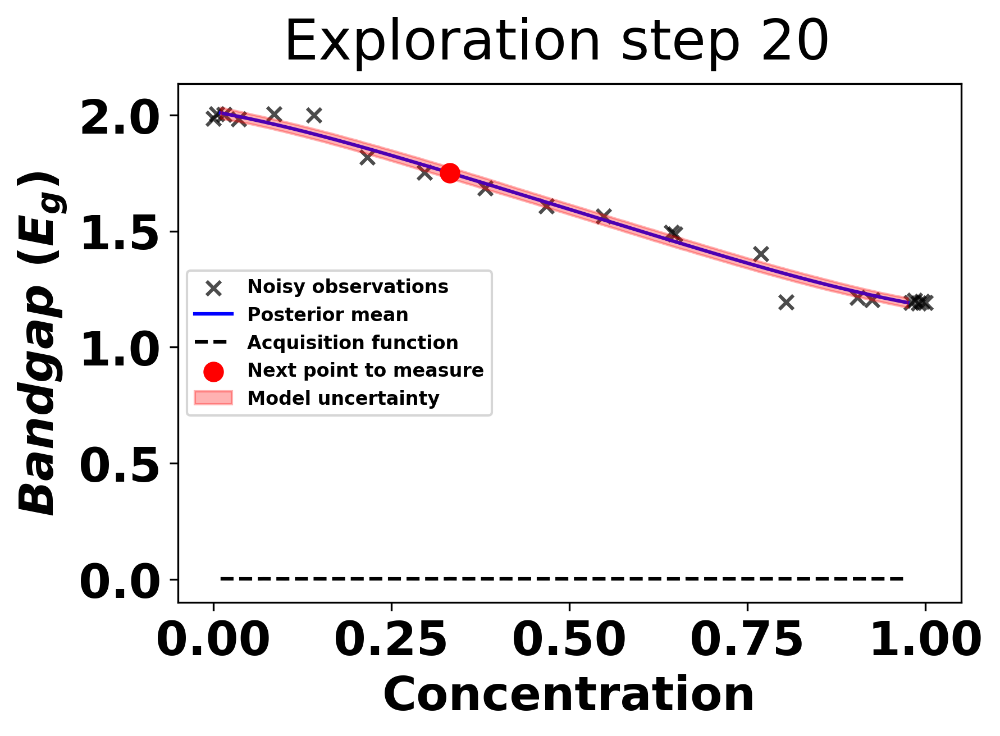

next bandgap: 
 1.7344391357839564
#######---Exploration step 21---#######


sample: 100%|██████████| 4000/4000 [00:09<00:00, 421.27it/s, 15 steps of size 3.38e-01. acc. prob=0.95]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.51      0.39      0.41      0.06      0.99   1262.41      1.00
          b      1.08      0.99      1.16     -0.66      2.57    897.47      1.00
k_length[0]      1.40      0.71      1.25      0.30      2.35    915.62      1.00
    k_scale      2.04      2.06      1.40      0.12      4.47    886.19      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1516.89      1.00

next point:  111
next concentration:
 0.6180904522613065


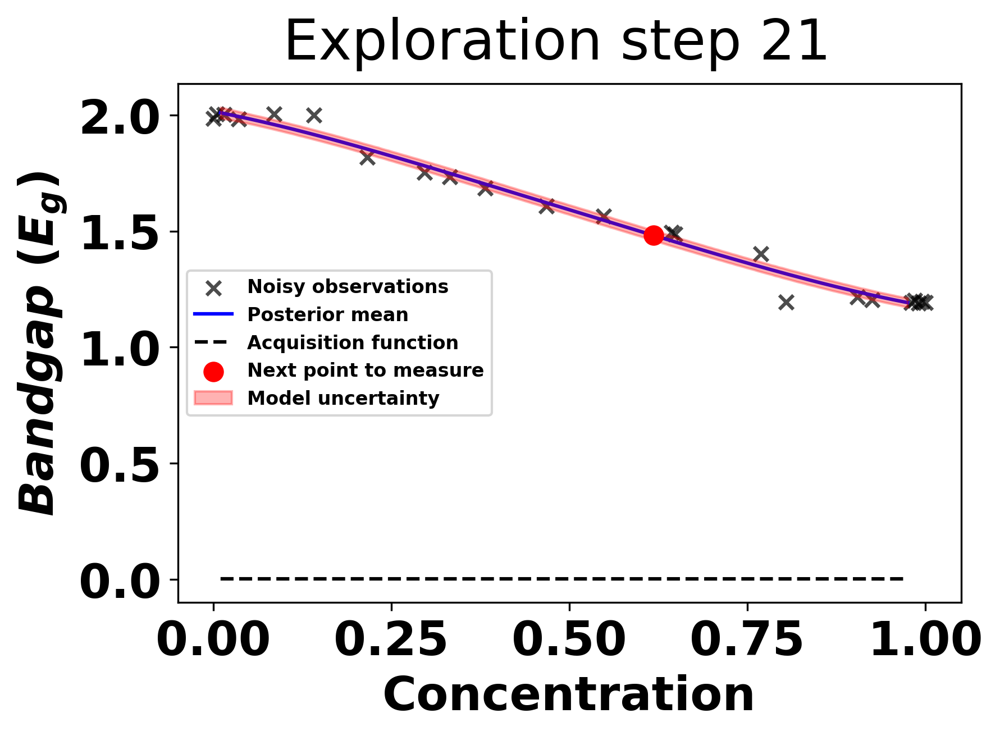

next bandgap: 
 1.5016727405871986
#######---Exploration step 22---#######


sample: 100%|██████████| 4000/4000 [00:09<00:00, 437.16it/s, 7 steps of size 3.56e-01. acc. prob=0.94] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.50      0.37      0.41      0.05      0.99   1268.25      1.00
          b      1.09      0.99      1.18     -0.65      2.57   1060.85      1.00
k_length[0]      1.42      0.74      1.26      0.27      2.39    918.03      1.00
    k_scale      2.00      1.85      1.43      0.20      4.50    888.01      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1346.73      1.00

next point:  38
next concentration:
 0.22613065326633167


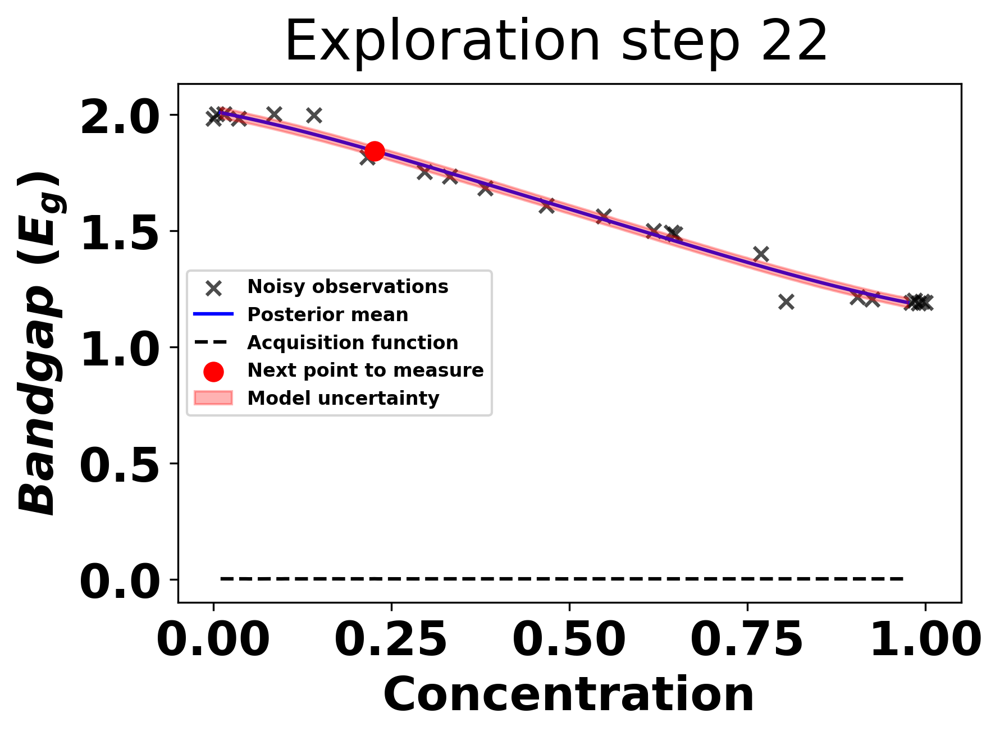

next bandgap: 
 1.8160458410083906
#######---Exploration step 23---#######


sample: 100%|██████████| 4000/4000 [00:09<00:00, 426.03it/s, 7 steps of size 3.99e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.51      0.38      0.40      0.05      1.02   1354.66      1.00
          b      1.07      0.98      1.15     -0.40      2.86   1144.52      1.00
k_length[0]      1.42      0.78      1.27      0.29      2.39    871.84      1.01
    k_scale      2.01      2.26      1.35      0.18      4.32    935.45      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1080.79      1.00

next point:  124
next concentration:
 0.7035175879396985


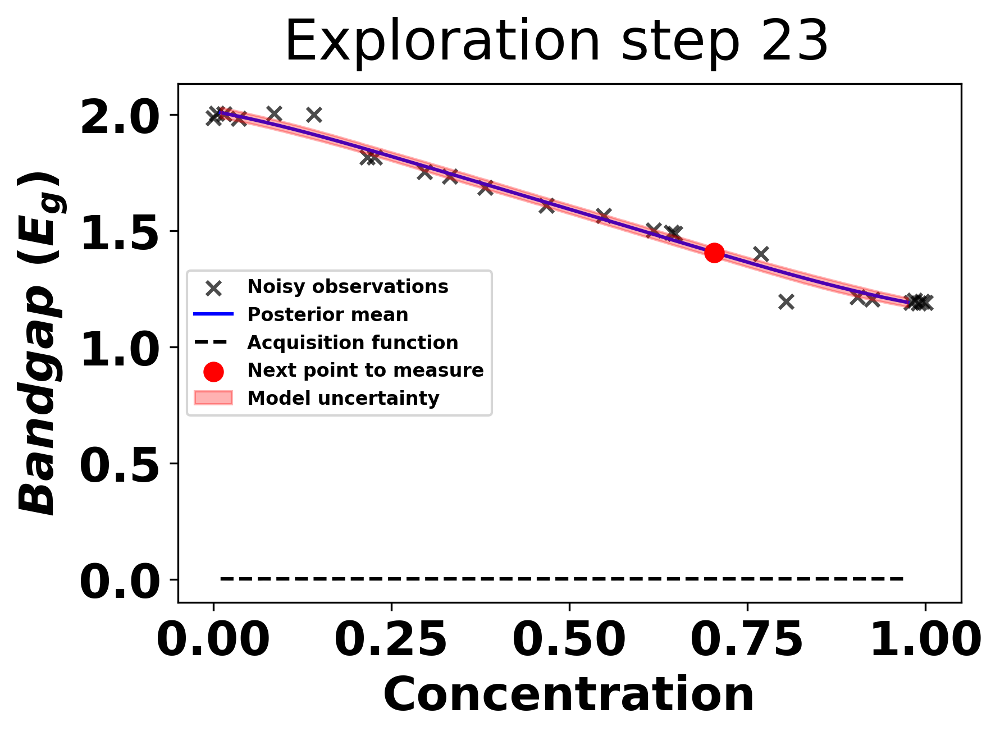

next bandgap: 
 1.4254096400234146
#######---Exploration step 24---#######


sample: 100%|██████████| 4000/4000 [00:10<00:00, 370.66it/s, 15 steps of size 3.56e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.48      0.37      0.38      0.04      0.94   1571.99      1.00
          b      1.09      0.99      1.18     -0.55      2.70   1078.94      1.00
k_length[0]      1.52      0.79      1.36      0.29      2.55   1092.82      1.00
    k_scale      2.10      1.97      1.46      0.15      4.58   1068.91      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1442.48      1.00

next point:  95
next concentration:
 0.5376884422110553


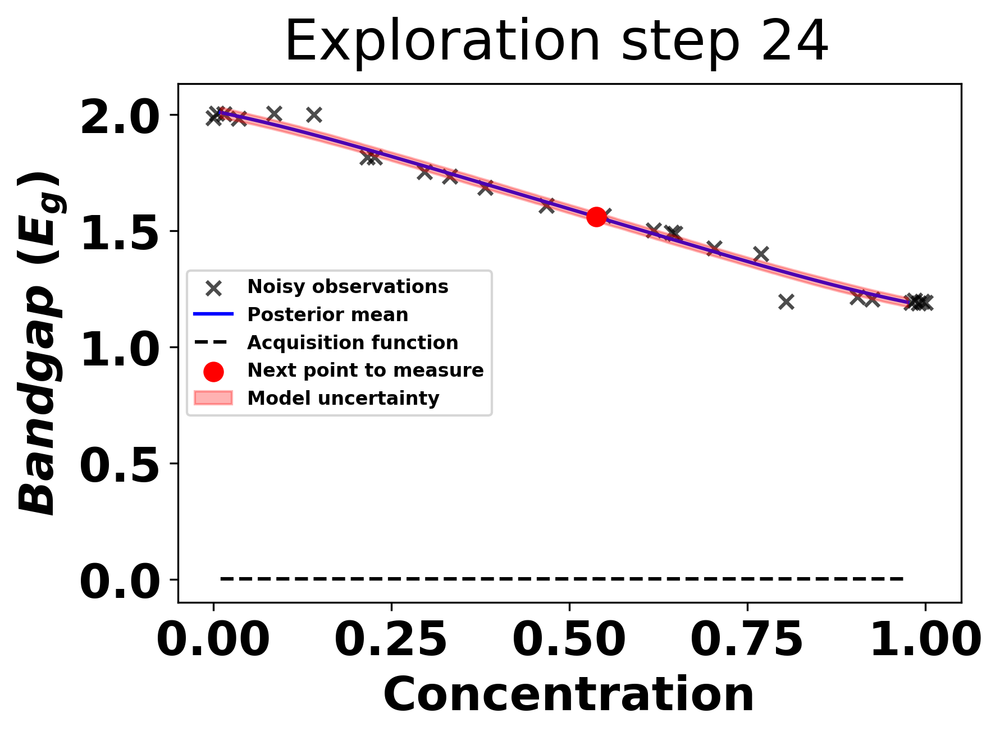

next bandgap: 
 1.5694982944624591
#######---Exploration step 25---#######


sample: 100%|██████████| 4000/4000 [00:10<00:00, 381.89it/s, 7 steps of size 4.31e-01. acc. prob=0.88]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.49      0.37      0.39      0.05      1.00   1296.02      1.00
          b      1.08      0.97      1.15     -0.49      2.68   1500.73      1.00
k_length[0]      1.45      0.82      1.32      0.26      2.54    617.70      1.00
    k_scale      2.07      2.35      1.38      0.15      4.24    910.20      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1037.02      1.00

next point:  138
next concentration:
 0.7889447236180904


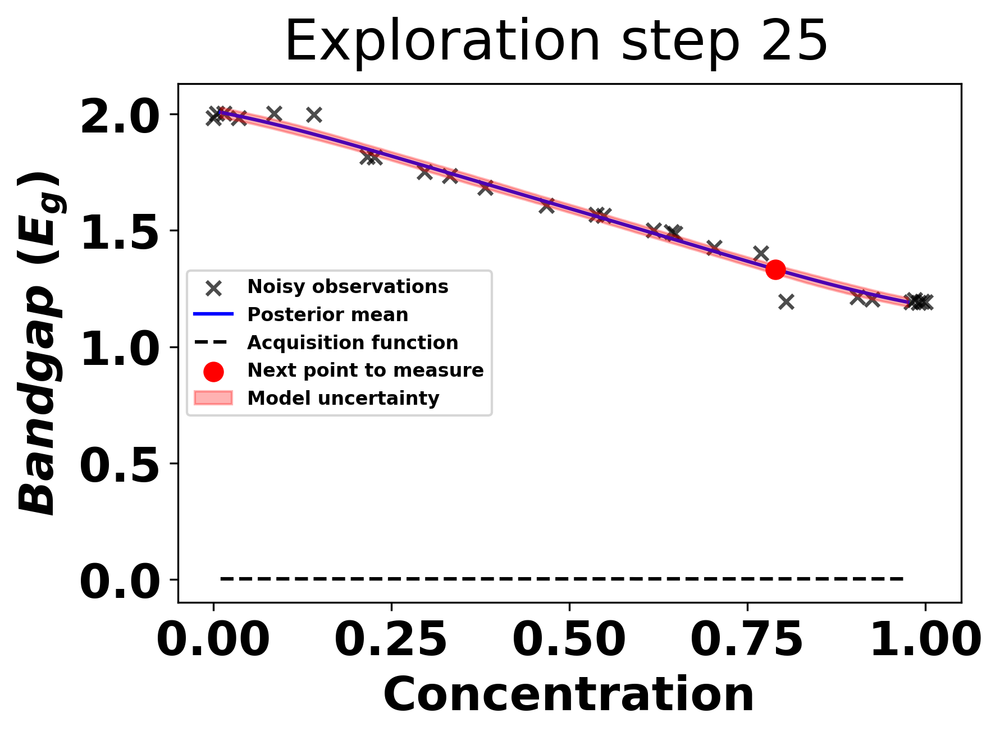

next bandgap: 
 1.361769164130422
#######---Exploration step 26---#######


sample: 100%|██████████| 4000/4000 [00:10<00:00, 368.03it/s, 7 steps of size 4.45e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.47      0.36      0.38      0.04      0.93   1387.61      1.00
          b      1.07      0.99      1.19     -0.50      2.75   1659.89      1.00
k_length[0]      1.55      0.82      1.40      0.29      2.60    799.10      1.00
    k_scale      2.16      2.26      1.50      0.18      4.47   1050.93      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1215.78      1.00

next point:  171
next concentration:
 0.9748743718592965


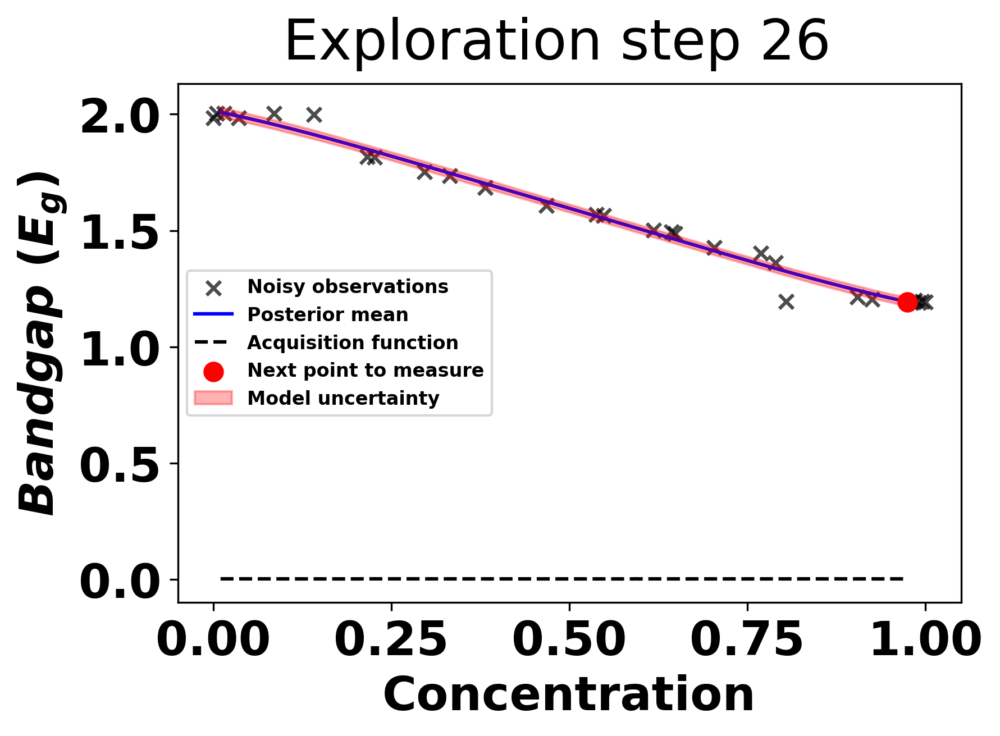

next bandgap: 
 1.1914102761155565
#######---Exploration step 27---#######


sample: 100%|██████████| 4000/4000 [00:10<00:00, 370.53it/s, 15 steps of size 3.18e-01. acc. prob=0.96]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.48      0.37      0.39      0.05      0.93   1459.23      1.00
          b      1.03      1.03      1.14     -0.67      2.74   1093.27      1.00
k_length[0]      1.60      0.82      1.44      0.26      2.62    804.82      1.00
    k_scale      2.32      2.48      1.55      0.08      4.85    847.41      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1055.00      1.00

next point:  0
next concentration:
 0.010050251256281407


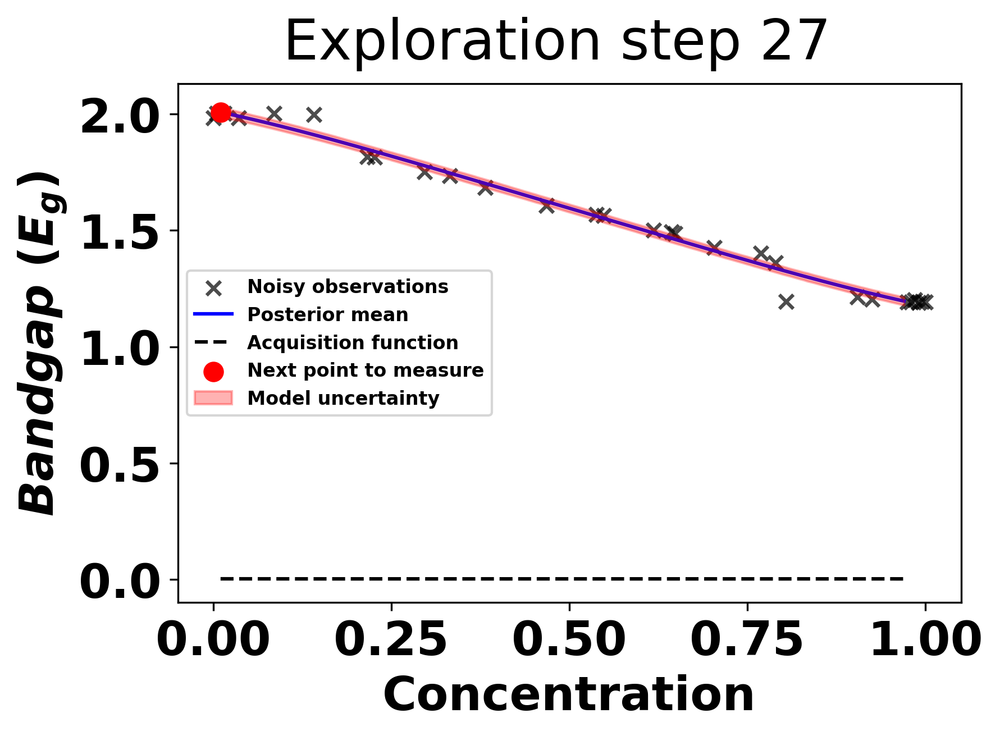

next bandgap: 
 1.9905563150917571
#######---Exploration step 28---#######


sample: 100%|██████████| 4000/4000 [00:11<00:00, 356.18it/s, 7 steps of size 3.73e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.49      0.37      0.38      0.04      0.96    835.20      1.00
          b      1.08      0.98      1.16     -0.60      2.65    977.95      1.00
k_length[0]      1.48      0.81      1.36      0.25      2.53    454.52      1.01
    k_scale      2.00      2.09      1.36      0.16      4.25    953.04      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1078.33      1.00

next point:  17
next concentration:
 0.11557788944723618


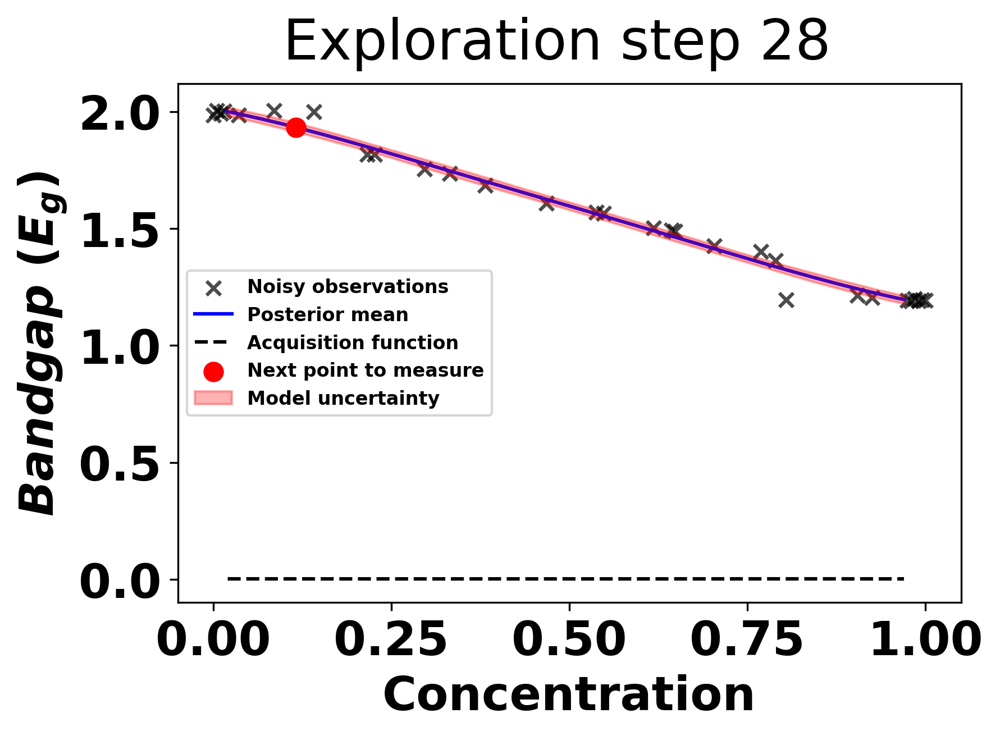

next bandgap: 
 1.9969775026954493
#######---Exploration step 29---#######


sample: 100%|██████████| 4000/4000 [00:13<00:00, 286.27it/s, 7 steps of size 2.77e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.54      0.42      0.43      0.04      1.06    683.99      1.00
          b      1.05      0.94      1.11     -0.64      2.44    920.60      1.00
k_length[0]      1.27      0.81      1.19      0.25      2.28    348.33      1.00
    k_scale      1.96      2.18      1.27      0.11      4.21    798.14      1.00
      noise      0.00      0.00      0.00      0.00      0.00    474.77      1.00

next point:  16
next concentration:
 0.11055276381909548


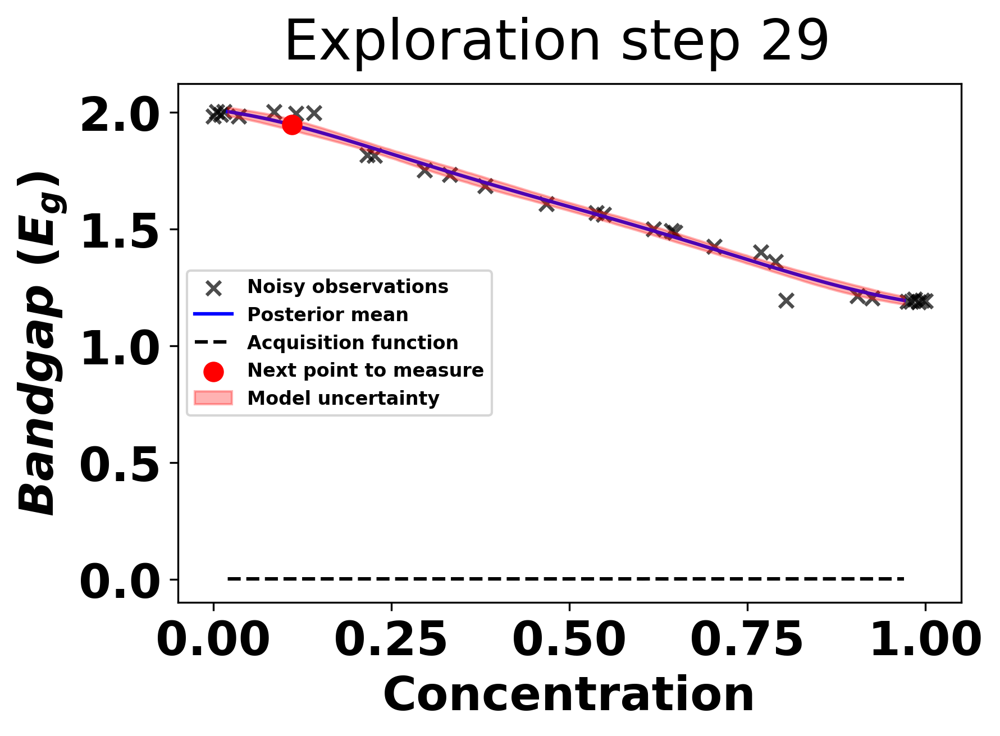

next bandgap: 
 1.9977574106574836


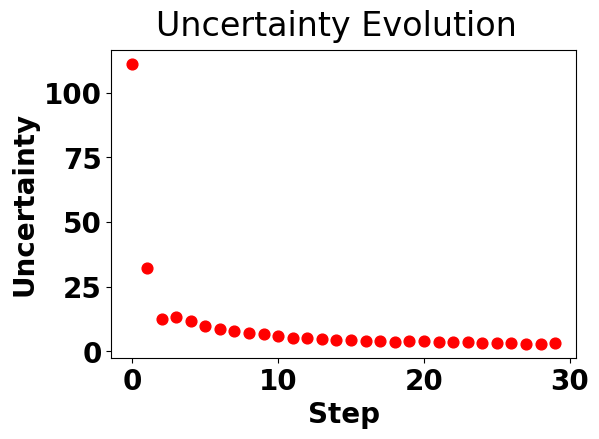

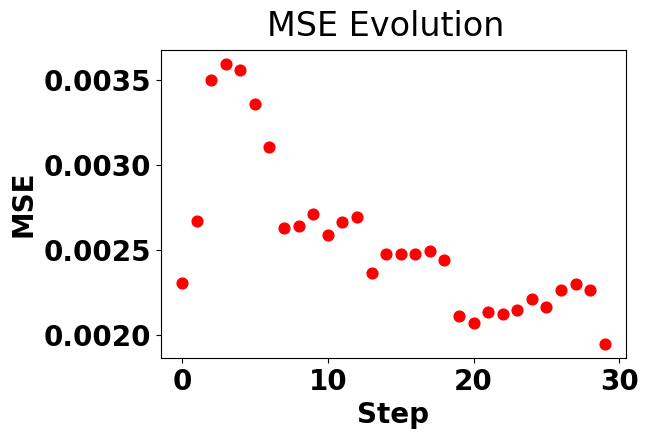

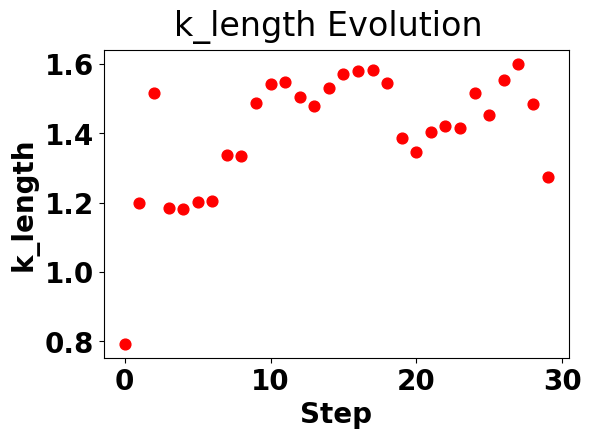

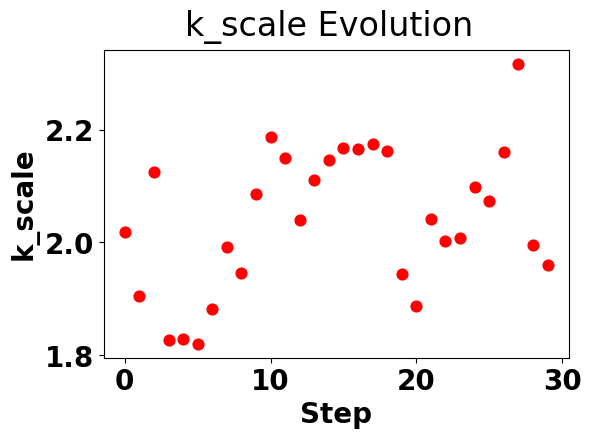

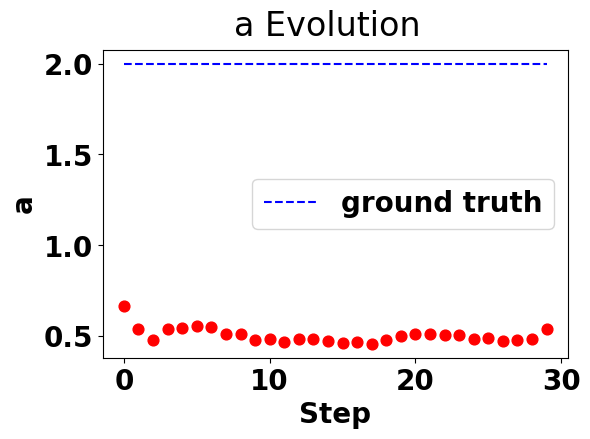

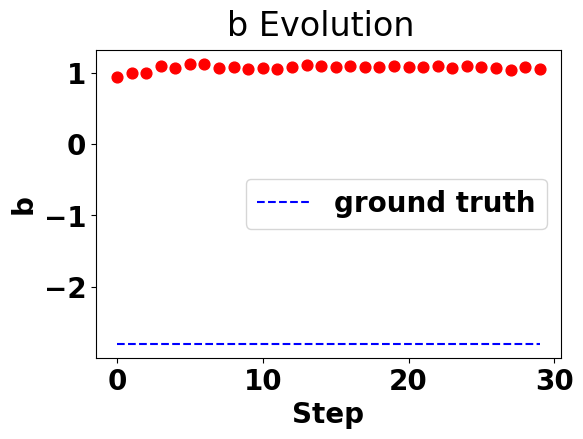

In [ ]:
##############---create dir, list, etc to save each step information---###############
# create a dir to save plots of each step, then these images will be used to make movie at the end
savedir = "/content/video_image_linear_sGP/"
if os.path.exists(savedir) == False:
  os.mkdir(savedir)

# create lists to save uncertainty, mse, k_length, and k_scale at each step
all_uncertainty_linear_mod4 = []
all_mse_linear_mod4 = []
all_k_length = []
all_k_scale = []
all_a = []
all_b = []


model = linear #None
model_prior = linear_prior #None

##############---prepare data---###########
# prepare training data
X = jnp.linspace(0.0, 1, NUM_INIT_POINTS)
idx = jnp.asarray([0, NUM_INIT_POINTS-1])#set seed points to two extreme conditions
indx = idx.tolist()

# select model here
y_all = y4[:, None]                               # Select the toy model
Y = jnp.asarray([y_all[0][0], y_all[199][0]])

# initialize training data
(X_train, y_train, X_test, y_test,
 indices_train, indices_test) = init_training_data_exp(X, Y, y_all, list_of_indices = indx)

exploration_steps = 30

##########------start exploration----###########
for s in range (exploration_steps):
  print("#######---Exploration step {}---#######".format(s))
  # Compute acquisition function
  if model is None or model_prior is None: # Select GP or sGP
    acq, (y_pred, y_sampled), paras_ = step_GP(X_train, y_train, X_test)
  else:
    acq, (y_pred, y_sampled), paras_ = step_sGP(X_train, y_train, X_test, model, model_prior)
  # Get the next point to evaluate
  next_point = acq.argmax()
  # next concentration
  X_next = X_test[next_point]
  print("next point: ", next_point)
  print("next concentration:\n", X_next)

  # Plot
  f, ax1 = plt.subplots(figsize = (6, 4), dpi=300)
  f.suptitle("Exploration step {}".format(s))
  ax1.set_xlabel("Concentration")
  ax1.set_ylabel("$Bandgap$ ($E_g$)")
  ax1.scatter(X_train, y_train, marker='x', c='k', zorder=1, label="Noisy observations", alpha=0.7)
  ax1.plot(X_test, y_pred, lw=1.5, zorder=1, c='b', label='Posterior mean')
  ax1.plot(X_test, acq, lw=1.5, zorder=1, c='black', linestyle = "--", label='Acquisition function')
  ax1.scatter(X_test[next_point], y_pred[next_point], s=60, c='r', label='Next point to measure')
  ax1.fill_between(X_test.squeeze(), y_pred - y_sampled.std(axis=(0,1)), y_pred + y_sampled.std(axis=(0,1)),
                color='r', alpha=0.3, label="Model uncertainty")
  ax1.legend(loc = 'best',fontsize=8)
  ax1.y_lim=(1,2)
  plt.show()
  f.savefig(os.path.join(savedir, '{}.png'.format(s)))   # save this plot to savedir

  # add the uncertainty of this step to the list
  this_uncertainty = y_sampled.std(axis=(0,1)).sum()
  all_uncertainty_linear_mod4.append(this_uncertainty)
  # add the mse of this step to the list
  this_mse = mean_squared_error(y_test,y_pred)
  all_mse_linear_mod4.append(this_mse)
  # add the k_length of this step to the list
  this_k_length = paras_['k_length'].mean()
  all_k_length.append(this_k_length)
  # add the k_scale of this step to the list
  this_k_scale = paras_['k_scale'].mean()
  all_k_scale.append(this_k_scale)
  # add the a of this step to the list
  this_a = paras_['a'].mean()
  all_a.append(this_a)
  # add the a of this step to the list
  this_b = paras_['b'].mean()
  all_b.append(this_b)
  # add the a of this step to the list


  # next 'measurement'
  y_new = jnp.asarray(y_test[next_point])  # get next bandgap
  y_test = jnp.delete(y_test, next_point)  # update bandgap data set
  print("next bandgap: \n", y_new)
  # update training data
  X_train, y_train, X_test = update_datapoints_exp(next_point, X_train, y_train, X_test, y_new)


###############---sumarize the the information from each step---############
# create movie from saved images
aoi.utils.animation_from_png(png_dir=savedir, moviename="evolution_model 4_linear_sGP",
                             savedir= "/content/",
                             duration = 1, remove_dir=False)


# plot the evoltution of uncerstainty
f1, ax = plt.subplots(figsize = (6, 4), dpi=100)
f1.suptitle("Uncertainty Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("Uncertainty")
ax.scatter(np.arange(exploration_steps), all_uncertainty_linear_mod4, s = 60, c='r')

# plot the evolution of MSE
f2, ax = plt.subplots(figsize = (6, 4), dpi=100)
f2.suptitle("MSE Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("MSE")
ax.scatter(np.arange(exploration_steps), all_mse_linear_mod4, s = 60, c='r')

# plot the evolution of k_length
f3, ax = plt.subplots(figsize = (6, 4), dpi=100)
f3.suptitle("k_length Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("k_length")
ax.scatter(np.arange(exploration_steps), all_k_length, s = 60, c='r')

# plot the evolution of k_scale
f4, ax = plt.subplots(figsize = (6, 4), dpi=100)
f4.suptitle("k_scale Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("k_scale")
ax.scatter(np.arange(exploration_steps), all_k_scale, s = 60, c='r')

#Compare a, b, c, with ground truth
groundtruth = np.arange(exploration_steps, dtype = np.float64)
# plot the evolution of a
f4, ax = plt.subplots(figsize = (6, 4), dpi=100)
f4.suptitle("a Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("a")
ax.scatter(np.arange(exploration_steps), all_a, s = 60, c='r')
groundtruth[:] = 2
ax.plot(np.arange(exploration_steps), groundtruth,
        linestyle = '--', c='b', label = "ground truth")
ax.legend()

# plot the evolution of b
f4, ax = plt.subplots(figsize = (6, 4), dpi=100)
f4.suptitle("b Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("b")
ax.scatter(np.arange(exploration_steps), all_b, s = 60, c='r')
groundtruth[:] = -2.8
ax.plot(np.arange(exploration_steps), groundtruth,
        linestyle = '--', c='b', label = "ground truth")
ax.legend()



#######---Exploration step 0---#######


sample: 100%|██████████| 4000/4000 [00:06<00:00, 616.22it/s, 15 steps of size 3.20e-01. acc. prob=0.91] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.74      0.56      0.60      0.08      1.53   1242.13      1.00
          b     -0.59      0.78     -0.64     -1.81      0.68   1055.50      1.00
          c      0.82      0.79      0.87     -0.43      2.15   1111.31      1.00
k_length[0]      1.29      1.51      0.84      0.06      2.81    954.68      1.00
    k_scale      1.75      1.94      1.21      0.08      3.61   1202.83      1.00
      noise      0.01      0.01      0.01      0.00      0.02   1485.46      1.00

next point:  94
next concentration:
 0.47738693467336685


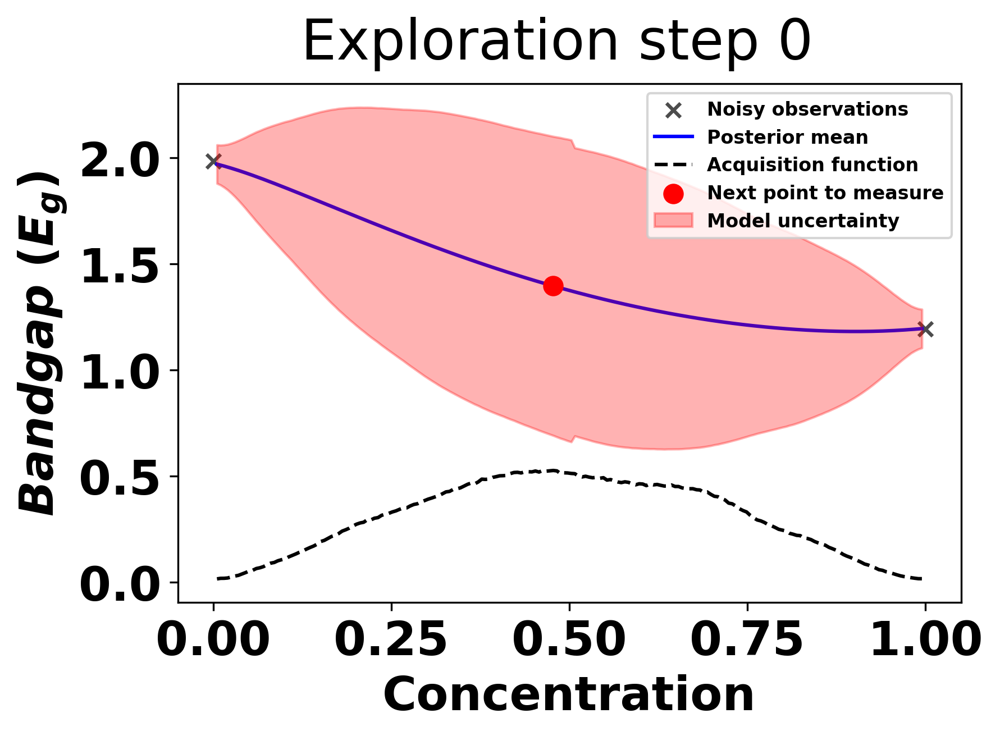

next bandgap: 
 1.6289979496056517
#######---Exploration step 1---#######


sample: 100%|██████████| 4000/4000 [00:07<00:00, 555.45it/s, 15 steps of size 2.74e-01. acc. prob=0.95] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.48      0.36      0.38      0.04      0.95   1352.62      1.00
          b     -0.65      0.64     -0.70     -1.71      0.33   1171.85      1.00
          c      0.86      0.79      0.91     -0.38      2.06   1287.30      1.00
k_length[0]      1.80      1.87      1.24      0.09      3.64    982.98      1.00
    k_scale      1.56      1.55      1.08      0.05      3.42   1171.70      1.00
      noise      0.01      0.01      0.01      0.00      0.02   1479.89      1.00

next point:  149
next concentration:
 0.7587939698492463


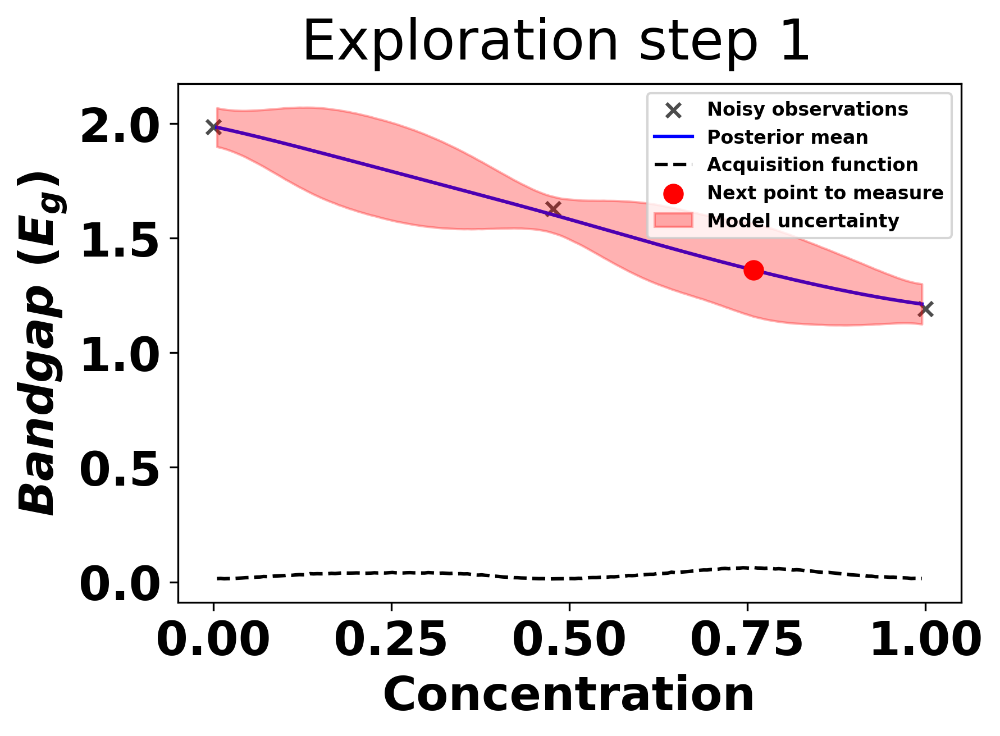

next bandgap: 
 1.3763488412094573
#######---Exploration step 2---#######


sample: 100%|██████████| 4000/4000 [00:07<00:00, 500.95it/s, 7 steps of size 3.19e-01. acc. prob=0.92]  



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.43      0.33      0.35      0.05      0.81   1389.88      1.00
          b     -0.69      0.60     -0.74     -1.63      0.30    853.33      1.00
          c      0.80      0.80      0.84     -0.47      2.13   1106.17      1.00
k_length[0]      2.06      1.94      1.48      0.30      3.93    666.49      1.00
    k_scale      1.62      1.82      1.11      0.08      3.34   1124.59      1.00
      noise      0.01      0.01      0.00      0.00      0.01   1459.60      1.00

next point:  41
next concentration:
 0.21105527638190955


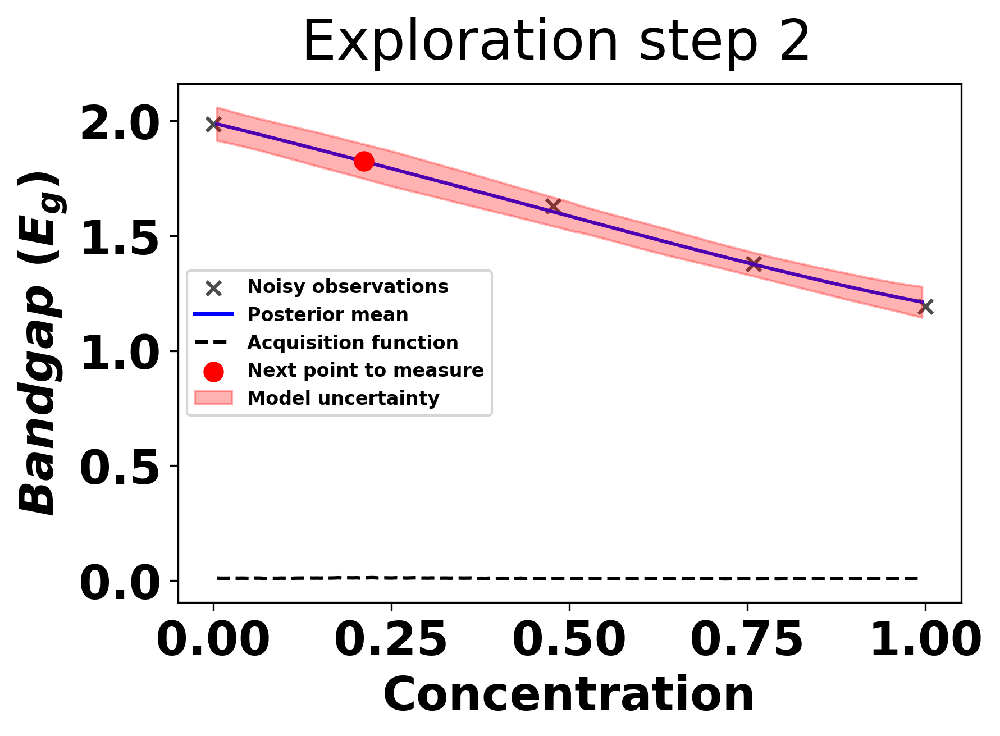

next bandgap: 
 1.8414998777592875
#######---Exploration step 3---#######


sample: 100%|██████████| 4000/4000 [00:06<00:00, 574.19it/s, 15 steps of size 3.01e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.40      0.30      0.33      0.04      0.78   1439.08      1.00
          b     -0.66      0.56     -0.71     -1.49      0.32   1356.63      1.00
          c      0.80      0.79      0.84     -0.42      2.10   1182.97      1.00
k_length[0]      1.92      1.49      1.47      0.43      3.55    605.31      1.00
    k_scale      1.59      1.56      1.07      0.11      3.46   1159.32      1.00
      noise      0.00      0.00      0.00      0.00      0.01   1513.79      1.00

next point:  191
next concentration:
 0.9798994974874372


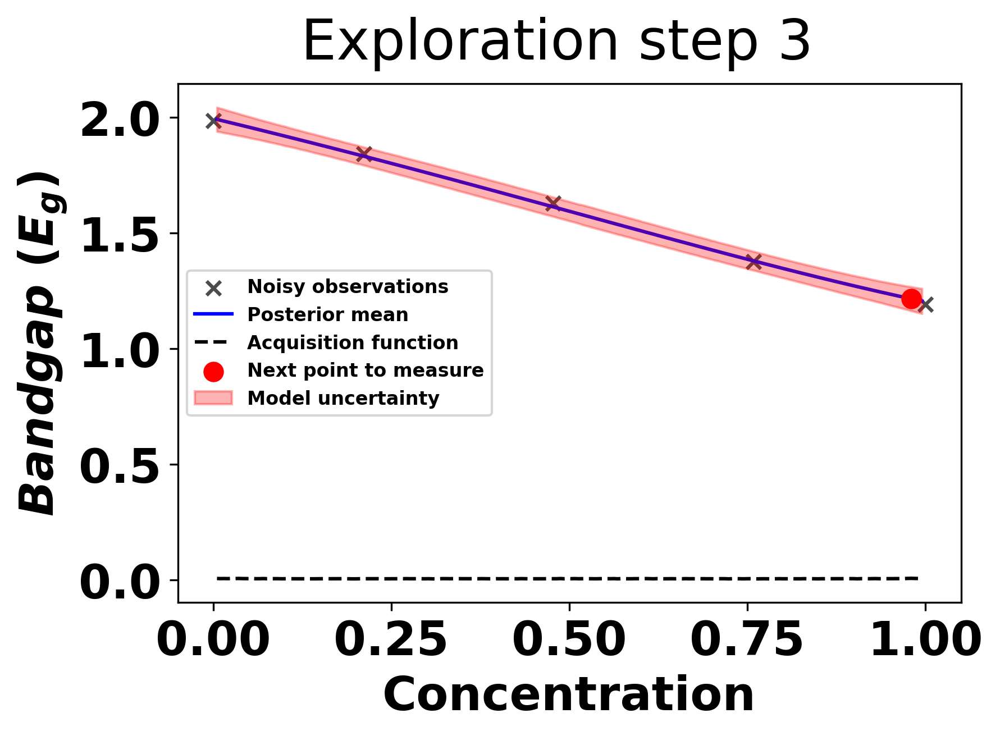

next bandgap: 
 1.1910105784353446
#######---Exploration step 4---#######


sample: 100%|██████████| 4000/4000 [00:07<00:00, 544.47it/s, 7 steps of size 3.73e-01. acc. prob=0.88]  



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.38      0.27      0.31      0.04      0.75   1369.04      1.00
          b     -0.63      0.56     -0.66     -1.50      0.27   1342.90      1.00
          c      0.75      0.80      0.82     -0.40      2.14   1022.53      1.00
k_length[0]      1.73      1.18      1.43      0.44      2.84    641.34      1.00
    k_scale      1.56      1.58      1.11      0.04      3.19    991.58      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1385.96      1.00

next point:  0
next concentration:
 0.005025125628140704


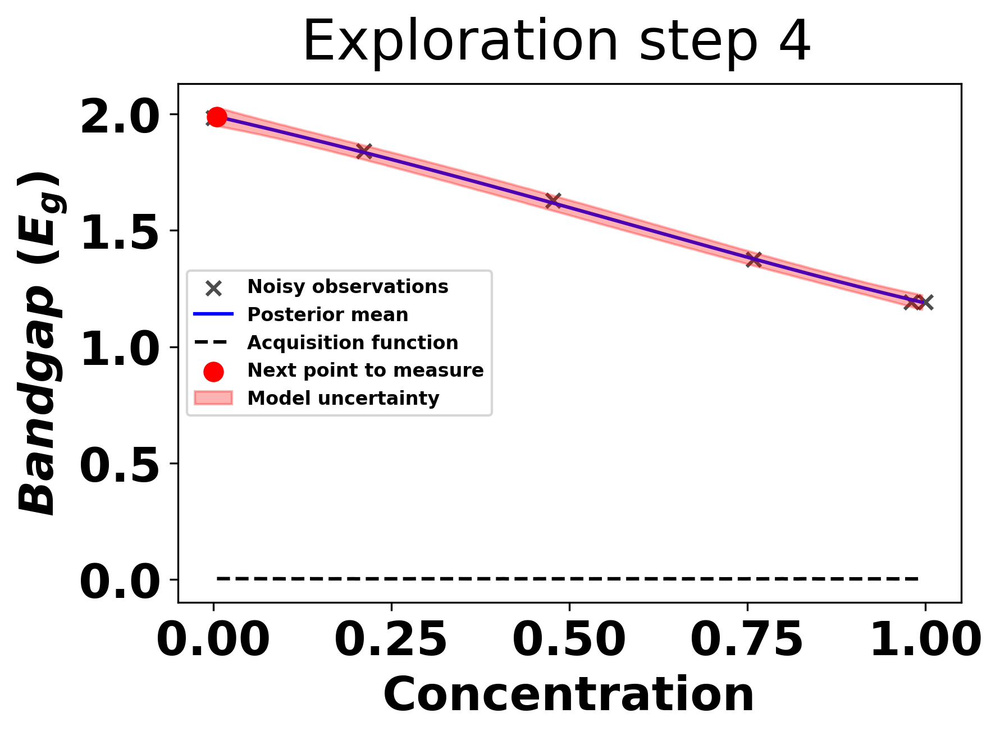

next bandgap: 
 2.004173188210318
#######---Exploration step 5---#######


sample: 100%|██████████| 4000/4000 [00:08<00:00, 448.90it/s, 7 steps of size 3.48e-01. acc. prob=0.90]  



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.37      0.28      0.30      0.03      0.73   1263.14      1.00
          b     -0.65      0.55     -0.70     -1.52      0.23   1170.39      1.00
          c      0.72      0.80      0.80     -0.57      1.97   1048.77      1.00
k_length[0]      1.81      1.22      1.51      0.56      3.02    605.68      1.00
    k_scale      1.54      1.45      1.12      0.08      3.20   1235.76      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1541.29      1.00

next point:  98
next concentration:
 0.5125628140703518


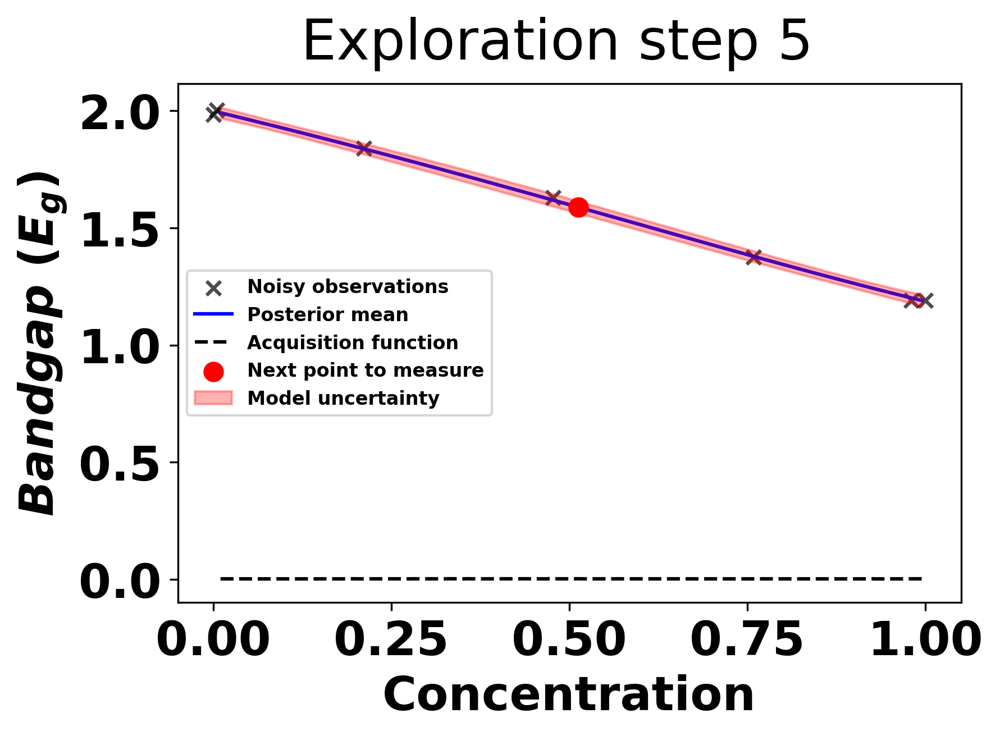

next bandgap: 
 1.5820630561986249
#######---Exploration step 6---#######


sample: 100%|██████████| 4000/4000 [00:08<00:00, 449.46it/s, 7 steps of size 3.92e-01. acc. prob=0.86] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.36      0.26      0.29      0.04      0.71   1094.15      1.00
          b     -0.66      0.53     -0.69     -1.51      0.18   1299.70      1.00
          c      0.75      0.77      0.80     -0.47      1.99   1005.19      1.00
k_length[0]      1.79      1.15      1.52      0.58      2.92    483.78      1.00
    k_scale      1.55      1.51      1.09      0.06      3.27    812.59      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1523.21      1.00

next point:  2
next concentration:
 0.020100502512562814


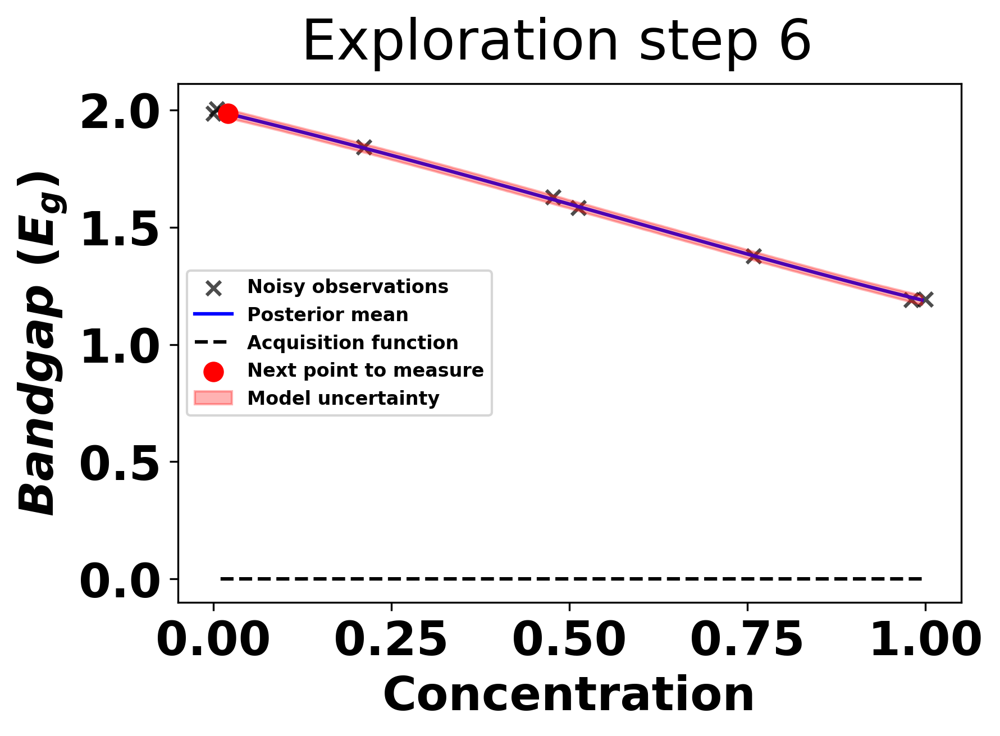

next bandgap: 
 1.9859403708373211
#######---Exploration step 7---#######


sample: 100%|██████████| 4000/4000 [00:10<00:00, 388.83it/s, 7 steps of size 4.13e-01. acc. prob=0.86] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.36      0.27      0.29      0.03      0.70   1455.09      1.00
          b     -0.62      0.53     -0.66     -1.49      0.21   1274.38      1.00
          c      0.72      0.78      0.76     -0.53      1.96   1221.91      1.00
k_length[0]      1.73      0.92      1.51      0.60      2.85    752.65      1.00
    k_scale      1.62      1.67      1.15      0.05      3.33   1183.56      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1478.02      1.00

next point:  189
next concentration:
 0.9899497487437187


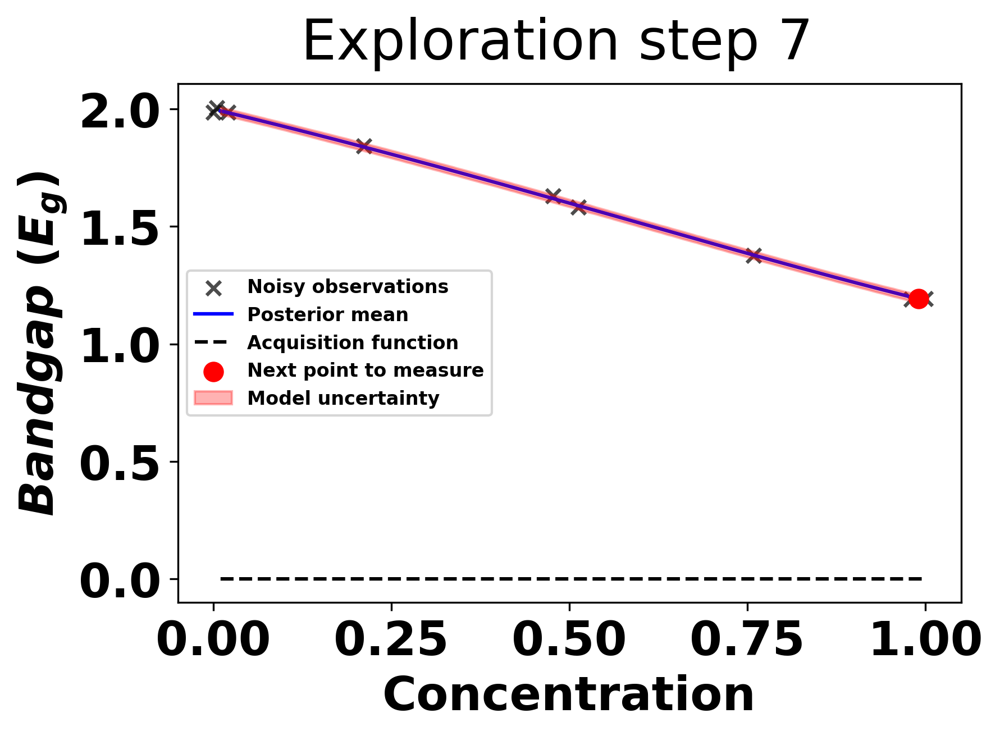

next bandgap: 
 1.18922900930596
#######---Exploration step 8---#######


sample: 100%|██████████| 4000/4000 [00:09<00:00, 434.26it/s, 7 steps of size 3.61e-01. acc. prob=0.90] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.35      0.26      0.29      0.04      0.72   1093.85      1.00
          b     -0.61      0.54     -0.64     -1.52      0.26   1426.81      1.00
          c      0.70      0.78      0.75     -0.50      1.99   1225.37      1.00
k_length[0]      1.73      0.98      1.52      0.65      2.81    405.53      1.00
    k_scale      1.64      1.60      1.15      0.12      3.54   1179.69      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1686.40      1.00

next point:  137
next concentration:
 0.7185929648241206


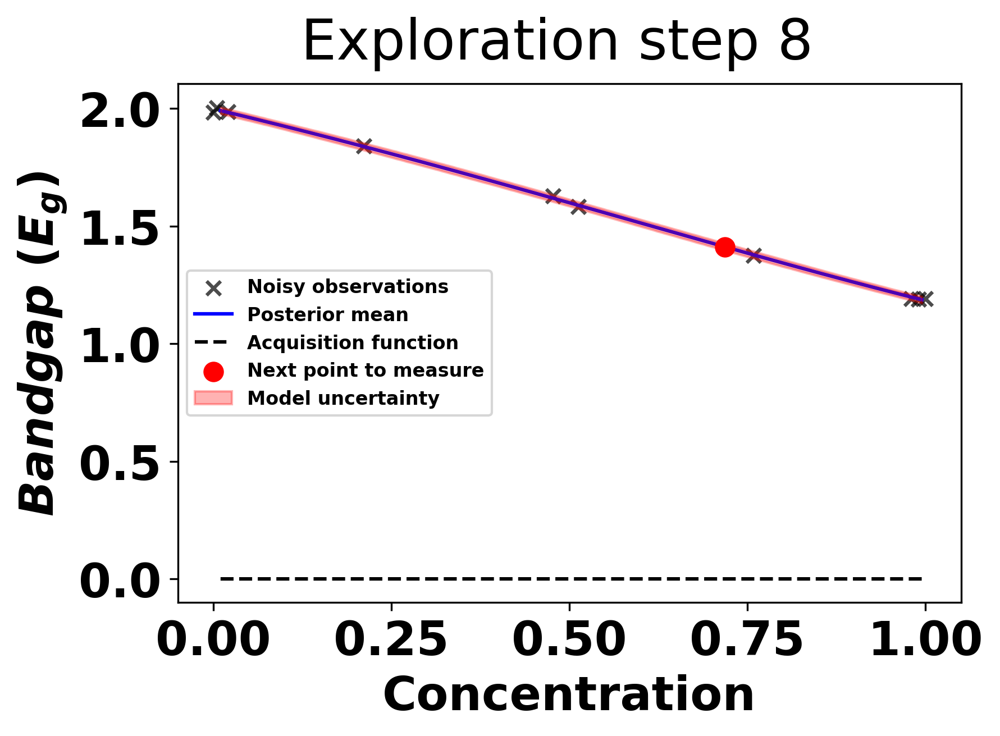

next bandgap: 
 1.4237957439176074
#######---Exploration step 9---#######


sample: 100%|██████████| 4000/4000 [00:08<00:00, 456.95it/s, 11 steps of size 3.37e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.32      0.23      0.26      0.02      0.62   1117.22      1.00
          b     -0.66      0.51     -0.67     -1.51      0.16   1327.80      1.00
          c      0.73      0.79      0.80     -0.57      1.98   1114.44      1.00
k_length[0]      1.81      0.99      1.59      0.66      2.89    511.29      1.00
    k_scale      1.64      1.81      1.13      0.06      3.45   1220.18      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1737.56      1.00

next point:  51
next concentration:
 0.2763819095477387


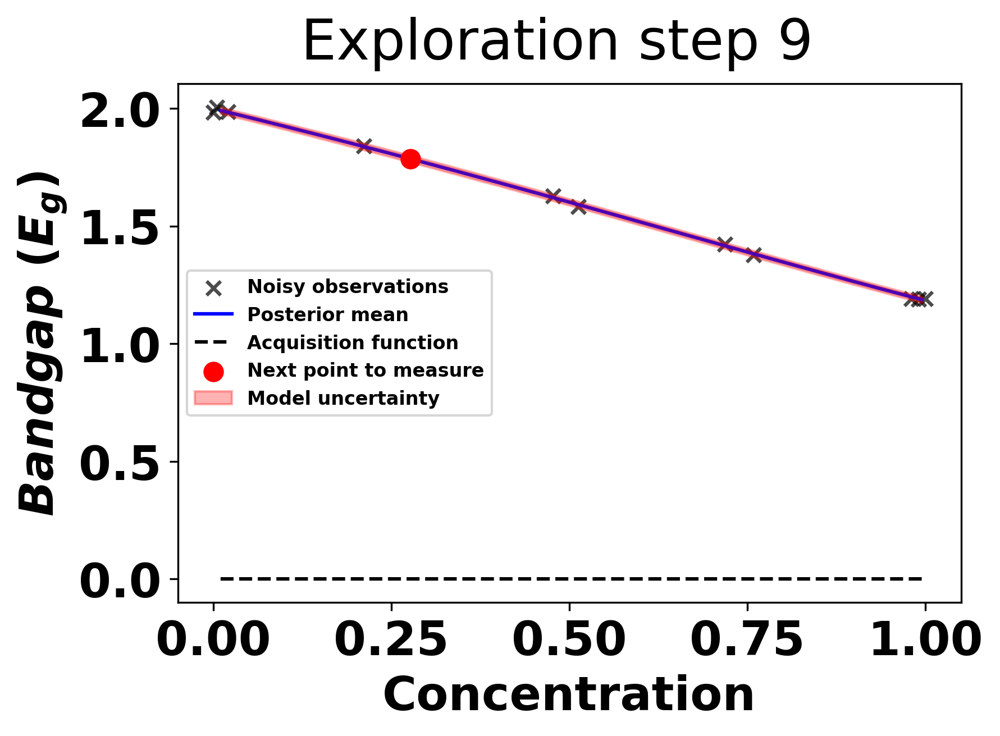

next bandgap: 
 1.7833915933641291
#######---Exploration step 10---#######


sample: 100%|██████████| 4000/4000 [00:09<00:00, 418.16it/s, 15 steps of size 3.49e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.32      0.23      0.26      0.03      0.61   1087.55      1.00
          b     -0.66      0.51     -0.68     -1.52      0.14   1255.79      1.00
          c      0.69      0.78      0.75     -0.50      1.95   1225.28      1.00
k_length[0]      1.81      0.76      1.66      0.78      2.95   1011.32      1.00
    k_scale      1.62      1.51      1.17      0.10      3.43   1204.35      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1897.53      1.00

next point:  102
next concentration:
 0.5477386934673367


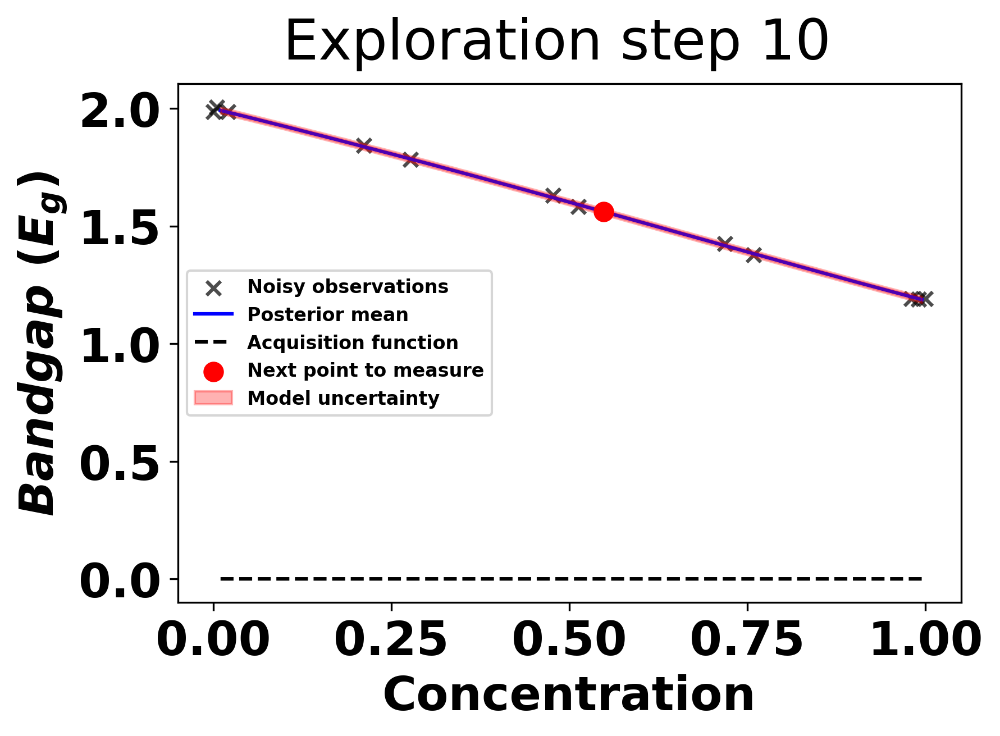

next bandgap: 
 1.5639240153534495
#######---Exploration step 11---#######


sample: 100%|██████████| 4000/4000 [00:08<00:00, 477.52it/s, 7 steps of size 3.35e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.31      0.23      0.26      0.04      0.61   1202.28      1.00
          b     -0.68      0.50     -0.68     -1.52      0.08   1210.18      1.00
          c      0.72      0.79      0.76     -0.41      2.12   1184.25      1.00
k_length[0]      1.81      0.74      1.68      0.77      2.97    932.14      1.00
    k_scale      1.62      1.81      1.11      0.10      3.43   1284.27      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1951.77      1.00

next point:  186
next concentration:
 0.9949748743718593


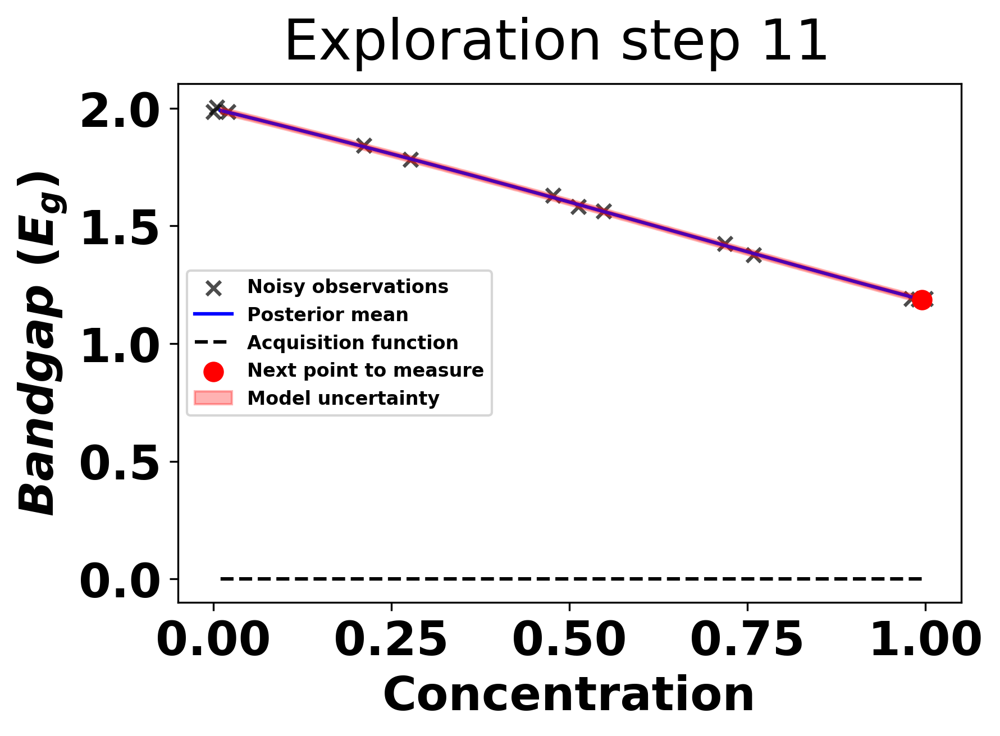

next bandgap: 
 1.1957533669756713
#######---Exploration step 12---#######


sample: 100%|██████████| 4000/4000 [00:09<00:00, 403.67it/s, 7 steps of size 3.05e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.32      0.23      0.26      0.03      0.62   1240.04      1.00
          b     -0.66      0.50     -0.66     -1.52      0.09   1114.40      1.00
          c      0.72      0.77      0.75     -0.61      1.90   1174.24      1.00
k_length[0]      1.81      0.74      1.68      0.75      2.88    994.73      1.00
    k_scale      1.60      1.57      1.15      0.09      3.30   1411.37      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1940.61      1.00

next point:  157
next concentration:
 0.8391959798994975


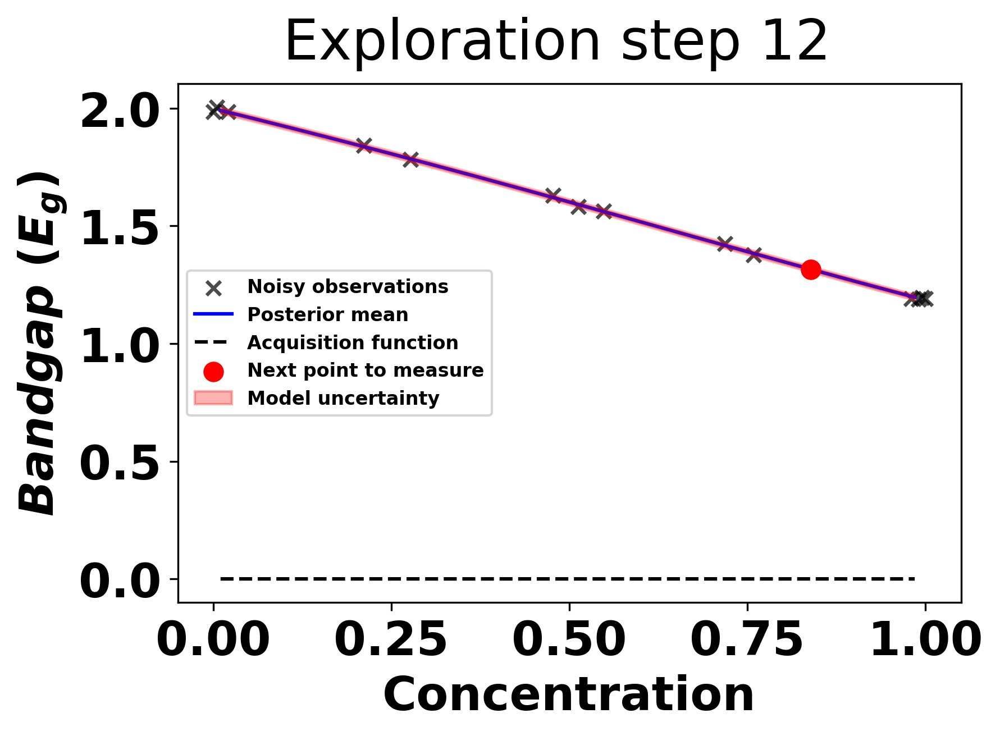

next bandgap: 
 1.2001927938451307
#######---Exploration step 13---#######


sample: 100%|██████████| 4000/4000 [00:09<00:00, 435.64it/s, 15 steps of size 2.95e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.48      0.38      0.36      0.03      0.98    903.80      1.00
          b     -0.56      0.60     -0.60     -1.53      0.42   1115.20      1.00
          c      0.80      0.78      0.87     -0.47      1.99   1175.57      1.00
k_length[0]      1.49      1.02      1.23      0.21      2.63    700.10      1.00
    k_scale      1.50      1.49      1.05      0.06      3.21   1251.22      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1068.75      1.00

next point:  166
next concentration:
 0.8894472361809045


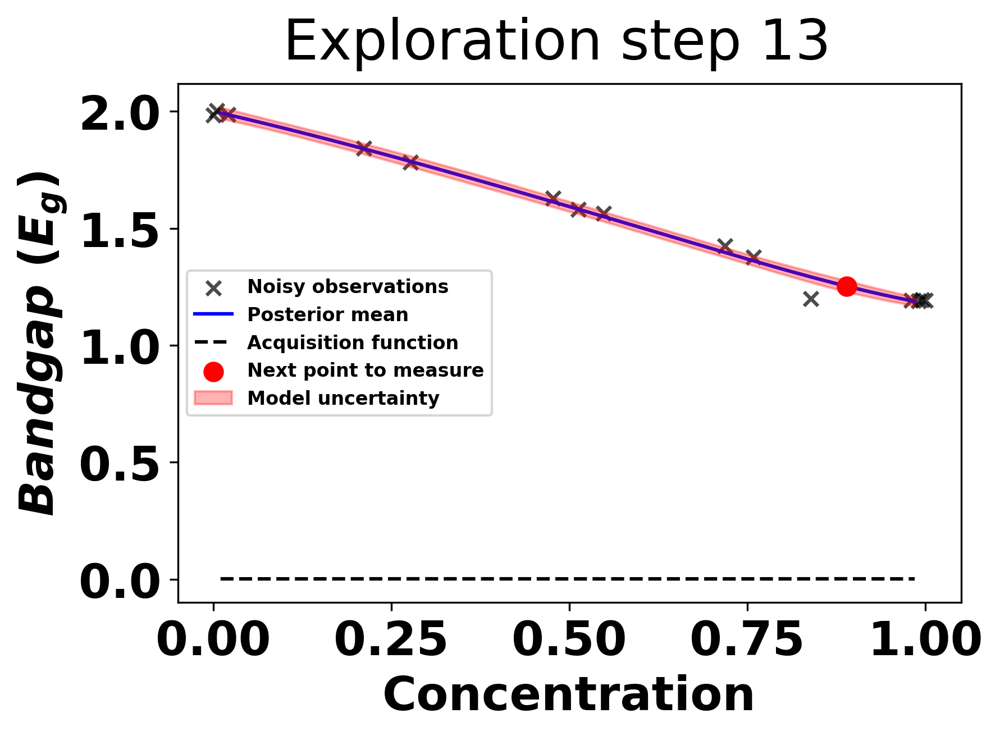

next bandgap: 
 1.196824569060698
#######---Exploration step 14---#######


sample: 100%|██████████| 4000/4000 [00:09<00:00, 423.32it/s, 7 steps of size 3.19e-01. acc. prob=0.85] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.55      0.46      0.42      0.04      1.13    881.33      1.00
          b     -0.51      0.68     -0.56     -1.43      0.73    844.78      1.00
          c      0.84      0.75      0.91     -0.27      2.12    514.41      1.00
k_length[0]      1.62      2.16      1.08      0.20      2.72    108.70      1.00
    k_scale      1.45      1.56      1.02      0.06      2.97    911.92      1.00
      noise      0.00      0.00      0.00      0.00      0.00    949.26      1.00

next point:  71
next concentration:
 0.38190954773869346


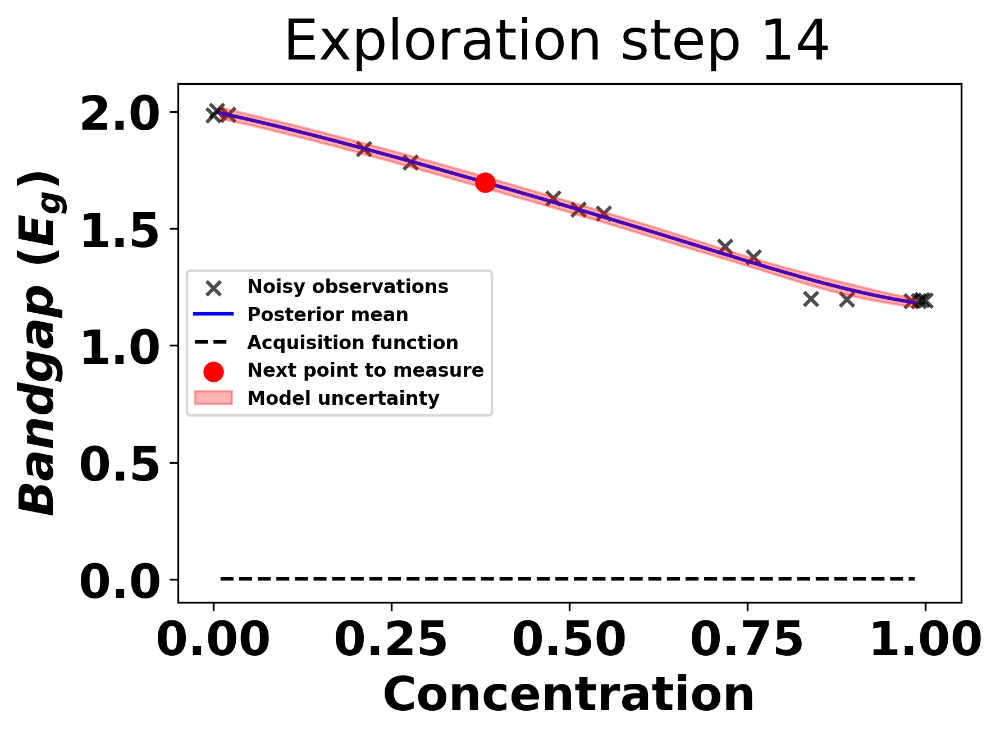

next bandgap: 
 1.6850825460822674
#######---Exploration step 15---#######


sample: 100%|██████████| 4000/4000 [00:10<00:00, 390.49it/s, 15 steps of size 2.87e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.57      0.49      0.43      0.03      1.17    890.07      1.00
          b     -0.49      0.67     -0.54     -1.60      0.53    915.29      1.00
          c      0.81      0.78      0.89     -0.44      2.08    982.72      1.00
k_length[0]      1.31      1.06      1.09      0.22      2.31    555.41      1.00
    k_scale      1.52      1.59      1.01      0.06      3.28   1063.53      1.00
      noise      0.00      0.00      0.00      0.00      0.00    933.01      1.00

next point:  159
next concentration:
 0.8592964824120604


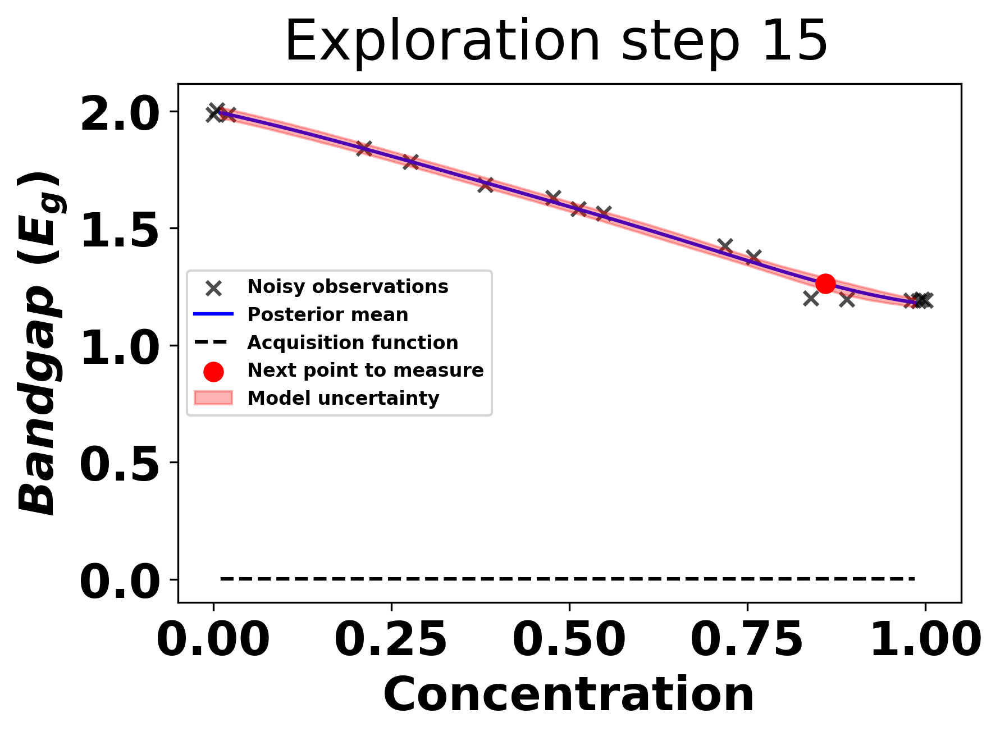

next bandgap: 
 1.2002135122384354
#######---Exploration step 16---#######


sample: 100%|██████████| 4000/4000 [00:10<00:00, 364.96it/s, 7 steps of size 2.51e-01. acc. prob=0.85] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.73      0.58      0.57      0.02      1.44   1039.38      1.00
          b     -0.31      0.75     -0.35     -1.41      1.01    781.77      1.00
          c      0.95      0.73      1.03     -0.13      2.17    933.53      1.00
k_length[0]      0.76      0.67      0.46      0.20      1.52    514.24      1.00
    k_scale      1.26      1.45      0.82      0.04      2.69    907.10      1.00
      noise      0.00      0.00      0.00      0.00      0.00    533.92      1.00

next point:  165
next concentration:
 0.8994974874371859


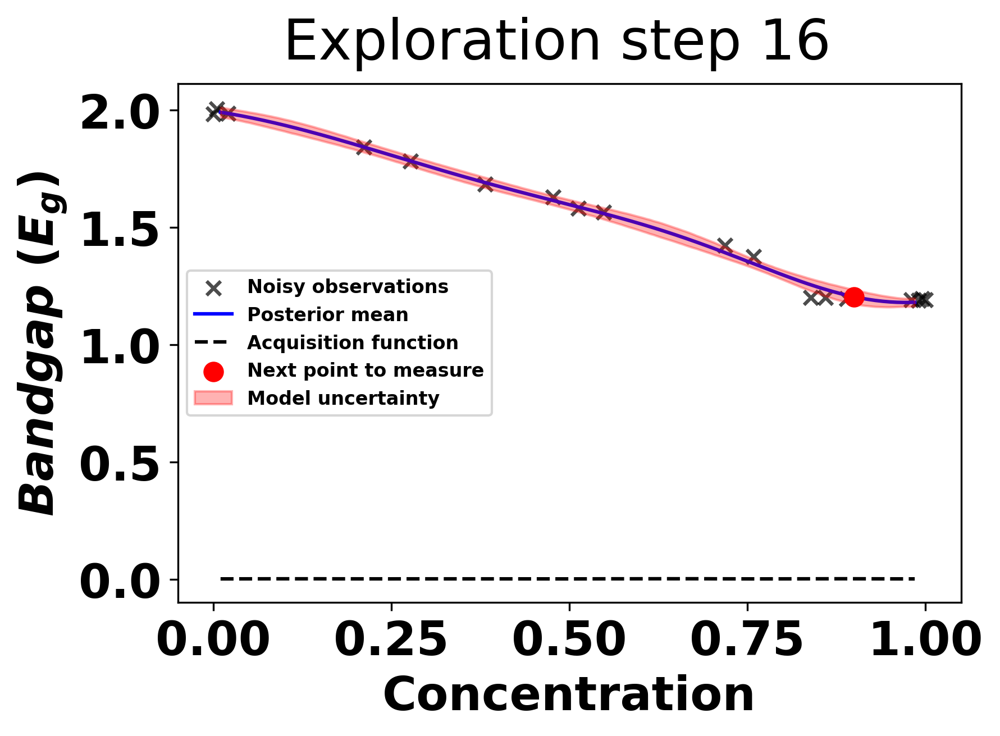

next bandgap: 
 1.1993286584538547
#######---Exploration step 17---#######


sample: 100%|██████████| 4000/4000 [00:13<00:00, 294.20it/s, 15 steps of size 2.83e-01. acc. prob=0.85]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.79      0.58      0.64      0.04      1.59    824.88      1.00
          b     -0.30      0.75     -0.32     -1.47      0.99    799.44      1.00
          c      0.99      0.70      1.05     -0.13      2.14    727.49      1.00
k_length[0]      0.65      0.56      0.42      0.20      1.26    402.90      1.00
    k_scale      1.13      1.16      0.78      0.05      2.40    956.11      1.00
      noise      0.00      0.00      0.00      0.00      0.00    496.60      1.00

next point:  119
next concentration:
 0.6432160804020101


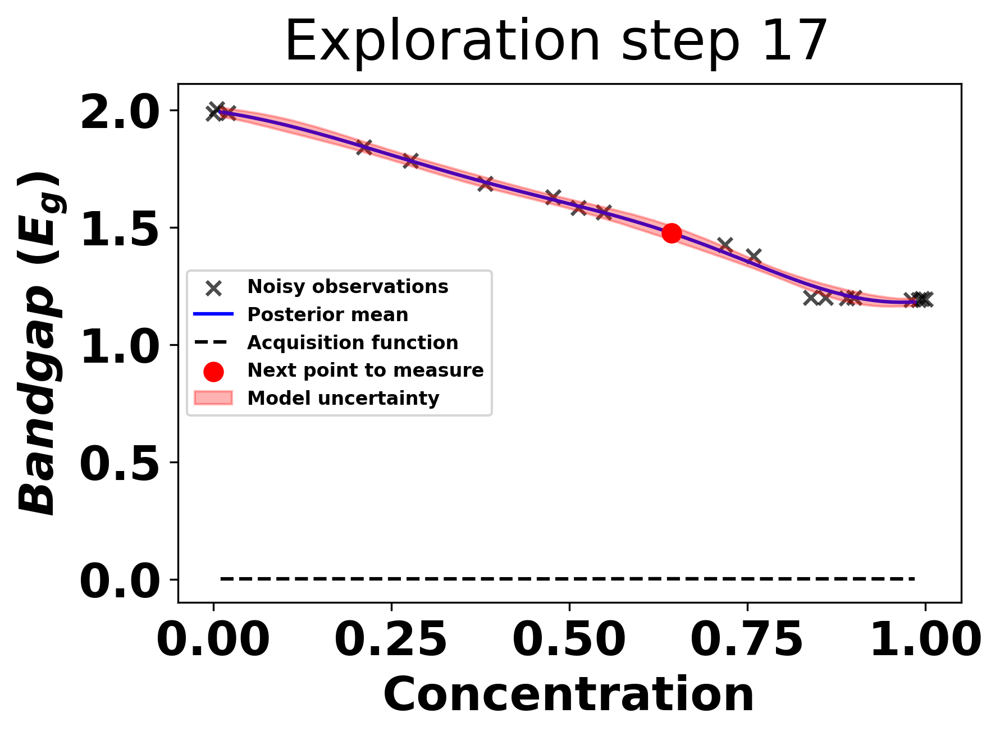

next bandgap: 
 1.4935538760994824
#######---Exploration step 18---#######


sample: 100%|██████████| 4000/4000 [00:09<00:00, 420.05it/s, 15 steps of size 2.83e-01. acc. prob=0.88]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.85      0.61      0.69      0.04      1.70   1000.14      1.00
          b     -0.23      0.74     -0.25     -1.51      0.90    919.66      1.00
          c      1.03      0.66      1.09     -0.02      2.09    869.80      1.00
k_length[0]      0.50      0.49      0.37      0.19      0.86    325.11      1.00
    k_scale      1.07      1.03      0.77      0.06      2.25    804.44      1.00
      noise      0.00      0.00      0.00      0.00      0.00    408.35      1.00

next point:  20
next concentration:
 0.11557788944723618


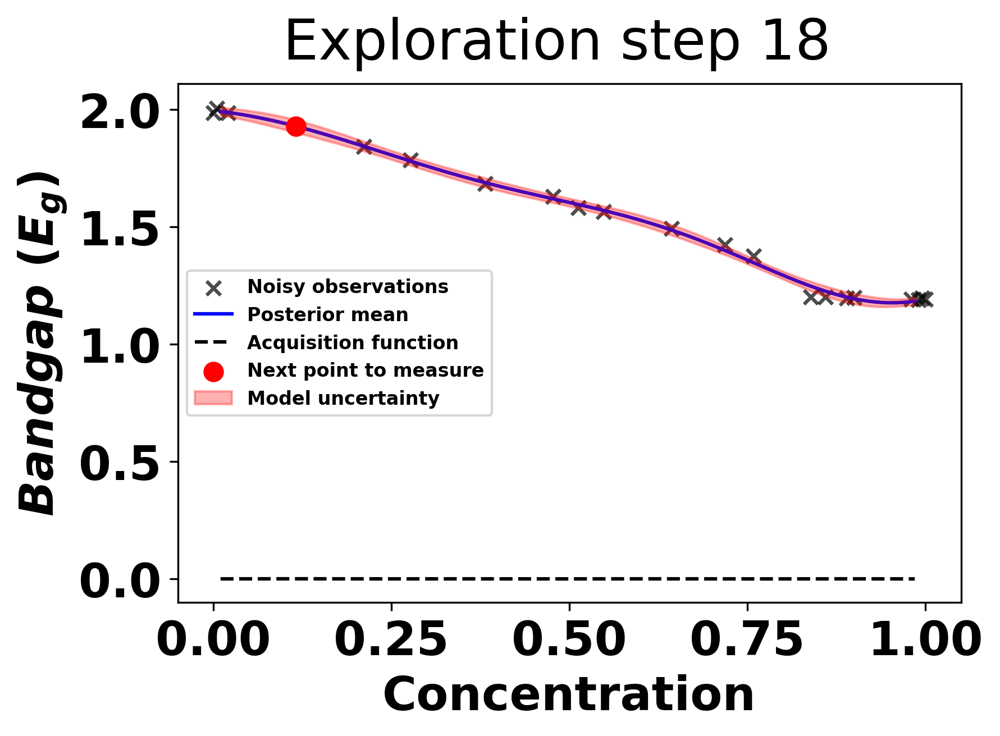

next bandgap: 
 1.9969775026954493
#######---Exploration step 19---#######


sample: 100%|██████████| 4000/4000 [00:11<00:00, 362.26it/s, 15 steps of size 1.42e-01. acc. prob=0.95]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.78      0.58      0.63      0.03      1.56    838.58      1.00
          b     -0.11      0.78     -0.11     -1.36      1.19    796.54      1.00
          c      0.87      0.71      0.94     -0.27      2.00    880.57      1.00
k_length[0]      0.53      0.57      0.36      0.17      1.06    166.16      1.00
    k_scale      1.17      1.22      0.80      0.06      2.47    964.94      1.00
      noise      0.00      0.00      0.00      0.00      0.00    137.95      1.00

next point:  13
next concentration:
 0.08040201005025126


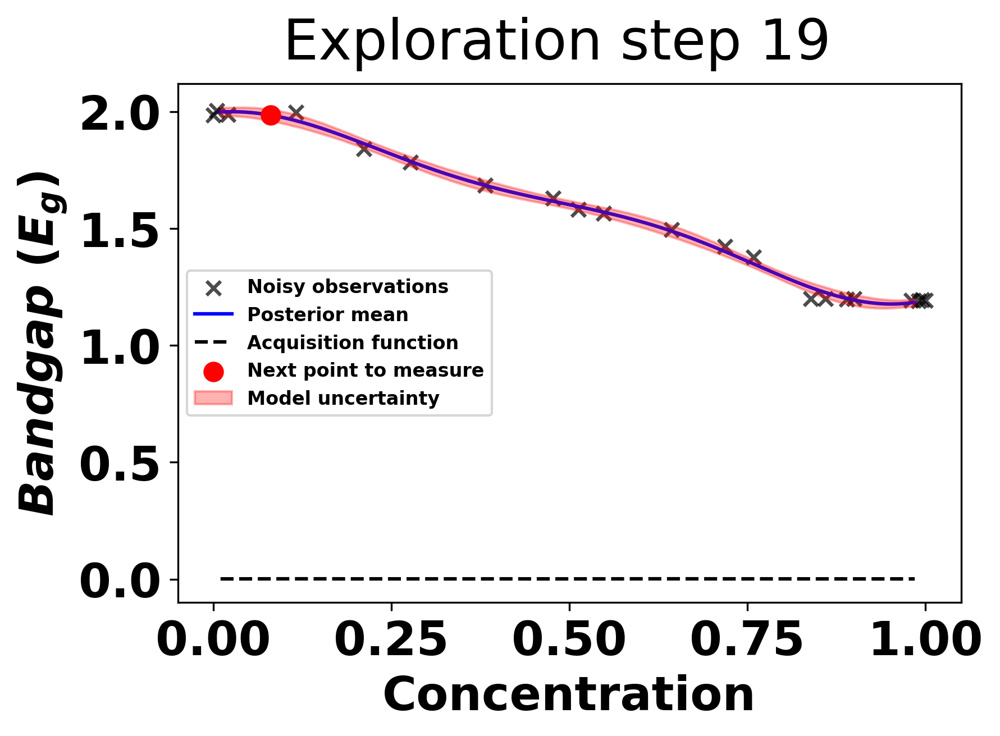

next bandgap: 
 2.0022384356331293
#######---Exploration step 20---#######


sample: 100%|██████████| 4000/4000 [00:10<00:00, 386.08it/s, 15 steps of size 2.52e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.78      0.57      0.63      0.06      1.57   1131.46      1.00
          b     -0.05      0.76     -0.07     -1.32      1.11   1016.22      1.00
          c      0.91      0.66      0.97     -0.10      2.00    798.34      1.00
k_length[0]      0.41      0.31      0.35      0.21      0.45     86.54      1.00
    k_scale      1.03      0.94      0.76      0.03      2.11    977.00      1.00
      noise      0.00      0.00      0.00      0.00      0.00     63.42      1.00

next point:  116
next concentration:
 0.6381909547738693


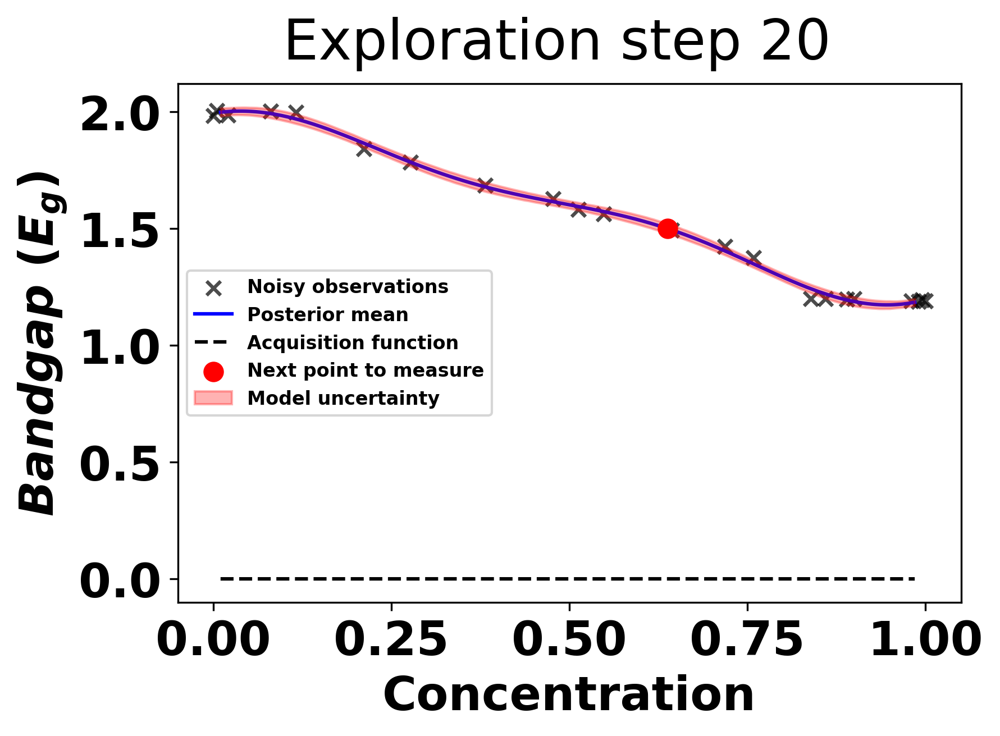

next bandgap: 
 1.501880430025456
#######---Exploration step 21---#######


sample: 100%|██████████| 4000/4000 [00:10<00:00, 371.04it/s, 15 steps of size 2.95e-01. acc. prob=0.89]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.81      0.59      0.65      0.04      1.60    900.83      1.00
          b     -0.02      0.76     -0.03     -1.19      1.28    939.73      1.00
          c      0.89      0.65      0.95     -0.13      1.95    784.02      1.00
k_length[0]      0.35      0.11      0.35      0.25      0.45    120.55      1.01
    k_scale      1.08      1.13      0.76      0.05      2.20   1083.05      1.00
      noise      0.00      0.00      0.00      0.00      0.00    185.51      1.01

next point:  57
next concentration:
 0.32160804020100503


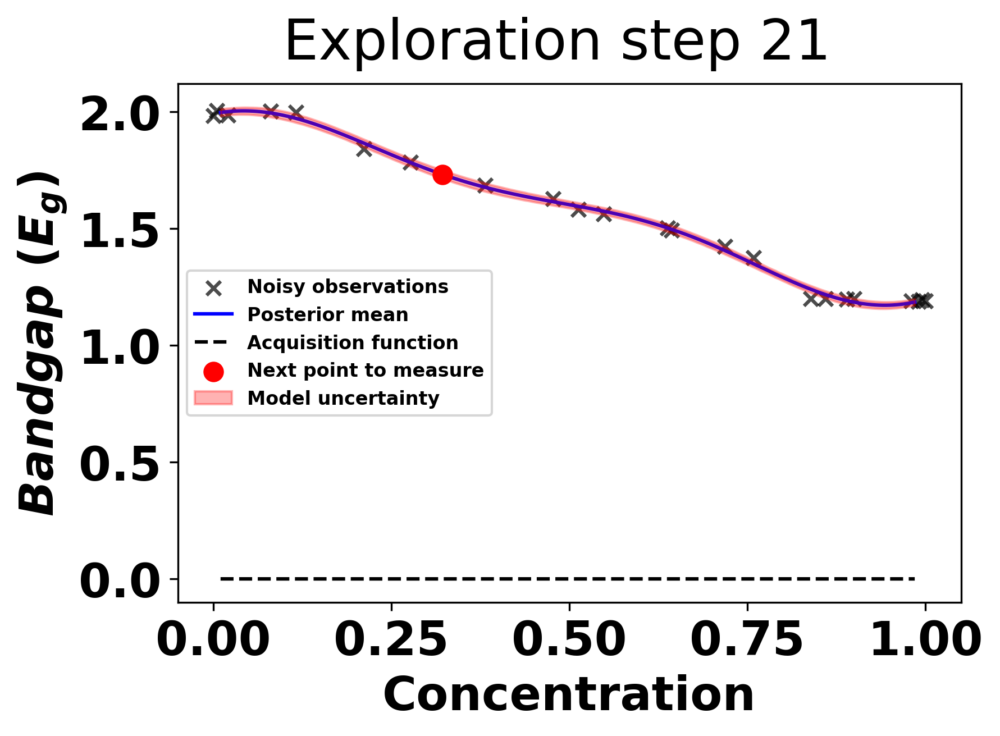

next bandgap: 
 1.7382319142123888
#######---Exploration step 22---#######


sample: 100%|██████████| 4000/4000 [00:10<00:00, 373.13it/s, 15 steps of size 2.77e-01. acc. prob=0.89]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.80      0.58      0.66      0.07      1.64   1291.37      1.00
          b     -0.04      0.79     -0.03     -1.24      1.37    380.27      1.00
          c      0.92      0.68      0.96     -0.15      2.03    421.44      1.00
k_length[0]      0.34      0.07      0.35      0.24      0.44    124.19      1.00
    k_scale      1.04      1.04      0.76      0.02      2.22    617.92      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1407.95      1.00

next point:  15
next concentration:
 0.09547738693467336


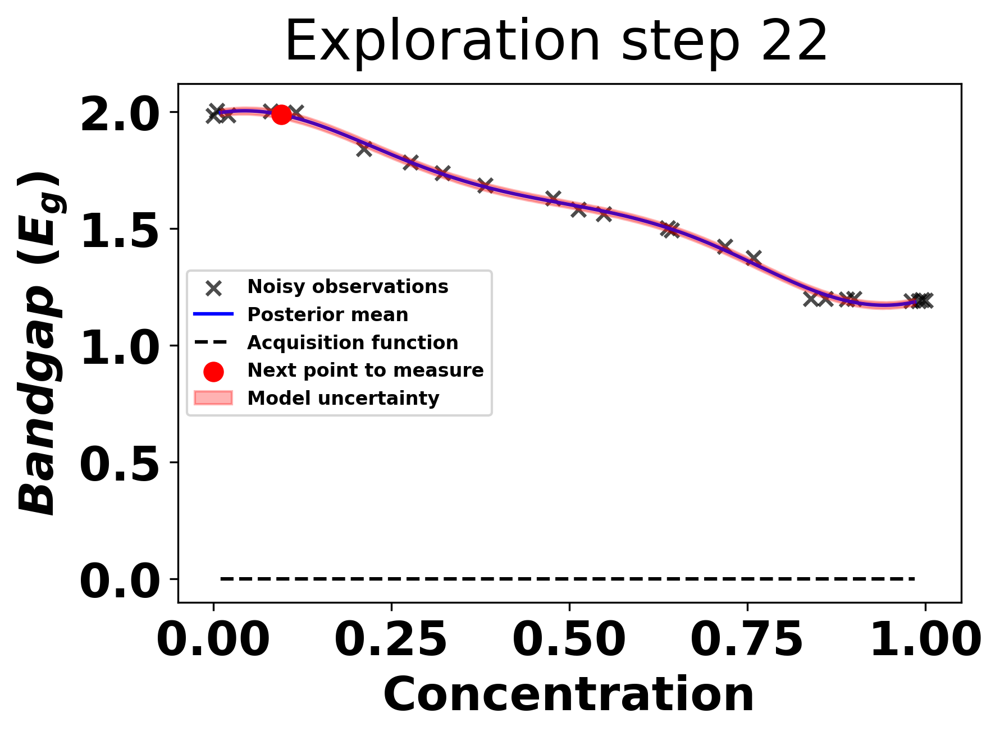

next bandgap: 
 1.9849300160178573
#######---Exploration step 23---#######


sample: 100%|██████████| 4000/4000 [00:11<00:00, 340.83it/s, 7 steps of size 3.48e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.83      0.64      0.66      0.03      1.64    986.38      1.00
          b     -0.01      0.78     -0.03     -1.27      1.28    921.04      1.00
          c      0.89      0.68      0.95     -0.17      1.95    725.13      1.00
k_length[0]      0.35      0.09      0.35      0.25      0.44    223.81      1.01
    k_scale      1.09      1.10      0.78      0.07      2.29    977.91      1.00
      noise      0.00      0.00      0.00      0.00      0.00    254.86      1.01

next point:  29
next concentration:
 0.17587939698492464


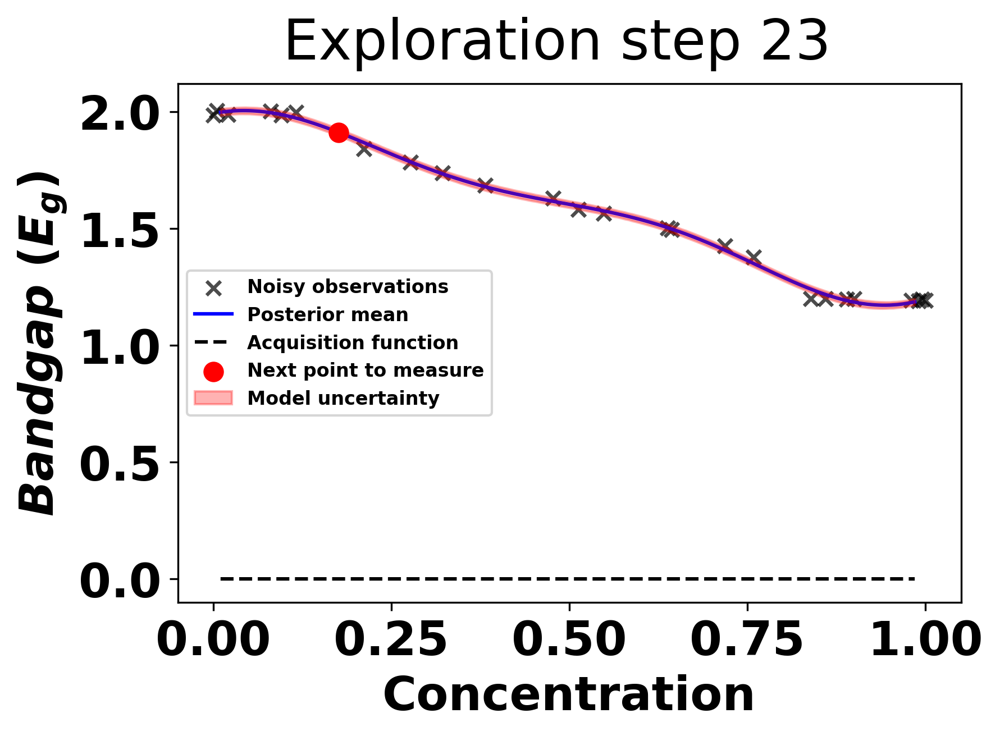

next bandgap: 
 2.0040326454016326
#######---Exploration step 24---#######


sample: 100%|██████████| 4000/4000 [00:12<00:00, 324.59it/s, 15 steps of size 1.99e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.78      0.59      0.62      0.04      1.61    955.21      1.00
          b     -0.09      0.75     -0.11     -1.27      1.18    878.76      1.00
          c      0.95      0.63      1.03     -0.05      1.97   1122.06      1.00
k_length[0]      0.41      0.44      0.34      0.24      0.44    138.56      1.01
    k_scale      1.02      1.02      0.74      0.05      2.02    945.77      1.00
      noise      0.00      0.00      0.00      0.00      0.00    110.45      1.00

next point:  109
next concentration:
 0.6180904522613065


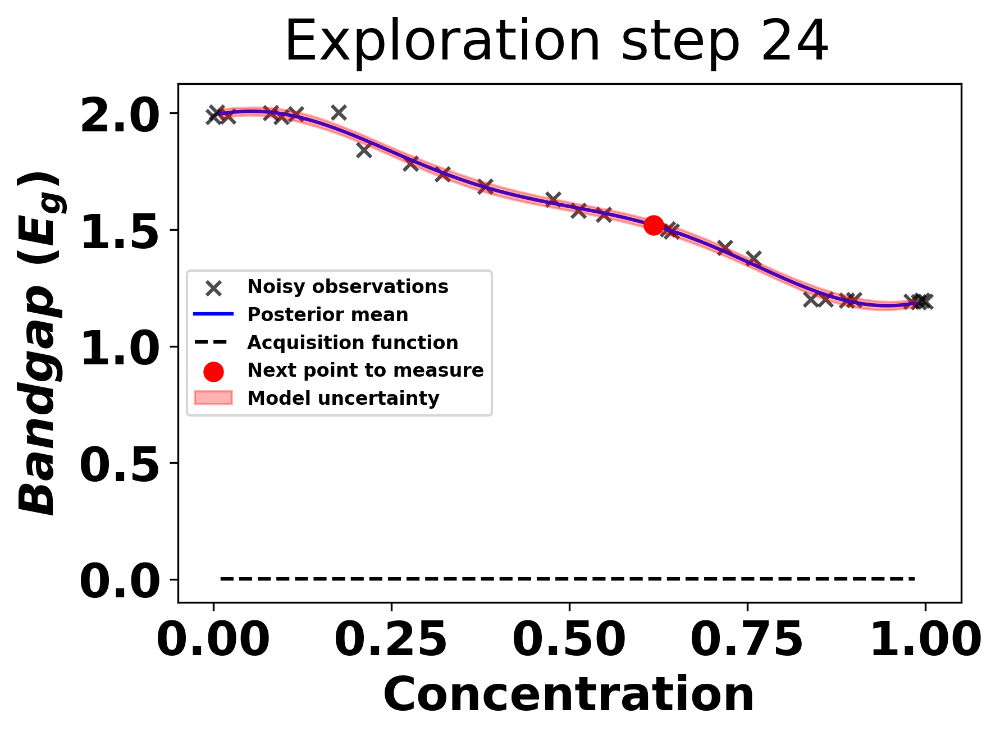

next bandgap: 
 1.5016727405871986
#######---Exploration step 25---#######


sample: 100%|██████████| 4000/4000 [00:13<00:00, 304.23it/s, 7 steps of size 2.61e-01. acc. prob=0.89] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.79      0.60      0.63      0.03      1.57    775.63      1.00
          b     -0.11      0.77     -0.10     -1.44      1.02    822.89      1.00
          c      0.96      0.67      1.01     -0.09      2.04    693.59      1.00
k_length[0]      0.40      0.29      0.34      0.23      0.46     69.48      1.00
    k_scale      1.01      1.01      0.74      0.02      2.12    697.82      1.00
      noise      0.00      0.00      0.00      0.00      0.00     82.34      1.00

next point:  60
next concentration:
 0.35175879396984927


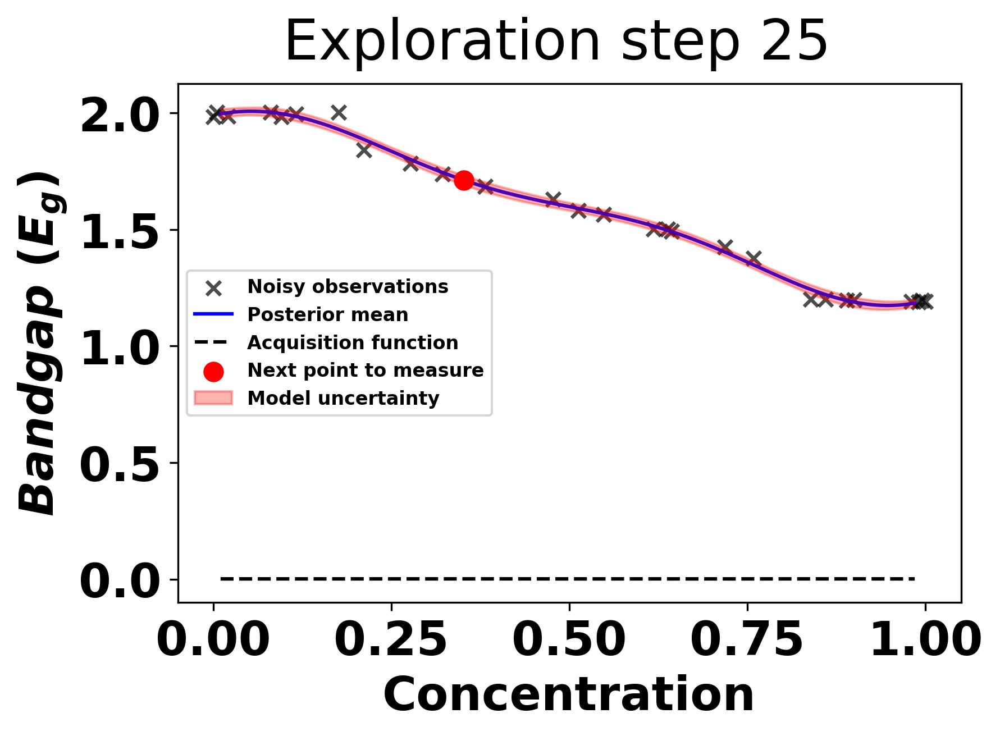

next bandgap: 
 1.713135845083943
#######---Exploration step 26---#######


sample: 100%|██████████| 4000/4000 [00:11<00:00, 336.88it/s, 5 steps of size 3.84e-01. acc. prob=0.89] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.85      0.62      0.68      0.07      1.71   1108.44      1.00
          b     -0.07      0.75     -0.10     -1.38      1.05   1083.38      1.00
          c      0.91      0.67      0.96     -0.18      1.95    766.34      1.00
k_length[0]      0.34      0.05      0.34      0.25      0.43    575.85      1.00
    k_scale      1.03      0.99      0.72      0.07      2.13    712.70      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1470.37      1.00

next point:  37
next concentration:
 0.22613065326633167


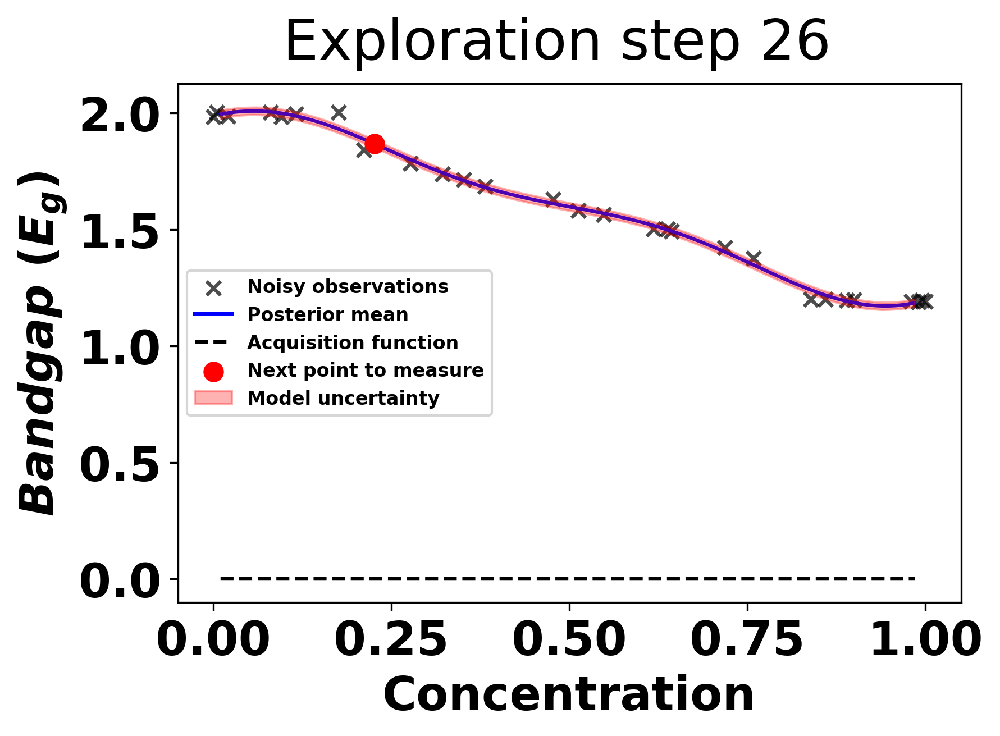

next bandgap: 
 1.8160458410083906
#######---Exploration step 27---#######


sample: 100%|██████████| 4000/4000 [00:11<00:00, 337.42it/s, 15 steps of size 2.98e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.79      0.57      0.66      0.03      1.57   1002.62      1.00
          b     -0.00      0.76     -0.03     -1.13      1.35   1151.71      1.01
          c      0.89      0.66      0.94     -0.14      1.97   1122.60      1.00
k_length[0]      0.37      0.18      0.35      0.25      0.43     72.95      1.01
    k_scale      1.09      1.01      0.78      0.03      2.32   1021.28      1.00
      noise      0.00      0.00      0.00      0.00      0.00    150.59      1.01

next point:  0
next concentration:
 0.010050251256281407


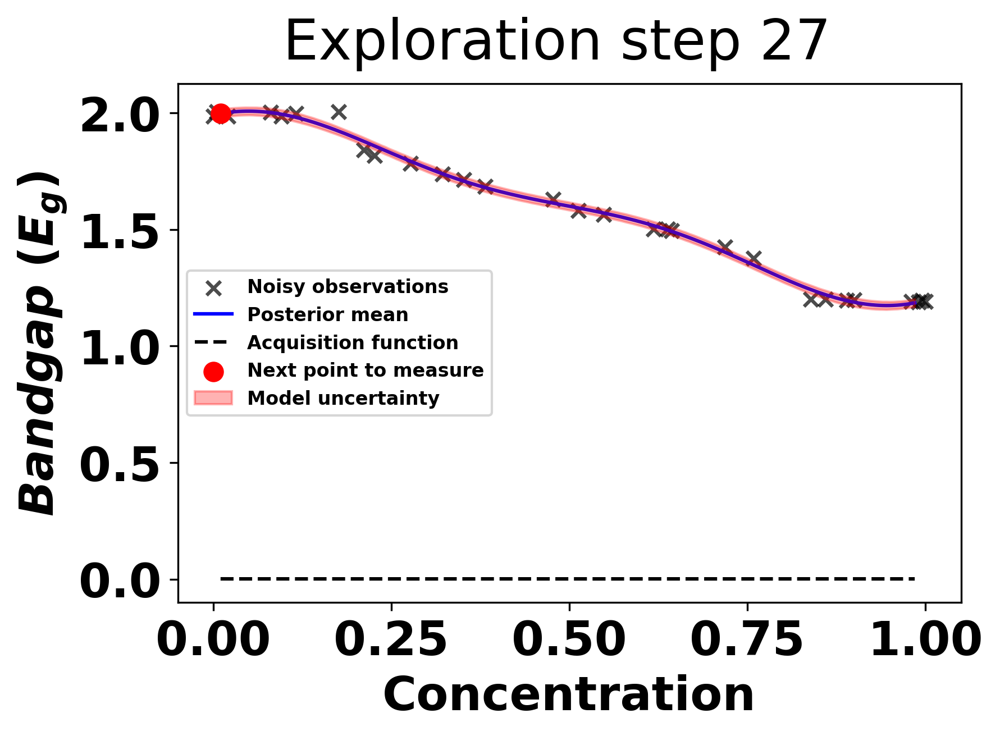

next bandgap: 
 1.9905563150917571
#######---Exploration step 28---#######


sample: 100%|██████████| 4000/4000 [00:12<00:00, 318.57it/s, 7 steps of size 3.67e-01. acc. prob=0.90] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.81      0.61      0.65      0.05      1.66   1013.32      1.00
          b     -0.02      0.76     -0.03     -1.16      1.30    948.49      1.00
          c      0.89      0.67      0.96     -0.18      1.96    862.73      1.00
k_length[0]      0.36      0.16      0.35      0.26      0.44    152.95      1.01
    k_scale      1.06      1.04      0.75      0.06      2.14    763.82      1.00
      noise      0.00      0.00      0.00      0.00      0.00    350.29      1.00

next point:  67
next concentration:
 0.40703517587939697


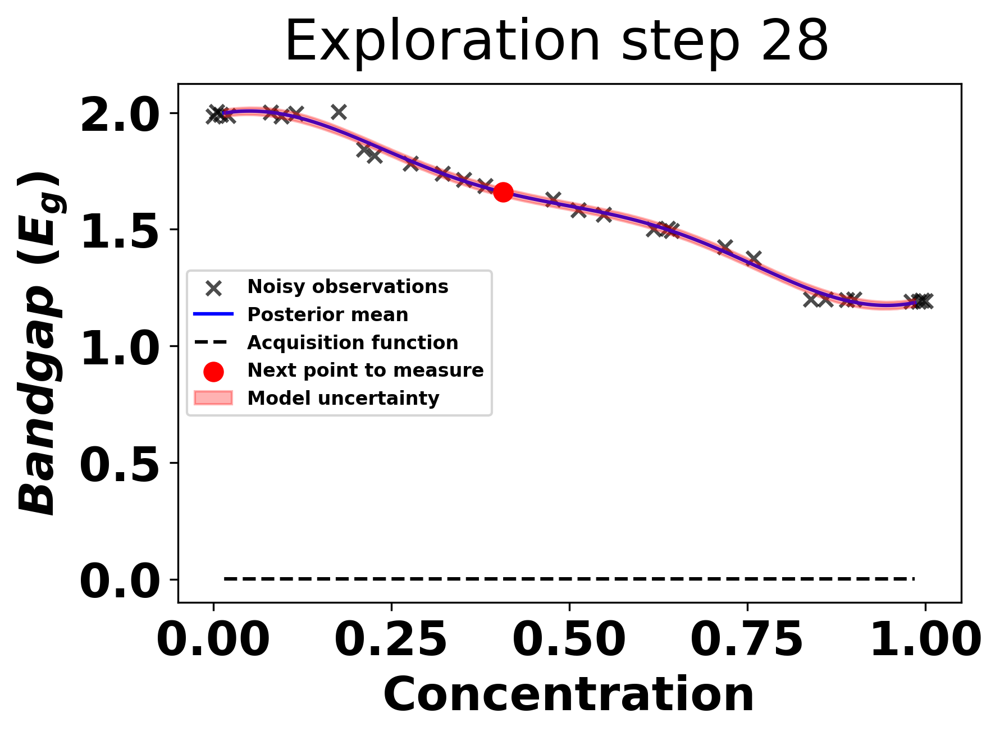

next bandgap: 
 1.685616051141586
#######---Exploration step 29---#######


sample: 100%|██████████| 4000/4000 [00:12<00:00, 309.88it/s, 7 steps of size 3.71e-01. acc. prob=0.89]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.82      0.62      0.64      0.04      1.65   1175.50      1.00
          b      0.00      0.76     -0.02     -1.25      1.22   1193.67      1.00
          c      0.87      0.67      0.94     -0.28      1.90    688.66      1.00
k_length[0]      0.35      0.08      0.35      0.26      0.44    218.70      1.00
    k_scale      1.07      1.00      0.77      0.08      2.26    775.33      1.00
      noise      0.00      0.00      0.00      0.00      0.00    522.04      1.00

next point:  145
next concentration:
 0.8492462311557789


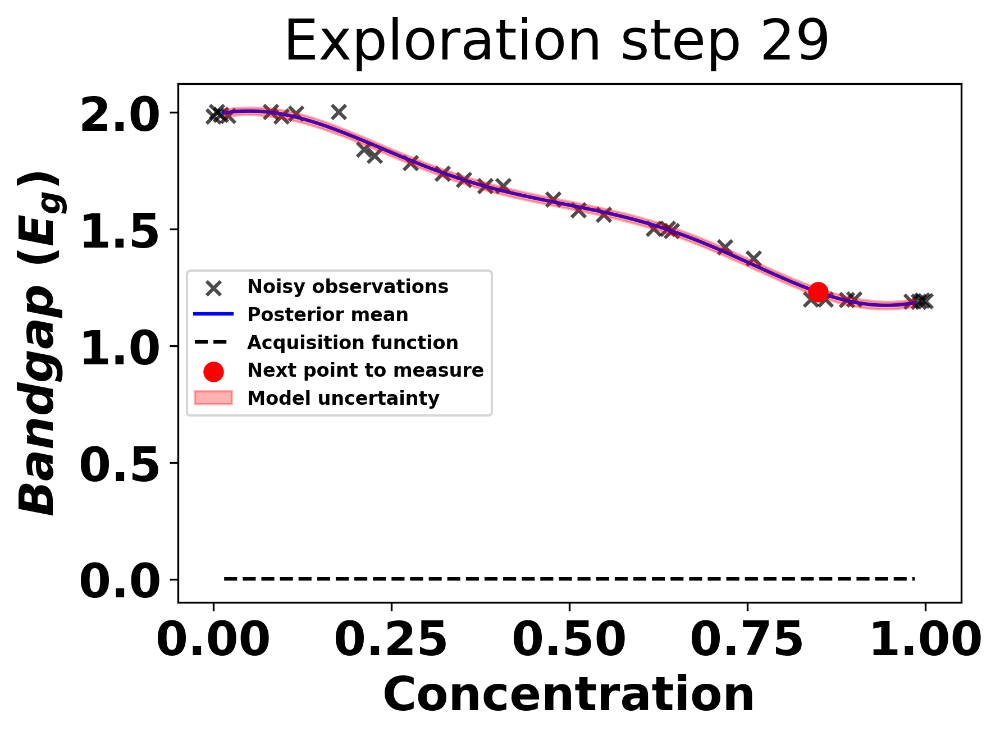

next bandgap: 
 1.197858333437999


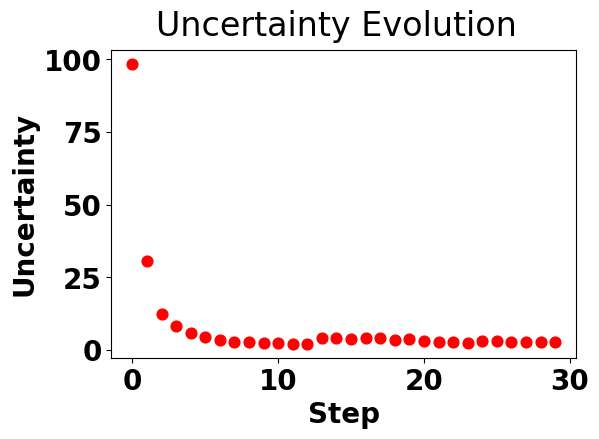

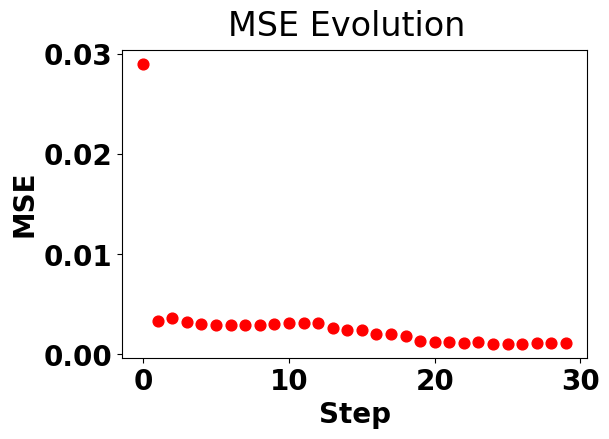

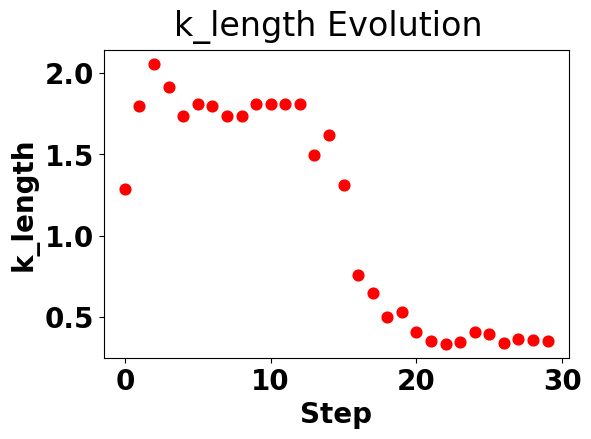

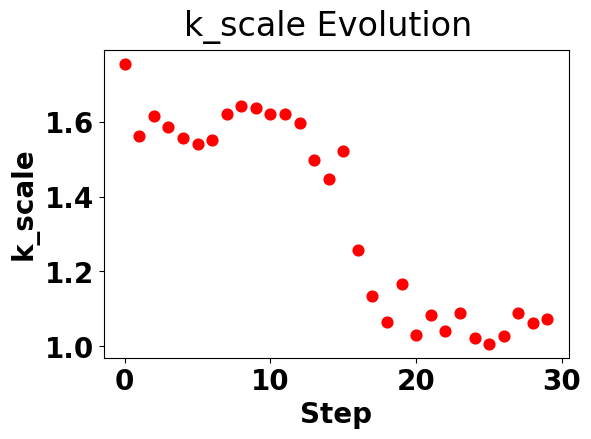

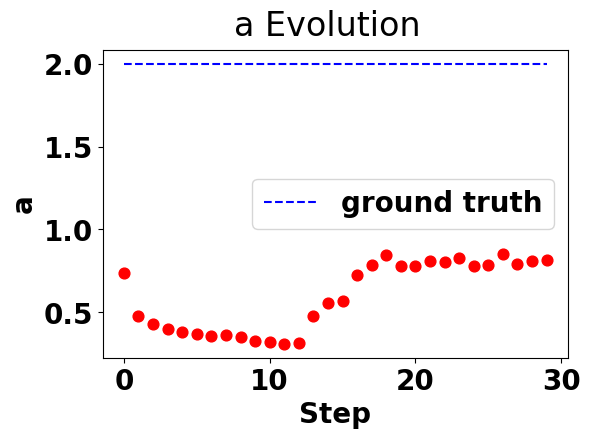

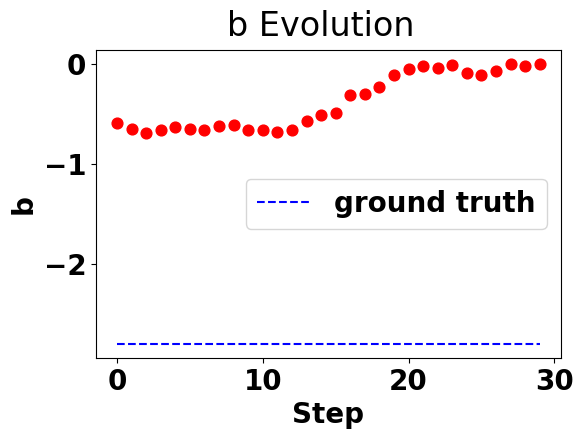

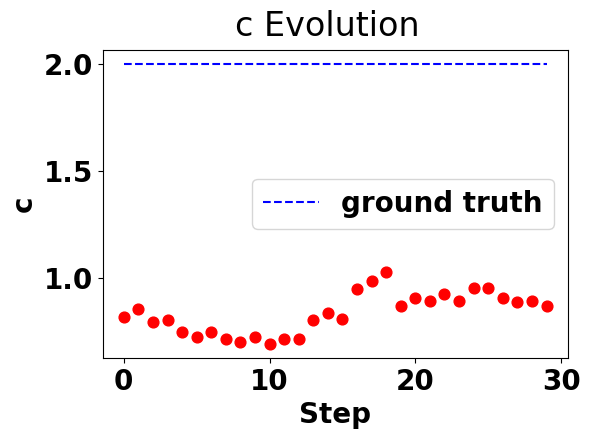

In [ ]:
##############---create dir, list, etc to save each step information---###############
# create a dir to save plots of each step, then these images will be used to make movie at the end
savedir = "/content/video_image_quad_sGP/"
if os.path.exists(savedir) == False:
  os.mkdir(savedir)

# create lists to save uncertainty, mse, k_length, and k_scale at each step
all_uncertainty_quad_mod4 = []
all_mse_quad_mod4 = []
all_k_length = []
all_k_scale = []
all_a = []
all_b = []
all_c = []

model = quadratic #None
model_prior = quadratic_prior #None

##############---prepare data---###########
# prepare training data
X = jnp.linspace(0.0, 1, NUM_INIT_POINTS)
idx = jnp.asarray([0, NUM_INIT_POINTS-1])#set seed points to two extreme conditions
indx = idx.tolist()

# select model here
y_all = y4[:, None]                               # Select the toy model
Y = jnp.asarray([y_all[0][0], y_all[199][0]])

# initialize training data
(X_train, y_train, X_test, y_test,
 indices_train, indices_test) = init_training_data_exp(X, Y, y_all, list_of_indices = indx)

exploration_steps = 30

##########------start exploration----###########
for s in range (exploration_steps):
  print("#######---Exploration step {}---#######".format(s))
  # Compute acquisition function
  if model is None or model_prior is None: # Select GP or sGP
    acq, (y_pred, y_sampled), paras_ = step_GP(X_train, y_train, X_test)
  else:
    acq, (y_pred, y_sampled), paras_ = step_sGP(X_train, y_train, X_test, model, model_prior)
  # Get the next point to evaluate
  next_point = acq.argmax()
  # next concentration
  X_next = X_test[next_point]
  print("next point: ", next_point)
  print("next concentration:\n", X_next)

  # Plot
  f, ax1 = plt.subplots(figsize = (6, 4), dpi=300)
  f.suptitle("Exploration step {}".format(s))
  ax1.set_xlabel("Concentration")
  ax1.set_ylabel("$Bandgap$ ($E_g$)")
  ax1.scatter(X_train, y_train, marker='x', c='k', zorder=1, label="Noisy observations", alpha=0.7)
  ax1.plot(X_test, y_pred, lw=1.5, zorder=1, c='b', label='Posterior mean')
  ax1.plot(X_test, acq, lw=1.5, zorder=1, c='black', linestyle = "--", label='Acquisition function')
  ax1.scatter(X_test[next_point], y_pred[next_point], s=60, c='r', label='Next point to measure')
  ax1.fill_between(X_test.squeeze(), y_pred - y_sampled.std(axis=(0,1)), y_pred + y_sampled.std(axis=(0,1)),
                color='r', alpha=0.3, label="Model uncertainty")
  ax1.legend(loc = 'best',fontsize=8)
  ax1.y_lim=(0.5,2)
  plt.show()
  f.savefig(os.path.join(savedir, '{}.png'.format(s)))   # save this plot to savedir

  # add the uncertainty of this step to the list
  this_uncertainty = y_sampled.std(axis=(0,1)).sum()
  all_uncertainty_quad_mod4.append(this_uncertainty)
  # add the mse of this step to the list
  this_mse = mean_squared_error(y_test,y_pred)
  all_mse_quad_mod4.append(this_mse)
  # add the k_length of this step to the list
  this_k_length = paras_['k_length'].mean()
  all_k_length.append(this_k_length)
  # add the k_scale of this step to the list
  this_k_scale = paras_['k_scale'].mean()
  all_k_scale.append(this_k_scale)
  # add the a of this step to the list
  this_a = paras_['a'].mean()
  all_a.append(this_a)
  # add the a of this step to the list
  this_b = paras_['b'].mean()
  all_b.append(this_b)
  # add the a of this step to the list
  this_c = paras_['c'].mean()
  all_c.append(this_c)

  # next 'measurement'
  y_new = jnp.asarray(y_test[next_point])  # get next bandgap
  y_test = jnp.delete(y_test, next_point)  # update bandgap data set
  print("next bandgap: \n", y_new)
  # update training data
  X_train, y_train, X_test = update_datapoints_exp(next_point, X_train, y_train, X_test, y_new)


###############---sumarize the the information from each step---############
# create movie from saved images
aoi.utils.animation_from_png(png_dir=savedir, moviename="evolution_model 4_quad_sGP",
                             savedir= "/content/",
                             duration = 1, remove_dir=False)


# plot the evoltution of uncerstainty
f1, ax = plt.subplots(figsize = (6, 4), dpi=100)
f1.suptitle("Uncertainty Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("Uncertainty")
ax.scatter(np.arange(exploration_steps), all_uncertainty_quad_mod4, s = 60, c='r')

# plot the evolution of MSE
f2, ax = plt.subplots(figsize = (6, 4), dpi=100)
f2.suptitle("MSE Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("MSE")
ax.scatter(np.arange(exploration_steps), all_mse_quad_mod4, s = 60, c='r')

# plot the evolution of k_length
f3, ax = plt.subplots(figsize = (6, 4), dpi=100)
f3.suptitle("k_length Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("k_length")
ax.scatter(np.arange(exploration_steps), all_k_length, s = 60, c='r')

# plot the evolution of k_scale
f4, ax = plt.subplots(figsize = (6, 4), dpi=100)
f4.suptitle("k_scale Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("k_scale")
ax.scatter(np.arange(exploration_steps), all_k_scale, s = 60, c='r')

#Compare a, b, c, with ground truth
groundtruth = np.arange(exploration_steps, dtype = np.float64)
# plot the evolution of a
f4, ax = plt.subplots(figsize = (6, 4), dpi=100)
f4.suptitle("a Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("a")
ax.scatter(np.arange(exploration_steps), all_a, s = 60, c='r')
groundtruth[:] = 2
ax.plot(np.arange(exploration_steps), groundtruth,
        linestyle = '--', c='b', label = "ground truth")
ax.legend()

# plot the evolution of b
f4, ax = plt.subplots(figsize = (6, 4), dpi=100)
f4.suptitle("b Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("b")
ax.scatter(np.arange(exploration_steps), all_b, s = 60, c='r')
groundtruth[:] = -2.8
ax.plot(np.arange(exploration_steps), groundtruth,
        linestyle = '--', c='b', label = "ground truth")
ax.legend()

# plot the evolution of c
f4, ax = plt.subplots(figsize = (6, 4), dpi=100)
f4.suptitle("c Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("c")
ax.scatter(np.arange(exploration_steps), all_c, s = 60, c='r')
groundtruth[:] = 2
ax.plot(np.arange(exploration_steps), groundtruth,
        linestyle = '--', c='b', label = "ground truth")
ax.legend()

#######---Exploration step 0---#######


sample: 100%|██████████| 4000/4000 [00:10<00:00, 391.63it/s, 63 steps of size 6.30e-02. acc. prob=0.81] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
         a1      1.66      2.52      0.96      0.07      3.54    559.16      1.00
         a2      1.20      0.93      0.94      0.04      2.45    680.25      1.00
         b1      1.51      0.99      1.58     -0.06      3.00    557.71      1.00
         b2     -0.20      1.19     -0.07     -2.13      1.67    657.46      1.00
k_length[0]      1.62      1.91      0.98      0.08      3.55    689.57      1.00
    k_scale      1.47      1.83      0.96      0.06      3.15    644.58      1.01
      noise      0.01      0.01      0.01      0.00      0.02   1068.80      1.00
          t      0.30      0.47      0.12      0.00      0.79   1000.70      1.00

next point:  68
next concentration:
 0.34673366834170855


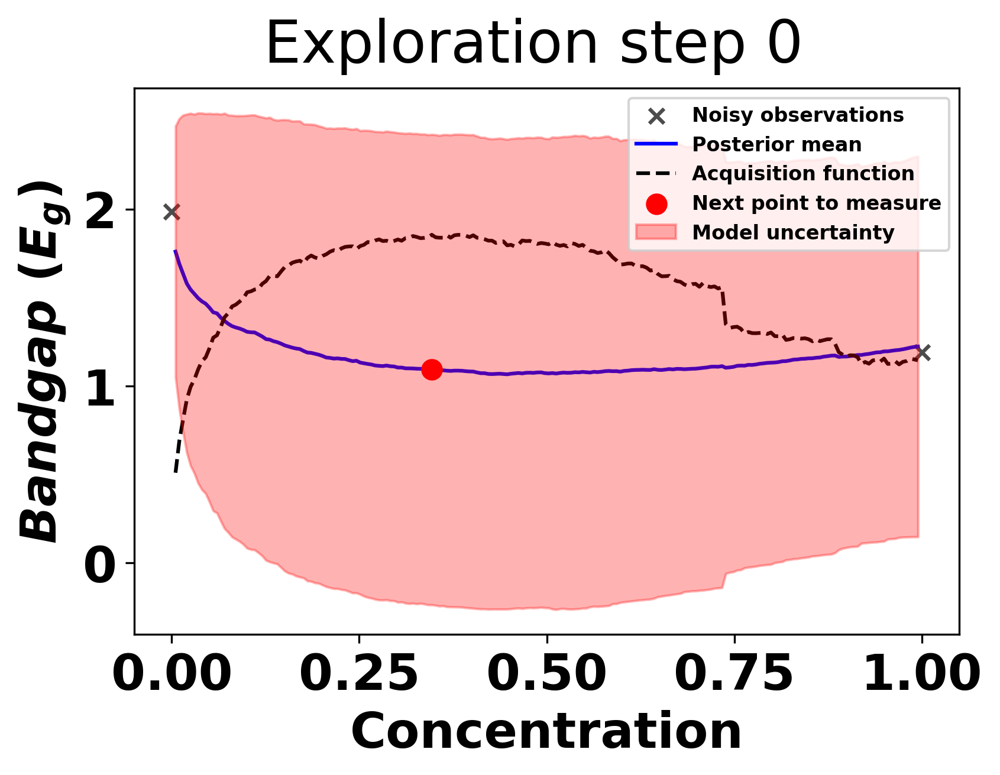

next bandgap: 
 1.726381830535142
#######---Exploration step 1---#######


sample: 100%|██████████| 4000/4000 [00:16<00:00, 245.82it/s, 255 steps of size 1.05e-02. acc. prob=0.69]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
         a1      1.03      1.48      0.59      0.06      2.23    478.65      1.00
         a2      1.20      1.49      0.70      0.03      2.79    214.74      1.00
         b1      1.13      0.84      1.20     -0.25      2.47    414.72      1.00
         b2      0.29      1.62      0.53     -2.14      3.02     68.63      1.01
k_length[0]      0.96      0.71      0.77      0.09      1.87    327.79      1.00
    k_scale      1.58      1.85      1.10      0.15      3.23    406.65      1.00
      noise      0.01      0.01      0.01      0.00      0.02    437.54      1.00
          t      0.85      0.88      0.57      0.00      2.03    254.66      1.01

next point:  124
next concentration:
 0.6331658291457286


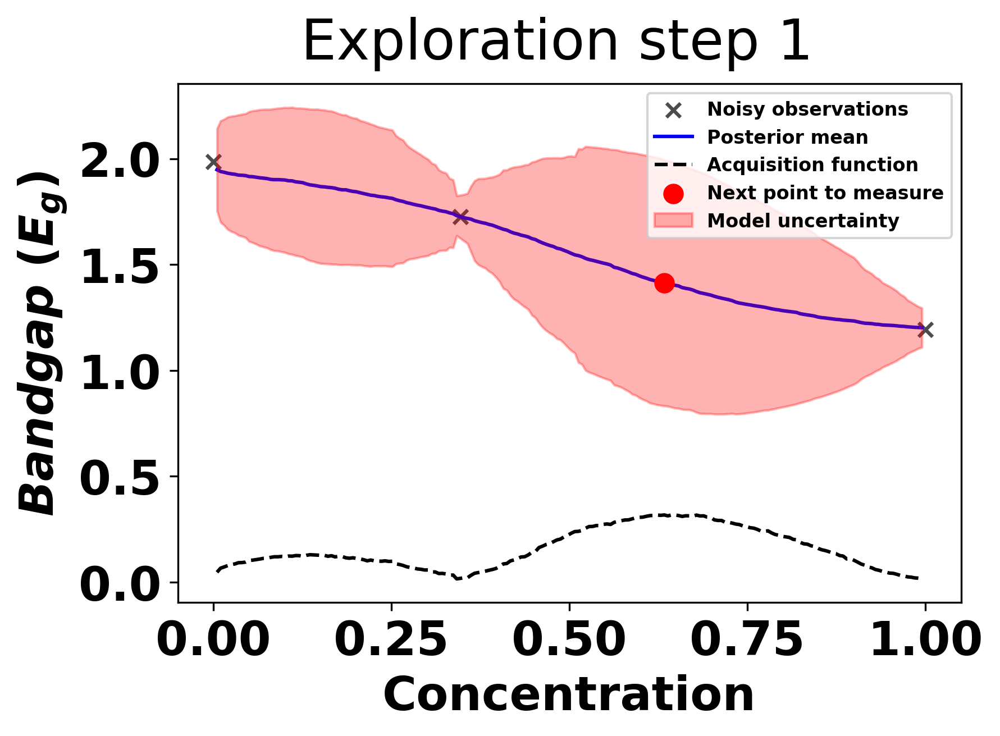

next bandgap: 
 1.4841394462683526
#######---Exploration step 2---#######


sample: 100%|██████████| 4000/4000 [00:24<00:00, 164.86it/s, 1023 steps of size 8.03e-04. acc. prob=0.87]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
         a1      0.83      1.05      0.46      0.06      2.05     35.90      1.00
         a2      1.10      1.13      0.68      0.06      2.57     84.87      1.00
         b1      1.24      0.89      1.23     -0.29      2.53     68.35      1.03
         b2     -0.07      1.46      0.24     -2.54      1.91     32.80      1.00
k_length[0]      1.39      0.77      1.21      0.31      2.48     51.30      1.03
    k_scale      2.01      1.78      1.46      0.18      4.20     60.23      1.01
      noise      0.01      0.01      0.00      0.00      0.01    131.98      1.01
          t      1.02      1.00      1.05      0.00      2.24     29.08      1.02

next point:  22
next concentration:
 0.11557788944723618


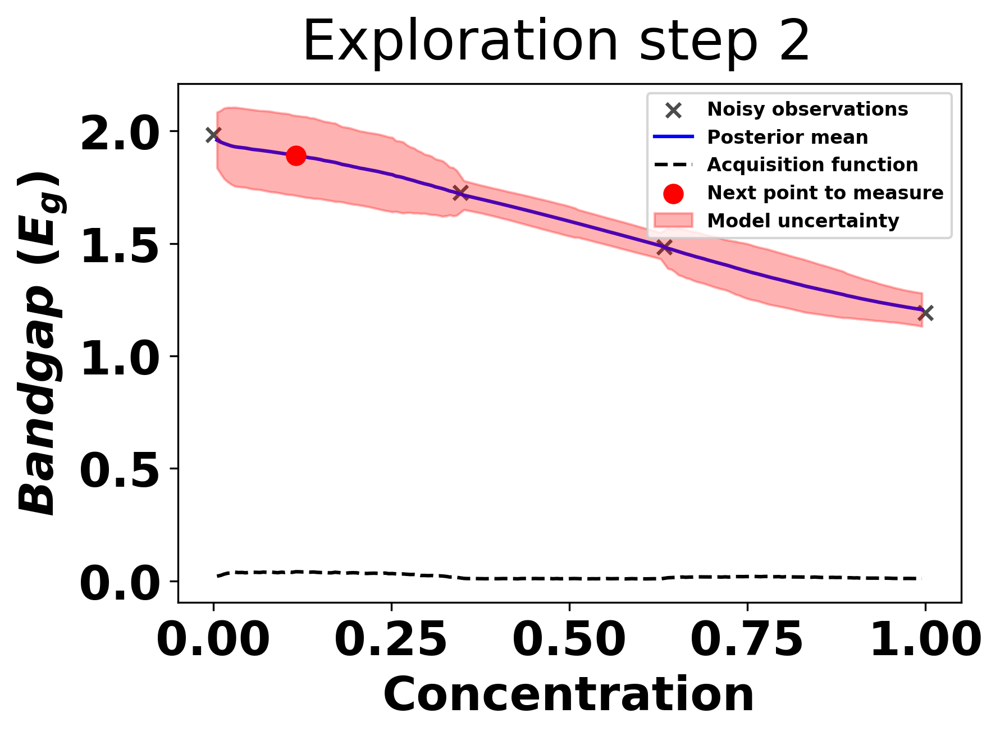

next bandgap: 
 1.9969775026954493
#######---Exploration step 3---#######


sample: 100%|██████████| 4000/4000 [00:33<00:00, 117.68it/s, 1023 steps of size 6.48e-04. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
         a1      0.50      0.39      0.38      0.07      1.02     50.10      1.00
         a2      1.17      1.34      0.70      0.07      2.80     40.34      1.04
         b1      1.16      0.82      1.15     -0.23      2.50     90.50      1.00
         b2     -0.17      1.99      0.07     -3.75      2.44     19.43      1.00
k_length[0]      1.34      0.75      1.16      0.43      2.35     46.32      1.07
    k_scale      2.10      2.18      1.43      0.16      4.48     67.15      1.03
      noise      0.01      0.00      0.00      0.00      0.01     87.47      1.03
          t      1.37      0.93      1.32      0.00      2.50     22.75      1.06

next point:  193
next concentration:
 0.9899497487437187


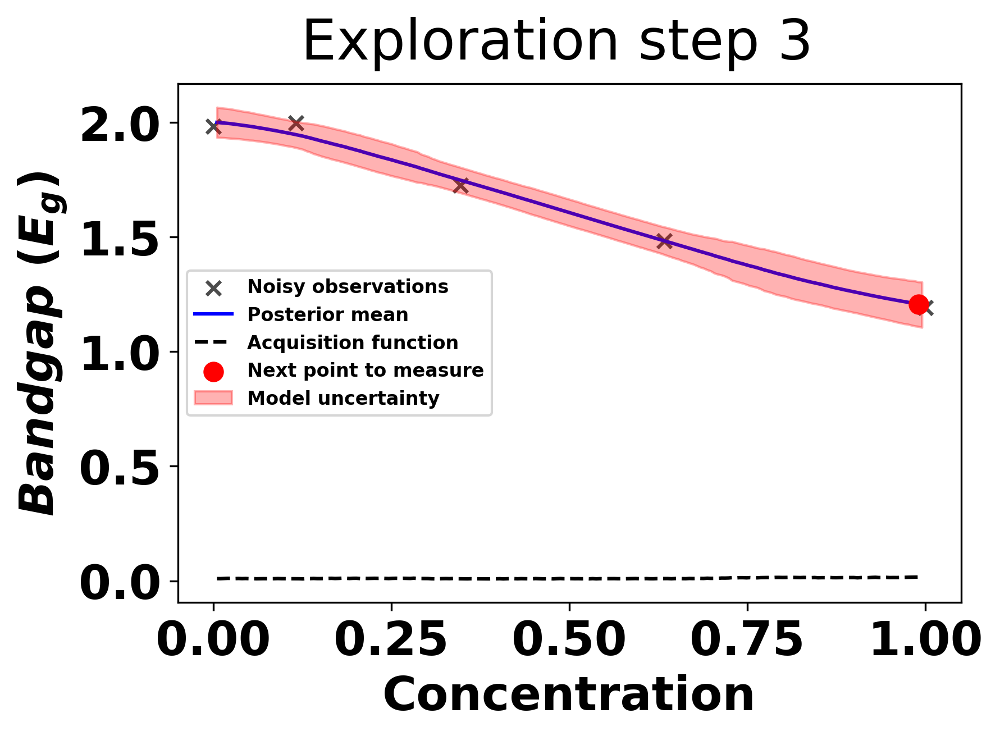

next bandgap: 
 1.18922900930596
#######---Exploration step 4---#######


sample: 100%|██████████| 4000/4000 [00:35<00:00, 112.76it/s, 1023 steps of size 4.24e-03. acc. prob=0.74]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
         a1      0.78      0.80      0.57      0.05      1.56    228.85      1.00
         a2      1.26      2.15      0.67      0.04      2.69    129.74      1.00
         b1      0.91      0.99      1.02     -0.67      2.35    221.41      1.00
         b2      0.32      1.50      0.55     -2.14      2.61    191.40      1.00
k_length[0]      1.27      0.69      1.12      0.30      2.17    307.76      1.01
    k_scale      1.88      1.97      1.26      0.15      3.85    240.22      1.00
      noise      0.00      0.00      0.00      0.00      0.01    372.00      1.00
          t      1.07      1.02      1.05      0.00      2.33     80.10      1.00

next point:  168
next concentration:
 0.864321608040201


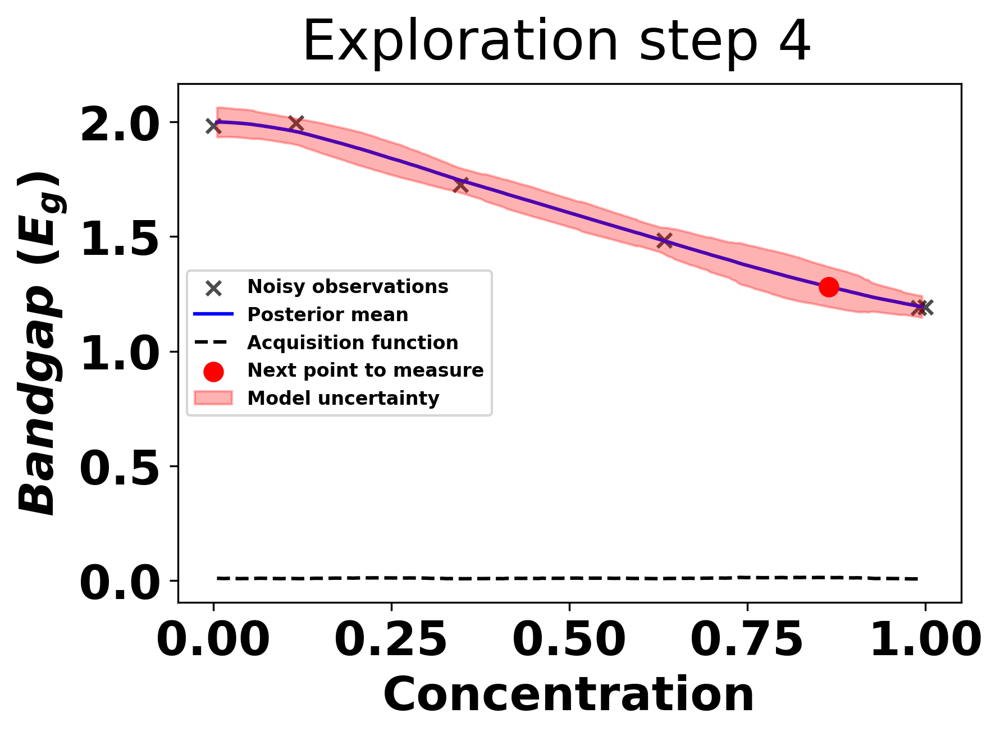

next bandgap: 
 1.1908088655513005
#######---Exploration step 5---#######


sample: 100%|██████████| 4000/4000 [00:48<00:00, 83.05it/s, 1023 steps of size 1.79e-03. acc. prob=0.86]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
         a1      0.91      1.28      0.57      0.04      1.81    191.83      1.00
         a2      0.96      1.29      0.60      0.02      1.97    104.55      1.00
         b1      0.98      0.87      1.00     -0.65      2.32    225.83      1.00
         b2      0.53      1.36      0.72     -1.83      2.55     82.34      1.02
k_length[0]      1.22      0.70      1.05      0.29      2.03    173.59      1.00
    k_scale      1.99      2.06      1.33      0.11      4.20    165.04      1.00
      noise      0.01      0.00      0.00      0.00      0.01    597.52      1.00
          t      0.74      0.92      0.25      0.00      1.99     18.61      1.00

next point:  33
next concentration:
 0.17587939698492464


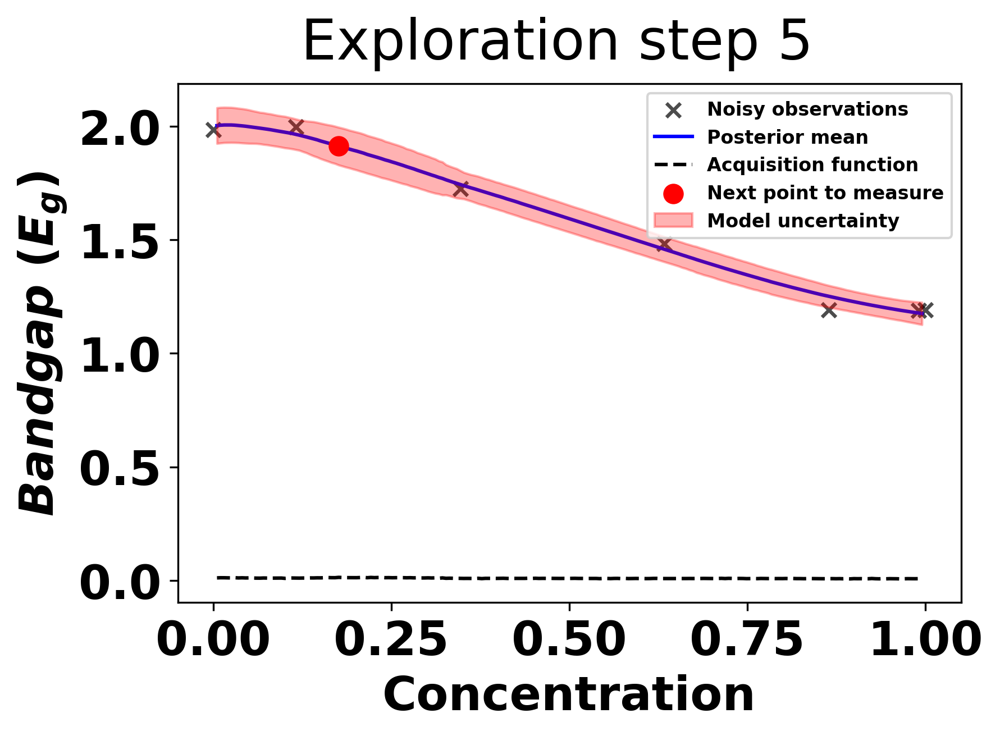

next bandgap: 
 2.0040326454016326
#######---Exploration step 6---#######


sample: 100%|██████████| 4000/4000 [00:40<00:00, 98.89it/s, 1023 steps of size 5.02e-04. acc. prob=0.92] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
         a1      0.63      0.61      0.46      0.04      1.26     16.46      1.07
         a2      0.99      0.94      0.73      0.07      2.20     49.64      1.00
         b1      1.09      0.76      1.13     -0.18      2.27     69.08      1.02
         b2      0.21      1.83      0.38     -2.94      2.95      7.63      1.23
k_length[0]      1.02      0.51      0.90      0.35      1.63     45.46      1.00
    k_scale      1.65      1.40      1.25      0.14      3.47     61.36      1.02
      noise      0.01      0.00      0.00      0.00      0.01     61.92      1.04
          t      1.19      0.85      1.17      0.00      2.24     13.09      1.08

next point:  93
next concentration:
 0.48743718592964824


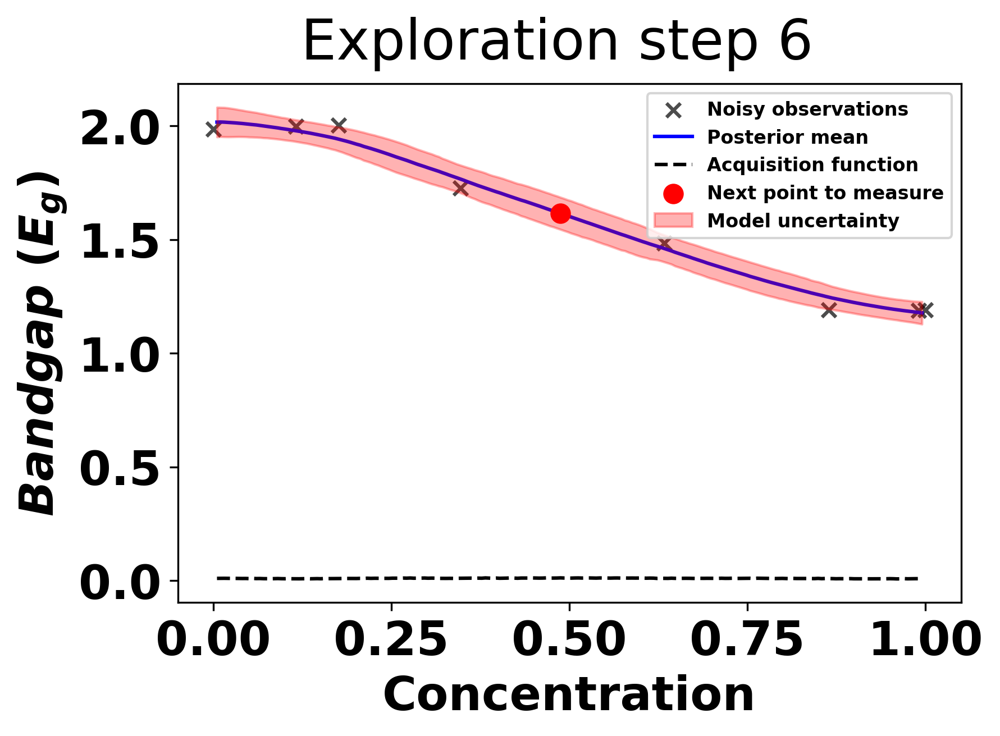

next bandgap: 
 1.6021038880455662
#######---Exploration step 7---#######


sample: 100%|██████████| 4000/4000 [00:55<00:00, 72.11it/s, 1023 steps of size 7.97e-04. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
         a1      0.68      0.59      0.52      0.05      1.39     92.74      1.00
         a2      0.86      1.01      0.52      0.06      1.87     84.66      1.00
         b1      1.14      0.76      1.16     -0.10      2.36     99.35      1.02
         b2      0.57      1.47      0.88     -1.89      2.82     39.27      1.00
k_length[0]      1.08      0.49      0.96      0.38      1.82     72.66      1.00
    k_scale      1.75      1.71      1.24      0.16      3.60     85.32      1.00
      noise      0.00      0.00      0.00      0.00      0.01    112.93      1.00
          t      0.87      1.00      0.32      0.00      2.13     12.27      1.05

next point:  3
next concentration:
 0.020100502512562814


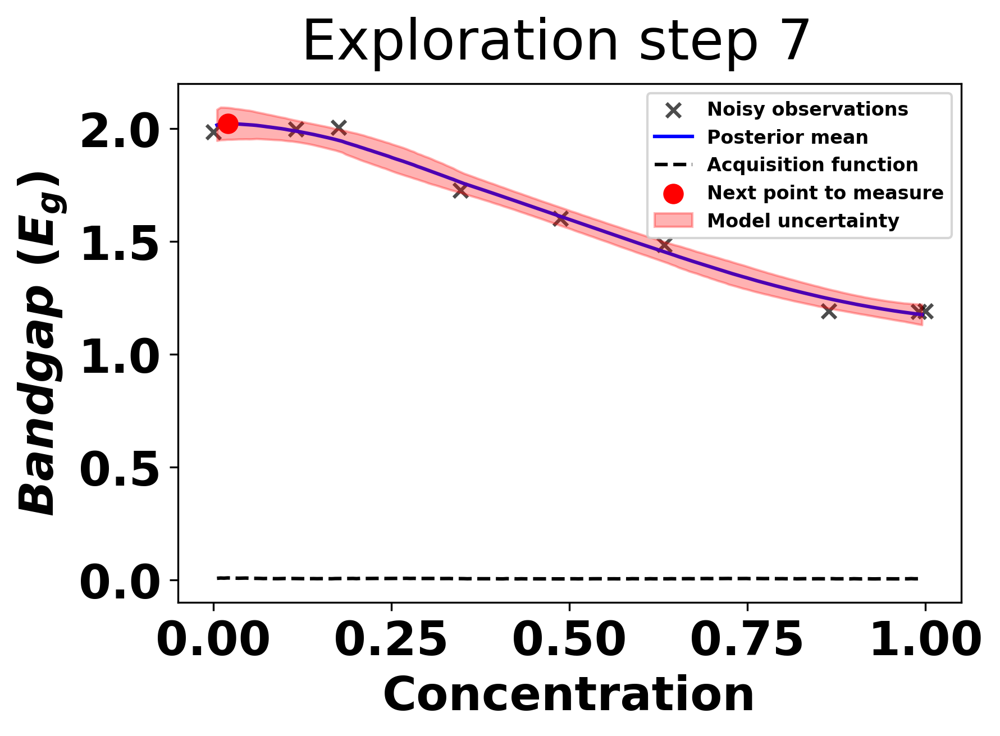

next bandgap: 
 1.9859403708373211
#######---Exploration step 8---#######


sample: 100%|██████████| 4000/4000 [00:49<00:00, 80.48it/s, 244 steps of size 6.66e-03. acc. prob=0.80]  



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
         a1      0.78      0.64      0.64      0.07      1.52    197.60      1.01
         a2      1.36      1.99      0.75      0.04      2.97    211.48      1.00
         b1      1.01      0.87      1.08     -0.41      2.40    459.14      1.00
         b2      0.38      1.61      0.58     -2.20      3.00    199.36      1.00
k_length[0]      0.99      0.53      0.84      0.26      1.70    329.41      1.00
    k_scale      1.62      1.65      1.12      0.13      3.39    635.71      1.00
      noise      0.00      0.00      0.00      0.00      0.01    510.69      1.01
          t      1.18      1.00      1.13      0.00      2.48     27.09      1.04

next point:  45
next concentration:
 0.24623115577889448


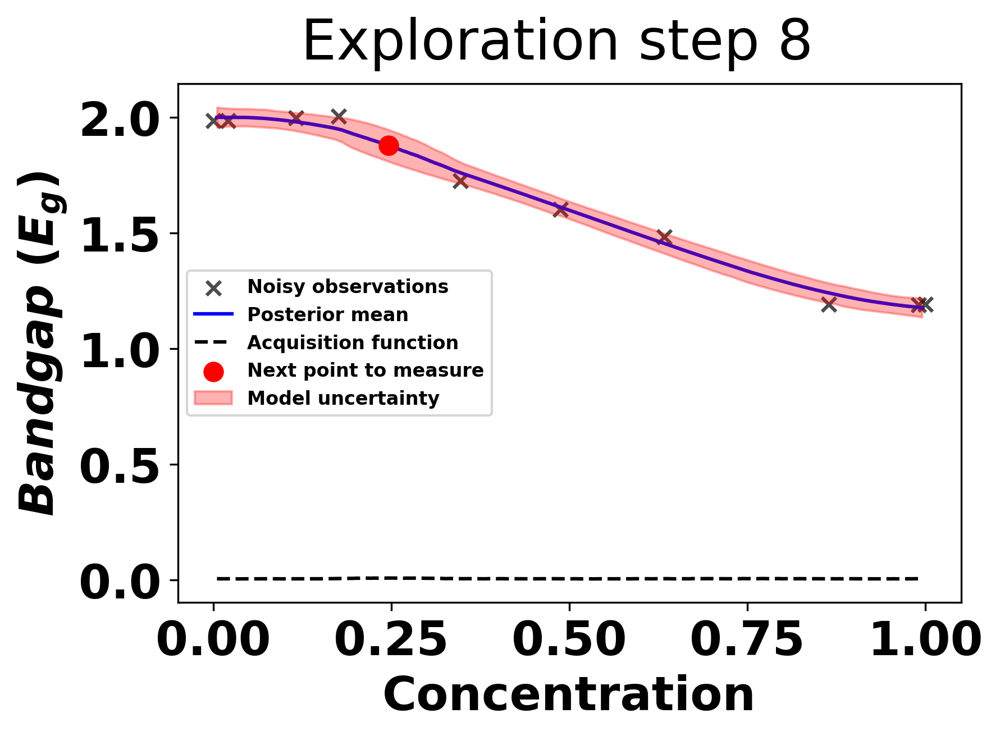

next bandgap: 
 1.81853750717737
#######---Exploration step 9---#######


sample: 100%|██████████| 4000/4000 [01:11<00:00, 55.56it/s, 1023 steps of size 1.39e-03. acc. prob=0.65]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
         a1      0.73      0.68      0.53      0.07      1.47     95.26      1.00
         a2      0.98      1.12      0.65      0.02      2.07     66.36      1.00
         b1      1.01      0.90      1.10     -0.13      2.35     49.35      1.03
         b2      0.71      1.32      0.85     -1.92      2.43     54.84      1.01
k_length[0]      1.04      0.52      0.90      0.34      1.73     78.05      1.00
    k_scale      1.71      1.88      1.07      0.14      3.97     90.51      1.00
      noise      0.00      0.00      0.00      0.00      0.01     43.94      1.07
          t      1.05      0.99      1.02      0.00      2.35     29.38      1.02

next point:  37
next concentration:
 0.20603015075376885


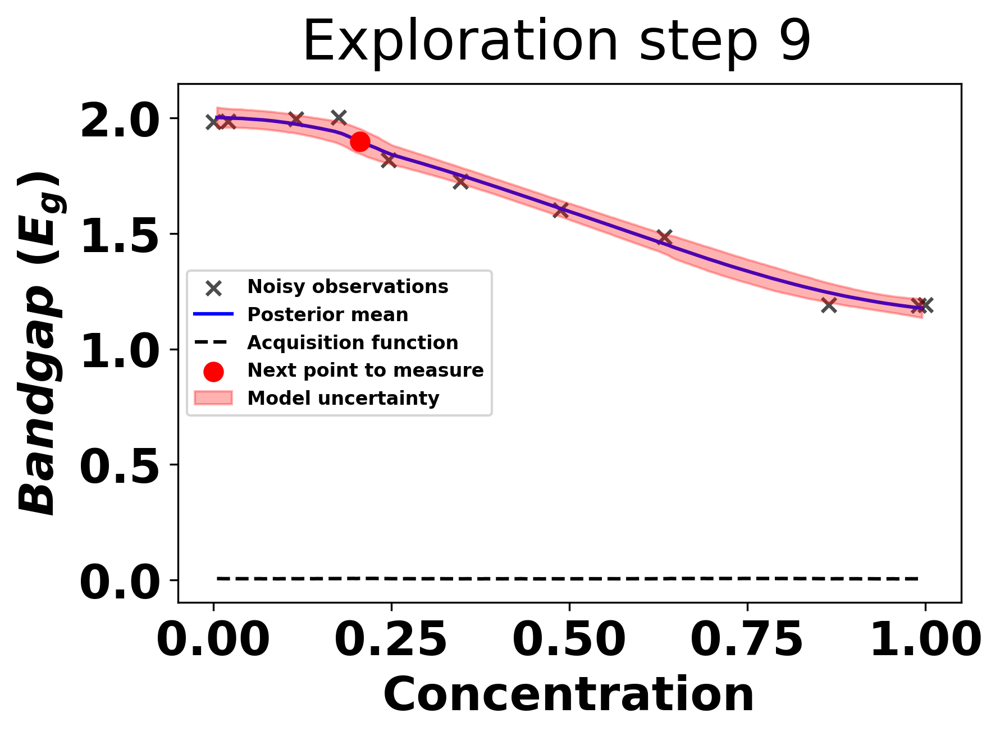

next bandgap: 
 1.848851851795052
#######---Exploration step 10---#######


sample: 100%|██████████| 4000/4000 [01:07<00:00, 59.60it/s, 1023 steps of size 2.06e-03. acc. prob=0.99]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
         a1      1.04      1.01      0.69      0.08      2.39     47.64      1.01
         a2      0.52      0.40      0.41      0.04      1.06    124.60      1.00
         b1      0.94      0.69      0.94     -0.20      2.16     22.85      1.05
         b2      1.02      0.70      1.04     -0.01      2.36     22.07      1.05
k_length[0]      1.19      0.55      1.08      0.41      2.01    160.60      1.00
    k_scale      1.89      1.86      1.35      0.13      3.81    366.49      1.00
      noise      0.00      0.00      0.00      0.00      0.01    228.83      1.00
          t      0.05      0.03      0.04      0.01      0.11      3.36      1.84

next point:  9
next concentration:
 0.05527638190954774


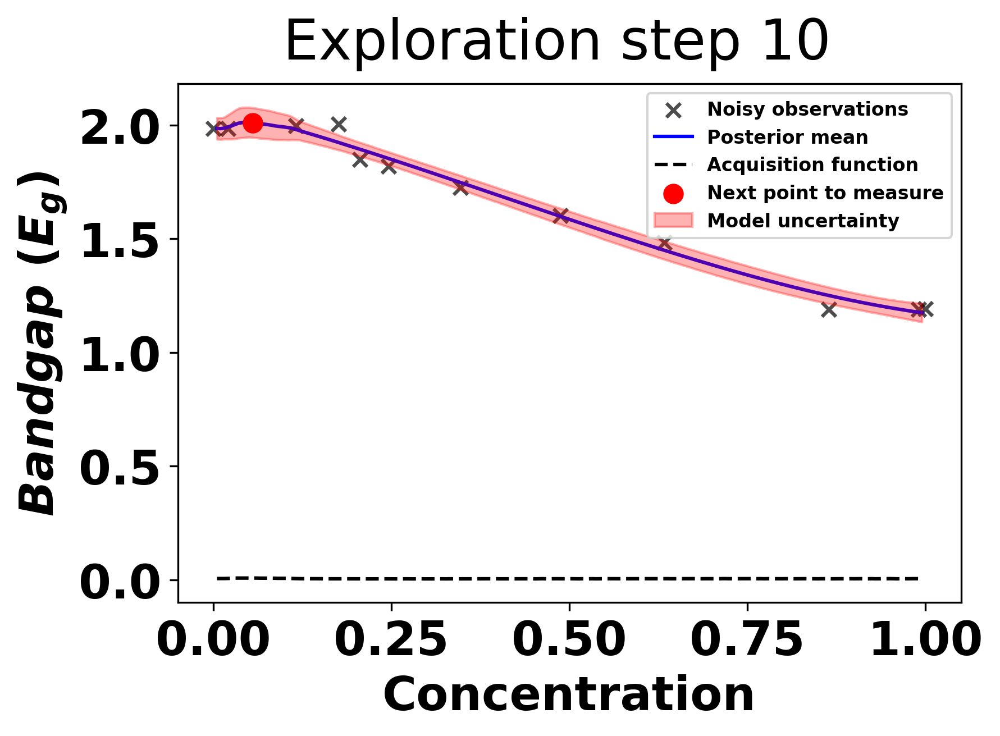

next bandgap: 
 1.986967572458877
#######---Exploration step 11---#######


sample: 100%|██████████| 4000/4000 [01:27<00:00, 45.55it/s, 1023 steps of size 1.62e-03. acc. prob=0.96]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
         a1      0.90      0.67      0.73      0.09      1.76     75.10      1.00
         a2      0.49      0.36      0.39      0.09      1.02     88.09      1.00
         b1      1.04      0.65      1.08      0.02      2.22     22.16      1.01
         b2      1.07      0.68      1.10      0.01      2.29     20.36      1.03
k_length[0]      1.12      0.55      0.98      0.34      1.85    136.88      1.02
    k_scale      1.70      1.83      1.18      0.09      3.36    212.75      1.01
      noise      0.00      0.00      0.00      0.00      0.00    103.46      1.06
          t      0.11      0.06      0.09      0.04      0.20      2.79      2.10

next point:  32
next concentration:
 0.18592964824120603


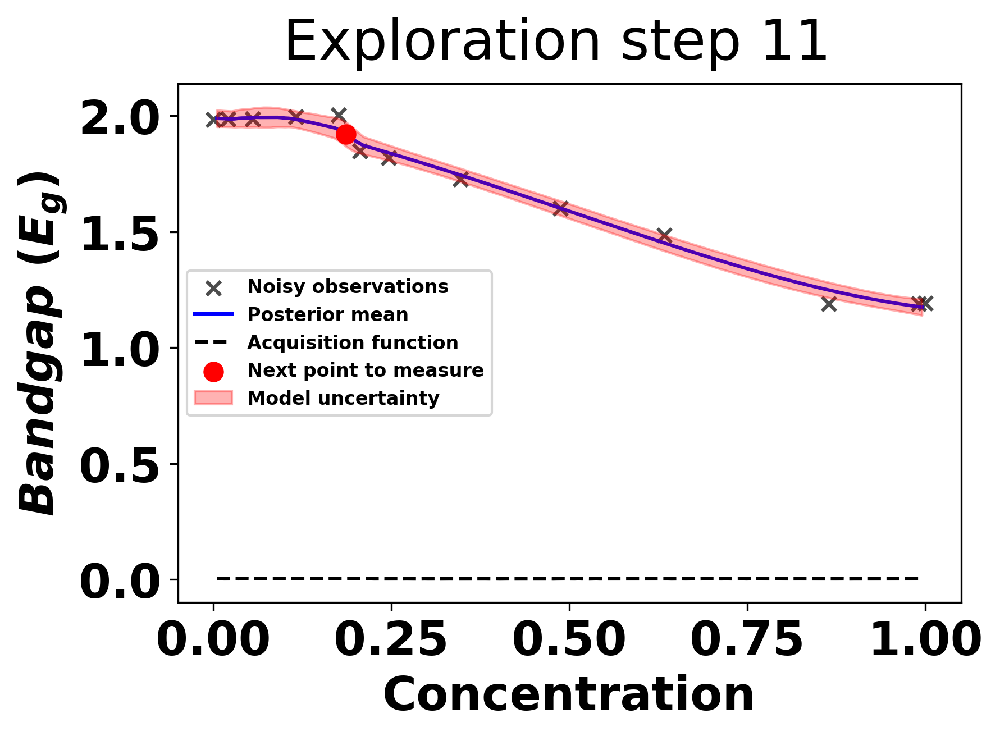

next bandgap: 
 2.002524966270769
#######---Exploration step 12---#######


sample: 100%|██████████| 4000/4000 [01:49<00:00, 36.40it/s, 1023 steps of size 3.96e-04. acc. prob=0.79]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
         a1      0.78      0.37      0.72      0.23      1.31     29.57      1.00
         a2      0.43      0.22      0.38      0.09      0.74     39.95      1.06
         b1      1.27      0.39      1.24      0.61      1.90     34.34      1.01
         b2      1.19      0.43      1.17      0.54      2.01     30.52      1.02
k_length[0]      0.74      0.26      0.72      0.31      1.03     28.87      1.03
    k_scale      0.95      0.73      0.75      0.22      1.65     43.08      1.00
      noise      0.00      0.00      0.00      0.00      0.00     32.15      1.11
          t      0.20      0.01      0.20      0.19      0.20    529.08      1.00

next point:  33
next concentration:
 0.19597989949748745


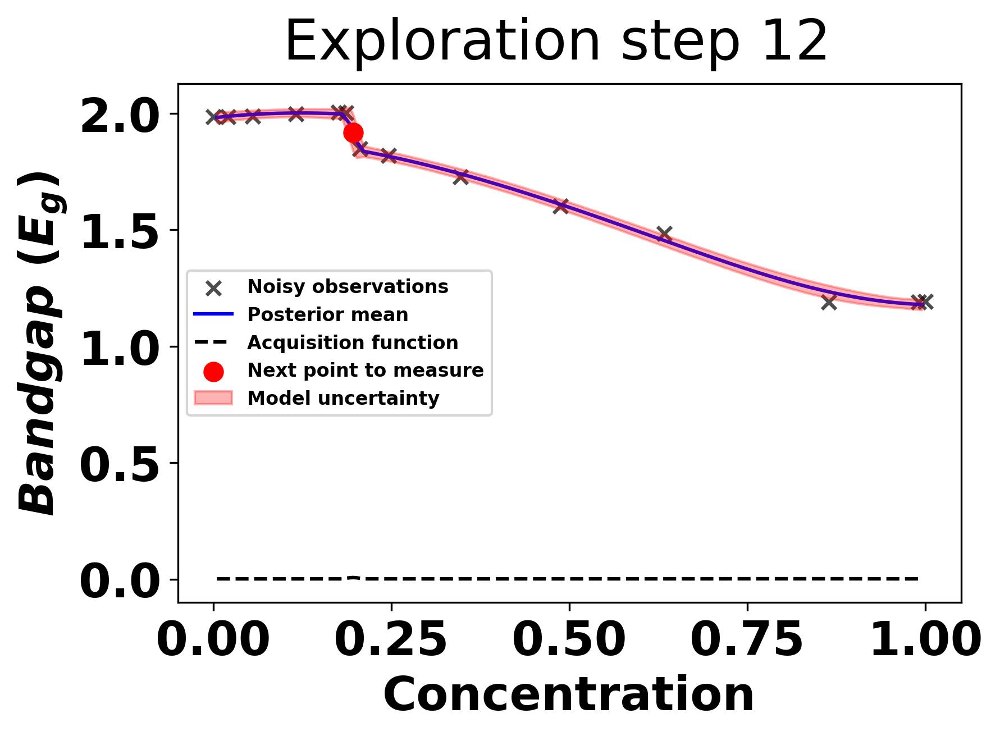

next bandgap: 
 2.013599485416795
#######---Exploration step 13---#######


sample: 100%|██████████| 4000/4000 [01:59<00:00, 33.40it/s, 1023 steps of size 1.54e-03. acc. prob=0.78]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
         a1      1.08      0.55      1.00      0.25      1.80    171.73      1.00
         a2      0.51      0.37      0.41      0.06      0.98    195.01      1.00
         b1      1.19      0.60      1.22      0.23      2.14     89.23      1.00
         b2      1.15      0.62      1.18      0.22      2.21     86.03      1.00
k_length[0]      0.78      0.41      0.71      0.25      1.28    101.02      1.00
    k_scale      1.20      1.09      0.89      0.10      2.42    178.53      1.00
      noise      0.00      0.00      0.00      0.00      0.00    228.22      1.00
          t      0.20      0.00      0.20      0.20      0.21    398.83      1.01

next point:  33
next concentration:
 0.20100502512562815


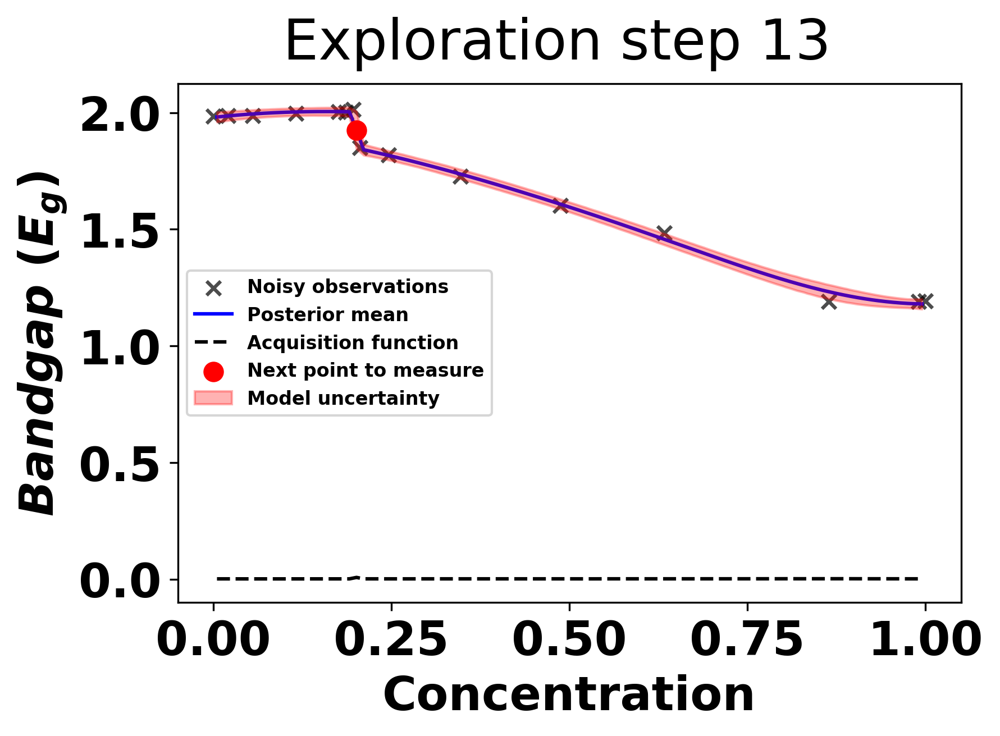

next bandgap: 
 1.838292159826728
#######---Exploration step 14---#######


sample: 100%|██████████| 4000/4000 [01:43<00:00, 38.56it/s, 1023 steps of size 2.16e-03. acc. prob=0.85]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
         a1      1.09      0.54      1.02      0.17      1.84    286.77      1.00
         a2      0.51      0.37      0.42      0.06      0.99    434.22      1.00
         b1      1.22      0.65      1.26      0.10      2.24    260.31      1.00
         b2      1.18      0.66      1.22      0.02      2.17    247.85      1.00
k_length[0]      0.72      0.47      0.60      0.23      1.20    150.39      1.00
    k_scale      1.19      1.16      0.85      0.10      2.43    321.33      1.00
      noise      0.00      0.00      0.00      0.00      0.00    311.23      1.00
          t      0.20      0.00      0.20      0.20      0.20    294.99      1.01

next point:  159
next concentration:
 0.8693467336683417


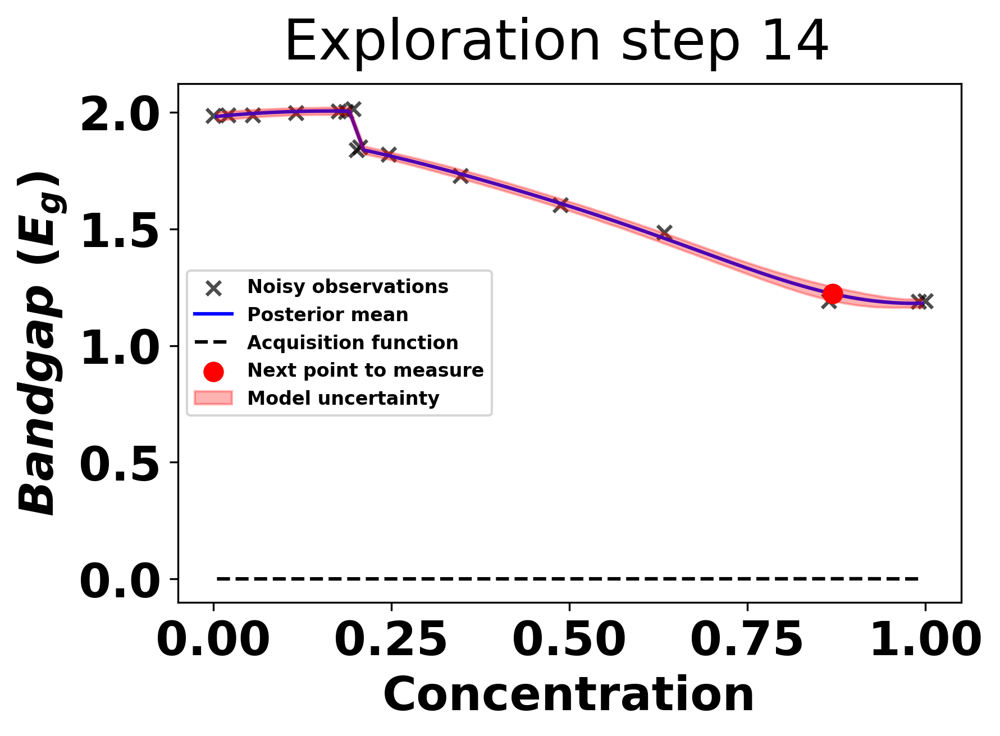

next bandgap: 
 1.201927538490652
#######---Exploration step 15---#######


sample: 100%|██████████| 4000/4000 [01:56<00:00, 34.38it/s, 1023 steps of size 3.49e-03. acc. prob=0.79]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
         a1      1.25      0.62      1.19      0.25      2.08    137.04      1.00
         a2      0.56      0.44      0.45      0.06      1.10    160.92      1.00
         b1      1.29      0.66      1.32      0.29      2.39    158.70      1.00
         b2      1.27      0.66      1.30      0.14      2.28    156.03      1.00
k_length[0]      0.54      0.27      0.46      0.23      0.85    245.70      1.00
    k_scale      1.09      1.13      0.77      0.05      2.25    425.29      1.00
      noise      0.00      0.00      0.00      0.00      0.00    249.85      1.00
          t      0.20      0.00      0.20      0.20      0.20    489.46      1.00

next point:  125
next concentration:
 0.6934673366834171


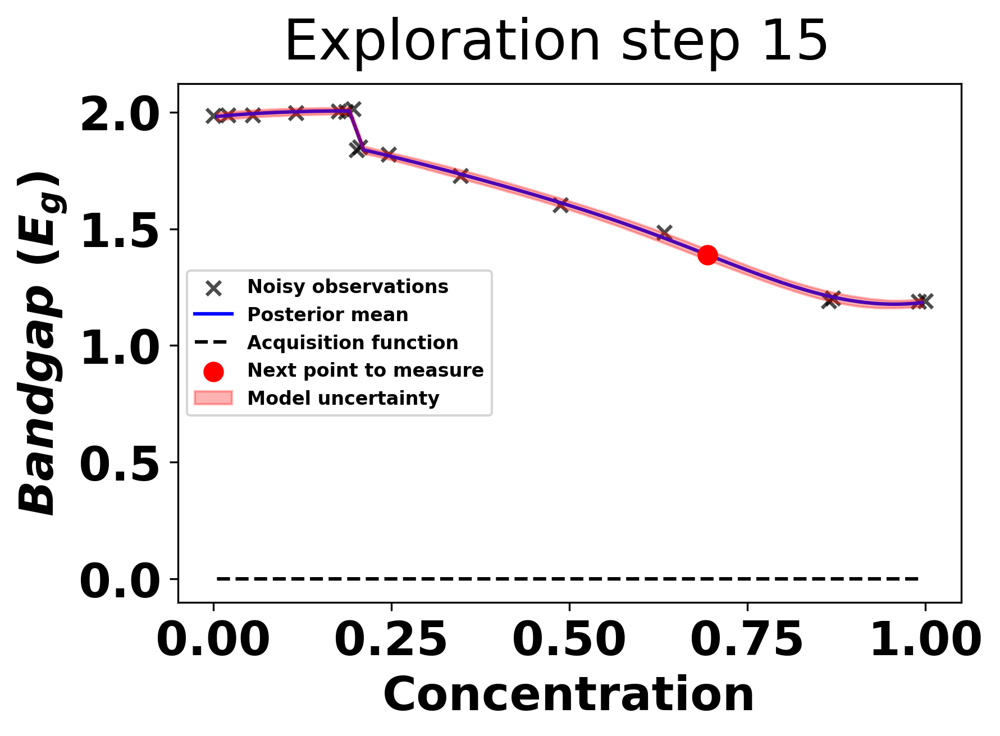

next bandgap: 
 1.4441826957383195
#######---Exploration step 16---#######


sample: 100%|██████████| 4000/4000 [01:47<00:00, 37.12it/s, 255 steps of size 5.06e-03. acc. prob=0.79]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
         a1      1.05      0.55      0.99      0.17      1.87    286.64      1.01
         a2      0.49      0.34      0.40      0.07      0.95    393.68      1.00
         b1      1.27      0.62      1.34      0.15      2.17    272.93      1.00
         b2      1.22      0.62      1.29      0.25      2.29    274.59      1.00
k_length[0]      0.52      0.41      0.35      0.19      1.03    170.07      1.00
    k_scale      0.92      0.87      0.64      0.09      1.94    239.29      1.00
      noise      0.00      0.00      0.00      0.00      0.00    229.08      1.00
          t      0.20      0.00      0.20      0.20      0.20    384.79      1.00

next point:  160
next concentration:
 0.8844221105527639


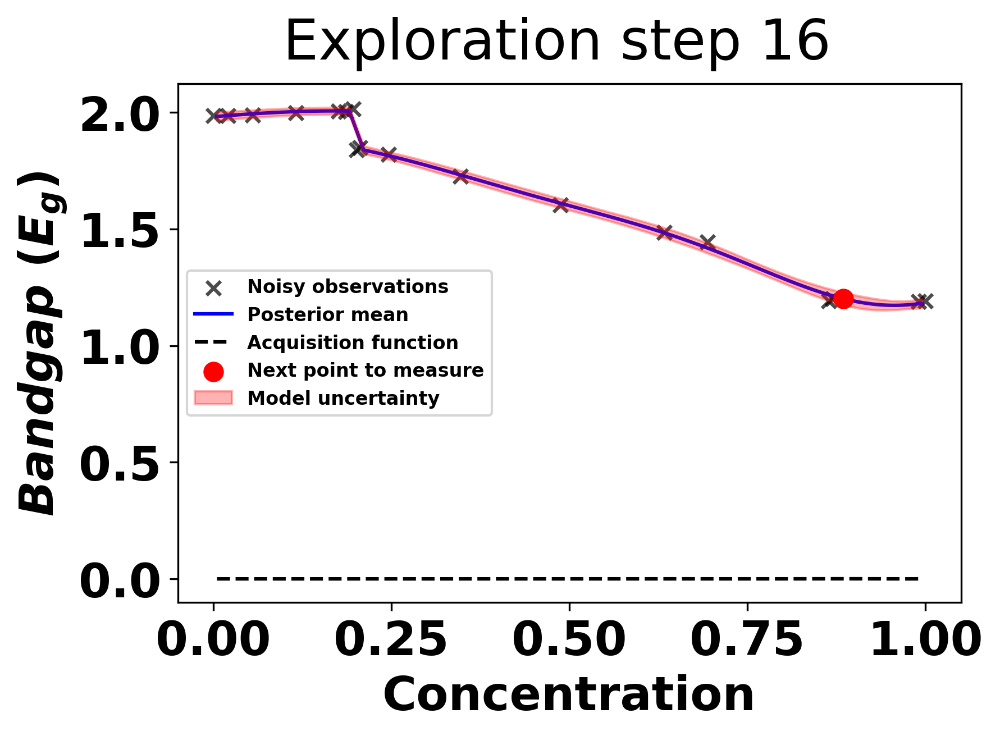

next bandgap: 
 1.1994141344886613
#######---Exploration step 17---#######


sample: 100%|██████████| 4000/4000 [02:23<00:00, 27.90it/s, 1023 steps of size 2.76e-03. acc. prob=0.74]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
         a1      1.05      0.56      0.97      0.15      1.84    267.65      1.00
         a2      0.49      0.34      0.41      0.04      0.94    310.85      1.00
         b1      1.37      0.52      1.41      0.47      2.17    129.23      1.01
         b2      1.32      0.53      1.37      0.39      2.12    129.49      1.01
k_length[0]      0.41      0.26      0.33      0.20      0.68    122.86      1.01
    k_scale      0.85      0.94      0.57      0.04      1.86    272.11      1.00
      noise      0.00      0.00      0.00      0.00      0.00    154.98      1.00
          t      0.20      0.00      0.20      0.20      0.20    580.32      1.00

next point:  116
next concentration:
 0.6482412060301508


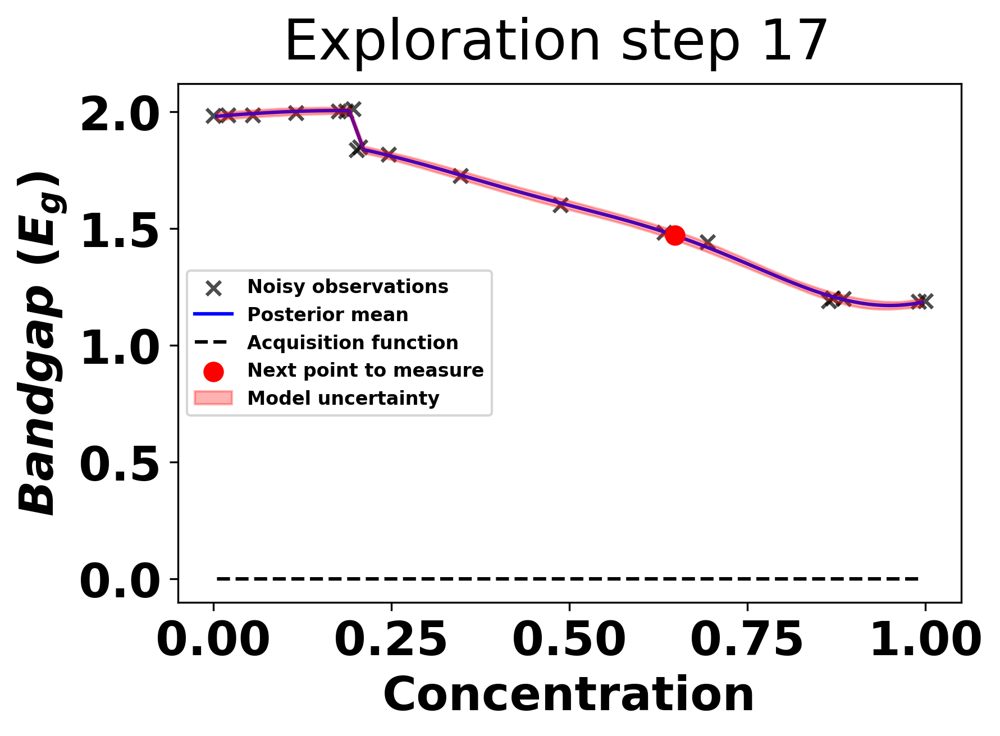

next bandgap: 
 1.4872796289698778
#######---Exploration step 18---#######


sample: 100%|██████████| 4000/4000 [01:42<00:00, 38.89it/s, 183 steps of size 6.51e-03. acc. prob=0.80]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
         a1      1.10      0.57      1.02      0.24      1.94    498.13      1.00
         a2      0.51      0.36      0.43      0.05      0.97    441.94      1.00
         b1      1.34      0.61      1.40      0.30      2.26    176.66      1.00
         b2      1.30      0.61      1.36      0.30      2.27    169.86      1.00
k_length[0]      0.38      0.24      0.31      0.20      0.48     48.98      1.03
    k_scale      0.82      0.93      0.57      0.10      1.71    214.19      1.01
      noise      0.00      0.00      0.00      0.00      0.00     64.28      1.03
          t      0.20      0.00      0.20      0.20      0.20    360.29      1.00

next point:  84
next concentration:
 0.47738693467336685


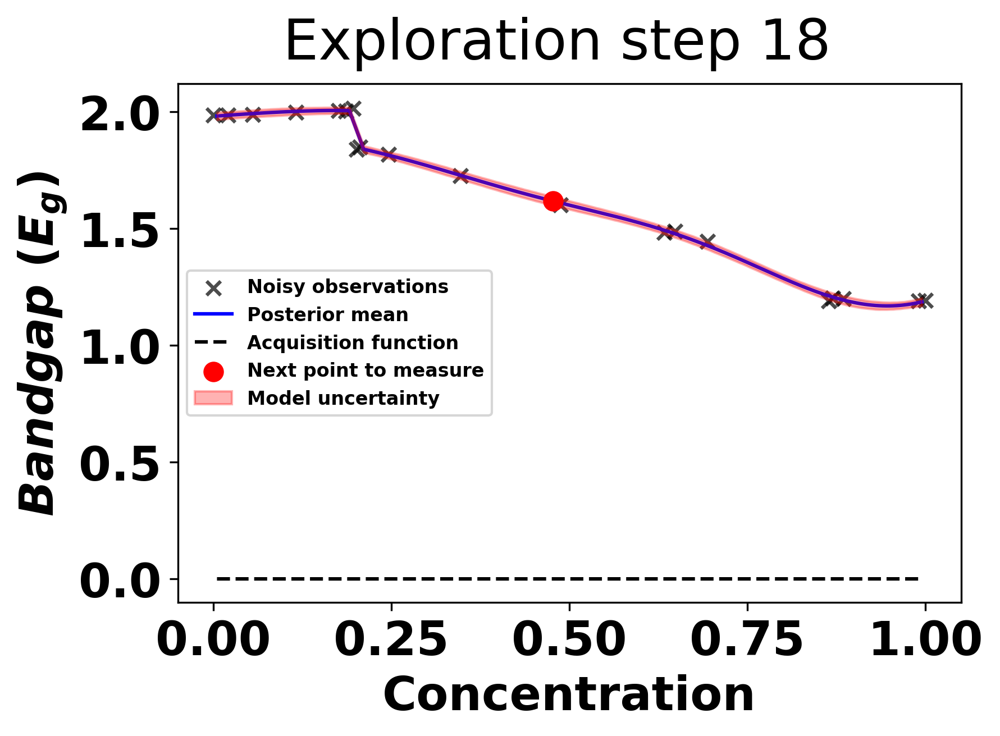

next bandgap: 
 1.6289979496056517
#######---Exploration step 19---#######


sample: 100%|██████████| 4000/4000 [02:09<00:00, 30.78it/s, 191 steps of size 7.15e-03. acc. prob=0.81]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
         a1      1.15      0.57      1.10      0.28      2.07    498.73      1.00
         a2      0.48      0.33      0.40      0.06      0.96    518.95      1.00
         b1      1.42      0.50      1.45      0.67      2.24    332.46      1.01
         b2      1.40      0.50      1.43      0.66      2.25    365.77      1.01
k_length[0]      0.37      0.22      0.33      0.23      0.47     32.82      1.02
    k_scale      0.80      0.83      0.57      0.06      1.57    290.58      1.00
      noise      0.00      0.00      0.00      0.00      0.00     24.23      1.04
          t      0.20      0.01      0.20      0.20      0.20     26.63      1.04

next point:  32
next concentration:
 0.19095477386934673


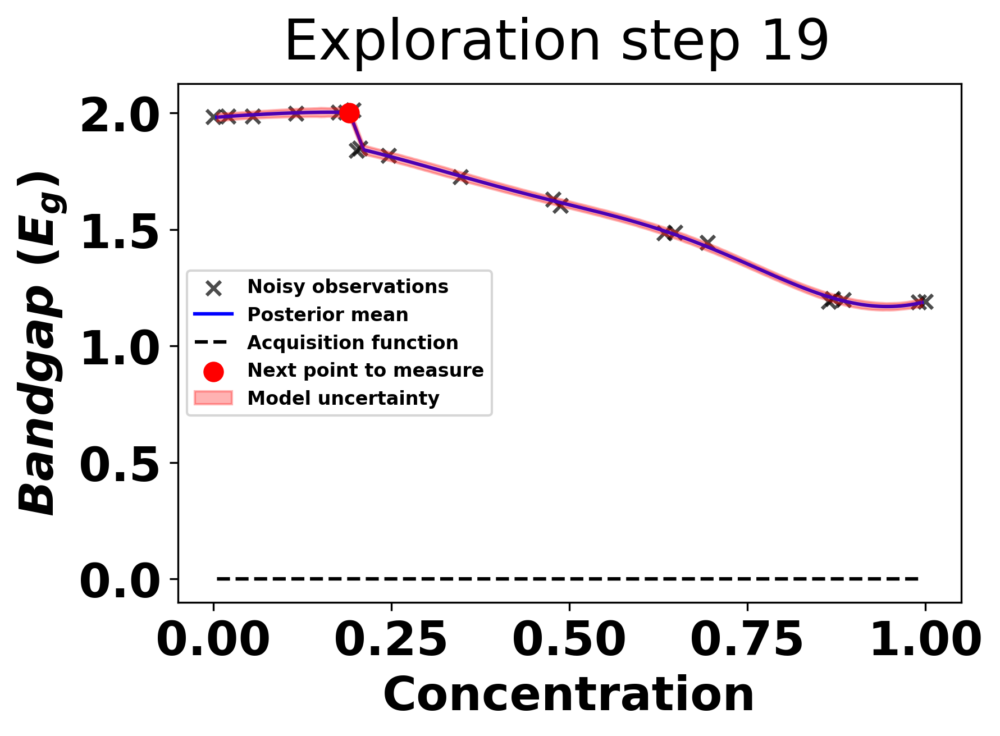

next bandgap: 
 2.008203217972614
#######---Exploration step 20---#######


sample: 100%|██████████| 4000/4000 [02:09<00:00, 30.85it/s, 223 steps of size 9.79e-03. acc. prob=0.78]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
         a1      1.15      0.54      1.09      0.21      1.93    494.00      1.00
         a2      0.47      0.33      0.39      0.07      0.97    534.59      1.00
         b1      1.44      0.50      1.48      0.59      2.22    336.95      1.00
         b2      1.42      0.50      1.45      0.62      2.24    334.01      1.00
k_length[0]      0.34      0.09      0.32      0.23      0.42    190.96      1.00
    k_scale      0.78      0.80      0.56      0.08      1.55    368.59      1.00
      noise      0.00      0.00      0.00      0.00      0.00    226.74      1.00
          t      0.20      0.00      0.20      0.20      0.20    260.32      1.00

next point:  55
next concentration:
 0.3316582914572864


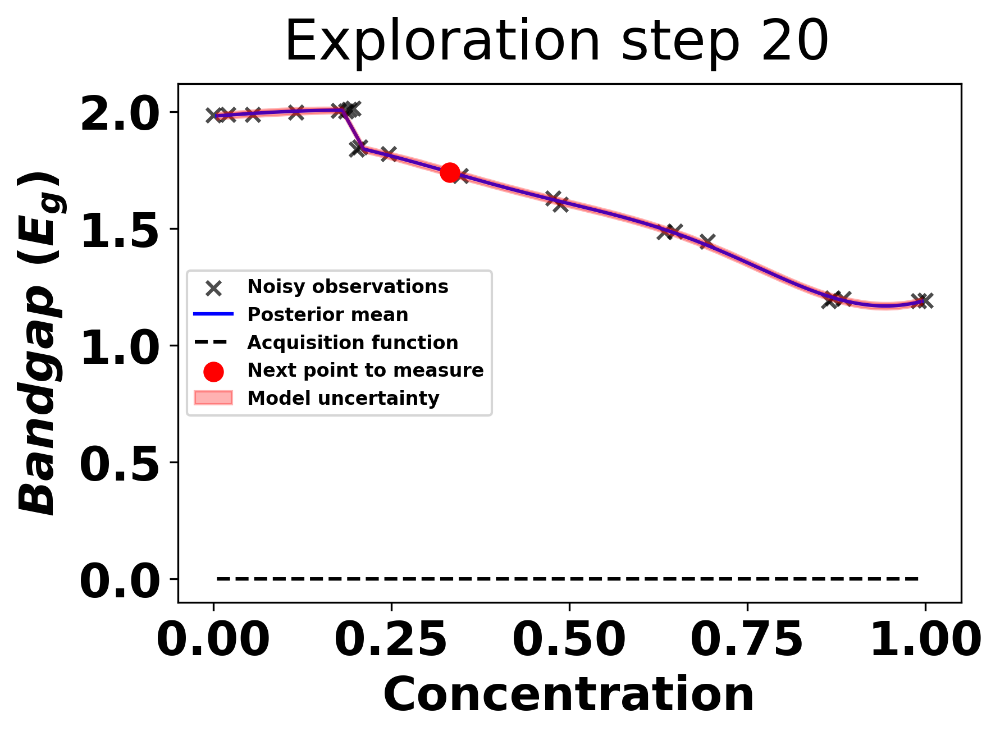

next bandgap: 
 1.7344391357839564
#######---Exploration step 21---#######


sample: 100%|██████████| 4000/4000 [03:37<00:00, 18.39it/s, 1023 steps of size 2.37e-03. acc. prob=0.86]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
         a1      1.19      0.55      1.14      0.40      2.07    349.30      1.00
         a2      0.47      0.35      0.38      0.04      0.88    438.56      1.00
         b1      1.41      0.50      1.42      0.65      2.30    246.71      1.01
         b2      1.39      0.50      1.41      0.55      2.19    251.27      1.01
k_length[0]      0.33      0.06      0.32      0.24      0.42    334.57      1.00
    k_scale      0.79      0.74      0.59      0.08      1.56    350.03      1.00
      noise      0.00      0.00      0.00      0.00      0.00    581.12      1.00
          t      0.20      0.00      0.20      0.20      0.20    342.34      1.00

next point:  124
next concentration:
 0.7135678391959799


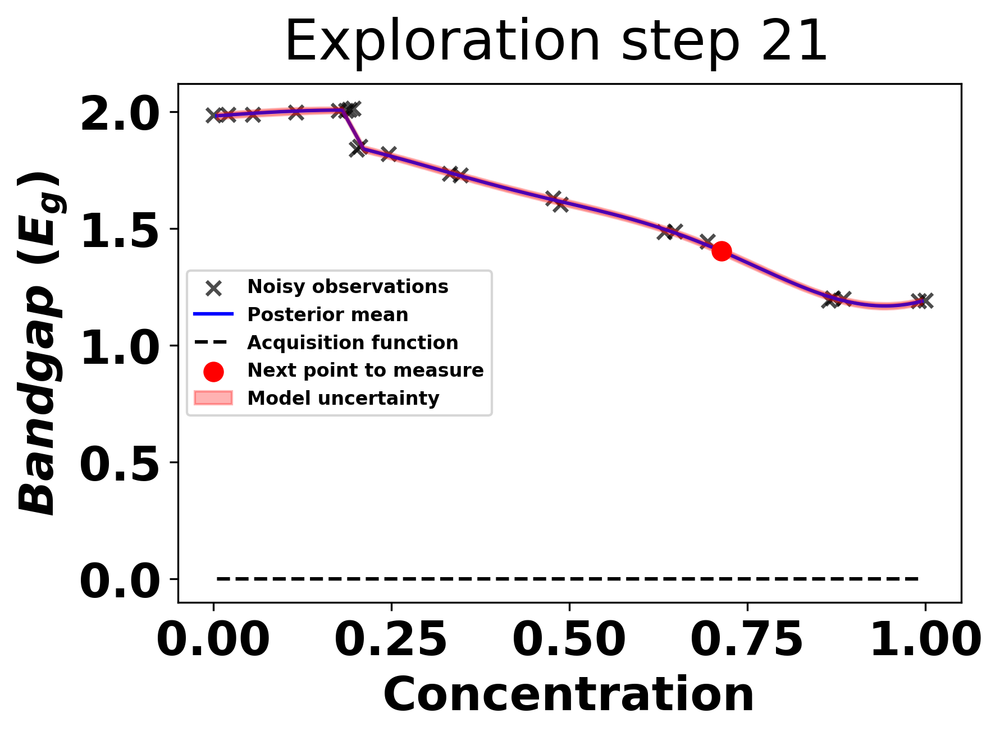

next bandgap: 
 1.4466955901806366
#######---Exploration step 22---#######


sample: 100%|██████████| 4000/4000 [03:22<00:00, 19.71it/s, 1023 steps of size 2.77e-03. acc. prob=0.81]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
         a1      1.12      0.57      1.04      0.23      1.90    389.30      1.00
         a2      0.50      0.37      0.41      0.06      0.98    389.93      1.00
         b1      1.39      0.55      1.41      0.52      2.28    174.78      1.01
         b2      1.36      0.55      1.38      0.58      2.33    180.37      1.00
k_length[0]      0.34      0.26      0.30      0.21      0.40     53.04      1.02
    k_scale      0.81      0.89      0.58      0.08      1.63    201.06      1.01
      noise      0.00      0.00      0.00      0.00      0.00     83.65      1.01
          t      0.20      0.00      0.20      0.20      0.20    467.84      1.00

next point:  160
next concentration:
 0.914572864321608


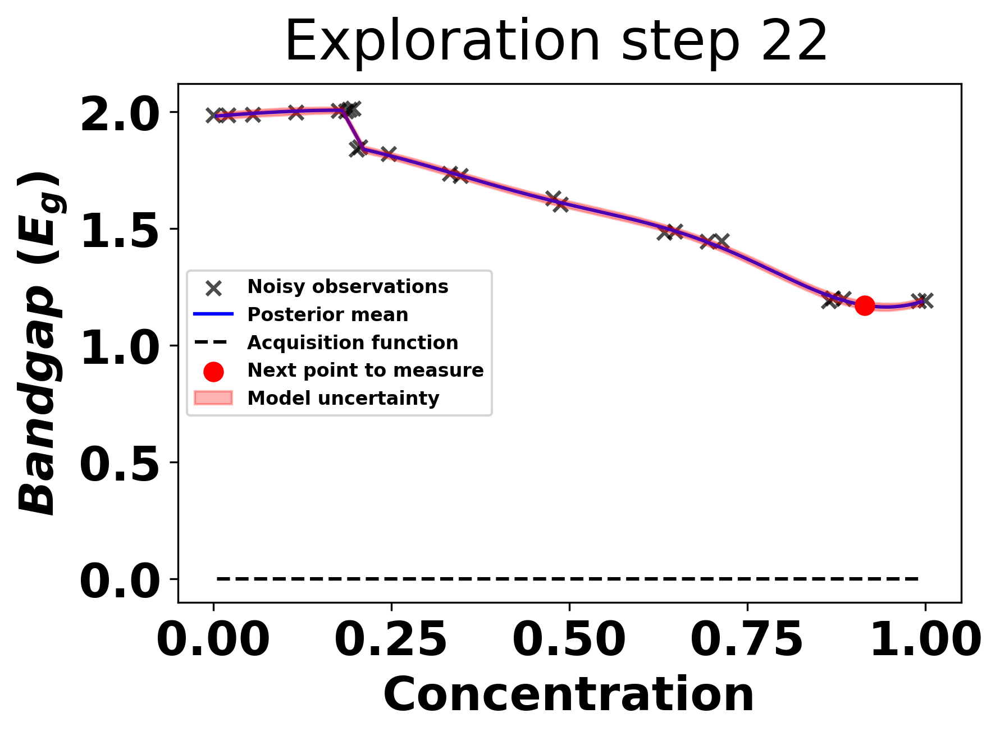

next bandgap: 
 1.2061192719273115
#######---Exploration step 23---#######


sample: 100%|██████████| 4000/4000 [03:53<00:00, 17.11it/s, 1023 steps of size 3.93e-03. acc. prob=0.77]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
         a1      1.13      0.57      1.04      0.20      1.93    546.50      1.00
         a2      0.49      0.36      0.40      0.04      0.93    594.46      1.00
         b1      1.38      0.55      1.41      0.51      2.30    428.66      1.00
         b2      1.35      0.56      1.38      0.41      2.21    419.80      1.00
k_length[0]      0.40      0.26      0.33      0.19      0.55    144.01      1.01
    k_scale      0.81      0.85      0.58      0.07      1.66    486.67      1.00
      noise      0.00      0.00      0.00      0.00      0.00    225.44      1.00
          t      0.20      0.00      0.20      0.20      0.20    479.45      1.00

next point:  174
next concentration:
 0.9949748743718593


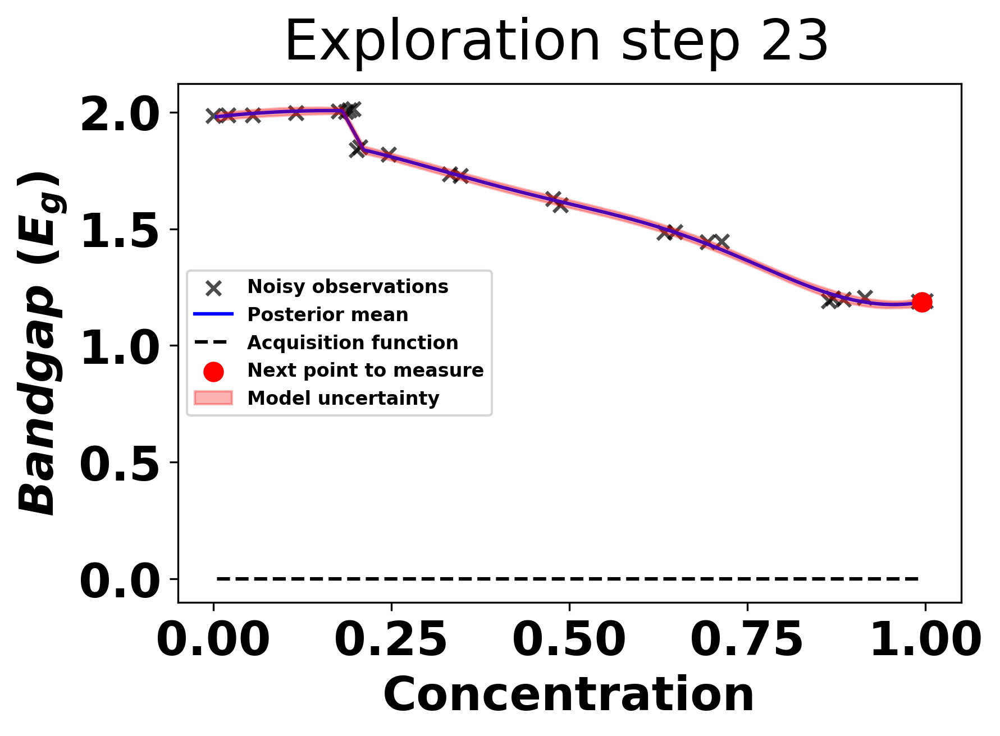

next bandgap: 
 1.1957533669756713
#######---Exploration step 24---#######


sample: 100%|██████████| 4000/4000 [03:36<00:00, 18.49it/s, 511 steps of size 5.70e-03. acc. prob=0.76]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
         a1      1.15      0.61      1.06      0.19      2.02    430.60      1.01
         a2      0.49      0.36      0.41      0.04      0.96    524.22      1.00
         b1      1.36      0.53      1.39      0.53      2.25    301.77      1.00
         b2      1.33      0.53      1.37      0.43      2.16    305.09      1.00
k_length[0]      0.34      0.08      0.32      0.24      0.45    500.86      1.00
    k_scale      0.77      0.80      0.54      0.07      1.56    575.10      1.00
      noise      0.00      0.00      0.00      0.00      0.00    651.75      1.00
          t      0.20      0.00      0.20      0.20      0.20    397.27      1.00

next point:  95
next concentration:
 0.5527638190954774


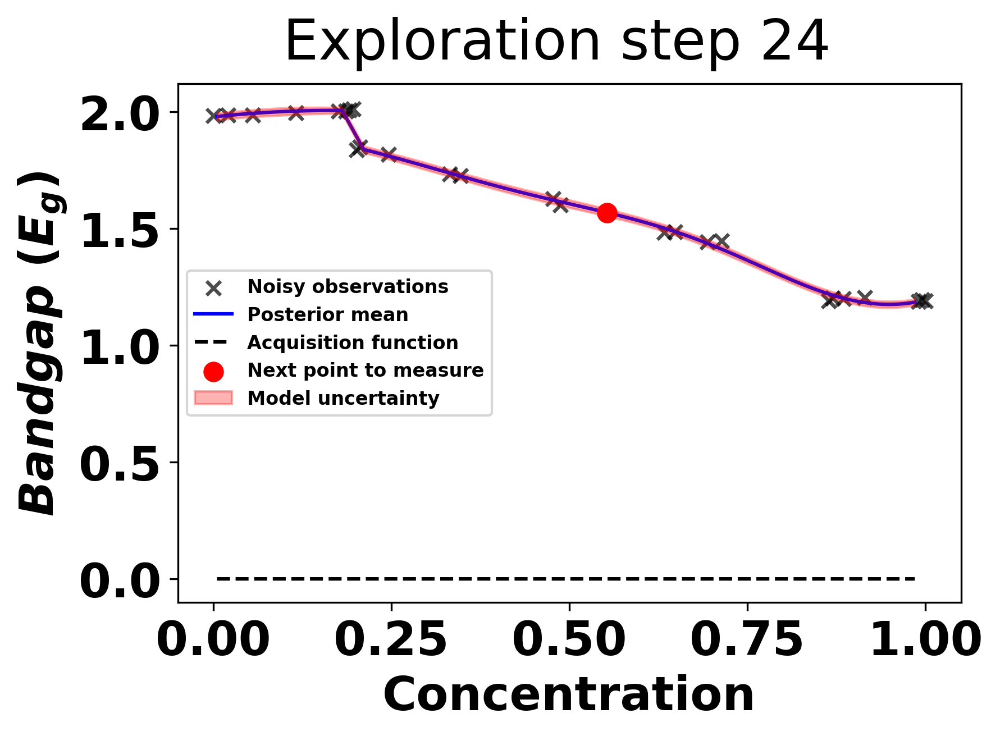

next bandgap: 
 1.5507397311985436
#######---Exploration step 25---#######


sample: 100%|██████████| 4000/4000 [04:00<00:00, 16.66it/s, 1023 steps of size 4.97e-03. acc. prob=0.75]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
         a1      1.09      0.57      1.02      0.23      1.93    486.17      1.00
         a2      0.49      0.34      0.40      0.06      0.96    518.50      1.00
         b1      1.38      0.53      1.41      0.43      2.17    277.39      1.00
         b2      1.34      0.53      1.36      0.38      2.16    283.59      1.00
k_length[0]      0.33      0.10      0.31      0.22      0.43    175.62      1.01
    k_scale      0.75      0.74      0.54      0.06      1.47    348.26      1.00
      noise      0.00      0.00      0.00      0.00      0.00    326.31      1.00
          t      0.20      0.00      0.20      0.20      0.20    535.30      1.00

next point:  11
next concentration:
 0.07035175879396985


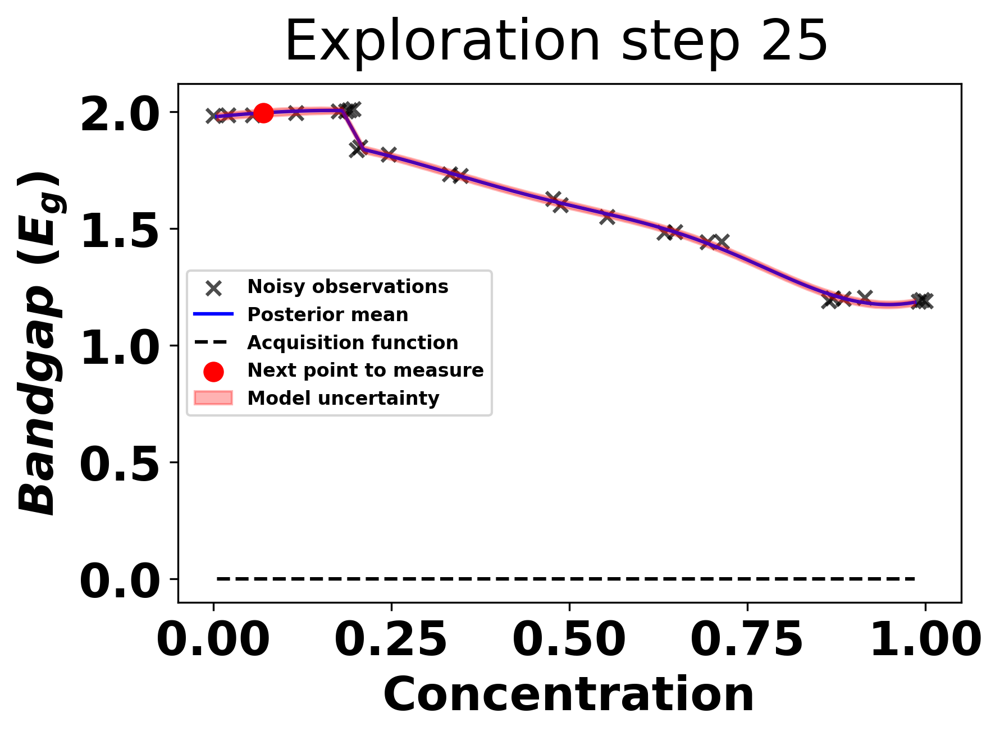

next bandgap: 
 1.9986809136022003
#######---Exploration step 26---#######


sample: 100%|██████████| 4000/4000 [04:39<00:00, 14.32it/s, 1023 steps of size 3.48e-03. acc. prob=0.78]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
         a1      1.02      0.55      0.92      0.17      1.81    468.99      1.00
         a2      0.48      0.34      0.40      0.05      0.89    549.11      1.00
         b1      1.42      0.47      1.41      0.67      2.23    503.68      1.00
         b2      1.37      0.46      1.36      0.59      2.15    504.79      1.00
k_length[0]      0.31      0.06      0.31      0.23      0.41    459.18      1.00
    k_scale      0.68      0.64      0.50      0.07      1.35    605.54      1.00
      noise      0.00      0.00      0.00      0.00      0.00    505.32      1.00
          t      0.20      0.00      0.20      0.20      0.20    385.33      1.00

next point:  0
next concentration:
 0.005025125628140704


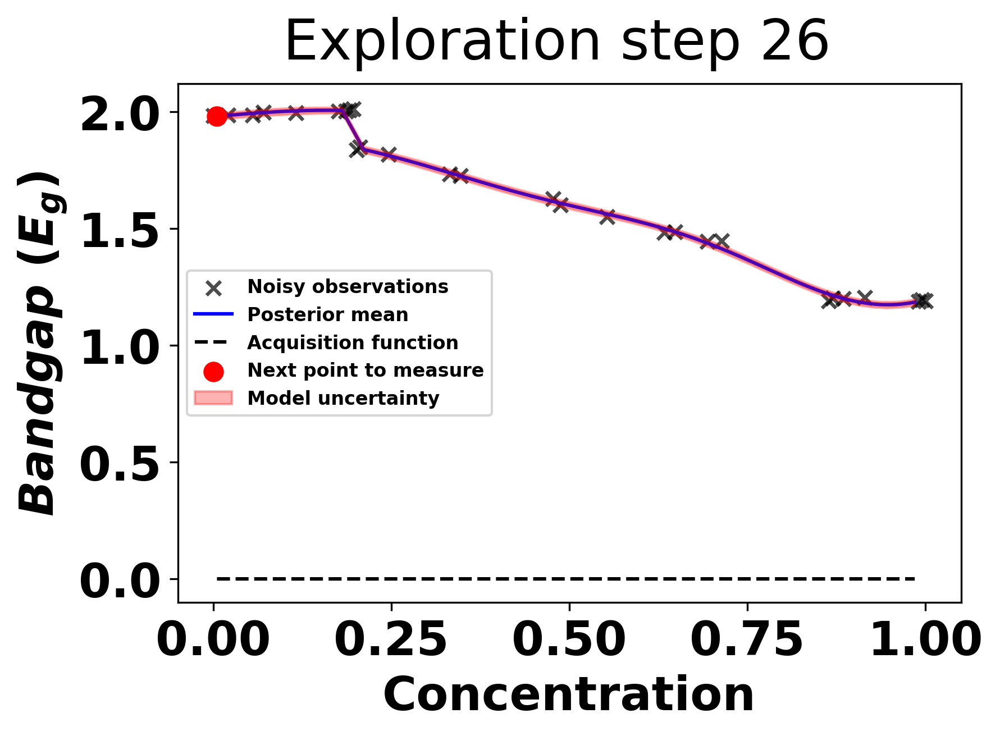

next bandgap: 
 2.004173188210318
#######---Exploration step 27---#######


sample: 100%|██████████| 4000/4000 [04:26<00:00, 14.99it/s, 511 steps of size 4.68e-03. acc. prob=0.74]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
         a1      1.11      0.59      1.04      0.19      1.96    365.47      1.00
         a2      0.49      0.36      0.39      0.06      0.97    434.50      1.00
         b1      1.36      0.58      1.42      0.48      2.29    218.22      1.01
         b2      1.33      0.57      1.38      0.39      2.19    226.53      1.01
k_length[0]      0.35      0.20      0.31      0.21      0.46     71.89      1.03
    k_scale      0.79      1.05      0.52      0.08      1.64    247.74      1.01
      noise      0.00      0.00      0.00      0.00      0.00    105.51      1.03
          t      0.20      0.00      0.20      0.20      0.20    477.82      1.00

next point:  119
next concentration:
 0.7035175879396985


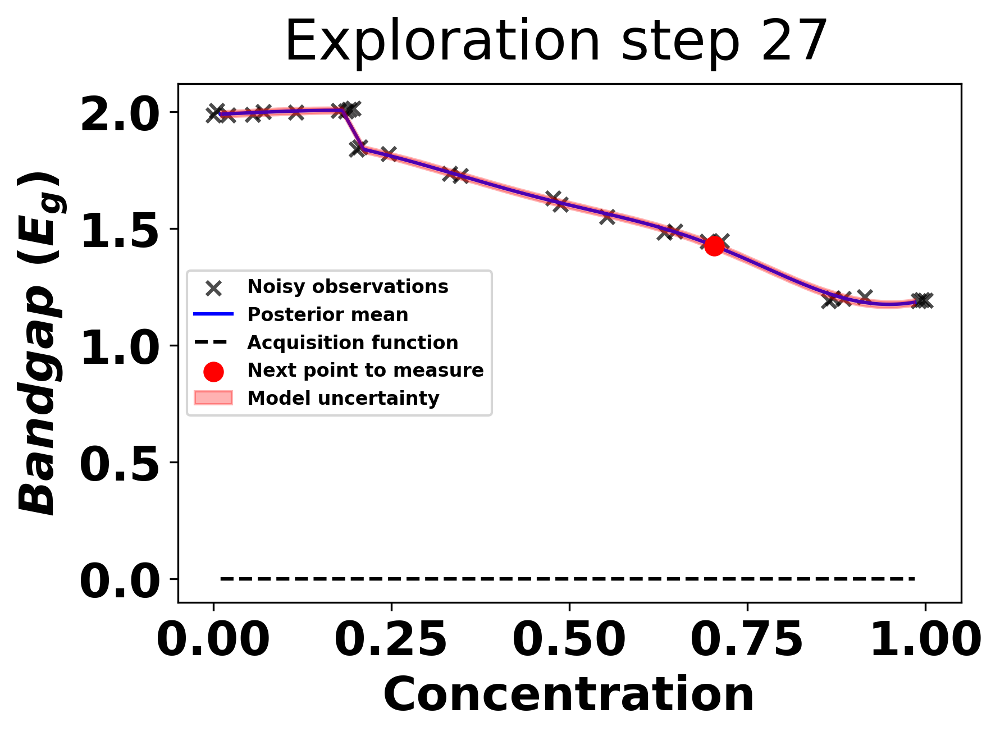

next bandgap: 
 1.4254096400234146
#######---Exploration step 28---#######


sample: 100%|██████████| 4000/4000 [05:00<00:00, 13.31it/s, 767 steps of size 4.30e-03. acc. prob=0.77]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
         a1      1.04      0.53      0.95      0.22      1.81    512.07      1.00
         a2      0.45      0.32      0.37      0.04      0.87    557.86      1.00
         b1      1.44      0.45      1.45      0.67      2.15    556.23      1.00
         b2      1.40      0.46      1.40      0.68      2.18    558.99      1.00
k_length[0]      0.32      0.10      0.30      0.22      0.40    158.18      1.01
    k_scale      0.68      0.64      0.50      0.05      1.32    511.22      1.00
      noise      0.00      0.00      0.00      0.00      0.00    219.33      1.00
          t      0.20      0.00      0.20      0.20      0.20    445.74      1.00

next point:  155
next concentration:
 0.9095477386934674


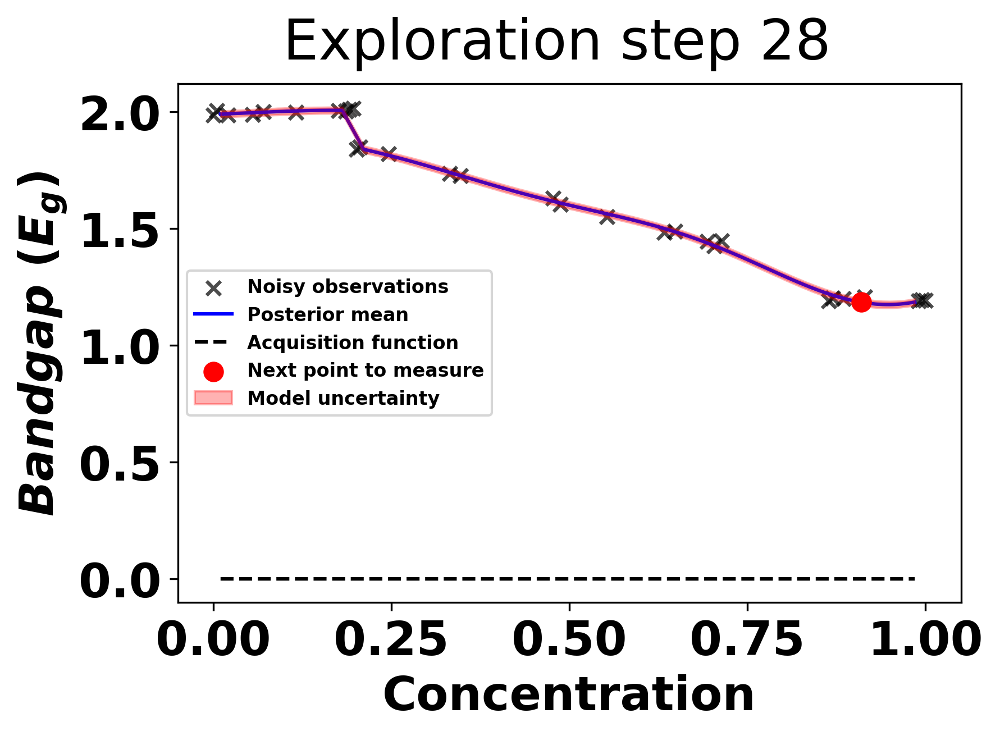

next bandgap: 
 1.205213037482757
#######---Exploration step 29---#######


sample: 100%|██████████| 4000/4000 [06:58<00:00,  9.56it/s, 1023 steps of size 2.82e-03. acc. prob=0.80]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
         a1      1.08      0.56      1.01      0.20      1.86    442.76      1.00
         a2      0.46      0.32      0.38      0.05      0.86    521.75      1.00
         b1      1.43      0.47      1.44      0.57      2.15    354.39      1.00
         b2      1.40      0.47      1.40      0.72      2.30    349.54      1.00
k_length[0]      0.32      0.06      0.31      0.23      0.43    331.70      1.00
    k_scale      0.70      0.61      0.53      0.09      1.37    491.92      1.00
      noise      0.00      0.00      0.00      0.00      0.00    436.42      1.00
          t      0.20      0.00      0.20      0.20      0.20    431.90      1.00

next point:  49
next concentration:
 0.31155778894472363


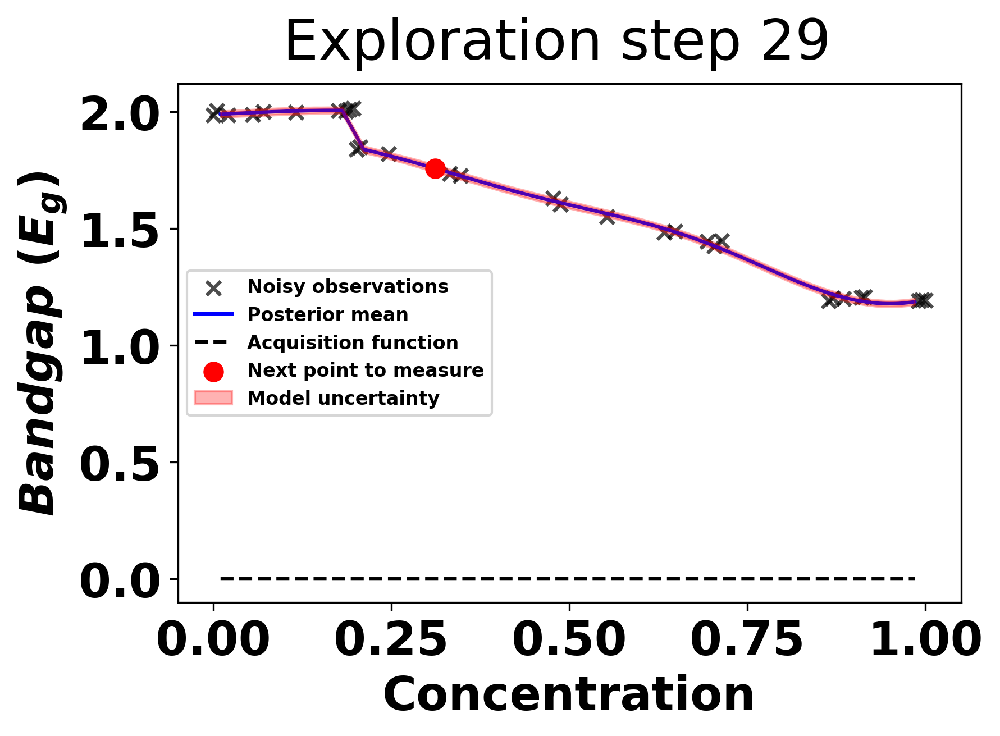

next bandgap: 
 1.7552786597706176


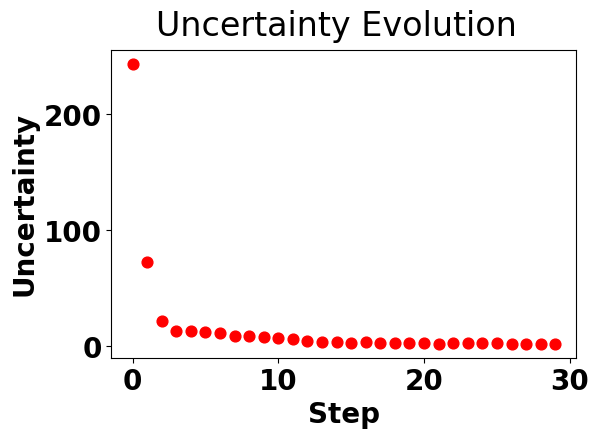

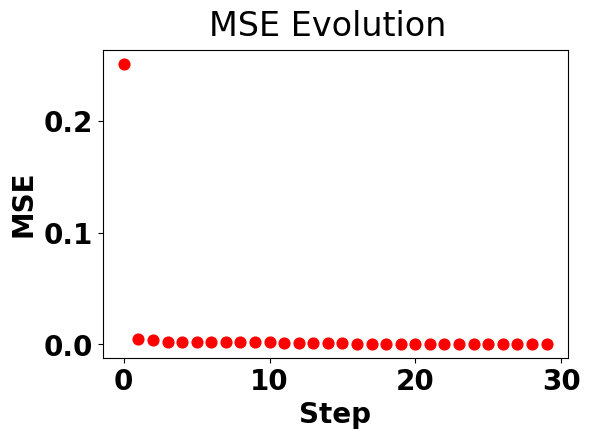

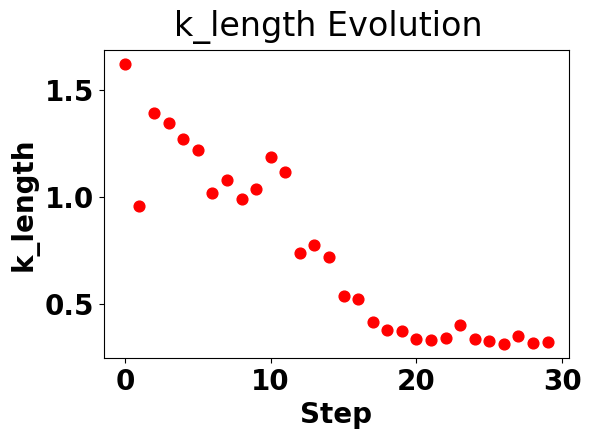

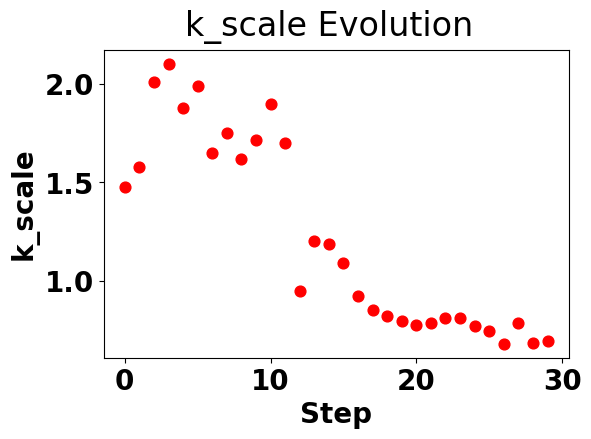

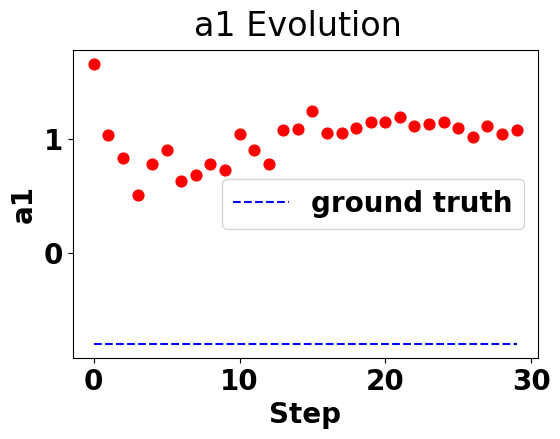

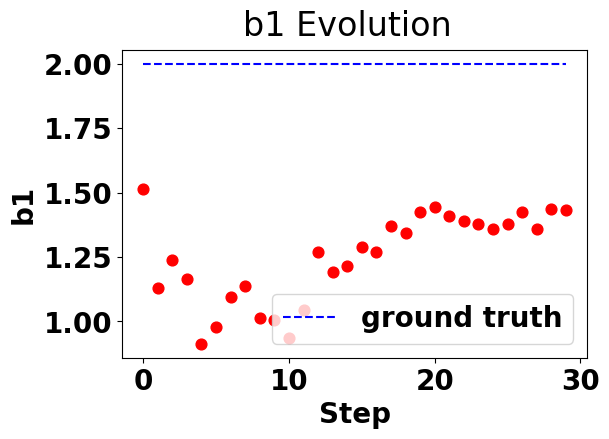

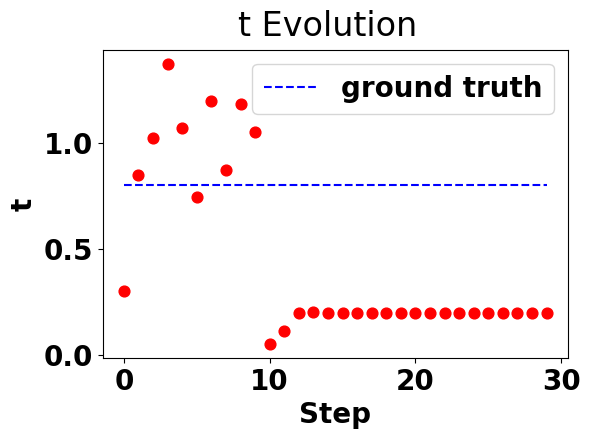

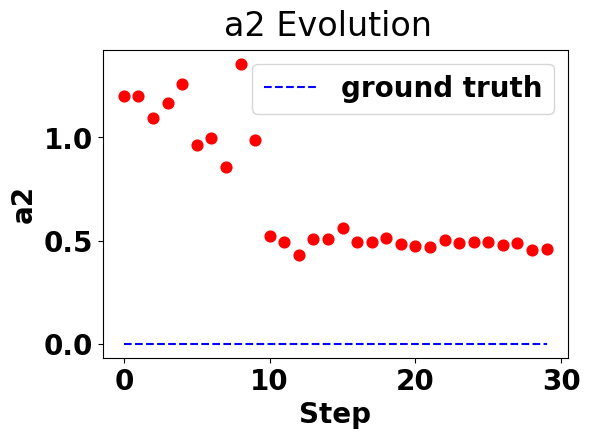

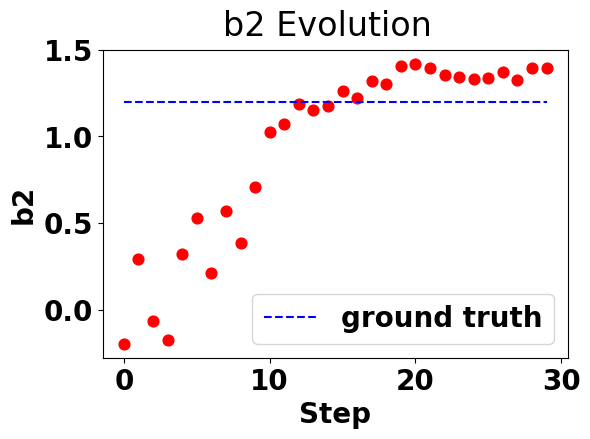

In [ ]:
##############---create dir, list, etc to save each step information---###############
# create a dir to save plots of each step, then these images will be used to make movie at the end
savedir = "/content/video_image_piecewise_sGP/"
if os.path.exists(savedir) == False:
  os.mkdir(savedir)

# create lists to save uncertainty, mse, k_length, k_scale, and model parameters at each step
all_uncertainty_piecewise_mod4 = []
all_mse_piecewise_mod4 = []
all_k_length = []
all_k_scale = []
all_a1 = []
all_b1 = []
all_t = []
all_a2 = []
all_b2 = []

model = piecewise #None
model_prior = piecewise_prior #None

##############---prepare data---###########
# prepare training data
X = jnp.linspace(0.0, 1, NUM_INIT_POINTS)
idx = jnp.asarray([0, NUM_INIT_POINTS-1])#set seed points to two extreme conditions
indx = idx.tolist()

# select model here
y_all = y4[:, None]                               # Select the toy model
Y = jnp.asarray([y_all[0][0], y_all[199][0]])

# initialize training data
(X_train, y_train, X_test, y_test,
 indices_train, indices_test) = init_training_data_exp(X, Y, y_all, list_of_indices = indx)

exploration_steps = 30

##########------start exploration----###########
for s in range (exploration_steps):
  print("#######---Exploration step {}---#######".format(s))
  # Compute acquisition function
  if model is None or model_prior is None: # Select GP or sGP
    acq, (y_pred, y_sampled), paras_ = step_GP(X_train, y_train, X_test)
  else:
    acq, (y_pred, y_sampled), paras_ = step_sGP(X_train, y_train, X_test, model, model_prior)
  # Get the next point to evaluate
  next_point = acq.argmax()
  # next concentration
  X_next = X_test[next_point]
  print("next point: ", next_point)
  print("next concentration:\n", X_next)

  # Plot
  f, ax1 = plt.subplots(figsize = (6, 4), dpi=300)
  f.suptitle("Exploration step {}".format(s))
  ax1.set_xlabel("Concentration")
  ax1.set_ylabel("$Bandgap$ ($E_g$)")
  ax1.scatter(X_train, y_train, marker='x', c='k', zorder=1, label="Noisy observations", alpha=0.7)
  ax1.plot(X_test, y_pred, lw=1.5, zorder=1, c='b', label='Posterior mean')
  ax1.plot(X_test, acq, lw=1.5, zorder=1, c='black', linestyle = "--", label='Acquisition function')
  ax1.scatter(X_test[next_point], y_pred[next_point], s=60, c='r', label='Next point to measure')
  ax1.fill_between(X_test.squeeze(), y_pred - y_sampled.std(axis=(0,1)), y_pred + y_sampled.std(axis=(0,1)),
                color='r', alpha=0.3, label="Model uncertainty")
  ax1.legend(loc = 'best',fontsize=8)
  ax1.y_lim=(0.5,2)
  plt.show()
  f.savefig(os.path.join(savedir, '{}.png'.format(s)))   # save this plot to savedir

  # add the uncertainty of this step to the list
  this_uncertainty = y_sampled.std(axis=(0,1)).sum()
  all_uncertainty_piecewise_mod4.append(this_uncertainty)
  # add the mse of this step to the list
  this_mse = mean_squared_error(y_test,y_pred)
  all_mse_piecewise_mod4.append(this_mse)
  # add the k_length of this step to the list
  this_k_length = paras_['k_length'].mean()
  all_k_length.append(this_k_length)
  # add the k_scale of this step to the list
  this_k_scale = paras_['k_scale'].mean()
  all_k_scale.append(this_k_scale)
  # add the a of this step to the list
  this_a1 = paras_['a1'].mean()
  all_a1.append(this_a1)
  # add the a of this step to the list
  this_b1 = paras_['b1'].mean()
  all_b1.append(this_b1)
  # add the a of this step to the list
  this_t = paras_['t'].mean()
  all_t.append(this_t)
  # add the a of this step to the list
  this_a2 = paras_['a2'].mean()
  all_a2.append(this_a2)
  # add the a of this step to the list
  this_b2 = paras_['b2'].mean()
  all_b2.append(this_b2)

  # next 'measurement'
  y_new = jnp.asarray(y_test[next_point])  # get next bandgap
  y_test = jnp.delete(y_test, next_point)  # update bandgap data set
  print("next bandgap: \n", y_new)
  # update training data
  X_train, y_train, X_test = update_datapoints_exp(next_point, X_train, y_train, X_test, y_new)


###############---sumarize the the information from each step---############
# create movie from saved images
aoi.utils.animation_from_png(png_dir=savedir, moviename="evolution_mod4_iecwise_sGP",
                             savedir= "/content/",
                             duration = 1, remove_dir=False)


# plot the evoltution of uncerstainty
f1, ax = plt.subplots(figsize = (6, 4), dpi=100)
f1.suptitle("Uncertainty Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("Uncertainty")
ax.scatter(np.arange(exploration_steps), all_uncertainty_piecewise_mod4, s = 60, c='r')

# plot the evolution of MSE
f2, ax = plt.subplots(figsize = (6, 4), dpi=100)
f2.suptitle("MSE Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("MSE")
ax.scatter(np.arange(exploration_steps), all_mse_piecewise_mod4, s = 60, c='r')

# plot the evolution of k_length
f3, ax = plt.subplots(figsize = (6, 4), dpi=100)
f3.suptitle("k_length Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("k_length")
ax.scatter(np.arange(exploration_steps), all_k_length, s = 60, c='r')

# plot the evolution of k_scale
f4, ax = plt.subplots(figsize = (6, 4), dpi=100)
f4.suptitle("k_scale Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("k_scale")
ax.scatter(np.arange(exploration_steps), all_k_scale, s = 60, c='r')

#Compare a, b, t, with ground truth
groundtruth = np.arange(exploration_steps, dtype = np.float64)
# plot the evolution of a1
f4, ax = plt.subplots(figsize = (6, 4), dpi=100)
f4.suptitle("a1 Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("a1")
ax.scatter(np.arange(exploration_steps), all_a1, s = 60, c='r')
groundtruth[:] = -0.8
ax.plot(np.arange(exploration_steps), groundtruth,
        linestyle = '--', c='b', label = "ground truth")
ax.legend()

# plot the evolution of b1
f4, ax = plt.subplots(figsize = (6, 4), dpi=100)
f4.suptitle("b1 Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("b1")
ax.scatter(np.arange(exploration_steps), all_b1, s = 60, c='r')
groundtruth[:] = 2
ax.plot(np.arange(exploration_steps), groundtruth,
        linestyle = '--', c='b', label = "ground truth")
ax.legend()

# plot the evolution of t
f4, ax = plt.subplots(figsize = (6, 4), dpi=100)
f4.suptitle("t Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("t")
ax.scatter(np.arange(exploration_steps), all_t, s = 60, c='r')
groundtruth[:] = 0.8
ax.plot(np.arange(exploration_steps), groundtruth,
        linestyle = '--', c='b', label = "ground truth")
ax.legend()

# plot the evolution of a2
f4, ax = plt.subplots(figsize = (6, 4), dpi=100)
f4.suptitle("a2 Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("a2")
ax.scatter(np.arange(exploration_steps), all_a2, s = 60, c='r')
groundtruth[:] = 0
ax.plot(np.arange(exploration_steps), groundtruth,
        linestyle = '--', c='b', label = "ground truth")
ax.legend()

# plot the evolution of b2
f4, ax = plt.subplots(figsize = (6, 4), dpi=100)
f4.suptitle("b2 Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("b2")
ax.scatter(np.arange(exploration_steps), all_b2, s = 60, c='r')
groundtruth[:] = 1.2
ax.plot(np.arange(exploration_steps), groundtruth,
        linestyle = '--', c='b', label = "ground truth")
ax.legend()

In [ ]:
mse_mod4=pd.DataFrame(list(zip(all_mse_GP_mod4,all_mse_linear_mod4,all_mse_quad_mod4,all_mse_piecewise_mod4)),columns=['GP','Linear','Quadratic','Piecewise'])
mod4_mse=np.array(
mse_mod4)

In [ ]:

Uncertainity_mod4= pd.DataFrame(list(zip(all_uncertainty_GP_mod4,all_uncertainty_linear_mod4,all_uncertainty_quad_mod4,all_uncertainty_piecewise_mod4)),columns=['GP','Linear','Quadratic','Piecewise'])
mod4_uncertainty=np.array(
Uncertainity_mod4)

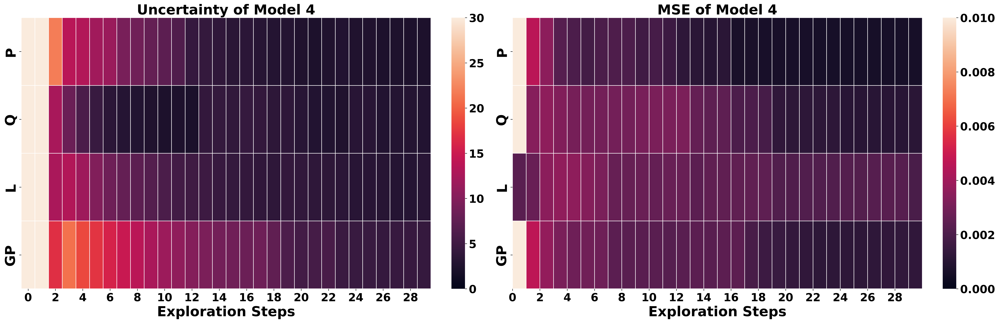

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(25, 8), dpi=300, constrained_layout=True)

ax[0] = sns.heatmap(mod4_uncertainty.astype(float).T, vmin=0, vmax=30, ax=ax[0], annot=False, annot_kws={'fontsize': 15, 'rotation': 90}, linewidth=0.5, fmt='.1f',cmap='rocket')
ax[0].invert_yaxis()

ax[0].yaxis.set_ticklabels(['GP', 'L', 'Q', 'P'], fontsize=25)
ax[0].set_xlabel('Exploration Steps', fontsize=25)
ax[0].set_title('Uncertainty of Model 4', fontsize=25)

ax[1] = sns.heatmap(mod4_mse.astype(float).T, ax=ax[1], annot=False, annot_kws={'fontsize': 15, 'rotation': 90}, linewidth=0.5, fmt='.5f',vmin=0,vmax=0.01,cmap='rocket')
ax[1].invert_yaxis()

ax[1].yaxis.set_ticklabels(['GP', 'L', 'Q', 'P'], fontsize=25)
ax[1].set_xticks([0, 2, 4, 6, 8, 10, 12, 14, 16, 18, 20, 22, 24, 26, 28])
ax[1].set_xlabel('Exploration Steps', fontsize=25)
ax[1].set_title('MSE of Model 4', fontsize=25)

# Rotate the x-axis tick labels vertically
ax[1].tick_params(axis='x', labelrotation=0)

# Set the tick labels for the x-axis explicitly
ax[1].set_xticklabels([0, 2, 4, 6, 8, 10, 12, 14, 16, 18, 20, 22, 24, 26, 28], fontsize=20)

plt.show()


### Model 5


## GP

In [ ]:
##############---create dir, list, etc to save each step information---###############
# create a dir to save plots of each step, then these images will be used to make movie at the end
savedir = "/content/mod5_GP/"
if os.path.exists(savedir) == False:
  os.mkdir(savedir)

# create lists to save uncertainty, mse, k_length, and k_scale at each step
all_uncertainty = []
all_mse = []
all_k_length = []
all_k_scale = []

model = None
model_prior = None

##############---prepare data---###########
# prepare training data
X = jnp.linspace(0.0, 1, NUM_INIT_POINTS)
idx = jnp.asarray([0, NUM_INIT_POINTS-1])#set seed points to two extreme conditions
indx = idx.tolist()

# select model here
y_all = y5[:, None]                               # Select the toy model
Y = jnp.asarray([y_all[0][0], y_all[199][0]])

# initialize training data
(X_train, y_train, X_test, y_test,
 indices_train, indices_test) = init_training_data_exp(X, Y, y_all, list_of_indices = indx)

exploration_steps = 30

##########------start exploration----###########
for s in range (exploration_steps):
  print("#######---Exploration step {}---#######".format(s))
  # Compute acquisition function
  if model is None or model_prior is None: # Select GP or sGP
    acq, (y_pred, y_sampled), paras_ = step_GP(X_train, y_train, X_test)
  else:
    acq, (y_pred, y_sampled), paras_ = step_sGP(X_train, y_train, X_test, model, model_prior)
  # Get the next point to evaluate
  next_point = acq.argmax()
  # next concentration
  X_next = X_test[next_point]
  print("next point: ", next_point)
  print("next concentration:\n", X_next)

  # Plot
  f, ax1 = plt.subplots(figsize = (6, 4), dpi=300)
  f.suptitle("Exploration step {}".format(s))
  ax1.set_xlabel("Concentration")
  ax1.set_ylabel("$Bandgap$ ($E_g$)")
  ax1.scatter(X_train, y_train, marker='x', c='k', zorder=1, label="Noisy observations", alpha=0.7)
  ax1.plot(X_test, y_pred, lw=1.5, zorder=1, c='b', label='Posterior mean')
  ax1.plot(X_test, acq, lw=1.5, zorder=1, c='black', linestyle = "--", label='Acquisition function')
  ax1.scatter(X_test[next_point], y_pred[next_point], s=60, c='r', label='Next point to measure')
  ax1.fill_between(X_test.squeeze(), y_pred - y_sampled.std(axis=(0,1)), y_pred + y_sampled.std(axis=(0,1)),
                color='r', alpha=0.3, label="Model uncertainty")
  ax1.legend(loc = 'best',fontsize=8)
  ax1.y_lim=(0.5,2)
  plt.show()
  f.savefig(os.path.join(savedir, '{}.png'.format(s)))   # save this plot to savedir

  # add the uncertainty of this step to the list
  this_uncertainty = y_sampled.std(axis=(0,1)).sum()
  all_uncertainty.append(this_uncertainty)
  # add the mse of this step to the list
  this_mse = mean_squared_error(y_test,y_pred)
  all_mse.append(this_mse)
  # add the k_length of this step to the list
  this_k_length = paras_['k_length'].mean()
  all_k_length.append(this_k_length)
  # add the k_scale of this step to the list
  this_k_scale = paras_['k_scale'].mean()
  all_k_scale.append(this_k_scale)

  # next 'measurement'
  y_new = jnp.asarray(y_test[next_point])  # get next bandgap
  y_test = jnp.delete(y_test, next_point)  # update bandgap data set
  print("next bandgap: \n", y_new)
  # update training data
  X_train, y_train, X_test = update_datapoints_exp(next_point, X_train, y_train, X_test, y_new)


###############---sumarize the the information from each step---############
# create movie from saved images
aoi.utils.animation_from_png(png_dir=savedir, moviename="mod5_GP",
                             savedir= "/content/",
                             duration = 1, remove_dir=False)


# plot the evoltution of uncerstainty
f1, ax = plt.subplots(figsize = (6, 4), dpi=100)
f1.suptitle("Uncertainty Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("Uncertainty")
ax.scatter(np.arange(exploration_steps), all_uncertainty, s = 60, c='r')

# plot the evolution of MSE
f2, ax = plt.subplots(figsize = (6, 4), dpi=100)
f2.suptitle("MSE Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("MSE")
ax.scatter(np.arange(exploration_steps), all_mse, s = 60, c='r')

# plot the evolution of k_length
f3, ax = plt.subplots(figsize = (6, 4), dpi=100)
f3.suptitle("k_length Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("k_length")
ax.scatter(np.arange(exploration_steps), all_k_length, s = 60, c='r')

# plot the evolution of k_scale
f4, ax = plt.subplots(figsize = (6, 4), dpi=100)
f4.suptitle("k_scale Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("k_scale")
ax.scatter(np.arange(exploration_steps), all_k_scale, s = 60, c='r')


# sGP

### Liear model 5

In [ ]:
##############---create dir, list, etc to save each step information---###############
# create a dir to save plots of each step, then these images will be used to make movie at the end
savedir = "/content/mod5_linear_sGP/"
if os.path.exists(savedir) == False:
  os.mkdir(savedir)

# create lists to save uncertainty, mse, k_length, and k_scale at each step
all_uncertainty = []
all_mse = []
all_k_length = []
all_k_scale = []
all_a = []
all_b = []


model = linear #None
model_prior = linear_prior #None

##############---prepare data---###########
# prepare training data
X = jnp.linspace(0.0, 1, NUM_INIT_POINTS)
idx = jnp.asarray([0, NUM_INIT_POINTS-1])#set seed points to two extreme conditions
indx = idx.tolist()

# select model here
y_all = y5[:, None]                               # Select the toy model
Y = jnp.asarray([y_all[0][0], y_all[199][0]])

# initialize training data
(X_train, y_train, X_test, y_test,
 indices_train, indices_test) = init_training_data_exp(X, Y, y_all, list_of_indices = indx)

exploration_steps = 30

##########------start exploration----###########
for s in range (exploration_steps):
  print("#######---Exploration step {}---#######".format(s))
  # Compute acquisition function
  if model is None or model_prior is None: # Select GP or sGP
    acq, (y_pred, y_sampled), paras_ = step_GP(X_train, y_train, X_test)
  else:
    acq, (y_pred, y_sampled), paras_ = step_sGP(X_train, y_train, X_test, model, model_prior)
  # Get the next point to evaluate
  next_point = acq.argmax()
  # next concentration
  X_next = X_test[next_point]
  print("next point: ", next_point)
  print("next concentration:\n", X_next)

  # Plot
  f, ax1 = plt.subplots(figsize = (6, 4), dpi=300)
  f.suptitle("Exploration step {}".format(s))
  ax1.set_xlabel("Concentration")
  ax1.set_ylabel("$Bandgap$ ($E_g$)")
  ax1.scatter(X_train, y_train, marker='x', c='k', zorder=1, label="Noisy observations", alpha=0.7)
  ax1.plot(X_test, y_pred, lw=1.5, zorder=1, c='b', label='Posterior mean')
  ax1.plot(X_test, acq, lw=1.5, zorder=1, c='black', linestyle = "--", label='Acquisition function')
  ax1.scatter(X_test[next_point], y_pred[next_point], s=60, c='r', label='Next point to measure')
  ax1.fill_between(X_test.squeeze(), y_pred - y_sampled.std(axis=(0,1)), y_pred + y_sampled.std(axis=(0,1)),
                color='r', alpha=0.3, label="Model uncertainty")
  ax1.legend(loc = 'best',fontsize=8)
  ax1.y_lim=(0.5,2)
  plt.show()
  f.savefig(os.path.join(savedir, '{}.png'.format(s)))   # save this plot to savedir

  # add the uncertainty of this step to the list
  this_uncertainty = y_sampled.std(axis=(0,1)).sum()
  all_uncertainty.append(this_uncertainty)
  # add the mse of this step to the list
  this_mse = mean_squared_error(y_test,y_pred)
  all_mse.append(this_mse)
  # add the k_length of this step to the list
  this_k_length = paras_['k_length'].mean()
  all_k_length.append(this_k_length)
  # add the k_scale of this step to the list
  this_k_scale = paras_['k_scale'].mean()
  all_k_scale.append(this_k_scale)
  # add the a of this step to the list
  this_a = paras_['a'].mean()
  all_a.append(this_a)
  # add the a of this step to the list
  this_b = paras_['b'].mean()
  all_b.append(this_b)
  # add the a of this step to the list


  # next 'measurement'
  y_new = jnp.asarray(y_test[next_point])  # get next bandgap
  y_test = jnp.delete(y_test, next_point)  # update bandgap data set
  print("next bandgap: \n", y_new)
  # update training data
  X_train, y_train, X_test = update_datapoints_exp(next_point, X_train, y_train, X_test, y_new)


###############---sumarize the the information from each step---############
# create movie from saved images
aoi.utils.animation_from_png(png_dir=savedir, moviename="evolution_model 5_linear_sGP",
                             savedir= "/content/",
                             duration = 1, remove_dir=False)


# plot the evoltution of uncerstainty
f1, ax = plt.subplots(figsize = (6, 4), dpi=100)
f1.suptitle("Uncertainty Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("Uncertainty")
ax.scatter(np.arange(exploration_steps), all_uncertainty, s = 60, c='r')

# plot the evolution of MSE
f2, ax = plt.subplots(figsize = (6, 4), dpi=100)
f2.suptitle("MSE Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("MSE")
ax.scatter(np.arange(exploration_steps), all_mse, s = 60, c='r')

# plot the evolution of k_length
f3, ax = plt.subplots(figsize = (6, 4), dpi=100)
f3.suptitle("k_length Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("k_length")
ax.scatter(np.arange(exploration_steps), all_k_length, s = 60, c='r')

# plot the evolution of k_scale
f4, ax = plt.subplots(figsize = (6, 4), dpi=100)
f4.suptitle("k_scale Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("k_scale")
ax.scatter(np.arange(exploration_steps), all_k_scale, s = 60, c='r')

#Compare a, b, c, with ground truth
groundtruth = np.arange(exploration_steps, dtype = np.float64)
# plot the evolution of a
f4, ax = plt.subplots(figsize = (6, 4), dpi=100)
f4.suptitle("a Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("a")
ax.scatter(np.arange(exploration_steps), all_a, s = 60, c='r')
groundtruth[:] = 2
ax.plot(np.arange(exploration_steps), groundtruth,
        linestyle = '--', c='b', label = "ground truth")
ax.legend()

# plot the evolution of b
f4, ax = plt.subplots(figsize = (6, 4), dpi=100)
f4.suptitle("b Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("b")
ax.scatter(np.arange(exploration_steps), all_b, s = 60, c='r')
groundtruth[:] = -2.8
ax.plot(np.arange(exploration_steps), groundtruth,
        linestyle = '--', c='b', label = "ground truth")
ax.legend()



### quadratic model 5

In [ ]:
##############---create dir, list, etc to save each step information---###############
# create a dir to save plots of each step, then these images will be used to make movie at the end
savedir = "/content/mod5_quad_sGP/"
if os.path.exists(savedir) == False:
  os.mkdir(savedir)

# create lists to save uncertainty, mse, k_length, and k_scale at each step
all_uncertainty = []
all_mse = []
all_k_length = []
all_k_scale = []
all_a = []
all_b = []
all_c = []

model = quadratic #None
model_prior = quadratic_prior #None

##############---prepare data---###########
# prepare training data
X = jnp.linspace(0.0, 1, NUM_INIT_POINTS)
idx = jnp.asarray([0, NUM_INIT_POINTS-1])#set seed points to two extreme conditions
indx = idx.tolist()

# select model here
y_all = y5[:, None]                               # Select the toy model
Y = jnp.asarray([y_all[0][0], y_all[199][0]])

# initialize training data
(X_train, y_train, X_test, y_test,
 indices_train, indices_test) = init_training_data_exp(X, Y, y_all, list_of_indices = indx)

exploration_steps = 30

##########------start exploration----###########
for s in range (exploration_steps):
  print("#######---Exploration step {}---#######".format(s))
  # Compute acquisition function
  if model is None or model_prior is None: # Select GP or sGP
    acq, (y_pred, y_sampled), paras_ = step_GP(X_train, y_train, X_test)
  else:
    acq, (y_pred, y_sampled), paras_ = step_sGP(X_train, y_train, X_test, model, model_prior)
  # Get the next point to evaluate
  next_point = acq.argmax()
  # next concentration
  X_next = X_test[next_point]
  print("next point: ", next_point)
  print("next concentration:\n", X_next)

  # Plot
  f, ax1 = plt.subplots(figsize = (6, 4), dpi=300)
  f.suptitle("Exploration step {}".format(s))
  ax1.set_xlabel("Concentration")
  ax1.set_ylabel("$Bandgap$ ($E_g$)")
  ax1.scatter(X_train, y_train, marker='x', c='k', zorder=1, label="Noisy observations", alpha=0.7)
  ax1.plot(X_test, y_pred, lw=1.5, zorder=1, c='b', label='Posterior mean')
  ax1.plot(X_test, acq, lw=1.5, zorder=1, c='black', linestyle = "--", label='Acquisition function')
  ax1.scatter(X_test[next_point], y_pred[next_point], s=60, c='r', label='Next point to measure')
  ax1.fill_between(X_test.squeeze(), y_pred - y_sampled.std(axis=(0,1)), y_pred + y_sampled.std(axis=(0,1)),
                color='r', alpha=0.3, label="Model uncertainty")
  ax1.legend(loc = 'best',fontsize=8)
  ax1.y_lim=(0.5,2)
  plt.show()
  f.savefig(os.path.join(savedir, '{}.png'.format(s)))   # save this plot to savedir

  # add the uncertainty of this step to the list
  this_uncertainty = y_sampled.std(axis=(0,1)).sum()
  all_uncertainty.append(this_uncertainty)
  # add the mse of this step to the list
  this_mse = mean_squared_error(y_test,y_pred)
  all_mse.append(this_mse)
  # add the k_length of this step to the list
  this_k_length = paras_['k_length'].mean()
  all_k_length.append(this_k_length)
  # add the k_scale of this step to the list
  this_k_scale = paras_['k_scale'].mean()
  all_k_scale.append(this_k_scale)
  # add the a of this step to the list
  this_a = paras_['a'].mean()
  all_a.append(this_a)
  # add the a of this step to the list
  this_b = paras_['b'].mean()
  all_b.append(this_b)
  # add the a of this step to the list
  this_c = paras_['c'].mean()
  all_c.append(this_c)

  # next 'measurement'
  y_new = jnp.asarray(y_test[next_point])  # get next bandgap
  y_test = jnp.delete(y_test, next_point)  # update bandgap data set
  print("next bandgap: \n", y_new)
  # update training data
  X_train, y_train, X_test = update_datapoints_exp(next_point, X_train, y_train, X_test, y_new)


###############---sumarize the the information from each step---############
# create movie from saved images
aoi.utils.animation_from_png(png_dir=savedir, moviename="evolution_model 5_quad_sGP",
                             savedir= "/content/",
                             duration = 1, remove_dir=False)


# plot the evoltution of uncerstainty
f1, ax = plt.subplots(figsize = (6, 4), dpi=100)
f1.suptitle("Uncertainty Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("Uncertainty")
ax.scatter(np.arange(exploration_steps), all_uncertainty, s = 60, c='r')

# plot the evolution of MSE
f2, ax = plt.subplots(figsize = (6, 4), dpi=100)
f2.suptitle("MSE Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("MSE")
ax.scatter(np.arange(exploration_steps), all_mse, s = 60, c='r')

# plot the evolution of k_length
f3, ax = plt.subplots(figsize = (6, 4), dpi=100)
f3.suptitle("k_length Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("k_length")
ax.scatter(np.arange(exploration_steps), all_k_length, s = 60, c='r')

# plot the evolution of k_scale
f4, ax = plt.subplots(figsize = (6, 4), dpi=100)
f4.suptitle("k_scale Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("k_scale")
ax.scatter(np.arange(exploration_steps), all_k_scale, s = 60, c='r')

#Compare a, b, c, with ground truth
groundtruth = np.arange(exploration_steps, dtype = np.float64)
# plot the evolution of a
f4, ax = plt.subplots(figsize = (6, 4), dpi=100)
f4.suptitle("a Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("a")
ax.scatter(np.arange(exploration_steps), all_a, s = 60, c='r')
groundtruth[:] = 2
ax.plot(np.arange(exploration_steps), groundtruth,
        linestyle = '--', c='b', label = "ground truth")
ax.legend()

# plot the evolution of b
f4, ax = plt.subplots(figsize = (6, 4), dpi=100)
f4.suptitle("b Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("b")
ax.scatter(np.arange(exploration_steps), all_b, s = 60, c='r')
groundtruth[:] = -2.8
ax.plot(np.arange(exploration_steps), groundtruth,
        linestyle = '--', c='b', label = "ground truth")
ax.legend()

# plot the evolution of c
f4, ax = plt.subplots(figsize = (6, 4), dpi=100)
f4.suptitle("c Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("c")
ax.scatter(np.arange(exploration_steps), all_c, s = 60, c='r')
groundtruth[:] = 2
ax.plot(np.arange(exploration_steps), groundtruth,
        linestyle = '--', c='b', label = "ground truth")
ax.legend()

### Piecewise model 5

In [ ]:
##############---create dir, list, etc to save each step information---###############
# create a dir to save plots of each step, then these images will be used to make movie at the end
savedir = "/content/mod5_iecewise_sGP/"
if os.path.exists(savedir) == False:
  os.mkdir(savedir)

# create lists to save uncertainty, mse, k_length, k_scale, and model parameters at each step
all_uncertainty = []
all_mse = []
all_k_length = []
all_k_scale = []
all_a1 = []
all_b1 = []
all_t = []
all_a2 = []
all_b2 = []

model = piecewise #None
model_prior = piecewise_prior #None

##############---prepare data---###########
# prepare training data
X = jnp.linspace(0.0, 1, NUM_INIT_POINTS)
idx = jnp.asarray([0, NUM_INIT_POINTS-1])#set seed points to two extreme conditions
indx = idx.tolist()

# select model here
y_all = y5[:, None]                               # Select the toy model
Y = jnp.asarray([y_all[0][0], y_all[199][0]])

# initialize training data
(X_train, y_train, X_test, y_test,
 indices_train, indices_test) = init_training_data_exp(X, Y, y_all, list_of_indices = indx)

exploration_steps = 30

##########------start exploration----###########
for s in range (exploration_steps):
  print("#######---Exploration step {}---#######".format(s))
  # Compute acquisition function
  if model is None or model_prior is None: # Select GP or sGP
    acq, (y_pred, y_sampled), paras_ = step_GP(X_train, y_train, X_test)
  else:
    acq, (y_pred, y_sampled), paras_ = step_sGP(X_train, y_train, X_test, model, model_prior)
  # Get the next point to evaluate
  next_point = acq.argmax()
  # next concentration
  X_next = X_test[next_point]
  print("next point: ", next_point)
  print("next concentration:\n", X_next)

  # Plot
  f, ax1 = plt.subplots(figsize = (6, 4), dpi=300)
  f.suptitle("Exploration step {}".format(s))
  ax1.set_xlabel("Concentration")
  ax1.set_ylabel("$Bandgap$ ($E_g$)")
  ax1.scatter(X_train, y_train, marker='x', c='k', zorder=1, label="Noisy observations", alpha=0.7)
  ax1.plot(X_test, y_pred, lw=1.5, zorder=1, c='b', label='Posterior mean')
  ax1.plot(X_test, acq, lw=1.5, zorder=1, c='black', linestyle = "--", label='Acquisition function')
  ax1.scatter(X_test[next_point], y_pred[next_point], s=60, c='r', label='Next point to measure')
  ax1.fill_between(X_test.squeeze(), y_pred - y_sampled.std(axis=(0,1)), y_pred + y_sampled.std(axis=(0,1)),
                color='r', alpha=0.3, label="Model uncertainty")
  ax1.legend(loc = 'best',fontsize=8)
  ax1.y_lim=(0.5,2)
  plt.show()
  f.savefig(os.path.join(savedir, '{}.png'.format(s)))   # save this plot to savedir

  # add the uncertainty of this step to the list
  this_uncertainty = y_sampled.std(axis=(0,1)).sum()
  all_uncertainty.append(this_uncertainty)
  # add the mse of this step to the list
  this_mse = mean_squared_error(y_test,y_pred)
  all_mse.append(this_mse)
  # add the k_length of this step to the list
  this_k_length = paras_['k_length'].mean()
  all_k_length.append(this_k_length)
  # add the k_scale of this step to the list
  this_k_scale = paras_['k_scale'].mean()
  all_k_scale.append(this_k_scale)
  # add the a of this step to the list
  this_a1 = paras_['a1'].mean()
  all_a1.append(this_a1)
  # add the a of this step to the list
  this_b1 = paras_['b1'].mean()
  all_b1.append(this_b1)
  # add the a of this step to the list
  this_t = paras_['t'].mean()
  all_t.append(this_t)
  # add the a of this step to the list
  this_a2 = paras_['a2'].mean()
  all_a2.append(this_a2)
  # add the a of this step to the list
  this_b2 = paras_['b2'].mean()
  all_b2.append(this_b2)

  # next 'measurement'
  y_new = jnp.asarray(y_test[next_point])  # get next bandgap
  y_test = jnp.delete(y_test, next_point)  # update bandgap data set
  print("next bandgap: \n", y_new)
  # update training data
  X_train, y_train, X_test = update_datapoints_exp(next_point, X_train, y_train, X_test, y_new)


###############---sumarize the the information from each step---############
# create movie from saved images
aoi.utils.animation_from_png(png_dir=savedir, moviename="evolution_mod5_iecwise_sGP",
                             savedir= "/content/",
                             duration = 1, remove_dir=False)


# plot the evoltution of uncerstainty
f1, ax = plt.subplots(figsize = (6, 4), dpi=100)
f1.suptitle("Uncertainty Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("Uncertainty")
ax.scatter(np.arange(exploration_steps), all_uncertainty, s = 60, c='r')

# plot the evolution of MSE
f2, ax = plt.subplots(figsize = (6, 4), dpi=100)
f2.suptitle("MSE Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("MSE")
ax.scatter(np.arange(exploration_steps), all_mse, s = 60, c='r')

# plot the evolution of k_length
f3, ax = plt.subplots(figsize = (6, 4), dpi=100)
f3.suptitle("k_length Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("k_length")
ax.scatter(np.arange(exploration_steps), all_k_length, s = 60, c='r')

# plot the evolution of k_scale
f4, ax = plt.subplots(figsize = (6, 4), dpi=100)
f4.suptitle("k_scale Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("k_scale")
ax.scatter(np.arange(exploration_steps), all_k_scale, s = 60, c='r')

#Compare a, b, t, with ground truth
groundtruth = np.arange(exploration_steps, dtype = np.float64)
# plot the evolution of a1
f4, ax = plt.subplots(figsize = (6, 4), dpi=100)
f4.suptitle("a1 Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("a1")
ax.scatter(np.arange(exploration_steps), all_a1, s = 60, c='r')
groundtruth[:] = -0.8
ax.plot(np.arange(exploration_steps), groundtruth,
        linestyle = '--', c='b', label = "ground truth")
ax.legend()

# plot the evolution of b1
f4, ax = plt.subplots(figsize = (6, 4), dpi=100)
f4.suptitle("b1 Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("b1")
ax.scatter(np.arange(exploration_steps), all_b1, s = 60, c='r')
groundtruth[:] = 2
ax.plot(np.arange(exploration_steps), groundtruth,
        linestyle = '--', c='b', label = "ground truth")
ax.legend()

# plot the evolution of t
f4, ax = plt.subplots(figsize = (6, 4), dpi=100)
f4.suptitle("t Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("t")
ax.scatter(np.arange(exploration_steps), all_t, s = 60, c='r')
groundtruth[:] = 0.8
ax.plot(np.arange(exploration_steps), groundtruth,
        linestyle = '--', c='b', label = "ground truth")
ax.legend()

# plot the evolution of a2
f4, ax = plt.subplots(figsize = (6, 4), dpi=100)
f4.suptitle("a2 Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("a2")
ax.scatter(np.arange(exploration_steps), all_a2, s = 60, c='r')
groundtruth[:] = 0
ax.plot(np.arange(exploration_steps), groundtruth,
        linestyle = '--', c='b', label = "ground truth")
ax.legend()

# plot the evolution of b2
f4, ax = plt.subplots(figsize = (6, 4), dpi=100)
f4.suptitle("b2 Evolution")
ax.set_xlabel("Step")
ax.set_ylabel("b2")
ax.scatter(np.arange(exploration_steps), all_b2, s = 60, c='r')
groundtruth[:] = 1.2
ax.plot(np.arange(exploration_steps), groundtruth,
        linestyle = '--', c='b', label = "ground truth")
ax.legend()